In [1]:
import re
from nltk.util import ngrams

In [45]:
def smi_tokenizer(smi):
    smi = smi.rstrip()
    pattern =  "(\[[^\]]+]|Br?|Cl?|N|O|S|P|F|I|b|c|n|o|s|p|\(|\)|\.|=|#|-|\+|\\\\|\/|:|~|@|\?|>|\*|\$|\%[0-9]{2}|[0-9])"
    regex = re.compile(pattern)
    tokens = [token for token in regex.findall(smi)]
    sanitycheck = ''.join(tokens)
    assert smi == str(sanitycheck)
    return tokens

In [46]:
import csv
tokens = []
mol = 0
with open('250k_zinc.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    for row in csv_reader:
        if mol!=0:
            smi = row[0]
            tokens.append('<s>')
            for token in smi_tokenizer(smi):
                tokens.append(token)
            tokens.append('</s>')
        mol+=1
print(len(tokens))


10055995


In [38]:
list(ngrams(tokens, 2))

[('<s>', 'C'),
 ('C', ' '),
 (' ', 'C'),
 ('C', ' '),
 (' ', '('),
 ('(', ' '),
 (' ', 'C'),
 ('C', ' '),
 (' ', ')'),
 (')', ' '),
 (' ', '('),
 ('(', ' '),
 (' ', 'C'),
 ('C', ' '),
 (' ', ')'),
 (')', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '1'),
 ('1', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '2'),
 ('2', ' '),
 (' ', 'o'),
 ('o', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '('),
 ('(', ' '),
 (' ', 'C'),
 ('C', ' '),
 (' ', 'C'),
 ('C', ' '),
 (' ', '('),
 ('(', ' '),
 (' ', '='),
 ('=', ' '),
 (' ', 'O'),
 ('O', ' '),
 (' ', ')'),
 (')', ' '),
 (' ', 'N'),
 ('N', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '3'),
 ('3', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '3'),
 ('3', ' '),
 (' ', 'F'),
 ('F', ' '),
 (' ', ')'),
 (')', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '2'),
 ('2', ' '),
 (' ', 'c'),
 ('c', ' '),
 (' ', '1'

In [36]:
from nltk.lm import MLE
model = MLE(ngrams(tokens, 2))

In [48]:

def windows(tokens,n):
    for i in range(len(tokens)-n):
        subseq = ''.join(tokens[i:i+n])
        if "<s>" not in subseq and "</s>" not in subseq:
            if subseq not in motifs:
                motifs[subseq] = 1
            else:
                motifs[subseq] += 1
                
    

In [52]:
motifs = {}
windows(tokens,2)
windows(tokens,3)
windows(tokens,4)
windows(tokens,5)
windows(tokens,6)
windows(tokens,7)
windows(tokens,8)
windows(tokens,9)
windows(tokens,10)
windows(tokens,11)
windows(tokens,12)
windows(tokens,13)
windows(tokens,14)
windows(tokens,15)
windows(tokens,16)
windows(tokens,17)
windows(tokens,18)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [58]:
import operator
sorted_motifs = sorted(motifs.items(), key=operator.itemgetter(1), reverse=True)

In [ ]:
print(sorted_motifs[:1000])

In [59]:
for motif in sorted_motifs:
    print(motif)

('cc', 1009701)
('ccc', 533008)
('CC', 525952)
('c1', 424219)
('(C', 333856)
('O)', 332660)
(')c', 328199)
('C(', 321772)
('=O', 318168)
('c(', 315921)
('=O)', 308089)
('(=', 294648)
('(=O', 286753)
('(=O)', 286753)
('c2', 252617)
('cccc', 229824)
(')C', 224692)
('C(=', 219533)
('C)', 219107)
('1c', 216839)
('C(=O', 212819)
('C(=O)', 212819)
('c1c', 199219)
('cc(', 196172)
('1cc', 184937)
('c1cc', 179659)
('(C)', 169387)
('CCC', 158825)
('1ccc', 147912)
('c1ccc', 146036)
(')N', 143066)
('ccc(', 142264)
('2c', 141533)
('1C', 134472)
('c2c', 130579)
('2)', 124655)
('Cc', 123413)
(')cc', 115325)
('NC', 114045)
('O)N', 108889)
('=O)N', 107890)
('cc1', 107040)
('(=O)N', 106556)
(')c1', 106184)
('2cc', 103286)
('c2cc', 99938)
('C1', 99054)
('C(=O)N', 98945)
('c(C', 97121)
('nc', 95682)
('c3', 94863)
('CO', 94204)
('CN', 91049)
('ccccc', 89514)
('Cc1', 85432)
('2ccc', 85207)
('cc2', 83535)
('c2ccc', 83522)
('2C', 81664)
('1CC', 77041)
('NC(', 74596)
('C)C', 73397)
('O)c', 72563)
('OC', 72040)

('N2C(=O', 3082)
('N2C(=O)', 3082)
('c1cc2', 3081)
('C1)c1c', 3081)
('CCN(Cc', 3080)
('(=S', 3079)
('(=S)', 3079)
('1CCc', 3078)
('cccc12', 3076)
('[C@H](C)c', 3075)
('CN(c2c', 3075)
(')NN', 3073)
('Cc2n', 3073)
('(-c2ccccc2)', 3073)
(')N[C@H](', 3072)
('c(C[NH+]', 3071)
('O)Nc2cccc', 3071)
('CC3)C', 3070)
('c(C)c(C', 3068)
('=O)Nc2cccc', 3068)
('(=O)Nc2cccc', 3067)
('C(=O)c2ccc(', 3067)
('(NC(=O)c2cc', 3067)
('c1)C(=O', 3064)
('c1)C(=O)', 3064)
('CC1(C', 3062)
('C[C@H](NC(', 3062)
('c1cccc(NC', 3059)
('c3)CC', 3054)
('N2CCO', 3053)
('[C@@H](C)c', 3053)
('1CCCN(', 3052)
(')CCN', 3051)
('[NH2+][C@@H]', 3050)
('Nc3cc', 3047)
('ccc1NC(', 3045)
('1NC(=O)C', 3045)
('=C(c', 3044)
('1CN(C', 3043)
(')C(=O)Nc1cc', 3041)
('2nnc', 3040)
('CC[C@@H](C)', 3040)
('O)c1cccc(', 3040)
('(=O)[C@@H]1', 3039)
('C)nc', 3038)
('O)[C@H]1', 3037)
('O)[C@@H]1C', 3036)
('2)c2', 3034)
('cc1C(=', 3034)
('(c2ccc(', 3034)
(')(=O)c2', 3032)
('C(Nc1c', 3031)
('cc1C(=O', 3031)
('cc1C(=O)', 3031)
('O)(=O)c2', 3030)
('=O

('[C@]2', 1444)
('CC2(', 1444)
('CCC[NH+]1', 1442)
('[C@H](c2ccc', 1442)
('c2ccccc2c1', 1442)
('N(c2ccc(', 1441)
('NC(=O)[C@@H]1', 1441)
('(=O)Cc1cc', 1441)
('O)CCc', 1440)
('nc(C)c(', 1440)
('NC(=O)N[C@H]', 1440)
(')C(C)(C)C', 1440)
('2cc(Cl', 1439)
('2cc(Cl)', 1439)
('(C)Oc', 1438)
(')N=', 1437)
('cccn3', 1437)
('cc(CN2C', 1437)
('C/c2ccc', 1437)
('=C/c2ccc', 1437)
('CN3C', 1436)
('c(-c4', 1436)
('C)S(', 1435)
('C=C/C', 1435)
('nc2c1', 1435)
(')cc1)c1c', 1435)
('cc(C(F)(F)F)cc', 1435)
('c3n2', 1434)
('(C)C(=O)c', 1434)
('O)Nc2cccc(', 1434)
('C)c(O', 1433)
('2NC', 1432)
('n(C)c(', 1432)
('=O)Nc2cccc(', 1432)
('(=O)Nc2cccc(', 1432)
('CNS', 1431)
('ccc2)C1', 1431)
('cccc2)C1', 1431)
('C)NC(=O)C', 1431)
('CNS(', 1430)
('Cc4cc', 1430)
(')N(C)C(', 1430)
('(C(=O)[O-])c', 1430)
('CCN(c3c', 1429)
(')=O)cc1', 1429)
(')c1ccc(NC(=O', 1429)
(')c1ccc(NC(=O)', 1429)
('1CNC(', 1428)
(')[NH+]1CC', 1428)
(')c1)N', 1428)
('C2CCCCC', 1426)
('1ccc(Cl)c(', 1426)
('c1ccc(Cl)c(', 1426)
('N/N=', 1425)
('cc3c

(')cc(C)c', 1034)
('1CC(=O)N(', 1034)
('Oc1ccc(CN', 1034)
('cc(-c2cccc', 1034)
('(=O)N2CCC(', 1034)
('c(C(=O)NCc', 1034)
('2ccc([N+](=O)[O-])c', 1034)
('c2ccc([N+](=O)[O-])c', 1034)
('N)c2', 1033)
('[C@]2(C', 1033)
('23)cc', 1033)
('[NH+]3CCC', 1033)
('cc(CC(', 1033)
('N1CCCC1', 1033)
('=O)[C@H]1CCC', 1033)
('C[NH+](Cc2ccc', 1033)
('Cl)s', 1032)
('nnnn', 1032)
('CC[C@H]1CC', 1032)
('N2CCN(c', 1032)
('C1)C(=O', 1032)
('Nc1ccc(N', 1032)
('C1)C(=O)', 1032)
('CC[NH+](Cc2cc', 1032)
('CN(C(=O)c3c', 1032)
('O)CC(', 1031)
('c(C)n(', 1031)
('c1cc2cc', 1031)
('(c1)OCC', 1031)
('CC(=O)N[C@H]', 1031)
('c(c1)OCC', 1031)
('1CCS(=O)(=O)C', 1031)
('/C=C/C(', 1030)
('C(=O)N[C@H]2', 1030)
('N1C(=O)N', 1030)
('Cc1ccc(CN', 1030)
('(=O)N[C@@H]1CC', 1030)
('(F)c(F)c1', 1030)
('cc1)C(=O)N', 1030)
('c(F)c(F)c1', 1030)
('1cc(Br)c', 1029)
(')(=O)N(', 1029)
('1)N1CCN(', 1029)
('O)(=O)N(', 1029)
('=O)(=O)N(', 1029)
('(=O)(=O)N(', 1029)
('S(=O)(=O)N(', 1029)
('NC[C@@H]1', 1028)
('2CC[C@H]', 1028)
('(CCc1', 1028)
(

(')sc2c1', 750)
('CN1CCC', 750)
('1c(C)c', 750)
('ccc3)cc', 750)
('c1nc(C(', 750)
('cccc3)cc', 750)
('(CCc1ccc', 750)
('C)c1cccc(', 750)
('O)COc2ccc', 750)
('[C@H]1CCCN(C(', 750)
('1)C(=O)c1c', 750)
('(=O)c1ccc2c(', 750)
(')C[NH2+]', 749)
('-c1n', 749)
('NCc1n', 749)
(')C)c(', 749)
(')CCNC', 749)
('(/C=C2', 749)
('C)C)c(', 749)
('cc2C(=', 749)
('[C@@H]2CCCO2', 749)
('O=C(CSc', 749)
('1CCCO1)', 749)
('(C)C)c(', 749)
(')CC2)C1', 749)
('cc2C(=O', 749)
('CCn1nc(', 749)
('[C@@H]2CCCO2)', 749)
('O=C(CSc1', 749)
('cc2c(cc1', 749)
('cc2C(=O)', 749)
('CN(C)c1cc', 749)
('ccccc1N1C', 749)
('N2CCN(c3c', 749)
('ccccc2)c(', 749)
('1cc2c(cc1', 749)
('COc1ccc(Cl', 749)
('CCOc1ccc(N', 749)
('1ccccc1N1C', 749)
('2ccccc2)c(', 749)
('c1cc2c(cc1', 749)
('COc1ccc(Cl)', 749)
('(C(=O)Nc1c', 749)
('c1ccccc1N1C', 749)
(')N1CCN(c2ccc', 749)
('3nc4', 748)
('1)S(', 748)
('c3nnc', 748)
('C(Cn1', 748)
('3)C2)C', 748)
('n3)CC2', 748)
('C)[C@@H]1CC', 748)
(')N3CCCC', 748)
('3c(c2)C', 748)
('cc(C)n(', 748)
('CCC(NC(', 

('(Cc1cccc(', 598)
('cc(C)c(NC', 598)
('(-c2ccc(Cl', 598)
('cccc(C)c2', 598)
('(-c4ccccc', 598)
('1nn(-c2cc', 598)
('cc2[N+](=O)[O-])', 598)
('ccc(-c2nc(', 598)
('(-c2ccc(Cl)', 598)
('(-c4ccccc4', 598)
('=O)Cc1ccc(', 598)
('c1nn(-c2cc', 598)
('2CCN(c3cccc', 598)
('C\\c2c', 597)
('C2=O)C', 597)
('=C\\c2c', 597)
('C\\c1ccc', 597)
('ccccc3O', 597)
('(=O)CC1', 597)
('CCC[C@@H](C(', 597)
('O)[C@H]2CCC', 597)
('=C\\c1ccc', 597)
('O)=O)cc1', 597)
('3ccccc3O', 597)
('OC(=O)c2', 597)
('1)C(=O)N1', 597)
(')C(=O)c2c', 597)
('nn(-c3ccc', 597)
('=O)=O)cc1', 597)
('c3ccccc3O', 597)
('[nH]c2ccccc1', 597)
('(C(=O)NC2', 597)
('2CCS(=O)(', 597)
('(=O)=O)cc1', 597)
('O)c2ccc3c(', 597)
('[nH]c2ccccc12', 597)
('2CCS(=O)(=', 597)
('nc(SCC(=O)N', 597)
('2CCS(=O)(=O', 597)
('2CCS(=O)(=O)', 597)
('C[S@]', 596)
('2n[nH]', 596)
('c2n[nH]', 596)
('2CCCc', 596)
('([NH+]2CCC', 596)
('2F)CC1', 596)
('F)cc3)C', 596)
('O)cc2)c', 596)
('(C)nn(C', 596)
('CC[NH+]2CCC', 596)
('([NH+](C)C)', 596)
('c2F)CC1', 596)
('(COc2cc

('2ccccn2)c', 509)
('Nc2ccc3c(c', 509)
('(=O)C1=C(C', 509)
('c1c(Cl)cccc', 509)
('1c(Cl)cccc1', 509)
('c1ccc(-n2n', 509)
('c2ccccn2)c', 509)
('(NC(=O)[C@H](C)', 509)
('cc(Cl)c(Cl)c1', 509)
('1CC[NH+](Cc2ccc', 509)
('C(=O)C1=C(C', 509)
(')(=O)=O)cc1', 509)
('Cc1cccc(C(=O', 509)
('Cc1cccc(C(=O)', 509)
('C(=O)N1CCN(C(=', 509)
('C(=O)c1cccc(NC(', 509)
('(NS(=O)(=O)c2cc', 509)
('sc2)', 508)
('c2)sc', 508)
('csc2)', 508)
('2)C[C@@H](C', 508)
('C[NH+](C)[C@H]', 508)
('nc2)cc', 508)
('ccsc2)', 508)
('[C@@H]1CCC[NH+](', 508)
('n1c(SCC', 508)
('Sc2nnc(', 508)
('CN(C)CC', 508)
('(-c2ccn', 508)
('cc(NS(=', 508)
('2ccsc2)', 508)
('C[C@@H]2CCCO2', 508)
('=O)COC(=', 508)
('c2ccc3cc', 508)
(')(=O)NCC', 508)
('2ccc(S(=', 508)
('cc(NS(=O', 508)
('c2ccsc2)', 508)
('C[C@@H]2CCCO2)', 508)
('(=O)COC(=', 508)
('=O)COC(=O', 508)
('CNC(=O)C1', 508)
('1)N1CCN(C', 508)
('O)(=O)NCC', 508)
('c2ccc(S(=', 508)
('2ccc(S(=O', 508)
('cc(NS(=O)', 508)
('C(=O)COC(=', 508)
('(=O)COC(=O', 508)
('=O)COC(=O)', 508)
('C[C@H](

('3ccccc3s2)', 434)
('C(C)c1ccc(', 434)
('(NC(=O)Cc2c', 434)
('N(c3ccccc3)', 434)
('ccc(F)cc2)n', 434)
('1cc(F)ccc1F', 434)
('c3ccccc3s2)', 434)
('(NC(=O)[C@@H]2CC', 434)
(')/C=C/c2ccc', 434)
('CC[C@H](C)NC(=O', 434)
('2ccc(F)cc2)n', 434)
('C(=O)c1ccc(-', 434)
('c1cc(F)ccc1F', 434)
('CC[C@H](C)NC(=O)', 434)
(')N1CCc2ccccc', 434)
('c(NC(=O)CSc2n', 434)
('c2ccc(F)cc2)n', 434)
(')N1CCc2ccccc2', 434)
('1)S(=O)(=O)c1c', 434)
('C(=O)Nc1ccc(Cl)c', 434)
(')C4', 433)
('S)c', 433)
('23C', 433)
('2)[C@@H](', 433)
('(C1)', 433)
('c1C[NH2+]', 433)
('[nH+]2)C', 433)
('O)c1)', 433)
('c1Cl)c', 433)
('1cc([C@@H]', 433)
(')cc2N', 433)
('1F)c1c', 433)
('1nccn1', 433)
('2CCC(O', 433)
('c1F)c1c', 433)
('c1nccn1', 433)
('c5ccccc', 433)
('1cnn(C)', 433)
('1cnc2ccc', 433)
('c4ccccc3', 433)
('C[NH+]1Cc1cc', 433)
('=O)CC(C)', 433)
('c1cnn(C)', 433)
('1cnn(C)c', 433)
('cc(Cl)c2)C', 433)
('CC(=O)NC1', 433)
('c4ccccc34', 433)
(')N2CCCCC2', 433)
(')c2ccccc1', 433)
('CCCc3cccc', 433)
('#N)C(=O)N', 433)
('c2cccc(NC',

('1cccc(C#N)c1', 374)
('2nc(-c3ccccc3', 374)
('c1cccc(C#N)c1', 374)
('C(=O)N1CCN(c2c', 374)
('1ccc(S(=O)(=O)NC', 374)
('Cc1ccc(S(=O)(=O)N2', 374)
('([N-]S', 373)
('[NH2+]CC2', 373)
('[C@@H]1C=', 373)
('c([N-]S', 373)
('([N-]S(', 373)
('(CC1)', 373)
('C)CCc', 373)
('oc2C)', 373)
('o1)C(', 373)
('(Nc3c', 373)
('c([N-]S(', 373)
(')no2)C', 373)
('OC[C@H]1CC', 373)
(')Nc4cc', 373)
('c1)C(C', 373)
(')[C@@H]1CC(', 373)
('c2Cl)C1', 373)
('2)sc2c', 373)
('c3)OCO', 373)
('C)c1nn', 373)
('1)c1ccn', 373)
('-c2csc(', 373)
('[C@H]2CCCN2', 373)
(')[C@@H](C)NC', 373)
('ccc(I)c', 373)
('(c3)OCO', 373)
('c3)OCO4', 373)
('c(SCc2c', 373)
('C)C(=O)[C@H]', 373)
('n(C)c1=O', 373)
('(-c2csc(', 373)
(')(=O)Cc1', 373)
('nc(C(C)C', 373)
('(CCc2ccc', 373)
('c(c3)OCO', 373)
('(c3)OCO4', 373)
('c3)OCO4)', 373)
('ccc([C@H](C)N', 373)
(')c2cccnc2', 373)
('(=O)N(CCC', 373)
('c(-c2csc(', 373)
('O)(=O)Cc1', 373)
('nc(C(C)C)', 373)
('cc2c(=O)n', 373)
('NCc1ccc(C', 373)
('c(-c2cc(C', 373)
('(NC(=O)C[NH+]', 373)
('4c(c3)OC

('CCN(c3ncc', 337)
('C1CCN(S(=', 337)
('O)c1cc(Cl)', 337)
('c(CC(=O)Nc', 337)
(')n(-c2cccc', 337)
('CCc4ccccc4', 337)
('[N+](=O)[O-])c1)', 337)
('CN1C(=O)NC', 337)
('O)Nc3cccc(', 337)
(')Nc1ccc(OC', 337)
('=O)c2cc(C)', 337)
('[NH+]1CCN(c2cc', 337)
('(C)[C@H](NC(=O', 337)
('C1CCN(S(=O', 337)
('1CCN(c2ncc', 337)
('O)N2CCN(C(=', 337)
('=O)Nc3cccc(', 337)
('1CCC[NH+](Cc2cc', 337)
('OCC(F)(F)F)', 337)
('(C)[C@H](NC(=O)', 337)
('C1CCN(S(=O)', 337)
('cc(C(=O)NNC(', 337)
('O)N2CCN(C(=O', 337)
('(=O)Nc3cccc(', 337)
('C1CCN(S(=O)(', 337)
('O)N2CCN(C(=O)', 337)
('CC(=O)N(c2ccc', 337)
('C1CCN(S(=O)(=', 337)
('(=O)Nc1ccc(C(=', 337)
('C(=O)c2ccc3c(c', 337)
('C1CCN(S(=O)(=O', 337)
('C(=O)c2ccc3c(c2', 337)
('(C)C(=O)Nc1ccc(', 337)
('C(=O)Nc1ccc(NC(', 337)
('1CCN(c2ccccc2)C', 337)
('C1CCN(S(=O)(=O)', 337)
('ccc(NC(=O)c2cccc', 337)
('3=[NH+]', 336)
('4)nn', 336)
('1scc', 336)
('OC[C@H]2', 336)
('C2(c', 336)
('Cc1[nH]c', 336)
('C[C@H]1Cc', 336)
('CCCCn', 336)
('CC[C@H]2c', 336)
('c1scc', 336)
('CCS(C', 3

('(C)(C)c1ccc(', 310)
('C)NC(=O)c2cc', 310)
('(=O)c1c(NC(=', 310)
('(=O)Nc2ccc(O', 310)
('cc(NC(=O)Cn2', 310)
('(=O)OCC(=O)N', 310)
('Cc1cc(NC(=O)N', 310)
('(-c3ccccc3)c2', 310)
(')N1CCN(c2ccc(', 310)
('C(=O)c1c(NC(=', 310)
('CC(C)(C)NC(=O', 310)
('CC(=O)N1CCc2c', 310)
('C(=O)OCC(=O)N', 310)
('C(=O)N(C)Cc1cc', 310)
('Cc1cc(C(=O)N2C', 310)
(')(C)OC(=O)N1CC', 310)
('CC(C)(C)NC(=O)', 310)
('C)(C)OC(=O)N1CC', 310)
('NC(=O)c1ccc(Cl)c', 310)
('(C)(C)OC(=O)N1CC', 310)
('C(C)(C)OC(=O)N1CC', 310)
('CC(C)(C)OC(=O)N1CC', 310)
('N[C@@H]3', 309)
('C[C@H]4', 309)
('3CO', 309)
('([C@@H]1', 309)
('CC[C@@]2', 309)
('1CSc', 309)
(')F)N', 309)
('c[nH+]c2', 309)
('C)O[C@@H]', 309)
('(OC[C@H]', 309)
('CSC[C@@H]', 309)
('[C@H](C1', 309)
(')cnc1', 309)
('N[C@@H](CC', 309)
('=C(C#', 309)
('F)F)N', 309)
(')C[C@H](O', 309)
(')CCS(', 309)
('CC(CN', 309)
('N[C@H](C(', 309)
('(NCC1', 309)
('Sc2nc3', 309)
('O)/C(C', 309)
('cc2C#N', 309)
('(C[C@@H](C)', 309)
('(F)F)N', 309)
('[C@@]1(C(=', 309)
('CC(C)=', 309)
('cccc

('1csc(NC(=O', 279)
(')c1ccc(Cl)s', 279)
('(Cl)cc2)CC1', 279)
('n(CC(=O)Nc', 279)
('(=O)C[NH+](C)C', 279)
('1nn(C)c(C)', 279)
('n(C)c(C)c1', 279)
('c1cccc(/C=', 279)
('c(N2C(=O)C', 279)
('C[C@@H]1CCN(C(=', 279)
('1ccccc1)Nc', 279)
('ccccc1)Nc1', 279)
('(=O)N(C)[C@@H](C', 279)
('(c1ccccc1)C', 279)
('c1csc(NC(=O', 279)
('1csc(NC(=O)', 279)
(')c1ccc(Cl)s1', 279)
('c(Cl)cc2)CC1', 279)
('c(CNC(=O)NC', 279)
('Cc1ccc([C@H](C)', 279)
('C(=O)C[NH+](C)C', 279)
('c1nn(C)c(C)', 279)
('1nn(C)c(C)c', 279)
('nn(C)c(C)c1', 279)
('O)Nc1ccc(OC', 279)
('2)cc(OC)c1O', 279)
('C[C@@H](C)C(=O)N', 279)
('c(OCC(=O)Nc', 279)
('C[NH+]1CCN(c2cc', 279)
('Cc1ccccc1F)', 279)
('c1ccccc1)Nc', 279)
('1ccccc1)Nc1', 279)
('C(=O)N1c1cc', 279)
('c1csc(NC(=O)', 279)
('C(=O)c1ccc(S', 279)
('cc(Cl)cc2)CC1', 279)
('(C)c1NC(=O)C', 279)
('Cc1c[nH]c2ccccc', 279)
('c1nn(C)c(C)c', 279)
('1nn(C)c(C)c1', 279)
('C(=O)c1cc(-c', 279)
('c1ccccc1)Nc1', 279)
('ccc([C@@H](C)NC(=O', 279)
('CN1C(=O)/C(=C', 279)
('ccc(Cl)cc2)CC1', 279)
('1ccc(

('[C@@H](C)O[C@H](C)C', 256)
('CCC3)CC2)c', 256)
('c1cnc(-c2c', 256)
('CN(C(C)=O)', 256)
('(C(=O)NCc1', 256)
('1)c1nc2ccc', 256)
('Nc1ccccc1O', 256)
('N3CCCC3=O)', 256)
('O)c2cc(F)c', 256)
('=C(CCc1ccc', 256)
('C[C@@H]1c1ccccc', 256)
('O)Nc1ccc(-', 256)
('CC(=O)NC2CC', 256)
('(C)C(=O)N2C', 256)
('c1cc(C)c(NC', 256)
('cc(Cl)cc2)C1', 256)
('C[C@@H]1CCCN(C(=', 256)
('C[C@@H](C)O[C@H](C)C', 256)
('(C)NC(=O)CC', 256)
('nc3ccccc3n2', 256)
('1C(=O)N(C)C', 256)
('O=C(CCc1ccc', 256)
('C[C@@H]1c1ccccc1', 256)
('O)N3CCOCC3)', 256)
('(=O)c1cccnc', 256)
('S(=O)(c1ccc', 256)
('COC(=O)c1cn', 256)
('ccc(Cl)cc2)C1', 256)
('ccc(-n2ccnc2', 256)
('cc(C(=O)N[C@H](C', 256)
('c(C(=O)N[C@@H](C)', 256)
('=O)N2CCc3ccc', 256)
('c(S(=O)(=O)[N-]', 256)
('(=O)c1cc(Cl)c', 256)
('=O)N3CCOCC3)', 256)
('(=O)c1cccnc1', 256)
('=S(=O)(c1ccc', 256)
('CC(=O)N(c3ccc', 256)
('ccc3ccccc3c2)', 256)
('2ccc(Cl)cc2)C1', 256)
('(=O)c1ccc(-c2', 256)
('O)Nc1ccc(Cl)cc', 256)
('(=O)N3CCOCC3)', 256)
('O=S(=O)(c1ccc', 256)
('2ccc3ccccc3c

('/C([O-])=N/S', 238)
('C([O-])=N/S(', 238)
('[C@H]([NH+](C)C)C', 238)
('(=O)oc2c1', 238)
('C)(NC(=O)', 238)
('3)CC2)CC1', 238)
('C[NH+]2CCCC2)', 238)
('[C@H]2CCS(=O)', 238)
('1cc(C)nc(', 238)
('=O)c3ccc4', 238)
('CC[NH+](Cc1cc', 238)
('[C@H]1C(=O)Nc', 238)
(')Nc2cccc(Cl', 238)
('(=O)NC3CCC', 238)
('C(=O)[C@@H]2CC(', 238)
('2ccc(OC)c(', 238)
('ccc1F)c1cc', 238)
('c1ccc(NCc2', 238)
(')N(c2ccccc', 238)
(')(=O)N2CCO', 238)
('C(COc1ccc(', 238)
('c(-c2csc(N', 238)
('c1CNC(=O)c', 238)
('c1ccccc1[C@H]1', 238)
('Nc2ccc(N3C', 238)
('/C([O-])=N/S(', 238)
('c(=O)oc2c1', 238)
('1)N1CCc2cc', 238)
('[C@H]2CCS(=O)(', 238)
('c1cc(C)nc(', 238)
('c1cc(N2CCC', 238)
('(=O)c3ccc4', 238)
(')Nc2cccc(Cl)', 238)
('O)c1ccc(S(=', 238)
('1CCCN(c2ccc', 238)
('c2ccc(OC)c(', 238)
('1CCC[C@H](NC(=O', 238)
('(=O)NC[C@H]1CCC', 238)
('CCN(c2ncccn', 238)
('O)c1ccc(-n2', 238)
(')N(c2ccccc2', 238)
('O)(=O)N2CCO', 238)
('c1CNC(=O)c1', 238)
('O)NCc2cccc(', 238)
('COC(=O)C1CC', 238)
('CCCN2C(=O)c', 238)
('(-c2ccco2)n', 238)
(

('[C@H](C)CNC(=O', 223)
('CC(C)CNC(=', 223)
('N1C[C@@H](C(=O)', 223)
('1cc(Cl)cc(Cl', 223)
('2ccccc2F)n', 223)
('(C)O[C@H](C)C2', 223)
('C)O[C@H](C)C2)', 223)
('(=O)NCC2CC', 223)
('c1NC(=O)[C@H]1', 223)
('(-c2cc(C(=', 223)
('-c2cc(C(=O', 223)
('Nc1ccccc1N', 223)
('Cc1cc(C)nc', 223)
(')C(=O)[C@@H]1CC', 223)
('(F)cc1)c1cc', 223)
('[C@H](C)CNC(=O)', 223)
('(C(=O)Nc4cc', 223)
('O)[C@@H]1CC(=O)N', 223)
('c1cc(Cl)cc(Cl', 223)
('1cc(Cl)cc(Cl)', 223)
('c2ccccc2F)n', 223)
('(C)O[C@H](C)C2)', 223)
('[C@H](NC(=O)c2c', 223)
('(C)Cc2ccccc', 223)
('Oc1ccc(-n2c', 223)
('c(-c2cc(C(=', 223)
('(-c2cc(C(=O', 223)
('-c2cc(C(=O)', 223)
('ccc1NC(=O)[C@H]', 223)
(')N2CCc3cccc', 223)
('ccc2)c(C)c1', 223)
('COc1ncccc1C', 223)
(')N2CCN(Cc3c', 223)
('1CCC[C@@H]1c1ccc', 223)
('c(F)cc1)c1cc', 223)
('CCN1C(=O)/C(', 223)
('[C@H](c2ccccc2)C', 223)
('1CCCC[C@H]1NC(=O', 223)
('c1cc(Cl)cc(Cl)', 223)
('1cc(Cl)cc(Cl)c', 223)
('(=O)c2ccc(OC', 223)
('(C)Cc2ccccc2', 223)
('c(-c2cc(C(=O', 223)
('(-c2cc(C(=O)', 223)
('(=O)c1cc

('C4)CC3)', 207)
('CCC[C@H](c3', 207)
('[C@@H]2CCCC[C@H]', 207)
('Cc3cccs', 207)
('[C@H](C)O[C@@H](', 207)
('C)O[C@@H](C)', 207)
('OCCC(=O', 207)
('onc(C)c', 207)
('c1n[nH]c(=', 207)
('1)c1cnc', 207)
('2)nc2c1', 207)
('C[NH+](C)[C@H]1', 207)
('[NH+](C)[C@H]1C', 207)
(')cc1)[C@H]1C', 207)
('[C@H](C)c1nc', 207)
(')c2cc(C(', 207)
('C[C@H](C(N)=', 207)
(')nn(C)c2', 207)
('cccc3Cl)C', 207)
('(Sc1nnc(', 207)
('/c1cccc(', 207)
('cc3)o2)c', 207)
('C/C(=C\\c', 207)
(')[NH+](C)Cc1', 207)
('(C[NH+]2CCC[C@H]', 207)
('C(C)[C@@H](NC', 207)
('cccnc3)C', 207)
('C)c(C)c3', 207)
('C/C(=N\\N', 207)
('Cc3cccs3', 207)
('C[C@H](C)O[C@@H](', 207)
('OCCC(=O)', 207)
('(Cl)c1)c1', 207)
(')(=O)Nc1', 207)
('cn(C)nc2', 207)
(')(c1cccc', 207)
(')NCC(F)(', 207)
(')ccc2F)c', 207)
('OC(=O)Cc1', 207)
('OC(=O)/C=', 207)
('c1C(=O)N[C@H]', 207)
(')c2ccc(-n', 207)
('/C(=O)c2c', 207)
(')(F)F)C2)', 207)
('C2)C(=O)N', 207)
('#Cc1ccc(C', 207)
('(=O)O[C@@H](C)', 207)
('c2cccc(O)', 207)
('CC[NH+](CC)CC', 207)
('3cccnc3)C', 207)


('c2nc3cc(', 195)
('ncccn3)C', 195)
('[NH+](C)[C@H]1CC', 195)
('([C@@H]2CCCN2', 195)
('3cc(C)ccc', 195)
('1-c1ccc(Cl', 195)
(')NC(=O)C1', 195)
('CN(CC)S(=', 195)
('[C@@H]1CCC[NH+](Cc', 195)
('c2nnc3n2C', 195)
('(Cl)cccc1N', 195)
('N1CCCC[C@@H]1C', 195)
('=C(CSc1cc', 195)
('n1c(=O)n(', 195)
('1ccc2ccc(', 195)
('2cccs2)n1', 195)
(')c1CNC(=O', 195)
('cc(Cl)cc4)', 195)
('(NC(=O)C[C@@H]', 195)
('(C(=O)C(C', 195)
('1Cl)C(=O)N', 195)
('CC[C@@H](C)C(=', 195)
('C[NH+](C)CC(=', 195)
('cc(F)c1)c', 195)
(')[C@@H]1c1ccc(', 195)
('c2C(=O)N1', 195)
('O)c1ccc([N+]', 195)
(')[C@@H](C)c2cc', 195)
('C(=O)[C@H](NC', 195)
('3CCCC3)C2', 195)
(')c1CCC(=O', 195)
('O)c2cc3c(', 195)
(')N(C)c2cc', 195)
('3ncccn3)C', 195)
('cccc(OCc2', 195)
('C1CCCCC1)C', 195)
('1-c1ccc(Cl)', 195)
('Cc4ccccc43', 195)
('c(-c2nc3cc', 195)
('CN(CC)S(=O', 195)
('ccc(OC)c(C', 195)
('OC(=O)C(C)', 195)
('c(Cl)cccc1N', 195)
('CCOc1ccc2c', 195)
('O)NC1CCCC1', 195)
('#Cc1cccc(N', 195)
('c2cccs2)n1', 195)
('O)c2cccc(N', 195)
(')c1CNC(=O)', 

('1N1C(=O', 182)
('[NH+](C(C)C', 182)
('C[NH2+][C@H](Cc1', 182)
('OC)cc3)', 182)
(')o1)c1c', 182)
('c2)nc1C', 182)
(')(O)CNC', 182)
('1CCCCC[C@H]', 182)
('C(C)CC(', 182)
('CC[C@H]([NH3+])C', 182)
('c(N[C@@H](C)', 182)
(')cc2)sc', 182)
('c2)sc2c', 182)
('Oc1cc([C@@H]', 182)
('C2)c(Cl)', 182)
('[C@H](C)[C@H](C', 182)
('CCN1c1c', 182)
('O)c2)cc', 182)
('2)n1-c1', 182)
('O)N1CC(', 182)
('(=O)C3=', 182)
('C(=N\\NC', 182)
('(=N\\NC(', 182)
('O)N[C@H](c1', 182)
('O)Cn2cn', 182)
('2C[C@@H]2c2c', 182)
('3CC4CC(', 182)
('CC4CC(C', 182)
('=O)[N-]c2c', 182)
(')CCC(C)', 182)
('(N2CCC[C@H]', 182)
('ccc3c(=', 182)
('C=CCC2)', 182)
('c(C)n[nH]c', 182)
('O=C(NCCN', 182)
('CCCC[C@H]2C)', 182)
('cccn3)cc', 182)
('1N1C(=O)', 182)
('OC(=O)[C@]1', 182)
('=O)[C@H]3CCC', 182)
('[NH+](C(C)C)', 182)
('OC1CCCC1', 182)
('c4cccnc4', 182)
('ccc2)c1C', 182)
('(C)CN(CC', 182)
('C)(O)CNC', 182)
('1CCCCC[C@H]1', 182)
('CCN(CCO)', 182)
('CCc2cccn', 182)
(')[C@H]1CCCO1', 182)
('[C@@H](C)C[C@H](C', 182)
('=O)N1CC(', 182)


('csc(C)n', 172)
('(C)nn(-', 172)
('F)ccc1O', 172)
('C)C1(C)', 172)
('Cc1ccn(', 172)
('[nH]nc1-c1', 172)
('NCC(C)C', 172)
('cn3)c2)', 172)
('(C)C)c3', 172)
('2CCCCN2', 172)
('CCCCN2C', 172)
('C[C@@H](O)C1', 172)
('ccc(CS(', 172)
('Nc2cc(F', 172)
('C)n1cc(', 172)
('CC1(CNC', 172)
('2c(cc1C', 172)
('[C@@H](CO)NC', 172)
(')C2=C(C', 172)
('3ccnc3)', 172)
('c1c(C)no', 172)
('1c(C)noc', 172)
('c(C)noc1', 172)
('c34)CC2)', 172)
('nnc1SCC(', 172)
('Cc3ccc4c', 172)
('C)Cc1cc(', 172)
('(C)C3)cc', 172)
('C3)CC2)n', 172)
(')o1)c1cc', 172)
('Oc1c(Cl)c', 172)
('O)/N=C(\\', 172)
(')/N=C(\\[O-]', 172)
('CC2)CCCC', 172)
('Cc1cc2nc', 172)
('(=O)[C@H](CC', 172)
(')(C)C)c2', 172)
('3)C2=O)C', 172)
('c(C)nn(-', 172)
('(C)nn(-c', 172)
('cccc2o1)', 172)
('(Nc1nc2c', 172)
('ncccc2c1', 172)
('cc2c1OCC', 172)
('CCCC1)NC', 172)
('O)Cn1ccc', 172)
('2cc(=O)n', 172)
('F)cccc2Cl', 172)
('(Oc3cccc', 172)
('cccc1S(=', 172)
('CN(Cc2nc', 172)
('N1CC[NH+](Cc', 172)
('C2)ccc1O', 172)
('c(N(C)C(', 172)
('Nc2cc(F)', 172)
('

('4ccccc4n3', 164)
(')c2)c2ccc', 164)
('c(Cl)cc1C(', 164)
('(Cc1cccnc', 164)
('=O)[C@H](NC(=', 164)
('2ccccc2)[C@H]', 164)
('n1ncc(C(=', 164)
('(C3CC3)C2', 164)
('Cc2ccc([N+](', 164)
('nn(C(C)C)', 164)
('1CCCc2cc(', 164)
('CCCc1cc(NC', 164)
('c2c(C)cc(C', 164)
('c2c(c1)N(C', 164)
('CC3)cc2)cc', 164)
('CCCC2)C1=O', 164)
('(C(=O)Nc3n', 164)
('ccc(F)cc1C', 164)
('Oc1cccc([C@@H](', 164)
('S2(=O)=O)c', 164)
('2c(C)nn(C)', 164)
('ccc2[nH]c(=O)', 164)
(')CC(F)(F)F', 164)
('O)N1CCCc2c', 164)
('CCNC(=O)N[C@H]', 164)
('cccc(C(N)=', 164)
(')c2ccco2)C', 164)
(')CN1CCN(C(', 164)
('cc([C@H]2CCCN2', 164)
('CC2)c(F)c1', 164)
('c(-n2nc(C)', 164)
(')C[C@@H](NC(=O)', 164)
('c(O[C@H](C)C(=', 164)
('(O[C@H](C)C(=O', 164)
('ccc(F)c1)c', 164)
('C(=N\\NC(=O', 164)
('(=N\\NC(=O)', 164)
('c1nc(NC(=O', 164)
('2)c1[N+](=O)[O-]', 164)
('C2=C(C(=O)', 164)
('(C)Oc2cccc', 164)
('O)c2ccccc1', 164)
('[N+](=O)[O-])CC1', 164)
(')[C@@H](C)c2ccc', 164)
('Cl)c(C(=O)N', 164)
('(=O)c1cncc', 164)
('cc(C)ccc2C', 164)
('(Cc1cccn

('c1nn(CC(', 157)
('cc1N1C(=', 157)
('c1N1C(=O', 157)
('[NH+](C2CCCC', 157)
('O)NC1CCN', 157)
('c1c(C)nc', 157)
('CC[C@H](C(N)', 157)
('\\SC(=S)N', 157)
('(C)(C)[C@@H]1', 157)
('cccc1Oc1', 157)
('(NCc3ccc', 157)
('O)OC(C)C', 157)
('CCn1ccc2', 157)
('N)=O)C(=', 157)
('=O)Cc2c(', 157)
('(=O)NC1=', 157)
('cc3s2)CC', 157)
('(=O)[O-])o1', 157)
('CO[C@@H](c2cc', 157)
('O)Nc1cnc', 157)
('O)c1ccsc', 157)
('cn2)cc1)', 157)
('1ccc2[nH]cc', 157)
('Cc1nnc2c', 157)
('1)C(N)=O', 157)
('=O)=O)c(', 157)
('(SCc3ccc', 157)
('(Cl)ccc2O', 157)
('O=C(OCc1', 157)
(')CC3)CC2', 157)
('Oc1ccc2[nH]', 157)
('C(NC[C@H]1CC', 157)
('n(C)c2C)', 157)
(')Cn1c(=O', 157)
('=O)N1c2c', 157)
('/C(=N/NC', 157)
('C[C@@]1(C(=O', 157)
('n3)cc2)C', 157)
('F)c3)CC2', 157)
('CCOC2=O)', 157)
(')[nH]c3cccc', 157)
('c21)N1CC', 157)
(')N2CC[C@@H](C', 157)
('c2cnc3cc', 157)
('CCCC2)C(', 157)
('1CCc2scc', 157)
('C1CC1)C1', 157)
('(C)S(C)(', 157)
('cco1)C(=', 157)
('=O)CC2CC', 157)
('CC(C)[NH+](C', 157)
('cc(/C=N\\', 157)
('OC)cc2)C', 1

('CN2S(=O)(=O', 150)
('S(=O)(=O)c4', 150)
('(=O)(=O)c4c', 150)
('NC(=O)c2cc(-', 150)
('CC(=O)NC(C)(', 150)
('cc3c(c2)CCC3', 150)
('c3c(c2)CCC3)', 150)
('O=C1c2ccccc2', 150)
('NC1CCN(C(=O)', 150)
('C(=O)Nc1cnn(', 150)
('(=O)N1CCCC[C@H]1', 150)
('ccc(OCC(F)F)', 150)
('c1ccc(NCc2cc', 150)
('Cl)cccc1NC(=O', 150)
('c1NC(=O)Cc1c', 150)
('1ccc(OC)c(NC', 150)
('NC(=O)c1cc(-', 150)
('NC(=O)NCC(C)', 150)
('O)CN1CCN(C(=', 150)
('ccc(F)c(C(=O', 150)
('=O)Nc1cccc(F', 150)
('C1CCC(NC(=O)', 150)
('n1nnc2ccccc2', 150)
('cccc(F)c2)cc', 150)
('c(C)nn(C)c1C', 150)
('CNC(=O)CNC(=', 150)
('C(=O)NCC(C)C', 150)
(')N1CCC[C@@H](C(=O', 150)
('O)Nc2ccc(Br)c', 150)
('Oc1ccc(CN2CC', 150)
('c2ccccc2-c2c', 150)
('cc(C(=O)NCCc', 150)
('1ccccn1)c1cc', 150)
('COC(=O)Nc1cc', 150)
('(=O)Nc2ccc(S', 150)
('C=C(\\C#N)C(=', 150)
('(=O)Nc1ccc(Br', 150)
('(=O)N1c1cccc', 150)
('ccccc1)C1CC1', 150)
('CN2S(=O)(=O)', 150)
('Nc1nc2c(s1)C', 150)
('S(=O)(=O)c4c', 150)
('[C@H](c2ccc(F)cc', 150)
('O)Nc2cccc(C)', 150)
('CC(=O)NC(C)(C', 

('Br)cs', 143)
('cc4Cl', 143)
('1(C[NH3+]', 143)
('[C@@]2(O', 143)
('S/C1=', 143)
(')CC2(', 143)
('c2SCC', 143)
('(Br)o1', 143)
('C)C4)', 143)
(')C4)c', 143)
('c3=[NH+]C', 143)
('Br)c1O', 143)
('c3c([nH]', 143)
('Sc3nn', 143)
('1cn[nH]c', 143)
('C[C@@H]2C3', 143)
('[C@H]4CCC', 143)
('cc4Cl)', 143)
('cn1C1', 143)
('1(C[NH3+])', 143)
('O)n2)', 143)
('3=O)n', 143)
('o2)C(', 143)
('1ncnn', 143)
('4)C(=', 143)
('CC[NH3+])C', 143)
('2)n2n', 143)
('SCCC(', 143)
('C)s1)', 143)
('[NH+]4CCC', 143)
('O)c1[nH]', 143)
(')cc4c', 143)
('cc3ncc', 143)
('CCCO)N', 143)
('CCCN2S', 143)
('c3)c2=', 143)
('2SCC(=', 143)
('c(Br)o1', 143)
('C(CCNC', 143)
(')n3)cc', 143)
('C[NH3+])c1c', 143)
('S/C(=N', 143)
('CC(CO)', 143)
(')cc3)s', 143)
('c1cn[nH]c', 143)
('co2)n1', 143)
('CO)Cc1', 143)
('(C/C=C', 143)
(')[nH]c(C(', 143)
('[C@@H]1CN(c', 143)
('ncsc1C', 143)
(')(Cc1c', 143)
('3n2)CC', 143)
('C[C@@]2(C)', 143)
('C[C@@H]1COc', 143)
('S2)cc1', 143)
('cn2ccc', 143)
('N/C(=C', 143)
('1ncnn1', 143)
('c(O)c3', 143)


('(=O)N(CC)C', 137)
('=C/c3ccccc', 137)
('C/c3ccccc3', 137)
('Nc2cc(F)cc', 137)
('N=C/c2ccc(', 137)
('(C)C)NC(=O', 137)
('C)C)NC(=O)', 137)
('1ccccc1S(=', 137)
('ccccc1S(=O', 137)
('3ccccc3OC)', 137)
('Cl)cc1C(=O)', 137)
('=O)c2cn(C)', 137)
('(Nc1cccc(C', 137)
('-c2ccc(NC(', 137)
('cc(C)cc3)c', 137)
('-c3ccco3)n', 137)
(')NCC(=O)N1', 137)
('3cnn(C)c3)', 137)
('(C)(O)c1cc', 137)
('C1)Nc1ccc(', 137)
('ccc(C(=O)c', 137)
('C)c1ccc(S(', 137)
('CN2CCCC[C@@H]2C', 137)
('(=O)N(C)C[C@@H]', 137)
('O)Cc3ccccc', 137)
('=O)N[C@H](C)CC', 137)
('COC(=O)/C=C', 137)
('(=O)N2CCCC[C@H]', 137)
('c(F)c(F)c3)', 137)
('(F)cccc2F)C', 137)
('cc(Cl)ccc1OC', 137)
('(C)NC(=O)N[C@@H]', 137)
('2ccc3c(c2)N', 137)
('1C(=O)Nc1nc', 137)
('(=O)(=O)N[C@@H](', 137)
('c2nc(C(=O)N', 137)
('C(=O)C(F)(F', 137)
('CC(=O)[O-])C(=', 137)
('c2ncc(-c3cc', 137)
(')c1)c1ccc(F', 137)
('n1c(=O)c2c(', 137)
('c(CNC(=O)C(', 137)
('(CC(C)(C)O)', 137)
('nc3ccccn23)', 137)
('cccc(OCC(F)', 137)
('(=O)(=O)[C@@H]1C', 137)
('1CCO[C@H](c2ccc', 13

('nc(N)nc(', 132)
('nnc(-c4c', 132)
(')cs1)c1c', 132)
('c2C#N)CC', 132)
('O)cc2)C1', 132)
(')[C@@H]1C[C@@H]1c1', 132)
(')[C@@H]1CCC[C@H](', 132)
('(C[C@@H]2CCCO', 132)
('C)C)c2)C', 132)
('(=O)n2C)', 132)
('3cc4cccc', 132)
('(C)=O)c(', 132)
('NC(=S)NN', 132)
('CN(C[C@H](O)', 132)
('COCCn1c(', 132)
('c1F)C1CC', 132)
('Cl)c1ccc(', 132)
(')cc2Cl)CC', 132)
('CC[NH2+][C@@H](c1c', 132)
('C(=O)NN)', 132)
('NCc1nnc2', 132)
('ccncc1)C', 132)
('ccc2)c1=', 132)
('CCn1cnnc', 132)
('CCC[C@@H](O)C', 132)
('c2n[nH]cc2C', 132)
('CCC[C@@H]1c1n', 132)
('nc2ccc(C', 132)
('1cccc(Nc', 132)
('cccc(Nc2', 132)
('O)C1CC1)', 132)
('c1cn2ccc', 132)
('c1OC(C)C', 132)
('1CCC[NH+]1CC', 132)
('C#CCN1CC', 132)
('n1cnc2c(', 132)
(')C2)nc2c', 132)
('CCOc1ncc', 132)
('OCC3)C2)', 132)
('c1nc(C[NH+]2', 132)
('1nc(C[NH+]2C', 132)
('2(C(=O)N', 132)
('=C([O-])[C@@H]1C', 132)
('cccc3)s2', 132)
('ccc3)s2)', 132)
('O)c1cc([N+]', 132)
(')c1ncccc', 132)
('C)(C)CC(', 132)
('[nH]1)c1ccc', 132)
('(C2CC[NH+](C', 132)
('(=O)N(C3', 132)

('c1cc(/C=N/', 127)
('(=O)[O-])c1)N', 127)
('CCc1cc(C(=O', 127)
('=O)CSc1nc2c', 127)
('c2nc(C)cs2)', 127)
('c2ccc(N)cc2', 127)
('c(/C=C2/SC(', 127)
('C(=O)N[C@@H](C(=', 127)
('c1C(=O)Nc1n', 127)
('c(Cl)c3)CC2)', 127)
('c2ncccn2)C1', 127)
(')C(=O)OC(C)', 127)
('CC2)nc2cccc', 127)
('1CC(=O)N(C2', 127)
('(-c2ccc(Br)c', 127)
('(c1cccc(F)c', 127)
('c1oc(-c2ccc', 127)
('c(-c2nc(-c3', 127)
('=O)(=O)c2c(', 127)
('C2CCN(S(=O)', 127)
('c(NC(=O)[C@H]3C', 127)
('N(CC(C)(C)O', 127)
('c2cccc(-c3n', 127)
('CC(F)(F)F)N', 127)
('3ccccc3)ccc', 127)
('(=O)(=O)[C@@H](C', 127)
('nc(CNC(=O)N', 127)
('nc(C)c(NC(=', 127)
('(COC(=O)c1c', 127)
('ccc([C@H]2CCCN2', 127)
('nc2ccc(F)cc', 127)
(')c1cccc(OC(', 127)
('(Cc1nc2cccc', 127)
('c1cc(Cl)c2c(', 127)
('cc1N1CCN(C(', 127)
('NCc1ccccc1C', 127)
('NS(=O)(=O)N', 127)
('1)c1ccc(-n2', 127)
('cc(Cl)c2)cc1', 127)
('c2sc(C(=O)N', 127)
('C)(C)c2cccc', 127)
('=O)(=O)C2)C', 127)
('(N)=O)c1ccc', 127)
('1c1ccc2c(c1', 127)
('=O)N1CCN(S(', 127)
('c1ccc([C@H](C)[NH2+]', 127)
('

('O)c1cc(Br)', 124)
('N2CCCC2)n', 124)
(')CNC(=O)[C@@H]', 124)
('n1c(SCc2c', 124)
('1nc(C[NH+]2CC', 124)
('c(C(=O)N4', 124)
('C2)c1)c1c', 124)
('=O)N(c4cc', 124)
('2ccnc2)cc', 124)
('O)NCc2cc(', 124)
('CC[NH+]1CCC(C', 124)
('O)Oc1cccc', 124)
('C)C[C@@H](C)C2', 124)
('c1)c1ccco', 124)
('CC(C)(C)[NH+]', 124)
('ccnc1N1CC', 124)
('2cccc(N3C', 124)
('c(C4CC4)n', 124)
('[C@](C)(C(=O)', 124)
('c1cc(Br)cc(', 124)
('C(=O)[O-])c2c', 124)
('Cc1ccc2ncc', 124)
('cc(C2=CCN(', 124)
('N(C(=O)Nc3', 124)
('=O)=O)CC2)', 124)
('(=O)[O-])CC2)', 124)
('cc(C(C)C)n', 124)
('(N)=O)c2cc', 124)
('C[C@H](Oc1ccc(', 124)
('(=O)CC(C)C', 124)
('O)[O-])c2)cc1', 124)
('O)c1cnn(-c', 124)
('(=O)NC[C@@H](c2', 124)
('=O)NC[C@@H](c2c', 124)
(')N[C@H](C)C(=O', 124)
('O)c2c(F)cc', 124)
('ccccc1)[C@@H]1C', 124)
('=O)c1sccc1', 124)
('c(/C=C(/C#', 124)
('c1Cl)c1cccc', 124)
('12)c1ccccc', 124)
('CNC(=O)N[C@@H]2', 124)
('O)(=O)NCCC', 124)
(')N1CCO[C@H](c2', 124)
('1nc(C)c(NC', 124)
('cn(-c2ccc(', 124)
(')N1CC(=O)N', 124)
('(=O)n(C

('C(=O)NCC(F)(F)F)', 120)
('C(=O)c2ccc(Br)cc2', 120)
('C1)S(=O)(=O)c1cc', 120)
('c1cc(C)ccc1NC(=O', 120)
('1cc(C)ccc1NC(=O)', 120)
('Cc1cc([N+](=O)[O-])ccc', 120)
('(C(=O)N2CCN(c3ccc', 120)
('O)c1cccc(NC(=O)c2', 120)
('Cc1nc2ccccc2c(=O)', 120)
('COc1ccc(NC(=O)C(=', 120)
('C(=O)N1CCC(NC(=O)', 120)
('(=O)N1CCN(c2ccccc', 120)
('c(NC(=O)c2ccccc2)', 120)
('c1cc(C)ccc1NC(=O)', 120)
('(=O)c2ccc(Cl)cc2)c', 120)
('[C@@H]1CCCN(C(=O)c2ccc', 120)
('Cc1cc([N+](=O)[O-])ccc1', 120)
('O)N1CCN(C(=O)c2ccc', 120)
('COc1ccc(NC(=O)C(=O', 120)
('(=O)N1CCN(c2ccccc2', 120)
('CNS(=O)(=O)c1ccc(C', 120)
('2CCS(=O)(=O)C2)cc1', 120)
('N[C@]2', 119)
('c([C@]2', 119)
('(Cl)(', 119)
('C[C@H]3c', 119)
('3O)C', 119)
(')CC[C@]', 119)
('[nH]c2)', 119)
('1=Cc', 119)
('N2[C@@H](', 119)
('#C[C@@H](', 119)
('(NC)', 119)
('N)cs', 119)
('N=C([O-]', 119)
('n(CCO', 119)
('CN/C(', 119)
(')c3=O', 119)
('N=C2\\', 119)
('(c4)O', 119)
('nnn3C', 119)
('Cl)c3c', 119)
('n(CCN', 119)
('c2)[nH]c', 119)
('sc([C@H](', 119)
('N)CC2', 119)
('

('=C(CCC(=O)', 115)
('2)CC1)Nc1c', 115)
('2(CCSC2)C1', 115)
('O=C(Nc1ccn', 115)
('C(=O)c3cnc', 115)
(')C(=O)[C@H](C)', 115)
('(=O)[C@@H]2CCCC', 115)
('(=O)c2c[nH]c3', 115)
('C)[C@H](C)c1cc', 115)
('C)c(OC)c1C', 115)
('O)n(Cc2ccc', 115)
('2(C)CCCO2)', 115)
('C2)C[C@@H](C)O1', 115)
('O)CC1)c1cc', 115)
('(C(=O)Cc1c', 115)
('CCOc1ccc(Cl', 115)
('C)[C@H](C)c2cc', 115)
('2ccccc2NC1', 115)
('C)C1)c1ccc', 115)
(')nnn1-c1cc', 115)
('N1CCC[C@@H](c2n', 115)
(')OCC(=O)Nc', 115)
('CN(c3ccc(F', 115)
('N(c2cccc(C', 115)
('C(C)(C)CC1', 115)
('NC(=O)NC[C@H]2', 115)
(')c(CC(=O)N', 115)
('c(SCc2cccc', 115)
(')CC(=O)N2C', 115)
('(=S)NNC(=O', 115)
('1-c1cccc(Cl', 115)
('(=O)N(CCC(', 115)
('c(s1)CCCC2', 115)
('c1ccc(NC(C', 115)
('1cc(/C=N/N', 115)
('C(C)(C)[NH+](C', 115)
('(=O)C[C@@H](O)c', 115)
('cccc3s2)cc', 115)
('cc(F)cc2)o', 115)
('O)n(-c2cccc', 115)
('Cl)c1)C(=O)N', 115)
('Cc1occc1C(=', 115)
('c1occc1C(=O', 115)
('1occc1C(=O)', 115)
('cc(C(=O)/C=', 115)
('1CCCO1)C(=O', 115)
('(C2=CCN(C(=', 115)
('C2=C

('1ccc(-n2c(S', 111)
('c1ccccc1)Cc', 111)
('1ccccc1)Cc1', 111)
('C[C@@H](OC(=O)c1', 111)
('O)c2ccccc2S', 111)
('c(-c2cccc(N', 111)
('3cc([N+](=O)[O-])', 111)
('CCN(c3ccc(F', 111)
('(=O)[C@@H](C)Oc2', 111)
('=O)[C@@H](C)Oc2c', 111)
('2)C(=O)N1c1', 111)
('c(NC(=O)NC2', 111)
(')Cc2ccc(Cl)c', 111)
(')C(=O)COc1c', 111)
('NC(=O)[C@@H](C)C', 111)
('CCC[NH+](Cc3ccc', 111)
('CCNC(=O)NCc', 111)
('3ccc(C(F)(F', 111)
('c1ccc(C[NH2+]Cc2', 111)
('1ccc(NC(C)=', 111)
('ccc(C(=O)c2', 111)
(')N3CCCC3)cc', 111)
('nnc2n1CCCCC', 111)
(')Nc1ccccc1-', 111)
('CN(C(=O)CN2', 111)
('CCOc1ccc(N2', 111)
('1CC1)C(=O)N', 111)
('CN1C(=O)CCC', 111)
('N1C(=O)S/C(', 111)
('1C(=O)S/C(=', 111)
('[NH2+][C@H](C)c1ccc(', 111)
('(=O)Nc2ccnn', 111)
('=O)Nc2ccnn2', 111)
('CCOC(=O)[C@@H]1CC', 111)
('1CCCN(c2ccc(', 111)
(')c1ccc(CN2CC', 111)
('c(/C=C2/SC(=', 111)
('cc(F)c1)C(=O', 111)
('(-c3cccc(F)c', 111)
('3ccccc3)C(=O', 111)
('ccccc3)C(=O)', 111)
('C[C@@H](C)N1C(=O)', 111)
('C(=O)NC[C@@H](c2c', 111)
('1ccc(OC)c(OC', 111)
('c3c

('Cc3csc', 107)
('Cn2ncc', 107)
('cccn(C', 107)
('CCCCC[NH2+]', 107)
('cc(CC#', 107)
('cnc(CC', 107)
('1C=C[C@H](', 107)
(')cc1[C@@H](', 107)
('(O)COC', 107)
(')[C@H](C)[NH2+]', 107)
('c2s1)N', 107)
('=O)sc2', 107)
('C)CC4)', 107)
('(CCC(N', 107)
(')CC3=O', 107)
('CN(C[C@@H]2', 107)
('C1=Cc2', 107)
('1=Cc2c', 107)
('cc2OC1', 107)
('[C@@H]2C)CC', 107)
('S)N1CC', 107)
('c(cc1N', 107)
('O)NC3=', 107)
('=NN(C(', 107)
('c3[nH]c4c', 107)
('CC)CCN', 107)
('cc2F)s', 107)
('C[NH2+]CC(=', 107)
('c3[nH]c(=', 107)
('C(\\[O-])C', 107)
('1CCC([NH3+]', 107)
('C[C@H]1CCS', 107)
('C[C@H]1C[NH+](', 107)
('C[NH+](C[C@H](', 107)
('CO1)N1', 107)
('ccn2CC', 107)
('[C@@H]3C2=O', 107)
('Br)C(=O', 107)
('C[NH2+]C[C@@H]2C', 107)
('(N)n2)', 107)
('=O)[C@@]2(', 107)
('1C[NH+](CC', 107)
('([NH2+]C1CC', 107)
('2)o1)c', 107)
('(=O)[nH]n', 107)
('c([C@H]2Nc', 107)
(')nn3c2', 107)
(')c2sc3', 107)
('[C@H]2CS(=', 107)
('CCC[C@H]1[C@@H]', 107)
('1C[NH2+]Cc1', 107)
('([C@@H]1CCC', 107)
(')nc(C(', 107)
('[C@H]2Nc3c', 107)


('c1ccc(Br)c(C', 104)
('=O)Nc2nc3c(', 104)
('(=O)Oc1cccc', 104)
('(NC(=O)NC2C', 104)
('O)Nc2ccc(-c', 104)
('=O)N2CCC(OC', 104)
('(=O)c1ccc(/C', 104)
('=C/C(=O)Nc2c', 104)
('=C/c1ccc(Cl)c', 104)
('c1OCC(=O)Nc1', 104)
('(c2ccc(C)cc2', 104)
('CN2CCN(c3ccc', 104)
('C)c1nc2ccccc', 104)
('([N+](=O)[O-])cc1N', 104)
('C(=O)[C@@H](C)Sc2', 104)
('3cccc(F)c3)n', 104)
(')c1C(=O)Nc1c', 104)
('CC(=O)N[C@H](C)C', 104)
('COc1ccc2cc(C', 104)
('Sc1ccc(NC(=O', 104)
('O)c1ccccc1OC', 104)
('n2nc(C)cc2C)', 104)
('CC(=O)N2CCOC', 104)
('ccc1CNC(=O)c', 104)
('O)c2ccccc2)n', 104)
('c2c(c1)CCN2C', 104)
('3ccccc3)ccc2', 104)
('=O)[C@@H](C)Oc1cc', 104)
('NCc2ccccc2)c', 104)
('(=O)N1CC(=O)', 104)
('c(Cl)cc(Cl)c2)', 104)
('1ccccc1Cl)C(=', 104)
('ccccc1Cl)C(=O', 104)
('[C@H](OC(=O)c1cc', 104)
(')NCCc2ccccc2', 104)
(')N(CC(=O)Nc2', 104)
('C(=O)c1ccsc1', 104)
('=O)/C(=C/c3c', 104)
('cc(CNC(=O)[C@@H]2', 104)
('O)[C@H](C)Oc1ccc', 104)
('Cc1noc(C)c1[C@H]', 104)
('CCNC(=O)Nc2c', 104)
('C(=O)NCC1(c2', 104)
('ccccc3)cc2)C', 

(')(C)C1(C)', 101)
('1C(=O)Cc1', 101)
('nc2sc(C)c', 101)
(')COc1ccc2', 101)
('C(Cn1c(=O', 101)
('(=O)n(CCC', 101)
('cccc([C@H]2CC', 101)
('2sc3c(c2C', 101)
('c(N3C(=O)', 101)
('2C(=O)NCC', 101)
('F)F)c2)C1', 101)
('(C[C@H]2CCCO2', 101)
('C(C)C)CCC', 101)
('scc(-c3cc', 101)
('CCC[NH+]1CCCC', 101)
('CSC(C)(C)', 101)
('cccc(Cl)c4', 101)
('Cc1nc(CN2', 101)
('C[C@H]1CCC[NH+]1C', 101)
('[C@@H]2c2cccc(', 101)
('[C@@H]1CCCC[C@@H]1C', 101)
('N)c1ccccc', 101)
('(Cl)cc3)C2', 101)
('Cc2cccc(-', 101)
('c(-c2nnc3', 101)
('Nc1nnc(SC', 101)
('c2ncnc3sc', 101)
('CCOCC2)n1', 101)
('Sc1ccc(F)', 101)
(')cn1)c1cc', 101)
('O)CSc2nc(', 101)
('[C@]2(CCOC2)', 101)
('Nc1ncnc2c', 101)
(')ccc1OC(C', 101)
('1ccc(Oc2n', 101)
(')NC3CCCC3', 101)
('cccc3cccn', 101)
('O)[C@H]1CCC[NH+](', 101)
('cc1NC(=S)', 101)
('cc3)n2)c1', 101)
('1CCSc2ccc', 101)
('c2)C[C@H](C)O', 101)
('F)(F)F)nn', 101)
('(=O)N2c3c', 101)
('c2)C1(C)C', 101)
('C(=O)[C@H](C#', 101)
('O)NC(N)=O', 101)
('CC[NH+](C2CC2', 101)
(')N2CCC[C@H](c', 101)
('ccc

('Oc1ccc(C#', 98)
('1cccs1)NC', 98)
('1CCN([C@H](C)', 98)
('(N)=O)c2)', 98)
('N1C(=O)N[C@@]', 98)
(')c1cc(OC)', 98)
('COCC3)CC2', 98)
('[C@H]1CCCC[C@@H]1C', 98)
(')SCC(=O)N', 98)
('/N=C/c3cc', 98)
('CCOCC3)c2', 98)
('n2c(-c3cc', 98)
('ccc1)[C@@H]1CC', 98)
('C[C@H]1CCCCO1', 98)
('O)c2ccnc(', 98)
('1CCN(C(C)', 98)
('(=O)NC2=O', 98)
('2nc(C(F)(', 98)
('=O)N2c2cc', 98)
('2c(=O)c(C(', 98)
('2[N+](=O)[O-])C1', 98)
('C(=O)C1(NC', 98)
('c(C(=O)NC)', 98)
('[O-])cc1NC(=O', 98)
('O=C1/C(=C/', 98)
('O)c1sc(NC(', 98)
('C(=O)[O-])CC2', 98)
('NC(=O)c1c[nH]', 98)
('[C@H](C(N)=O)c', 98)
('(Oc1ccc(Cl)', 98)
('(Cc3ccco3)', 98)
('(c3ccccc3Cl', 98)
('CC[NH2+][C@@H](C)c1c', 98)
('[C@@H]2CS(=O)(=', 98)
('2nc(C(C)(C', 98)
('c1ccc(OC(C', 98)
('1ccc(OC(C)', 98)
('c1ccccc1CS', 98)
('cc3)CC2)c(', 98)
('CC2=c3cccc', 98)
('N(C(=O)[C@@H]1C', 98)
('c(Cl)cc1Cl)N', 98)
('N1CC[NH+](C2CC', 98)
('c2C(=O)[O-])c', 98)
('O)[O-])c(C)c1', 98)
('(=O)Cc2c(C', 98)
(')nn(-c3ccc', 98)
('C(=O)NC1=O', 98)
('CC1)C1CCCC', 98)
('cc(F)cc

('1nc(C2CC2)no', 96)
('nc(C2CC2)no1', 96)
('1c(Cl)cccc1Cl)', 96)
('C[NH+](CC(=O)Nc2', 96)
('=[N+]([O-])c1ccc(N', 96)
('(=O)c2c(F)cc', 96)
('c1-c1ccccc1)', 96)
(')C(C)(C)C)cc', 96)
('N[C@@H](c2ccccc2)', 96)
('cccc(C(=O)N[C@H]', 96)
('O=S(=O)(Cc1c', 96)
('ccc(F)cc1)NC', 96)
('(C)c(OC)c1CN', 96)
('(C(=O)NC[C@H]2CC', 96)
('c1ccco1)N1CC', 96)
('c2ccccc21)Nc', 96)
('2ccccc21)Nc1', 96)
('(C)(=O)=O)c(', 96)
('COc2ccccc2C1', 96)
('c2cccc3cccnc', 96)
('2cccc3cccnc2', 96)
('cccc3cccnc23', 96)
('csc(-c2ccccc', 96)
('1ccccc1)Cc1c', 96)
('c1)Cc1ccccc1', 96)
('C(=O)N2CCN(S', 96)
(')N2CCN(S(=O)', 96)
(')N3CCCCC3)cc', 96)
('O)c1cccc(N2C', 96)
('CC(=O)Nc4ccc', 96)
('(C)C(=O)NC2C', 96)
('(=O)c1c[nH]c2cc', 96)
('C[C@@H](C)C(=O)Nc', 96)
(')[C@H]1CCN(C(=O)', 96)
('cc(NC(=O)NC2', 96)
(')c1ccc(=O)n(', 96)
(')NC(=S)Nc2cc', 96)
('(NC(=O)[C@H](C)O', 96)
('O)N(Cc2ccco2', 96)
('(C(=O)NC[C@@H]2CC', 96)
('C(=O)NC[C@H](c2c', 96)
('4ccc(F)cc4)c', 96)
('(-n2ccnc2)cc', 96)
('=O)N1CCC[C@H](c2', 96)
('cccc1-c1nnc(', 96)
(

(')[C@@H](C)N1CC', 93)
(')N1CC[NH+](CC', 93)
('C[NH2+]Cc2ccc(', 93)
('2)oc2cccc', 93)
('CCN(Cc2cn', 93)
('[C@H](Cc2cccc', 93)
('c2nnnn2C2', 93)
('2nnnn2C2C', 93)
('nnnn2C2CC', 93)
('=O)CC1CCC', 93)
('c1cnccn1)', 93)
('1nc(COc2c', 93)
('(=O)n(Cc3', 93)
('C(c1ccc(F', 93)
('N#CC1=C(N', 93)
('cc(OCc2nc', 93)
('[C@H]1C[C@@H]1C(=O', 93)
('c1ccc2nnc', 93)
('c1cc([C@H](C)', 93)
(')CSc2ccc(', 93)
('cc2)c(OC)', 93)
('OCCN(Cc1c', 93)
('(=O)c2n[nH]c', 93)
('OC(=O)[C@@H](N', 93)
('CC1)OCCO2', 93)
('nnc(C(F)(', 93)
('2CC[C@H]([NH+](C)', 93)
('=O)Nc3c(C', 93)
('1ccc(/N=C', 93)
(')C(=O)CC1', 93)
('c(OS(=O)(', 93)
('O)C[C@H](NC(=', 93)
('2nc(N3CCC', 93)
('CCC1=CCCC', 93)
('Nc1c(C(=O', 93)
('CN(CCO)CC', 93)
('2)c(C#N)c', 93)
('(=O)Cc2nc', 93)
(')NCC2(c3c', 93)
('c(OCC#N)c', 93)
('1nn(C)c(Cl', 93)
('(COc1ccc2', 93)
(')Cc1ccco1', 93)
(')N[C@@H]1CCCc2', 93)
('C(C1CC1)C', 93)
('C[C@@H](c1ccco', 93)
('C3)C1)C2)', 93)
('3c(c2)CCO', 93)
('c(c2)CCO3', 93)
('(c2)CCO3)', 93)
('nn(CC(C)C', 93)
('c2cccs2)s', 93)
('

('c1)C1(', 90)
('(Cl)Cl)c', 90)
('C=N/Nc', 90)
(')N=C2[O-]', 90)
('nc2N2C', 90)
('1c(C[NH+]2', 90)
('2OC)c1', 90)
('cc4O3)', 90)
('CCC[C@H]([NH3+]', 90)
('1(C)[C@H]2', 90)
('s2)no1', 90)
('[C@@](C)([NH3+]', 90)
('ccs3)o', 90)
('CC[C@@H]1[C@@H]1', 90)
('c2c1CN', 90)
('N(CCc3', 90)
('3C3CC3', 90)
('CC[C@H]([NH2+][C@@H]', 90)
('N[C@@H]2CCN', 90)
('CC)[C@H](C', 90)
('[C@H]2C[C@@H]2C', 90)
('cccc3[N+]', 90)
('F)C2CC', 90)
('sccc21', 90)
('cc1Br)N', 90)
('OC)c([C@H]', 90)
('3s2)C1', 90)
(')([C@H](O)', 90)
('(/C(C)', 90)
(')N[C@@H]1C[C@H]', 90)
('[C@H]1[C@@H]1CC', 90)
('c3[nH]c2=', 90)
('3[nH]c2=O', 90)
('(N)c1c', 90)
(')C=C1C', 90)
('ncn1)N', 90)
('c1OCCN', 90)
('OC2)CC', 90)
(')c(N)n', 90)
('2ncc(N', 90)
('[NH+]=c4cc', 90)
('[C@@H]1CCSc', 90)
('C)cc2N', 90)
('N)=S)c', 90)
('CC1)n1', 90)
('C[C@H]3C2)', 90)
('NCC1(C', 90)
('C)c1oc', 90)
('[C@H]1OCC[C@@H]', 90)
('4)c3)C', 90)
('n3C(C)', 90)
(')C)nn1', 90)
(')N1CCn', 90)
(')nc2nc', 90)
('1CC[NH+]1C', 90)
('CC1(Cl)', 90)
(')CCCOc', 90)
('(CC1)N'

(')[O-])C(F)(F', 88)
('cc3c2=O)C', 88)
('cnc(C(C)(', 88)
('F)F)c1)c1', 88)
('cccc2c1C(', 88)
('(=O)[C@H]2C[C@@H]2', 88)
('CC1CC1)c1', 88)
('(C)CS(C)(', 88)
('CCCCCNC(=', 88)
('(N[C@H](C)C(=', 88)
(')cc2)C[C@@H](C', 88)
('C)CC2=O)c', 88)
(')CSc2cccc', 88)
('(C[NH+]2CCN(C', 88)
('N(C3CC3)C', 88)
('C(=O)CN(c', 88)
('C1CCC2(CC', 88)
('O)c2c(C)c', 88)
('N1CCOc2cc', 88)
('c1F)N1CCN', 88)
('1F)N1CCN(', 88)
('(N2CCOC2=', 88)
('(C(C)(C)N', 88)
('(C)CCCN1C', 88)
(')cc(-c2cc', 88)
('Cn1c2cccc', 88)
('-c2nnc(NC', 88)
('O2)c1cccc', 88)
('1C(=O)C(C', 88)
('C[C@H](O)C1CC', 88)
('2oc(=O)cc', 88)
('CCNC(=S)N', 88)
('(=O)[C@@]1(C)', 88)
('2C(=O)C[C@@H](', 88)
('O)(=O)CC2', 88)
('cc2n(n1)C', 88)
('NCc2cccs2', 88)
('=O)[C@H](c1cc', 88)
('1C(=O)[C@H](C', 88)
(')cc(Br)cc1', 88)
('/N=C\\c2cc', 88)
('N=C\\c2ccc', 88)
('Cc1cc(N)c', 88)
('CN(Cc2cnc', 88)
('c2cc(=O)[nH]', 88)
('2c1N[C@H](c1c', 88)
('1)c1c(C)n', 88)
('(C[C@@H]3CCCO3', 88)
('C)[C@H]1CC[C@H](N', 88)
('c2ccoc2)c', 88)
('4ccc(OC)c', 88)
('OCC3)CC2)',

('c1ccc2oc(=', 86)
('ccc2oc(=O)', 86)
('O)Nc1ccc2n', 86)
('CCO2)C(=O)', 86)
('nc2scc(-c3', 86)
('C2CCN(c3nc', 86)
('CC[C@@H]1CNC(=O', 86)
(')CCC(F)(F)', 86)
('1cc(=O)n(C', 86)
('2cc(CNC(=O', 86)
('CC=C(c2ccc', 86)
('cc2C(N)=O)', 86)
('2c(sc(NC(=', 86)
('c(Nc2ncnc(', 86)
('C(=O)c2c(F', 86)
('C(=O)[O-])C(F', 86)
('C2)NC(=O)N', 86)
('ccc2c1C(=O', 86)
('NCCc1cccc(', 86)
('C1(C#N)CCC', 86)
('=O)N2CCO[C@H](', 86)
('1C(=O)C1CC', 86)
(')Cc1c(F)cc', 86)
('O)CNc1ccc(', 86)
('c(NC(=O)NN', 86)
('CCC(=O)Nc3', 86)
('ccc(Nc2nc(', 86)
('CC[C@@H]2CCCC[C@@H]2', 86)
('c1cn2ccccc', 86)
('1cn2ccccc2', 86)
('Cc1ccc(Cl)n', 86)
('=O)c2c(C)c', 86)
('ccccc2C)cc', 86)
('/C(=O)Nc1c', 86)
('[C@@H](NC(=O)N2', 86)
('NC[C@@H]1CCCO1)', 86)
(')C[C@H](C)NC(=', 86)
('NC(=O)C[C@H](O', 86)
('O=C(NCCc1n', 86)
(')CCCN2C(=O', 86)
('O)c1ccc(Oc', 86)
('(C(C)(C)NC', 86)
('1-c1ccc(C(', 86)
('ccc(OCCNC(', 86)
('c(-c4ccco4', 86)
('(-c4ccco4)', 86)
('#N)c2ccccc', 86)
('Oc2ccccc2Cl', 86)
('2CCOCC2)c2', 86)
('Cn1ccc(C(=', 86)
('cccc2C

('N[C@H]1CCCC[C@@H]1', 84)
('2CCC[NH+]2Cc2', 84)
('(C)CCN1C(', 84)
('cccc2Cl)c(', 84)
('OC)cc(OC)', 84)
('N)=O)CCCC', 84)
('c(N2CCOC2', 84)
('c1nc(Cl)nc', 84)
(')c1sc2ccc', 84)
('cccc2)cc(', 84)
('(CCCC3)C2', 84)
('n1c2ccccc', 84)
('nn(C)c1)C', 84)
('1C(=O)OC(', 84)
('C(C)[C@H](C)N', 84)
(')N2C[C@@H](C)C', 84)
('[NH+]1CCN(CC(', 84)
('(=O)[C@]1(C)', 84)
('=O)N1CCNC', 84)
('c(F)c3)cc', 84)
('Nc3cccc(Cl', 84)
('c2c([nH]c3cc', 84)
('[C@@H]1c1cccs1', 84)
('nnc3ccccc', 84)
('NC(=O)c1o', 84)
('cccc2C)CC', 84)
('F)cc(CNC(', 84)
('c2N2CCCC2', 84)
('(C)c2cc(C', 84)
('ccc([C@H]2Nc3', 84)
('O)=O)C2)c', 84)
(')oc3ccccc', 84)
('(CN2CCCC2', 84)
('[C@@H]1OCC[C@@H]1C(', 84)
('c(-n2cnnc', 84)
('(-n2cnnc2', 84)
('c(C2CCCCC', 84)
('c2ccc(NS(', 84)
('C(c2ccc(Cl', 84)
(')N/N=C\\c1', 84)
('n(C)c2C)c', 84)
('S/C(=C\\c2', 84)
('ccc2nc(N3', 84)
('2ccc(Br)c(', 84)
('2ccccc2[C@@H]1', 84)
('cc3c(=O)c', 84)
('c2oc(C(=O', 84)
('2oc(C(=O)', 84)
('c1nc(SCC(=', 84)
('Cc1ccncc1N', 84)
('OC(=O)c1nn', 84)
('O)(=O)NCc1', 8

('c2cn(-c3ccccc', 82)
('2cn(-c3ccccc3', 82)
('N(c3ccc(Cl)cc3', 82)
('1Cc2ccccc2CN1', 82)
('C)CNC(=O)N1CC', 82)
('N[C@@H](c1ccccc1)c', 82)
('C/C=C(/C)C(=O', 82)
('cccc(NC(=O)Cn', 82)
('O)Nc3ccc(Cl)cc', 82)
('(C(=O)c2ccc(O', 82)
('O=C(CCN1C(=O)', 82)
('c2)CC1)c1cccc', 82)
('2)cc1NC(=O)c1', 82)
('C(=O)N2C[C@H](C)O', 82)
('1CCN(C(=O)CCC', 82)
('1C(=O)OCC(=O)', 82)
('c1ccc(C[NH2+]Cc2cc', 82)
('=O)N(C)[C@@H](C)c2', 82)
('c(C)n1-c1cccc', 82)
('(=O)c1cccc2cc', 82)
('C(=O)NC[C@H]2CCCO', 82)
(')C(=O)N/N=C/c', 82)
('C(=O)S/C(=C\\c', 82)
('cc(N2C(=O)c3c', 82)
('1ccc([N+](=O)[O-])o', 82)
('ccc([N+](=O)[O-])o1', 82)
('2ccc(O)cc2)CC', 82)
('S[C@H](C)C(=O)Nc2', 82)
('O)N1CCN(CC(=O)', 82)
('OC(=O)/C=C/c1c', 82)
('=C/c1ccc(Cl)cc1', 82)
('ccc1OCC(=O)Nc1', 82)
('=O)Nc2cc(C)ccc', 82)
('1ccc(-c2nc3ccc', 82)
('O)CSc1nc2ccccc', 82)
('(NC(=O)CCc2ccc', 82)
(')OC(C)(C)C)CC1', 82)
('(c3ccc4c(c3)OC', 82)
('(C)c1nc2ccccc2', 82)
('CCCC2)c2ccccc2', 82)
('c(/C=C/C(=O)c2', 82)
('C(N)=O)c2ccccc', 82)
('1ccc2[nH]c(=O)[nH

('(F)(F)F)n2)', 80)
('2nc(C)c(C(=', 80)
('=O)c1cccc(Br', 80)
('2(C)NC(=O)N', 80)
('(C)[C@@H]1CC[C@@H](NC', 80)
('C(=O)NCCN2C', 80)
('N(c2nccs2)C', 80)
('N(Cc4ccccc4', 80)
('2nnc3ccccc3', 80)
('NC(=O)CSCC(', 80)
('n3cncn3)cc2', 80)
('(C)c1ccc(C)', 80)
('3CCC[C@@H](C(=O)', 80)
(')c1cc(Cl)cc(', 80)
('=O)N1CCC(OC', 80)
('c(CS(C)(=O)', 80)
('=O)[O-])cc2)CC', 80)
('ccc1C(=O)N[C@@H]', 80)
('c(C(=O)O[C@H](C', 80)
('C(=O)c1cnn2', 80)
('(=O)c1cnn2c', 80)
('F)c(F)c1)c1', 80)
('CCC1)S(=O)(', 80)
(')Cc2ccccc2F', 80)
(')Cc1nc(-c2c', 80)
('CNC(=O)CC1C', 80)
('C(=O)CC1CCN', 80)
('(=O)CC1CCN(', 80)
('c1cn(C)nc1C', 80)
('[C@@H]1CC(C(=O)N', 80)
('(=O)NC[C@@H](C)c', 80)
('C(=O)[C@@H](C)[NH+]1', 80)
('CCN(c2nccs2', 80)
('N)cc1)C(=O)', 80)
('Cc1ccc(C)n1', 80)
('CN(C(=O)N[C@H]2', 80)
('N(C(=O)N[C@H]2C', 80)
('2C(C(=O)c3c', 80)
('c1ccc([C@@H](O)C', 80)
('(N/N=C/c2cc', 80)
('[C@@H]2CCCO2)CC1', 80)
('cccc1C(=O)O', 80)
('(F)cccc1F)N', 80)
('=O)NC[C@@H](O)c2', 80)
('ccccc2)cc1O', 80)
('2CN(C)CCO2)', 80)
('coc(-c2

('(C(=O)[O-])N1C(', 78)
('(C)(C)CC(=O)', 78)
('C)C(=O)COc1c', 78)
('C(=O)NC[C@@H](C)c', 78)
('=O)c1ccc(C(C', 78)
('c1ccn(Cc2ccc', 78)
('C(=O)[C@@H](C)[NH+]1C', 78)
('-c3ccccc3)cs', 78)
('c(CNC(=O)Cc2', 78)
('C2)ccc1NC(=O', 78)
('c1ccc2nccnc2', 78)
('3ccc(Br)cc3)C', 78)
('C(=O)N[C@@H]1CCC[C@H]', 78)
('c3ccccc3)c2=', 78)
('=O)NC[C@@H](O)c2c', 78)
('=O)(=O)N(C)c', 78)
('CC[C@@H]([NH+](C)C)C2', 78)
('C[C@@H]([NH+](C)C)C2)', 78)
('c1ccc(-c2nn(', 78)
('c3cc(C)c(C)c', 78)
('ccc([C@H]2CC(=O)', 78)
('CCc1ccc([C@H](C)', 78)
('s1)N(C)C(=O)', 78)
('2ccc(C(=O)OC', 78)
('cc(-c2ncco2)', 78)
(')c1ccccc1N(C', 78)
('OC(=O)[C@@H]1CCCN(', 78)
('cn2c(=O)c(C(=', 78)
('cc(C(C)(C)C)n', 78)
('cc3ccccc23)cc', 78)
('(=O)COc2cccc(', 78)
('(CC(=O)NCc3cc', 78)
('cc(-c3ccc(Cl)c', 78)
('CC(C)N(C)C(=O', 78)
('c1ccc(F)cc1C(', 78)
('C(=O)N[C@H](C)c1n', 78)
(')c1cc2ccccc2c', 78)
('C1/C(=C/c2ccc', 78)
('OC(=O)c1sc(NC', 78)
('1SCC(=O)Nc1cc', 78)
('=O)Nc1cc(C)cc', 78)
('N)=O)c2ccccc2', 78)
('c(C(=O)NC(C)C', 78)
('C(=O)N2CC[

('CC1CCOCC1', 76)
('n2nnnc2SC', 76)
('c(Cl)cc2)N', 76)
('C(c1ccc2c', 76)
('ccncc3)CC', 76)
('N(C)c1cc(', 76)
('(C)(C)CC3', 76)
('CC(C)[C@@H](CO', 76)
('C(C)[C@@H](CO)', 76)
('c1S(N)(=O', 76)
('1S(N)(=O)', 76)
('COc1ccnc(', 76)
('O)c3cccc4', 76)
('c2ccc3ncc', 76)
('1CCC[NH+](C2C', 76)
('3S(=O)(=O', 76)
('O)[C@H](C)Nc1', 76)
('ccc3)s2)c', 76)
('=O)n(-c3c', 76)
('=C\\c3cccc', 76)
('CC3=O)c2)', 76)
('C)cc1[N+](=O', 76)
('(F)cc1F)c', 76)
('F)cc1F)c1', 76)
('C(C)(C)S(', 76)
('1C(=O)OCc', 76)
('/c2ccc(F)', 76)
('CCN(CCC#N', 76)
('1)N1CCC2(', 76)
('O=C([C@@H]1CCC', 76)
('c1CN1C(=O', 76)
('O)(=O)C[C@@H](', 76)
('CCCC2)c1c', 76)
(')C[C@@H](c2ccc', 76)
('(Oc2ccc(F', 76)
('C[NH+]1CCC(CN', 76)
('ncc([N+](=O)', 76)
(')[C@H](c1ccc(', 76)
('C)SCC(=O)', 76)
('CCCCCC3)C', 76)
('cc(Br)cnc1', 76)
('2)c1ccc(F', 76)
('C)c1ccc(Br', 76)
('O)C2CCN(c', 76)
('C(C)C)nc2', 76)
('N/N=C/c3c', 76)
('1ccc(N(CC', 76)
(')C[NH+]1CCCCC', 76)
('3)CC2)cc(', 76)
('O2)c1ccc(', 76)
('c1-c1ccco', 76)
('1-c1ccco1', 76)
('cc(C)c1

('O=C(Nc1nc(-c2cc', 75)
('1C[C@@H](C)CN(C(=O)C', 75)
('cc(-c2ccccc2)on', 75)
('c(-c2ccccc2)on1', 75)
('CCN(c2nccs2)CC1', 75)
('(Cc2ccccc2)C1=O', 75)
('1C(=O)N1CCN(C(=', 75)
('cccc2)CC1)c1ccc', 75)
(')c(=O)n(C)c(=O)', 75)
('CC1)c1ccc(Cl)cc1', 75)
('c2cc(NC(=O)C(=O', 75)
('2cc(NC(=O)C(=O)', 75)
('[C@H](c2ccc(F)cc2)C', 75)
('C(=O)Nc1ccccc1Cl', 75)
('2CCCN2S(=O)(=O)', 75)
('Cc1ccccc1)Nc1cc', 75)
('O)N2CCc3ccccc3C', 75)
('Oc1ccc(NC(=O)CS', 75)
('=C(Nc1nc2c(s1)C', 75)
('S(=O)(=O)N(C)Cc', 75)
('c([N+](=O)[O-])ccc1NC', 75)
('(C(=O)OCC(=O)Nc', 75)
('C(=O)N1CCN(CC(=O', 75)
('OC(=O)c1sc(NC(=O', 75)
('cc(NC(=O)C(C)C)c', 75)
('c1c[nH]c2nccc(Cl)c12', 75)
('(C(=O)c2ccc3c(c2', 75)
('O)c1ccccc1C(=O)N', 75)
('1(c2ccccc2)NC(=O', 75)
('CN(C(=O)c2cccs2)', 75)
('(Cc2ccc3c(c2)OCO', 75)
('NC(=O)c1cc(S(=O)', 75)
('(C(=O)Nc3ccc(F)c', 75)
('COc1cc(C(=O)Nc2c', 75)
('Oc1cc(C(=O)Nc2cc', 75)
('ccc(F)cc1NC(=O)N', 75)
('1CCCN(S(C)(=O)=O', 75)
('C(C(=O)Nc2ccccc2', 75)
('cccc(NC(=O)c3ccc', 75)
('C(C)C(=O)Nc1ccc(', 75)
(

('O)c2cccc(C)c', 73)
(')c2ccccc2C)c', 73)
('Nc1ccccc1[N+](=', 73)
('(=O)COc1ccc2', 73)
('N(C)[C@@H](C)c1cc', 73)
('c(OC)c(OC)c(', 73)
('(OC)c(OC)c(O', 73)
('OC)c(OC)c(OC', 73)
('C)c(OC)c(OC)', 73)
('C[C@@H](NC(=O)[C@@H]1C', 73)
('ccc(Cl)cc1N1C', 73)
('Cn1ncc2c1CCC', 73)
('CCn1nc(C)cc1', 73)
('cc2C(=O)N1CC', 73)
('NCC(C)(C)c2c', 73)
('=O)N(c2cccc(', 73)
('CCOC2(CCCCC2', 73)
('CCNS(C)(=O)=', 73)
('C=C(c2ccccc2', 73)
('C[S@@](=O)c1ccc(', 73)
('nc1-c1ccc(F)', 73)
('CCCN(c2ccccc', 73)
('ccc1NC(=O)N(', 73)
(')C(=O)N1Cc1c', 73)
('c(C(C)(C)C)s', 73)
('cc(CNC(=O)N[C@H]', 73)
('/C=C/C(=O)[O-])', 73)
('=O)C(=O)N[C@@H]2C', 73)
('C[C@@H]1CCCN(c2nc', 73)
('ccc1OC(=O)c1', 73)
('2CCN(c3cccc[nH+]', 73)
('c3cccc[nH+]3)CC2', 73)
('3cccc[nH+]3)CC2)', 73)
('cc(C)c2c(c1)', 73)
('n1cc(NC(=O)C', 73)
('O)c2cccc(C(F', 73)
('(=O)CNc1ccc(', 73)
('1=NN(c2ccccc', 73)
('c([C@@H]2CCCO2)s1', 73)
('ccc1C(=O)NC1', 73)
('1cc2ccccc2oc', 73)
('cc2ccccc2oc1', 73)
(')COc1ccc(Cl)c', 73)
(')C(=O)NCCc2c', 73)
(')NC[C@H](O)c2ccc

('(C(=O)OC)c1', 71)
('c1ccccc1[C@@H](N', 71)
('(=O)N4CCOCC', 71)
('=O)N4CCOCC4', 71)
('O)N4CCOCC4)', 71)
('CC2)NC(=O)N', 71)
('O)c2c[nH]c3ccc', 71)
('(=O)(Cc1ccc', 71)
('=O)(=O)NC1C', 71)
('[C@@H]1NC(=O)Nc1', 71)
('=O)c2cnn(C)', 71)
('(C(=O)NCCC[NH+]', 71)
('C#N)=C(N)O2', 71)
('cc2C(=O)[O-])c', 71)
(')Cc2c(F)ccc', 71)
('NCCNC(=O)c2', 71)
('Cc1ccc(/C=N', 71)
('1CCOCC1)N1C', 71)
(')Nc1c(C)cc(', 71)
('1COc2ccc(F)', 71)
('=O)N(C)[C@H]2CC', 71)
('(CC)c1ccc(C', 71)
('O)N(C)C(C)C', 71)
('=O)(=O)C2)n', 71)
(')c1ccc2[nH]c(=', 71)
('c3ccccn3)C2', 71)
('nc(-c2ccsc2', 71)
(')N[C@@H]1CCCN(C(', 71)
(')[C@@H]2CCCN(C(=', 71)
('[C@H]1CCCCN1S(=', 71)
('O)C1=C(C)N(', 71)
('3CCCCCC3)cc', 71)
('(N2CCC(C(=O', 71)
('O)CSc2nnc(C', 71)
('C)CC(=O)NC(', 71)
('ccc21)N1CCC', 71)
('=O)c1ccc(CO', 71)
(')CSc1ccccc1', 71)
('OCCO2)c1ccc', 71)
('2c(C(=O)N3C', 71)
('(c2cccc(C)c', 71)
('cc1OCC(F)(F', 71)
('(=O)N1CCc2n', 71)
('COC(=O)CN1C', 71)
('=C/c2ccc(Cl)', 71)
('=O)N[C@@H](C)C(C', 71)
('O)N[C@@H](C)C(C)', 71)
(')C(=O)

('C(=O)NCCc1ccccc1', 70)
('COc1ccc(NC(=O)CN', 70)
('CCOC(=O)N1CCN(C(', 70)
('(=O)Nc2ccc([N+](=O)', 70)
('=O)Nc2ccc([N+](=O)[O-]', 70)
('O)Nc2ccc([N+](=O)[O-])', 70)
('=O)c1ccc(C(=O)N2', 70)
('cc([N+](=O)[O-])cc2)CC', 70)
('C(=O)N1CCC[C@H]1C(=O', 70)
('1C(=O)NCCN1C(=O)', 70)
('C(=O)Nc3ccc(Cl)cc', 70)
('n1c(=O)[nH]c(=O)c2c', 70)
('=O)N2CCN(Cc3cccc', 70)
('S(=O)(=O)c1cccc2', 70)
('nc2ccccc2n1CC(=O', 70)
('c1cc(/C=N/NC(=O)', 70)
(')c1ccc(NC(=O)[C@H]2C', 70)
('Cc2c([nH]c3ccccc23)', 70)
('CCN(c3ccccc3F)CC', 70)
('(C)C(=O)Nc1ccccc', 70)
('C(=O)Nc1ccc(C(N)', 70)
('(=O)Nc1ccc(C(N)=', 70)
('O)Nc1ccc(C(N)=O)', 70)
(')c1cccc(C(=O)Nc2', 70)
('c(-c2ccc(F)cc2)o', 70)
('C(=O)CCC(=O)c1cc', 70)
('(=O)N(Cc1ccccc1)', 70)
('c1)C(=O)Nc1ccccc', 70)
('c1ccc(NC(=O)N2CCN', 70)
('N1C(=O)c2ccc(C(=O', 70)
('1C(=O)c2ccc(C(=O)', 70)
('(=O)c1ccc2ccccc2c', 70)
('CN(S(C)(=O)=O)C2)', 70)
('nnc(SCC(=O)Nc2ccc', 70)
('c2ccc3c(c2)C(=O)N', 70)
('ccc3c(c2)OCO3)CC1', 70)
('c(-c2csc(NC(=O)c3', 70)
('=O)Nc1ccc(NC(=O)c', 70)
('Cc

('CC(=O)NC[C@H]1CC', 68)
('C(CSc1nc2ccc', 68)
(')N(c1ccccc1)', 68)
('C(=O)N1CCc2s', 68)
('C[C@@H](C)C[C@H](C)C2', 68)
('[C@@H](C)C[C@H](C)C2)', 68)
('OC(=O)[C@H](C)NC', 68)
('([C@H](C)C(=O)NC', 68)
('[C@@H]3CCS(=O)(=O', 68)
('(=O)(=O)C3)c', 68)
('2C(=O)Nc1ccc', 68)
('c2cc(Br)ccc2F', 68)
('2cc(Br)ccc2F)', 68)
('OS(=O)(=O)c2', 68)
('O)N3CCCC3)CC', 68)
('CCN(CC(=O)N2', 68)
('O)c1cc(F)c(F', 68)
('ccc(-c2nc(C)', 68)
('cc3c(c2)CCCC', 68)
('(=O)Nc2c(C)n', 68)
('C(=O)NCC1CCN', 68)
('CC[C@H](C(=O)Nc2', 68)
('-n3cccn3)cc2', 68)
('(=O)NCc2cccs', 68)
('=O)NCc2cccs2', 68)
('C(=O)[C@@H](C)S(=', 68)
('(=O)[C@@H](C)S(=O', 68)
('=O)[C@@H](C)S(=O)', 68)
('CCN(c3cc[nH+]cc3', 68)
('CC[NH+](C)CC2)c1', 68)
('Cc1ccc(CCC(=', 68)
('(=O)(=O)C1)N', 68)
('=O)Nc3cccc(Cl', 68)
('O)Nc3cccc(Cl)', 68)
('(Cc1ccc(Br)cc', 68)
('N(Cc4ccccc4)', 68)
('C(=O)N[C@@H]2CCC[C@@H]', 68)
('C[C@H]1OCC[C@H]1C(=O', 68)
('[C@H]1OCC[C@H]1C(=O)', 68)
('CN(c3cccc(Cl)', 68)
('(=O)c1n[nH]c2cc', 68)
('1(NC(=O)c2cc', 68)
('(-c3cccs3)n2', 68)


('1CCC(Cc2ccccc2)CC', 67)
('CCC(Cc2ccccc2)CC1', 67)
('C(=O)N[C@H](C)c1cccc(', 67)
('c1nc(C(C)(C)C)no1', 67)
('c1ncn(-c2ccccc2)n', 67)
('1ncn(-c2ccccc2)n1', 67)
('c(C(=O)Nc2ccc(Cl)c', 67)
('2CCS(=O)(=O)C2)c1', 67)
('c1cnc(-c2ccccc2)s', 67)
('1cnc(-c2ccccc2)s1', 67)
('NC(=O)COC(=O)c2cc', 67)
('[C@@H]2CCS(=O)(=O)C2)C', 67)
('C/C([O-])=N/S(=O)(=O', 67)
(')[C@@H]1CCCN(S(=O)(=O)', 67)
(')=N/S(=O)(=O)c1cc', 67)
('ccccc1NS(=O)(=O)c', 67)
('N3CCN(c4ccccc4)CC', 67)
('C(=O)OC(C)(C)C)c1', 67)
('(=O)N1CCN(Cc2cccc', 67)
('O=C1c2ccccc2C(=O)', 67)
('C[C@H](NS(=O)(=O)c1cc', 67)
('=O)Nc1cc(C(F)(F)F', 67)
('O=C(/C=C/c1ccccc1', 67)
('CNC(=O)c1ccc(Cl)cc', 67)
('CN2C(=O)c3ccccc3C', 67)
('c1ccc(-n2c(SCC(=O', 67)
('1ccc(-n2c(SCC(=O)', 67)
('2CCN(Cc3ccccc3)CC', 67)
('CCN(Cc3ccccc3)CC2', 67)
('CN(Cc3ccccc3)CC2)', 67)
('nc(-c2cccc(NC(=O)', 67)
('=O)c1ccc(CNC(=O)N', 67)
('C(=O)Nc1c(F)cccc1', 67)
(')C(=O)Nc1ccc(Cl)cc', 67)
('cc1)c1ccc2c(c1)OC', 67)
('COc1ccc(Cl)cc1C(=O', 67)
('nc2c1c(=O)n(C)c(=', 67)
('c2c1c(=O)n(

('N1CCCC1)c', 65)
(')F)c2)cc1', 65)
('(C)[NH2+][C@@H](C)c', 65)
('CC3)n2)c1', 65)
(')N1CCCN(c', 65)
('1=C(C)NC(', 65)
('=C(C)NC(=', 65)
('1cc([C@@H](C)N', 65)
('(=O)NCCNc', 65)
('(C)n(C)n(', 65)
('C)n(C)n(-', 65)
(')n(C)n(-c', 65)
('(OCC(C)C)', 65)
('C[NH2+][C@@H](C)c2c', 65)
('ccc([N-]S(C)', 65)
('1cccc(CS(', 65)
('Nc2ccc(Oc', 65)
('(C)cc2)CC', 65)
('[C@@H]2c2ccc(F', 65)
('ccccc2F)s', 65)
('CC2)cc1[N+](', 65)
('[C@@H](Sc1cccc', 65)
('O)NCCC[NH+]2C', 65)
('(CNc1cccc', 65)
('1cc([C@H](C)N', 65)
(')c1cnc([C@@H]2', 65)
('N(C)C)CC2', 65)
('cc(C)c(O)', 65)
('CNc1cc(C)', 65)
('ccccc4n3C', 65)
('2=O)c(OC)', 65)
('=O)CN2CCO', 65)
('O)[C@H](C)c2c', 65)
('=O)C1CC1)', 65)
('COc1cc(C#', 65)
('N(c1cccc(', 65)
(')CN2CCOCC', 65)
('nc(-n2nc(', 65)
('2(c3ccc(F', 65)
('=O)NCc2cs', 65)
('O)NCc2csc', 65)
('O)Nc3c(C)', 65)
('C(NC[C@@H](c1c', 65)
('c2NC(=O)N', 65)
('cc(F)cc2c', 65)
('(=O)N(C[C@@H]2', 65)
('=O)N(C[C@@H]2C', 65)
('(C)[C@H]1CCCN', 65)
('CC1=O)c1c', 65)
('(c1nccs1)', 65)
('2)CCC1(C)', 65)
(')Nc

('Cc2ccccc21)N', 64)
('2)nc1-c1cccc', 64)
('C(C)(C)[NH+]1CCC', 64)
('C(=O)c1ccc(=', 64)
('[C@H](C)c3ccccc3', 64)
('n1c(=O)[nH]c2cc', 64)
('[C@H]1C(=O)NCCN1', 64)
('cc2)C1)c1ccc', 64)
(')CSc2nc3cccc', 64)
('COCc1ccccc1C', 64)
('CS[C@@H](C)C(=O)N', 64)
('c(F)cc2)c2cc', 64)
('(NC(=O)Cn2cn', 64)
('-c2ccccc2)C1', 64)
('c2cccc(C)n2)', 64)
('N(Cc1ccc2c(c', 64)
('O)N(C)C)ccc2', 64)
('CCC(=O)N1CCO', 64)
('c1c(C)nn(-c2', 64)
(')CC(C)(C)C2)', 64)
('(=O)N[C@H]1CCCc2', 64)
('3ccc(Cl)cc3)o', 64)
('O)N(C)c1ccc(', 64)
('(F)c(F)c2)cc', 64)
(')c1[C@H](C)NC(=O', 64)
('COc1cc(/C=C(', 64)
('N3CCN(C(=O)C', 64)
(')NC[C@@H](O)c2ccc', 64)
('c(-n3ccnc3)c', 64)
('(CCO)NC(=O)N', 64)
('cnc3ccccc23)', 64)
('coc(-c2ccccc', 64)
('C(=O)[C@H](C)S(=', 64)
('(=O)[C@H](C)S(=O', 64)
('=O)[C@H](C)S(=O)', 64)
('O)[C@H](C)S(=O)(', 64)
('Cc2nc(NC(=O)', 64)
('CC(O)(C(F)(F', 64)
('cc1)c1nc2ccc', 64)
('=O)N2CCC[C@H](C)', 64)
('(CCNC(=O)Nc2', 64)
('CCCN(Cc2cccc', 64)
(')c1ccc(Cl)c(S', 64)
('C[C@H](C)C(=O)NC', 64)
('cc(OCC(=O)N(', 

('1C[C@@](', 62)
('2=C3', 62)
('(\\N)', 62)
('[C@H]1[C@H]2', 62)
('F)Oc', 62)
('COC4', 62)
('C[NH+]1[C@@H]', 62)
('3OC2', 62)
('2OCc', 62)
('Oc3n', 62)
('S1)c', 62)
('2[NH2+]CC', 62)
(')c3Cl', 62)
('3)n1)', 62)
('ccc[nH]c', 62)
('cc2N[C@H]', 62)
('=C(C=', 62)
(')C)[nH]c', 62)
('(CC2=', 62)
('OCCS(', 62)
('N[C@@H](C#', 62)
('O)C[NH2+][C@@H]', 62)
('4o3)C', 62)
('(CN4C', 62)
('1)CN1', 62)
('3n(n2', 62)
('n(n2)', 62)
('C)[NH2+]C(', 62)
('O)O[C@H]1', 62)
('n3)nn', 62)
('C1COc', 62)
('c12)[C@@H]', 62)
('SCCN2', 62)
('[C@@H]([NH2+]C[C@@H]', 62)
('1[NH+]1CC', 62)
('CC4=O', 62)
('3cc2C', 62)
('C[NH2+]Cc3', 62)
('([C@H]([NH2+]C', 62)
('2)=N1', 62)
('[C@]1(C[NH3+]', 62)
('2CC3(', 62)
('CCl)n2', 62)
('O)c1N', 62)
('c2)CS', 62)
('[C@@H]2C[NH2+]C', 62)
('cn4cc', 62)
('1)C[NH+](', 62)
('cn[nH]c3', 62)
('C[C@H]2C3', 62)
('n2)[C@H](', 62)
('([O-])n(', 62)
('2CC)C', 62)
('c4OC)', 62)
('CC[C@@H]23', 62)
('cc45)', 62)
('cc(c2', 62)
('C(C)[C@@]', 62)
('[C@H]4CC[C@@H]', 62)
('[C@H]1Sc2', 62)
('C(\\N)', 62)

('n12)c', 61)
('C=C)C', 61)
('OCCn2', 61)
('CC3=N', 61)
('[C@]1(CC', 61)
('C1(N2', 61)
('1Cl)[C@H]1', 61)
('Cn4cc', 61)
('2CC[C@]3', 61)
('O)([N-]c', 61)
(')([N-]c1', 61)
('CO)c3', 61)
('(n1)[C@@H]', 61)
('4=[NH+]C3', 61)
('[O-])CC[C@H]', 61)
('C[NH2+]C/C', 61)
('3cc(S', 61)
('S[C@@H]2CC', 61)
('CCS1(', 61)
(')c1N1', 61)
('O)cc4', 61)
('[C@@H]1[NH2+]Cc', 61)
('c1C)[C@H]', 61)
(')c1)n', 61)
('N)C2)', 61)
('[C@H]1CC[C@@]', 61)
('1)[C@H](O', 61)
('=C[C@H]1C', 61)
('3[nH+]ccn', 61)
('1CC(F', 61)
(')=NN2', 61)
('C)c2N', 61)
('O)(CO', 61)
('2C[NH2+]C2', 61)
('C[C@@H]2C[C@@H]', 61)
(')OC3=', 61)
('c23)o', 61)
('c1cc[n+]', 61)
('N/Nc1', 61)
(')n2nn', 61)
('O2)no', 61)
(')CC[NH2+]1', 61)
('N#CCO', 61)
('[C@H](CNS', 61)
('[NH+]2CC(', 61)
('=O)no', 61)
('CO[C@H]3C', 61)
('C4)nn', 61)
('C)[C@@H]2c', 61)
('ccn3n', 61)
('3S(C)', 61)
('[NH2+][C@H](C(', 61)
('[NH2+][C@@H](c2', 61)
('cc3c4', 61)
(')/C([O-]', 61)
('4)c2)', 61)
('/N=N/', 61)
('CO)([NH2+]', 61)
('cnn12', 61)
('Cl)o1)', 61)
('C2=C3', 61)
(

('S(=O)(=O)c3ccc4c(', 61)
('(=O)(=O)c3ccc4c(c', 61)
('(NC(=O)CS(=O)(=O)', 61)
('C(=O)N[C@@H](c2ccccc2)', 61)
('COc1cc(/C=N/NC(=O', 61)
('Oc1cc(/C=N/NC(=O)', 61)
(')C(=O)NNC(=O)c1cc', 61)
(')[C@@H]1CCCN1C(=O)c1cc', 61)
('2cccc(S(=O)(=O)N3', 61)
('c1ccc(F)c(NC(=O)N', 61)
('(=O)NCc2ccc(Cl)cc2', 61)
('CN1C(=O)S/C(=C\\c2', 61)
('(=O)c1ccc(C#N)cc1', 61)
('c(NC(=O)c2cccs2)c', 61)
('(=O)c3ccc(F)cc3)c', 61)
('1ccccc1)NC(=O)c1c', 61)
('(=O)c1ccccc1)c1cc', 61)
('=O)NCCNC(=O)c1ccc', 61)
('c(=O)n(C)c(=O)n(C)', 61)
('(=O)n(C)c(=O)n(C)c', 61)
('Cc1ccc([C@@H](C)NC(=O)N', 61)
('c2ccc3c(c2)NC(=O)C', 61)
('cc1NC(=O)C(=O)N1CC', 61)
('OC(=O)[C@H]1CCCN(C(=O)', 61)
('ccccc1C(=O)Nc1ccc(', 61)
('C(=O)/C(C#N)=C/c1c', 61)
('CC(=O)N(c2ccccc2)C', 61)
('O)Nc1ccc(NC(=O)c2c', 61)
('n1nnc(-c2ccccc2)n1', 61)
('CCN(C(=O)c2cccs2)C', 61)
('=O)(=O)N2CCCC2)cc1', 61)
('ccc(OC(F)(F)F)cc1)', 61)
('Nc1ccc(OC(F)(F)F)c', 61)
('c1ccc2c(c1)OCCO2)c', 61)
('1ccc2c(c1)OCCO2)c1', 61)
('c1)N1CCN(S(=O)(=O)', 61)
('(=O)c2cccc(C(F)(F)', 61

('C(=O)/C=C/c1ccccc', 60)
('2ccc(NC(C)=O)cc2)', 60)
('(=O)N(C)[C@@H](C)c2ccc', 60)
('c1ccc(NC(=O)[C@H]2CC(', 60)
(')cc1)C(=O)Nc1cccc', 60)
('ccc(-c2ccccc2)cc1)', 60)
('=O)N2CCN(c3ccccc3)', 60)
('O)N2CCN(c3ccccc3)C', 60)
('=O)c2ccc3ccccc3c2)', 60)
('=O)[C@H]1CCCN(C(=O)c2c', 60)
('ccc3c(c2)OCCO3)cc1', 60)
('S(=O)(=O)/N=C(\\[O-])c', 60)
('O)Nc2ccc3c(c2)OCCO', 60)
('NC(=O)c2ccc3c(c2)C', 60)
('C(=O)N[C@H](C)c2ccccc2', 60)
('(=O)Nc2cccc(C#N)c2', 60)
('=O)Nc2cccc(C#N)c2)', 60)
('c(C)nn(-c3ccccc3)c', 60)
('Cc1ccc(F)cc1)C(=O)', 60)
('c2ccccc21)c1ccccc1', 60)
('CCN(C(=O)c2ccccc2)', 60)
('CC(C)[C@H](NC(=O)c1ccc', 60)
('C(=O)Nc2ccccc2)cc1', 60)
('[C@@H](NC(=O)C(=O)Nc2cc', 60)
('c1ccc([N-]S(=O)(=O)c2', 60)
('1ccc(C(=O)CCC(=O)N', 60)
('(=O)Nc2cccc(C(F)(F', 60)
('=O)Nc2cccc(C(F)(F)', 60)
('O)Nc2cccc(C(F)(F)F', 60)
('c2ccccc2)c2ccccc21', 60)
('(C)NC(=O)C(=O)Nc2c', 60)
('1ccc2c(c1)NC(=O)CO', 60)
('ccc2c(c1)NC(=O)CO2', 60)
(')c1ccc(S(=O)(=O)N(', 60)
('c2ccc3c(c2)OCO3)c1', 60)
('C(=O)Nc1ccc(Oc2ccc', 60)


('C)CCSC', 58)
('=NNC(=', 58)
('n2cc(Cl', 58)
('1)OCC(', 58)
('CCc1sc', 58)
('Cl)C2=O', 58)
('2[C@H]3CCC', 58)
('c(NCCO', 58)
('[C@H](Sc2n', 58)
('C[NH2+]2)c1', 58)
('=C[C@@H](C3', 58)
('c3)n(C', 58)
('1Cc1nn', 58)
('O[C@@H](C)[C@@H]', 58)
('O)[O-])NC', 58)
('(C)oc3', 58)
(')CC3CC', 58)
('O)(NCc', 58)
('2Cl)cn1', 58)
('[C@H](Cc3c', 58)
('O=C1N(', 58)
('N[C@@H]2CC[NH+]', 58)
('CC[NH2+]Cc2', 58)
('COC)CC', 58)
('OC3)cc', 58)
('([O-])c3c', 58)
('[NH2+][C@@H]2CCO', 58)
('[NH2+][C@H]1CCc', 58)
('=O)O[C@H]1', 58)
('(C)NC2', 58)
('/C=C3\\', 58)
('[NH2+]CCC(=', 58)
('/C=N/n', 58)
('n(n1)[C@@H]', 58)
('1O)N1C', 58)
('2[nH]ccc2', 58)
('-n1ccn', 58)
('c1cc([O-]', 58)
('C2)c1[N+]', 58)
('(CCCCN', 58)
('S[C@H](C)c', 58)
('3cc(S(', 58)
(')C)n3)', 58)
(')[C@]12CC', 58)
('(Cc1no', 58)
(')c1N1C', 58)
('CCc3[nH]c', 58)
('Br)c(F)', 58)
('3C(N)=', 58)
(')cc3[nH]2', 58)
('(CC)C[C@@H]', 58)
(')CCCS(', 58)
(')[O-])c1O', 58)
('CC[C@H]([NH2+][C@H]', 58)
('Cl)c2)s', 58)
('nc3ncn', 58)
('1)[C@H](O)', 58)
('3[nH+

('/C1C', 57)
('[nH+]4)C', 57)
('[NH3+])n1', 57)
('[C@@]([NH3+])', 57)
('Cl)S(', 57)
('[C@@H]([NH+]3', 57)
('=C[C@H]3', 57)
('S)n(', 57)
('S)C(', 57)
('[C@@H]3[C@H](', 57)
('[C@@H]3C4', 57)
('[C@@H]1[C@H]2', 57)
('CN(/', 57)
(')oc4', 57)
('1N[C@H]1', 57)
(')[C@H]3[C@@H]', 57)
('CNC[C@H]', 57)
('1C[C@@]12', 57)
('o2)no', 57)
('=c2\\s', 57)
('c2CN(', 57)
('C2C)c', 57)
(')c3F)', 57)
('cc3sc', 57)
('[C@@H]2C3=', 57)
('2nncs', 57)
('nncs2', 57)
('F)c(-', 57)
('CN(c5', 57)
('c([S@@](=', 57)
('N)c2C', 57)
(')NN=C', 57)
('=c1[nH]n', 57)
('N\\Nc1', 57)
('cs4)c', 57)
('S3)cc', 57)
(')(C[NH3+])', 57)
('[O-])CC[C@@H]', 57)
(')/C(N', 57)
('2CC[C@]1', 57)
('=C2C=', 57)
('CCc5c', 57)
('ccc54', 57)
('2CCO[C@@]', 57)
('(S[C@@H]2C', 57)
('[C@@H]2[C@@H]2C', 57)
('C[C@H]([NH+]3', 57)
('[C@H]([NH+]3C', 57)
('C3)C4', 57)
('c2C)[C@H]', 57)
(')[NH3+])cc', 57)
(')[NH2+]C[C@H](', 57)
('[C@H](SCc', 57)
('3O)cc', 57)
('N=C2c', 57)
('[C@H]2SCC', 57)
('1N/C(', 57)
('CCc1[nH+]', 57)
('O1)Nc', 57)
('(c2C(', 57)
('n(c(

(')N3CCN(c4ccccc4', 57)
('(=O)Cc2ccccc2)C', 57)
('=O)c1ccc(C(C)(C', 57)
('CCc2ccc([N+](=O)[O-])', 57)
('c(C(=O)CN2C(=O)', 57)
('(NC(=O)Nc2cccc(', 57)
('1ccc(N2CCCC2)c(', 57)
('O)Nc2ccc(Br)cc2)', 57)
('C(=O)c1cc(C)ccc', 57)
('C(=O)C(=O)N/N=C', 57)
('Oc2ccc([N+](=O)[O-])c', 57)
(')Nc2c(C)cc(C)cc', 57)
('(Cc1ccc(F)cc1)N', 57)
('CCc1ccccc1)c1cc', 57)
('C(=O)N(CC(=O)N2', 57)
('1ccc(Cl)cc1)Nc1c', 57)
('Cn1nnc2ccccc2c1', 57)
('N2C[C@H](C)O[C@@H](C)C2)', 57)
('O)N(C)c2ccccc2)', 57)
('C)c(S(=O)(=O)Nc', 57)
('N(c2ccc(C(F)(F)', 57)
('c(C(=O)N3CCN(c4', 57)
('O)N1CCC[C@@H]1C(=O)N', 57)
('S(=O)(=O)c4cccc', 57)
('cc(N2C[C@H](C(=O)Nc', 57)
('CC(=O)N(CC(F)(F', 57)
('C(=O)CC(C)(C)C3', 57)
('CC(=O)NC2CCCCC2', 57)
('c1ccc(NC(=O)C(C', 57)
('C(=O)c1ccccc1)c', 57)
('CCNC(=O)C1CCN(C', 57)
('C(=O)c2ccccc2C(', 57)
('CCC[NH+](Cc2ccccc2)', 57)
('CCNC(=O)NCc1ccc', 57)
('NC(=O)c2ccccc2O', 57)
('OC(=O)c1ccc(Cl)c', 57)
(')C(c1ccccc1)c1c', 57)
('c2ccc(F)cc2)c1C', 57)
('c2ccc(C(=O)NC3C', 57)
('2ccc(C(=O)NC3CC', 57)
('c

('Cc1nc(C)c(C)s1', 56)
('/C(=N\\NC(=O)c1', 56)
('1CCC(OCc2ccccc', 56)
('CCC(OCc2ccccc2', 56)
('(S[C@@H](C)C(=O)Nc2', 56)
('(=O)NCc2ccc(C(', 56)
('(-c2nc3ccccc3s', 56)
('N1CCN(c2ccc([N+](', 56)
('=C(Nc1ccc(Cl)c(', 56)
('COc1ccccc1N1C(', 56)
('(-c2ccccc2)sc1', 56)
('1cccc(N2CCCC2)', 56)
('cccc(N2CCCC2)c', 56)
('ccc(N2CCCC2)c1', 56)
('c3c(c2c1=O)CCC', 56)
('C(CCc1ccccc1)N', 56)
('c2cc(F)cc(Br)c2', 56)
(')[C@@H](C)NC(=O)c2c', 56)
(')NC(=O)c2cccc(', 56)
('(=O)Nc1cccc(N2', 56)
('(=O)N3CCOCC3)C', 56)
('(C(F)(F)F)cc1Cl', 56)
('1CN(C)c2ccccc2', 56)
('=C(NC[C@H](O)c1ccc', 56)
('2ccc(Cl)cc2Cl)cc', 56)
('O=C(Nc1cccc(-c', 56)
('=C(Nc1cccc(-c2', 56)
('NC(=O)[C@@H](C)[NH+]1CC', 56)
('1CCN(c2nccs2)C', 56)
('C(=O)[O-])c2ccccc', 56)
('c1c(C)nn(-c2cc', 56)
('Cc2nc3ccccc3[nH]2', 56)
('C(=O)c1cccc2cc', 56)
('1NC(=O)CN(C)C(', 56)
('(=O)CCC(=O)N1C', 56)
('ccc1NC(=O)C1CC', 56)
(')[C@@H](C)NC(=O)c1c', 56)
('O)(=O)N1CCc2cc', 56)
('([C@@H](C)NC(=O)Nc2', 56)
('O)/C=C/c1cccc(', 56)
('O)N/N=C/c2cccc', 56)
('cc(Cl)c

('c2cccc(C(N)=O', 55)
('2cccc(C(N)=O)', 55)
('(CCO)c1ccccc1', 55)
('(OC)c(OC)c2)c', 55)
('NC(=O)NCCC(=O', 55)
('N2CCC(C(=O)NC', 55)
('[C@@H]1CC[C@@H](NC(=O)N', 55)
('1cc(C(=O)NC2C', 55)
('N[C@@H]1CC[C@H]([NH+](C)C)', 55)
('(Cc1ccc(C#N)c', 55)
('CCCN(C(=O)N[C@@H](', 55)
('C(=O)C[C@H](O)c2c', 55)
('c(c3)OCO4)CC2', 55)
(')OCC(=O)Nc2cc', 55)
('Oc1cccc(N2CCN', 55)
('CCOC[C@H]1CCN(C(=', 55)
('c(OCc2cccnc2)', 55)
(')=C(\\C#N)C(=O', 55)
('(=O)c1ccc(Cl)s', 55)
('ccc(CN(C(=O)c', 55)
('cc(CCC(=O)Nc2', 55)
('(C)Oc1ccccc1C', 55)
('CC[C@@H](NS(=O)(=O)', 55)
('(=O)c2cccc(Br)c', 55)
('CSc1ccc(C(=O)N', 55)
('CCc1nc(-c2ccc(', 55)
('c4c(c3)OCCO4)C', 55)
('Cc1cccc(F)c1F)', 55)
('2CCN(C(=O)Cc3c', 55)
('c(N2CCCS2(=O)=', 55)
('(N2CCCS2(=O)=O', 55)
('CCS2(=O)=O)cc1', 55)
('(=O)c1c[nH]c2nccc', 55)
(')NC(=O)c1ccc2c', 55)
('CO)c1ccc(Cl)cc1', 55)
('(c3ccc(OC)cc3)', 55)
('Cc1c(C(=O)N(C)', 55)
(')c1cc(F)c(C)cc', 55)
('(SCC(=O)Nc2cc(', 55)
('N(c1ccccc1)S(=', 55)
('CCOc2ccc(Cl)cc2', 55)
('2nnc(SCC(=O)Nc', 55)
('(C(=O

('csc(-c2cccs2)n', 54)
('sc(-c2cccs2)n1', 54)
('(=O)C1CCN(c2cc', 54)
('c3cc4ccccc4o3)', 54)
('2CCN(C(=O)c3cn', 54)
('C(=O)c1cn(-c2c', 54)
('(=O)c1cn(-c2cc', 54)
('N(Cc1ccccc1)c1', 54)
('C(=O)/C=C/c2cn', 54)
('F)(F)F)c1)c1cc', 54)
('c2ccc(Cl)c([N+](=O', 54)
('2ccc(Cl)c([N+](=O)', 54)
('1cccc(C(=O)N[C@H](', 54)
('COc1ccccc1)C(=', 54)
('=O)c1ccc(C)c(C', 54)
('C[C@@H]1CN(S(=O)(=O', 54)
('(F)(F)F)cc(C(F', 54)
('F)(F)F)cc(C(F)', 54)
(')(F)F)cc(C(F)(', 54)
('(F)F)cc(C(F)(F', 54)
('F)F)cc(C(F)(F)', 54)
(')F)cc(C(F)(F)F', 54)
('CCC[NH+]1CCC(NC(=O', 54)
('C(=O)[C@H]2C[C@@H]2c2cc', 54)
('cc1OC(=O)c1ccc', 54)
('1CCCCC1)c1cccc', 54)
('cc1NC(=O)N1CCN', 54)
('C(=O)[C@@H](C)OC(=O', 54)
('(=O)[C@@H](C)OC(=O)', 54)
('cc(C(=O)N2C[C@H](C', 54)
('c(C(=O)NCCNC(=', 54)
('c1ccc(F)cc1)[C@@H]1', 54)
('nnc(S[C@H](C)C(=O)', 54)
('CCN(C(=O)N(C)C', 54)
('F)(F)F)c1ccc(F', 54)
(')(F)F)c1ccc(F)', 54)
('(F)F)c1ccc(F)c', 54)
('c(S(=O)(=O)N[C@H]2', 54)
('(S(=O)(=O)N[C@H]2C', 54)
('S(=O)(=O)C2)CC', 54)
('C(=O)N(C(C)(C)', 

('C[C@@H]2CCCO2)CC', 53)
('c1)C(=O)N[C@H]1', 53)
(')N[C@H](C)c3ccc', 53)
('O)Nc2cnn(CC', 53)
('CCCCC4)CC3)', 53)
('CCCCC1)Nc1c', 53)
('C(=O)[C@H]2[C@@H]3C=', 53)
('(=O)[C@H]2[C@@H]3C=C', 53)
('C[NH+](C2CCCCC2', 53)
('Cc1nnc(C2CC', 53)
('3)c2[N+](=O)[O-])', 53)
('cc(-c2nc(NC', 53)
('O)c3ccccc23', 53)
('ccccc1[C@@H]1CCC', 53)
('1ccccc1OC1C', 53)
('CCN1C(=O)S/', 53)
('1)c1nc(C2CC', 53)
(')C2=O)ccc1O', 53)
('nc(NC(=O)CN', 53)
('c1ccc(C=O)c', 53)
('N(C)CCc1ccc', 53)
('C)c(C)c1C(=', 53)
('CC2)[C@H]1c1ccc', 53)
('Cc2ccccc2[C@H]1', 53)
('C(=O)N/N=C(', 53)
('(CCc1cccc(F', 53)
('O)c1cccnc1)', 53)
('OCCOc1ccccc', 53)
('(C)=O)cc2)C', 53)
('/c1ccccc1)N', 53)
('c1cccc(N2C[C@H]', 53)
('1cccc(N2C[C@H](', 53)
('CCCC3)ccc21', 53)
('O)nc2ccccc2', 53)
('cc(-c2ccoc2', 53)
('NC(=O)CCCc1', 53)
('1cc(N2CCN(C', 53)
('(C(=O)OC)C1', 53)
('=C(NCCCn1cc', 53)
('O)Cn1cnc2cc', 53)
('C=C/c2ccco2', 53)
('(=O)Nc2ncc(', 53)
('C(=O)c1cc2n', 53)
('n(C)c2=O)cc', 53)
('cc(Cl)cc3)o2', 53)
('c(Cl)cc3)o2)', 53)
('cccc(Br)c2)n',

('C(=O)[C@H]3[C@@H]', 52)
('1Cn1cccn', 52)
(')N1CC[C@]2(', 52)
('[C@@H](C)c1cn', 52)
('C)cc3C)c', 52)
('=O)C3CCN', 52)
('O)C3CCN(', 52)
('c2cnc(N3', 52)
('[C@@H]1C[C@@H](NC(', 52)
('C1CCC(N(', 52)
('n1cnc(CN', 52)
('(=O)O[C@@H]2C', 52)
('cccn3)no', 52)
('[O-])cc2)c1', 52)
('C)NC(=S)', 52)
('cc1OC[C@H]1C', 52)
('(CO)CCC[C@H]', 52)
('2)n2ncnc', 52)
('ncc(C#N)', 52)
('cc(C[S@@](=O', 52)
('C(F)F)C(', 52)
('c(c1)CC(', 52)
('[O-])=C(\\C#', 52)
('c([O-])c2cc', 52)
(')ccc1Cl)c', 52)
('c1CCCC2)', 52)
('co3)cc2)', 52)
('CC2)ncc1', 52)
('(OC[C@@H]3CCC', 52)
('O)[O-])cc([N+]', 52)
(')[O-])cc([N+](', 52)
('[O-])cc([N+](=', 52)
('/c2cc(Br)c', 52)
(')C(=O)C[C@@H](', 52)
('CCn1cc(S(', 52)
('CCCC[C@@H]2c2c', 52)
('C#N)=C\\c1', 52)
('#N)=C\\c1c', 52)
(')=C\\c1ccc', 52)
('c(C[NH2+][C@H](C)c', 52)
('(C)c2=O)C', 52)
('1ccc([C@H]2C[C@@H]', 52)
('O)NC4CCCC', 52)
('cc(C)c(-n', 52)
('2(O)CCCCC', 52)
('cccc(C2=C', 52)
('1=C(C)N=C', 52)
('cc(C)c3)n', 52)
('c2ccnc3cc', 52)
('c3n2CCC3)', 52)
('3ccco3)c2', 52)
('cc

('sc(S(', 51)
('C34CC', 51)
('CC5CC', 51)
('2)ns1', 51)
('C)C(F', 51)
('[C@H]1C)c', 51)
('s1)C2', 51)
('(Sc3c', 51)
(')[C@H](OC', 51)
('N)CC(', 51)
('o3)c(', 51)
(')c(NS', 51)
('Cl)nnc', 51)
('[O-])C1=', 51)
('C[C@](C[NH3+]', 51)
('noc(N', 51)
('CN[C@@H]2C', 51)
('([S@](=O', 51)
('1)[C@H](N', 51)
('[C@@H]2C[C@@H]3', 51)
(')[O-])c4', 51)
('N=N1)', 51)
('OC)OC', 51)
(')cc4s', 51)
('o3)nn', 51)
('1)c(C', 51)
('[nH+]2)cc', 51)
('=CC[NH+]1', 51)
('CC)[NH+](', 51)
('1=C2C', 51)
('=[NH+]2)c', 51)
('n(C[NH+]2', 51)
('CCC4(', 51)
('C2=NO', 51)
('C=CC[NH2+]', 51)
('2nc(=', 51)
(')F)NC', 51)
(')c3s2', 51)
('c2O)n', 51)
('O)nnc', 51)
('[C@H]([C@@H]2C', 51)
('[C@@H]2N1c', 51)
('1OC)[C@@H]', 51)
('SC[C@H](O', 51)
(')cc[nH+]2', 51)
('c1OS(', 51)
('=Nc2n', 51)
('c2[C@@H](c', 51)
('2OC(=', 51)
('O)O[C@H]2', 51)
('C1)C[C@@H]', 51)
('O)c5c', 51)
('3cscn', 51)
('cscn3', 51)
('scn3)', 51)
('Cc3[nH+]c', 51)
(')C)[nH+]1', 51)
('/c4cc', 51)
('([NH2+]C[C@@H]1', 51)
('CC([O-])', 51)
('(CC[C@@H]2', 51)
('3C)cn',

('C)[C@@H]1CCCC', 51)
('/C(=O)N[C@@H]', 51)
('C[C@@H](C[NH+]2CC', 51)
('ccc2c1)C', 51)
('1(O)C(=O', 51)
('(cc1OC)[C@H]', 51)
('cc1OC)[C@H](', 51)
('Cc1cnc([C@H]', 51)
('([C@H]2C3=C(', 51)
('ccs3)no2', 51)
('CC[C@@H](C)[NH+]1', 51)
('=O)NCC[NH+](', 51)
('O)NCC[NH+](C', 51)
(')C)c2)CC', 51)
('CC[C@H](C)[NH2+]C', 51)
('c1[C@H](C)[NH2+]C', 51)
('c1F)[C@@H]1CC', 51)
('NCc3cccn', 51)
('1C(=O)Oc', 51)
('CC[C@H](NS(=', 51)
('s3)CC2=O', 51)
('1CCCOc2c', 51)
('F)cccc21', 51)
('2[nH]ccc2c1', 51)
('c2)n(-c2', 51)
('1-n1ccnc', 51)
('5ccccc54', 51)
('ccccc54)', 51)
('CCC[C@H](CC)', 51)
('c(CO)cc1', 51)
('1-n1c(C)', 51)
('1ccc(CC#', 51)
('c2)s1)c1', 51)
('N2[C@@H](C)CC', 51)
('(C1CC1)[C@@H]', 51)
('[C@](O)(C(F', 51)
('[C@H](C)Sc1c', 51)
('(Cl)ccc2N', 51)
('O)CSCC(=', 51)
('(NC(=O)[C@]', 51)
('(C)c3C)C', 51)
('1CCC(C[NH3+])', 51)
('N(CC)c1n', 51)
(')[C@H]1C=CC[C@H]', 51)
('C(=C\\C(=', 51)
('c1c(C)oc', 51)
('CC[C@H]([NH+]3CC', 51)
(')=O)C1CC', 51)
('cc1[C@@H](NC(', 51)
('C)CC2)cn', 51)
('2CCO[C@H](C)',

('CC(=O)N2CCCC2)c', 51)
('OC(=O)c1ccc(S(=', 51)
('(S(=O)(=O)C(F)F', 51)
('c3cc(C)cc(C)c3)', 51)
('cc1NC(=O)N1CCN(', 51)
('(=O)c2cnn(C)c2)', 51)
('N2C(=O)CCC2=O)c', 51)
('1CCc2cc(S(=O)(=', 51)
('NN(c2ccccc2)C(=', 51)
('C[C@@H](c1ccc(F)cc1)', 51)
('C)c1ccc(CNC(=O)', 51)
('(F)F)c1ccc(F)cc', 51)
('F)F)c1ccc(F)cc1', 51)
('N2CCN(C(=O)C3CC', 51)
('O)(=O)/N=C(\\[O-])C', 51)
('COC(=O)Nc1cccc(', 51)
('CN(Cc1ccc(F)cc1', 51)
('cc(OCC(=O)N2CCC', 51)
('Cc1ccc(-n2cccn2', 51)
('c2ccc(Cl)cc2)c2c', 51)
('O[C@H](C)C(=O)Nc2cc', 51)
('nc2ccccc2c1=O)N', 51)
('C(=O)N[C@H]2CCCC[C@H]2C', 51)
('1)C12CC3CC(CC(C', 51)
('Cc1ccc(C(=O)N[C@@H](', 51)
('O)Cc1csc(-c2ccc', 51)
('c(-c2ccccc2Cl)n1', 51)
('=O)c1ccc(Oc2ccc', 51)
('(=O)Nc3ccc(Br)cc', 51)
('=O)Nc3ccc(Br)cc3', 51)
('nc(C(C)(C)NC(=O', 51)
('(C(=O)N2CCC(C(=', 51)
('CC(=O)N(C)CC(=O', 51)
('=C(Nc1ccccc1C(=', 51)
('C(Nc1ccccc1C(=O', 51)
('(=O)C1=NN(c2ccc', 51)
('COC(=O)c1ccc(/C', 51)
('OC(=O)c1ccc(/C=', 51)
('ccc(C)c(NC(=O)c', 51)
('C(=O)c1cccc(C(F', 51)
('=O)(=O)c

('c2cc(S(C)(', 50)
('2cc(S(C)(=', 50)
('cc(CN2CCC[C@@H]', 50)
('c(CN2CCC[C@@H](', 50)
('O)NC2CCN(C', 50)
(')NC2CCN(C(', 50)
('C12CC[NH+](Cc1', 50)
('1(N2CCOCC2', 50)
('c2ccc(-n3n', 50)
(')Nc2ccc3[nH]c', 50)
('[N+](=O)[O-])CC2', 50)
('O)N[C@@H]1CCC[C@H](', 50)
('C)[C@H]1CC[C@@H](NC', 50)
(')[C@H]1CC[C@@H](NC(', 50)
('(N[C@H](C)c2cc', 50)
('C[C@@H]1N(C)C(=', 50)
('[C@@H]1N(C)C(=O', 50)
('C[NH+]2CCC(c3n', 50)
('4CCCCC4)CC', 50)
('C[NH+]1CCNC(=O', 50)
('ccc2S1(=O)', 50)
('(-c2nc(CC(', 50)
('-c2nc(CC(=', 50)
('O)CCc2cc(N', 50)
('O)(=O)CCN1', 50)
('2c2cccnc2)', 50)
('C(=O)NCC[C@H](', 50)
('=O)C1C[C@H](C)', 50)
(')C1)N1CCN(', 50)
('C)Cc1ccc(O', 50)
('C)[C@H]1CCCN(C', 50)
('1c(=S)[nH]c2c', 50)
('c1cccc2nc(', 50)
('c2sc(C)nc2', 50)
('[C@@H](O)COc1cc', 50)
('cc21)NCc1c', 50)
('c21)NCc1cc', 50)
('-c2ccc(O)c', 50)
('c1=O)CCCC2', 50)
('(N(C)S(=O)', 50)
('=O)N3CCC[C@H]3', 50)
('c(F)ccc3C2', 50)
('(F)ccc3C2)', 50)
('cccc1)N1C(', 50)
('ccc1)N1C(=', 50)
(')CC2)cc(OC', 50)
('O)[C@@H]1CCCCN1', 50)
('2)Nc

('c4c(=O)[nH]', 49)
('c3C)C2)c', 49)
('(-n4cccn', 49)
('-n4cccn4', 49)
(')C(=O)[C@H]3', 49)
(')n1nnc2c', 49)
('(C)s2)c1', 49)
('O)CCC(F)', 49)
('3ccccc3[nH+]', 49)
('(C(C)C)s', 49)
('n([C@H](C)C(', 49)
('C)[C@@](C)(C', 49)
('n3c(nnc3', 49)
('Nc2c(Cl)c', 49)
('NC[C@H]1Cc2c', 49)
('c([C@H](C#N)', 49)
('nccs3)CC', 49)
('[C@@H]2c2cccs', 49)
('1cccc([N-]S', 49)
('c(=O)c2[C@H]', 49)
('2)C[C@H]2CCC', 49)
('ccc3c2CC', 49)
('1)[C@@H]1CC(=', 49)
('C)COc2cc', 49)
('3)CC2)C[C@@H]', 49)
('(=O)[C@@H]1C=', 49)
('c(cc1C)O', 49)
('[NH+](C)C)Cc', 49)
('c5ccccc4', 49)
('5ccccc45', 49)
('[NH+]2CCN(CC', 49)
('1Br)c1ccc', 49)
('2ccn(C)n', 49)
('ccn(C)n2', 49)
('ccc(OC3C', 49)
('C[C@@H]2C2CC2', 49)
('[C@@H]2C2CC2)', 49)
('ccc(C)n3', 49)
('n1c([S-])nn', 49)
('1c([S-])nnc', 49)
('c([S-])nnc1', 49)
('cc3nccnc', 49)
(')n2)c2cc', 49)
(')n1C1CCC', 49)
('Cl)CC2)cc', 49)
('3)ncnc2s', 49)
(')cc3)nn2', 49)
('2C[C@H](C)OC', 49)
('NCc2cnc(', 49)
('C12CCN(C', 49)
('[C@H]1Sc2ccc', 49)
('1Sc2ccc(', 49)
('2CSCCS2)', 49)
('C

('ccccc1NC(=O)CN1', 49)
('1ccccc1F)c1cccc', 49)
('CCS(=O)(=O)CC2)', 49)
(')C(=O)CN1C(=O)N', 49)
('Cc1ccc(F)c(NC(=', 49)
('NC(=O)NNC(=O)c2', 49)
('Nc1ccc(N2CCCCC2', 49)
('cc(NC(=O)N[C@H](C)c', 49)
('NC(=O)c1cc2c(s1', 49)
('c([N+](=O)[O-])c2)CC1', 49)
('c(C)c1CCC(=O)N1', 49)
('c(C(F)(F)F)cc1N', 49)
(')(=O)c3ccc(Cl)cc', 49)
('=O)(=O)c1ccc(CN', 49)
(')N1CCC(OCc2cccc', 49)
('(C(=O)Cc2ccccc2', 49)
('cc([N+](=O)[O-])cc([N+](', 49)
('ccn2c(=O)c(C(=O)', 49)
('cccc3ccccc23)cc1', 49)
('c1cc(C(=O)NNC(=O', 49)
('Nc2ccc(F)c(F)c2)', 49)
(')nc3ccccc3c2=O)c', 49)
('cc(NC(=O)CN2CCN(', 49)
('(NC(=O)c2cc3cccc', 49)
('(C)CNC(=O)C(=O)N', 49)
('2CS(=O)(=O)C[C@H]2N1', 49)
('C)C(=O)Nc1ccc(F)', 49)
('(C(=O)Nc2cccc(OC', 49)
('c(NC(=O)C2CCN(S(', 49)
('ccc3c(c2)C(=O)N(', 49)
('(Cc1ccc([N+](=O)[O-])c', 49)
('(c2cccc([N+](=O)[O-])c', 49)
('O)Nc2ccc(F)cc2)C', 49)
('NC(=O)Cc2ccc(F)c', 49)
('c(CNC(=O)Nc2cccc', 49)
('ccc(Cl)cc1NC(=O)c', 49)
('=O)Nc2ccc(N(C)C)', 49)
('NC(=O)COc2ccc(Cl)', 49)
('O)c2cccc3ccccc23', 49)
('cc

('noc(C3CC3)n2', 48)
('oc(C3CC3)n2)', 48)
('=O)N1CC=C(c2', 48)
('2)c2ncccc2c1', 48)
('CCOC(=O)c1nc', 48)
('Cc1ncsc1C(=O', 48)
('(Cc2ccccc2-c', 48)
('3cc(S(=O)(=O', 48)
('[NH+](CCc2ccccc2', 48)
('CCCC3)n2)cc1', 48)
('ccccc3)ccc21', 48)
('3ccccc3[nH]2)c1', 48)
('cc2)c(-c2ccc', 48)
('c2)c(-c2cccc', 48)
('(Cc4ccccc4)c', 48)
('c1CCC(=O)Nc1', 48)
('=O)c1ccncc1Cl', 48)
(')C(=O)c1csc(', 48)
('=O)Nc2cccc([N+]', 48)
('O)Nc2cccc([N+](', 48)
('CCSc2ccccc21', 48)
('(O)CN1CCOCC1', 48)
('(=O)C23CC4CC', 48)
('=O)C23CC4CC(', 48)
('O)C23CC4CC(C', 48)
('Cc1c(C)nn(C)', 48)
('=O)Nc1cnn(CC', 48)
('CC(=O)N1C[C@@H](C', 48)
('(C(=O)c2csc(', 48)
('c(COc2ccc(Cl)', 48)
('C(=O)NCCCN2C', 48)
('N(c2c(F)cccc', 48)
('CC[C@@H](N(C)C(=O', 48)
('c3ccccc32)s1', 48)
('=O)C(=O)N[C@H]1C', 48)
('Cc1ocnc1CNC(', 48)
('c1ocnc1CNC(=', 48)
('1ocnc1CNC(=O', 48)
('ocnc1CNC(=O)', 48)
('(=O)c4ccc(F)', 48)
('([C@H](NC(=O)c2c', 48)
('c1ccc(I)cc1)', 48)
('cccc(-c2cc(C', 48)
(')c2)nc2ccccc', 48)
('CSCC(=O)NNC(', 48)
('C)cc(NC(=O)N', 48)
(

('CC3)n2)CC', 47)
('co1)Nc1cc', 47)
('1ccc(OCC2', 47)
('c(C)c1COc', 47)
('(C)c1COc1', 47)
('C)c1COc1c', 47)
('N2CCN([C@H](C', 47)
('c1nnc(C)n', 47)
('C(C)C)C2=', 47)
('(cc1OC)[C@H](', 47)
('cc([C@H]2C3=C', 47)
('=C(C#N)C(', 47)
('CC[C@@H](C)[NH+]1C', 47)
('cccc1C)c1', 47)
('CC2=CCCCC', 47)
('C(=O)N[C@@]2(', 47)
('ccc3n2)C1', 47)
('N[C@@H](C(=O)[O-]', 47)
('1OCC(N)=O', 47)
('ccn1)C1CC', 47)
('C/C=C/c3c', 47)
('O)N[C@@H]1CCS(', 47)
('c(-c2csc3', 47)
('Cc1csc(C2', 47)
('=O)[C@@H]1CC[C@H](', 47)
('1Oc2ccc(N', 47)
('C[NH+]=C(N)N1', 47)
('SC2=S)cc1', 47)
(')cc(C)c1N', 47)
('1cccc2c(=', 47)
('ccc(NCc3c', 47)
('O)[C@H](C)N2C', 47)
('CCOC2)cc1', 47)
('(F)F)C2CC', 47)
('ccccc2OC1', 47)
('cc2)[C@@H]1c1c', 47)
('1ccc[nH+]c1N1', 47)
('ccc[nH+]c1N1C', 47)
('(CCCCNC(=', 47)
('(CC(=O)c1', 47)
('[NH2+][C@@H](c1cccc', 47)
('c1F)C1CCC', 47)
('(=O)N1CC[C@]', 47)
('CCCCC1=O)', 47)
('c3cc(S(=O', 47)
('c1cc(O)c(', 47)
('(=O)n(-c4', 47)
('1CC[NH+](CCc2', 47)
('N(C)CCS(C', 47)
(')c2)c(OC)', 47)
('c(Br)cc1F)', 

(')C(=O)NCc1cccc(', 47)
('C(=O)c1ccc(C#N)', 47)
('c([C@@H]2C(C#N)=C(N)', 47)
('c2ccccc2Oc2cccc', 47)
('(=O)[C@@H](C)Oc1ccc(', 47)
('C(=O)N1CCO[C@H](c2c', 47)
('=O)N1CCO[C@H](c2ccc', 47)
('Oc1ccc(-c2nnc(S', 47)
('=O)c3ccc(Br)cc3)', 47)
('1ccccc1[N+](=O)[O-])N', 47)
('c(F)ccc1NC(=O)C', 47)
(')c1ccccc1OC(F)F', 47)
('Cc1noc(C)c1COc1', 47)
('c1noc(C)c1COc1c', 47)
('1noc(C)c1COc1cc', 47)
('3ccc(F)cc3)n2)c', 47)
('c2c(-c3ccccc3)n', 47)
('c1cc2c(cc1OC)[C@H](', 47)
('NC(=O)COc1cccc(', 47)
('COc1ccc(C(=O)N[C@H]', 47)
('cc(=O)c2ccccc2o', 47)
('c(=O)c2ccccc2o1', 47)
('Cc1ccc([C@H](CNC(=O', 47)
('C(=O)c1ccccc1)N', 47)
('ccc(Cl)c(Cl)c2)cc', 47)
('cccc(OC(F)F)c2)', 47)
('=O)Nc2ccc(F)c(Cl', 47)
('O)Nc2ccc(F)c(Cl)', 47)
('(c1ccccc1)N(C)C', 47)
('2ccc(C(F)(F)F)n', 47)
('c1cccc(O[C@H](C)C(=', 47)
('1cccc(O[C@H](C)C(=O', 47)
('=O)N[C@@H]1CCS(=O)(=', 47)
('O)N[C@@H]1CCS(=O)(=O', 47)
(')N1CCN(c2cccc(Cl', 47)
(')Nc1ccc(C#N)cc1', 47)
(')C(=O)Nc3ccccc3', 47)
('ccc(C(=O)NCC(C)', 47)
('N(C)C(=O)c1ccc2', 47)
('(c

('N[C@@H]1CCCc2cccc', 46)
('2)cc([N+](=O)[O-])', 46)
('C[C@H]1CCCC[NH+]1Cc1', 46)
('NC(=O)c2ccoc', 46)
('=S)NNC(=O)c1', 46)
('c2ccccc2)N2C', 46)
('3(CCC(=O)N(C', 46)
('CCc1cnc(CCNC', 46)
('=O)c1c(-c2cc', 46)
('O)c1c(-c2ccc', 46)
('nnc(-c3cccs3', 46)
('(=O)c1ccc(C[NH2+]', 46)
('cccc3)C2=O)C', 46)
('-n3cccn3)c2)', 46)
('c3c(C)nn(C)c', 46)
('C)c1ccc(C)c(', 46)
('(CNC(=O)OC(C', 46)
('c1ccc(C(=O)[C@H]', 46)
('cc(CNC(=O)Cn', 46)
('O)N(Cc1ccco1', 46)
('Cl)cc1NC(=O)N', 46)
('c2ncc(C(F)(F', 46)
('2ncc(C(F)(F)', 46)
('=O)C[C@@H]2N1c1cc', 46)
('F)cc1F)c1ccc', 46)
('C(=O)[C@H]1CCCCC', 46)
('C(C)(C)C)cc3', 46)
('(C)c2ccccc2F', 46)
('(C)c1C(=O)Nc', 46)
('C(=O)c4ccco4', 46)
('(=O)c4ccco4)', 46)
('/c2ccccc2)cc', 46)
('CCc2ccc(OC)c', 46)
('1CC(=O)N(CCc', 46)
('ccccc3)n2)C1', 46)
('C(=O)Cn2nc(C', 46)
('(C(=O)c3cc4c', 46)
('(C)(C)Oc1ccc', 46)
('C)c1NC(=O)N1', 46)
('=O)(=O)NCc3c', 46)
('O)(=O)NCc3cc', 46)
('(=O)N(C)C)c(', 46)
('(=O)N1CCN([C@H](', 46)
('=O)N1CCN([C@H](C', 46)
('[NH+]=c2ccccc2=[NH+]', 46)
(

('cc([C@@](C)(O', 45)
('CCCCC2)o1', 45)
('2cccc(N)c', 45)
('cccc(N)c2', 45)
('C[C@H]1[C@H](C(=O', 45)
('1nnc(C(=O', 45)
('cc([C@@H]2C(C#', 45)
('C)c(C)c(C', 45)
('N1C(=O)[C@H]1', 45)
(')Cn1nnc(-', 45)
('N)cc1C(=O', 45)
('C(=O)C[C@@H]2c', 45)
('ccc1OCc1n', 45)
('ccccc31)C', 45)
('c(-c2nc3n', 45)
('n1C1CC1)C', 45)
('CC(C)[C@@H](CN', 45)
('C[NH+]1CCC(C)', 45)
('[NH+]1CCC(C)(', 45)
('1cc([C@@H]2CC(', 45)
('=O)[C@](C)(N', 45)
('ccc(CCCC(', 45)
('1nnc(C)n1', 45)
('csc([C@H](C)N', 45)
('CS3(=O)=O', 45)
('(=O)[C@H]1CC[C@H]', 45)
('[C@@H](C)Sc2cc', 45)
('[NH+](C3CCCC3', 45)
('2CCCC(C)(', 45)
('C(C)(C)[C@@H]2', 45)
('[C@H]2C(N)=O)', 45)
('(C4CCCC4)', 45)
('(c1)CCO2)', 45)
('=C2\\SC(=O', 45)
('C2\\SC(=O)', 45)
('2\\SC(=O)N', 45)
('\\SC(=O)N(', 45)
('cc(/C=C3\\', 45)
('CC1CCC1)N', 45)
('ccc2Cl)c2c', 45)
('[NH+]2CCC[C@H](c3', 45)
('NC(=O)C[C@H]3', 45)
('[C@H]1CCCCN1c', 45)
('(-n2ncc(C', 45)
(')NCCCC(=O', 45)
('COCCN1CCN', 45)
('=O)C[C@H]2CCC', 45)
('cc1F)[C@@H]1CC', 45)
('=O)/C(=N\\', 45)
('(C)c3c(

('cccc2c(=O)n1-c1c', 45)
('CN(C(=O)c3ccc(F)', 45)
('N(C(=O)c3ccc(F)c', 45)
('O)c3ccc(F)cc3)CC', 45)
('Cn1nc2ccccn2c1=O', 45)
('=O)Nc2c(F)cccc2F', 45)
('O)Nc2c(F)cccc2F)', 45)
('c1ccc(NC(=S)NC(=', 45)
('1ccc(NC(=S)NC(=O', 45)
('c1ccc(/C=N\\NC(=O', 45)
('1ccc(/C=N\\NC(=O)', 45)
('(=O)NCc2ccccc2)C', 45)
('O)[C@H]2CC(=O)N(c3cc', 45)
(')[C@H]2CC(=O)N(c3ccc', 45)
('c(C(F)(F)F)ccc1N', 45)
('[C@H]1CCOC2(CCCC2)C1', 45)
('S(=O)(=O)NCc3ccc', 45)
('c2ccccc12)c1ccc(', 45)
('COc1ccccc1-c1nnc', 45)
('(=O)(=O)N2CCC[C@H](C', 45)
('c(-c2nc3ccccc3s2', 45)
('O)c3ccccc3F)CC2)', 45)
('C(=O)N[C@@](C)(c2ccc', 45)
(')c1ccc2c(c1)CCN2', 45)
('(Nc1ccc([N+](=O)[O-])c', 45)
('c1ccc3c(c1)OCO3)', 45)
('COc1ccccc1N1C(=O', 45)
('Oc1ccccc1N1C(=O)', 45)
('=O)N[C@@H](c1ccccc1)c', 45)
('O)N[C@@H](c1ccccc1)c1', 45)
('(=O)NC1CC[NH+](Cc2cc', 45)
('c1cccc2ccccc12)c', 45)
('1cccc2ccccc12)c1', 45)
(')c3ccc4c(c3)OCCO', 45)
('1cc2c(cc1OC)CN(C', 45)
('=O)Nc1cccc(N2CCC', 45)
('(c3cccc(C(F)(F)F', 45)
('1CCN(C(=O)c2cc(C', 45)
('(C)c1c

(')CSc1nnnn1C', 44)
('NC(=O)N(c3c', 44)
('O)N(c3ccc(Cl', 44)
('1C[C@@H](C)C[C@@H](C)', 44)
('c1ccc2cc(CN', 44)
('2C[C@H](C(=O)N3', 44)
(')NCC1CCN(c2', 44)
('2CCC(Cc3ccc', 44)
('CCC(Cc3cccc', 44)
('CC(=O)N1Cc2', 44)
('ccccc3C2)CC', 44)
('c(NC(=O)CN3', 44)
('1ccccc1[C@H](NC', 44)
('ccc(Cl)c3)cc', 44)
('O[C@@H](C)CNC(=O', 44)
('cccc1)c1nnc', 44)
('Cc1n[nH]c(C(=O', 44)
('=O)CN1CC[NH+](C', 44)
('O)c(C(=O)[O-])', 44)
('=O)C[NH+]1CCC(C', 44)
('(C(=O)[C@@H]3CCC', 44)
('Cc1cscc1C(=', 44)
('c1cscc1C(=O', 44)
('1cscc1C(=O)', 44)
('c2F)c2ccccc', 44)
('c(OC)ccc2OC', 44)
('nc4ccccn34)', 44)
('n2c(C)c1CCC', 44)
('c2c1[C@@H](c1ccc', 44)
('C[C@@H]1C(=O)NCc', 44)
(')N1CCC[C@H](C)C', 44)
('c(N[C@H](C)c2cc', 44)
('([N+](=O)[O-])c(Cl', 44)
('c2c1CCN(C(=', 44)
('2)n1C)C(=O)', 44)
('1=NC(=O)C2=', 44)
('C[NH+]1CCC[C@H]1CNC', 44)
('Nc1ccc(Br)c(', 44)
('c(c1)CC(=O)', 44)
('(c1)CC(=O)N', 44)
('N1CCC2(CC1)C', 44)
('c1ccc(N(Cc2c', 44)
('1ccc(N(Cc2cc', 44)
('c1ccnc(OC(C)', 44)
('1ccnc(OC(C)(', 44)
('2CCCC[C@H]2C)cc

('[C@H]2C[C@@H]3', 43)
('N[C@H](C#', 43)
('C[C@@H]([C@@H]2', 43)
(')c3)[nH]', 43)
('CCO[C@@]2', 43)
('[C@@H]1OC1', 43)
('[C@H](C[C@H]1', 43)
('c1)C3', 43)
('1OCCc', 43)
(')NC[C@]1', 43)
('[O-])CCc', 43)
('(\\NCc', 43)
('O)c2=', 43)
('=CCS(', 43)
('[C@@H]2SCC', 43)
('1Cl)CC', 43)
(')[C@H]3[C@@H]4', 43)
('4C=C[C@@H]', 43)
('[NH+](C[C@@H]3', 43)
('([C@@H](c3', 43)
('1O[C@@H]1C', 43)
('5CCCC', 43)
('C2=N[C@H]', 43)
('C2(CO', 43)
('[NH+]2C[C@@H]1', 43)
('2(CCc', 43)
(')=Nc2', 43)
('C(CCl)', 43)
('[C@H](C)[S@]', 43)
('1=C\\N', 43)
('SC1=O', 43)
('n[n-]2)c', 43)
('2=NCC', 43)
('(C)[NH2+][C@]', 43)
('[nH]n1)c1', 43)
(')C1(O)', 43)
('3CC2)c', 43)
(')CC)c1', 43)
('O)(Cc2', 43)
('/C=C/S', 43)
('=N\\S(=', 43)
('N\\S(=O', 43)
('c2)Oc2', 43)
(')N[C@H]1C=', 43)
('=O)[C@H]4C', 43)
('C2C)cc', 43)
('CCC[C@](O', 43)
('(NC[C@H](C', 43)
('CCC2)S', 43)
('S[C@@H]2CS(', 43)
('3CCC4=', 43)
('3c2)n1', 43)
('C[C@H](CN(', 43)
('[NH+](C)[C@H]2', 43)
('C4CCC4', 43)
('Nc1nn(', 43)
('3)[C@H]2C(', 43)
('F)c1)[NH+]', 4

('Cc2nc(C)cs2)', 43)
('C(C)NC(=O)Nc', 43)
('O=C(C=C1CCSC', 43)
('=C(C=C1CCSCC', 43)
('C(C=C1CCSCC1', 43)
('(C=C1CCSCC1)', 43)
('=N\\S(=O)(=O)', 43)
('cc(-c3nc4ccc', 43)
('2)CCCN(C(=O)', 43)
('ccc([N+]2=CCCC2', 43)
('cc([N+]2=CCCC2)', 43)
('c([N+]2=CCCC2)c', 43)
('(=O)N[C@@H]1CCC[NH+](', 43)
('=O)N[C@@H]1CCC[NH+](C', 43)
('O=C(NCc1cccs', 43)
('2ccn(-c3cccc', 43)
('1ccccc1Cn1cc', 43)
('Nc1cnn(-c2cc', 43)
('Cc2ccccc2)no', 43)
('(CN2CC[NH+](Cc3c', 43)
(')Nc3ncnn32)c', 43)
('Cc1ccc(NCc2c', 43)
(')CC2)nc2cccc', 43)
('[C@H](C(=O)N3CCC', 43)
('=O)c1scnc1C1', 43)
('O)c1scnc1C1C', 43)
('S[C@@H]2CS(=O)(=O', 43)
('c1ccc(N2CC[C@H](', 43)
('ccccc32)c(C)', 43)
(')c2ccc(F)cn2', 43)
('c1CCCNC(=O)N', 43)
('CN1CCN(Cc2cc', 43)
('(C(C)(C)C)n2', 43)
('c3c(=O)n(C)c', 43)
(')[C@H]1CCCCN1C(=', 43)
('NC(=O)N(C)C2', 43)
('n2nc(-c3ccc(', 43)
('O)c2cc(C)n(C', 43)
('CCCN(Cc1cccc', 43)
('C#N)=C/c1ccc', 43)
('c1ccccc1)NNC', 43)
('1ccccc1)NNC(', 43)
('ccccc1)NNC(=', 43)
('C(F)(F)F)nc3', 43)
('N(CC(N)=O)C(', 43)
('Cn1n

('2N1Cc1', 42)
('[C@@H]1OC1C', 42)
('[C@H](C[C@H]1C', 42)
('1C=Cc2', 42)
('1[C@H](O)c', 42)
('[C@@]2(C)N', 42)
('cnc4c(', 42)
('2cnc(Cl', 42)
('[NH3+])N(C)', 42)
('nn1C)c', 42)
('ccc3=O', 42)
(')CO3)c', 42)
('N1[C@@H](C(', 42)
('cn(-c4', 42)
('([O-])=C1', 42)
('cnc(C[NH+]', 42)
('O)OC[C@@H]1', 42)
('nc(NN)', 42)
(')[nH]c3=O', 42)
('1CCCN2', 42)
(')o1)C1', 42)
('F)nc1)', 42)
('(\\NCc1', 42)
('cnn3)C', 42)
('nn3C3C', 42)
('C[NH2+][C@H](c2', 42)
('O)[C@H]3[C@@H]4', 42)
('c2=O)o', 42)
('1Oc1nc', 42)
('[NH2+][C@H]1CC(', 42)
('23CCCC', 42)
('c1)=C(', 42)
(')F)nn1', 42)
(')CCOC(', 42)
(')cc4c(', 42)
('csc(S(', 42)
('4)cc3C', 42)
('C#CC[C@@H](', 42)
('c([C@@H](N)', 42)
('O[C@H]2CCO', 42)
(')C(CC)', 42)
(')c1c([O-]', 42)
('sccc12', 42)
('[NH2+][C@H](C)[C@@H]', 42)
('C[C@]1(CO', 42)
('[C@@H]1Sc2c', 42)
('=C(CCl)', 42)
('O)[NH+]1CC', 42)
(')C[C@]1(C', 42)
('c[nH+]3)C2', 42)
('cs2)cs', 42)
('4c3CCC', 42)
('c1)/C(', 42)
('(Cc3cs', 42)
('cnc(N[C@H]', 42)
('(C)CC[NH2+]', 42)
('CC4)no', 42)
('ncnc1N1'

(')C(=O)NC(N)=', 42)
('C)[C@H]1CCCN(C(=', 42)
('CCCN(C(=O)[C@H]2', 42)
('[nH]c2ccccc2c1=', 42)
('O)[C@@H]2COc3cccc', 42)
('[C@H]1c2ccccc2C[C@H]', 42)
('O)c3ccco3)cc', 42)
('CC(C)CS(=O)(', 42)
('C(C)CS(=O)(=', 42)
('C[S@](=O)C(C)(C', 42)
('CC[NH+](C)CC(=O)', 42)
('C[C@@H]1C[NH+]2CCC[C@@H]2C', 42)
('1CCCC[C@@H]1OC1CC', 42)
('CCCC[C@@H]1OC1CCC', 42)
('CCC[C@@H]1OC1CCCC', 42)
('CC[C@@H]1OC1CCCC1', 42)
('cccc(N2C[C@H](C(', 42)
(')NNC(=O)c3cc', 42)
('1C(=O)NC[C@@H]1CC', 42)
('C(=C\\c2ccc(O', 42)
(')C(=O)N2CCc3', 42)
('O)CCCN1C(=O)', 42)
('c2C(=O)[O-])cc1', 42)
('=O)(=O)c1cnn', 42)
('O)(=O)c1cnn(', 42)
('NC(=O)c3cc(C', 42)
('CC)c1CC(=O)N', 42)
('CCC1=O)c1ccc', 42)
('O)N2CCC[C@H]2c2n', 42)
('NC(=O)NC1CC[NH+]', 42)
(')N3CCOCC3)c2', 42)
('NCc1ccccc1Cl)', 42)
(')cc1)NC(=O)N', 42)
('[C@H](C(=O)[O-])N1C', 42)
('ccc(C)c1)C(=', 42)
('(C)c1)C(=O)N', 42)
('(=O)NC[C@H]1CCC[NH+]', 42)
('=O)[C@@H](C)CN(C)', 42)
(')N(C)C2=O)cc', 42)
('(Sc1ccccn1)C', 42)
('Sc1ccccn1)C(', 42)
('(CCOc2ccccc2', 42)
('C)c(CNC(=

('CCC[C@@H](Oc2c', 41)
('=O)[C@H]1C[C@H]1c', 41)
('O)[C@H]1C[C@H]1c1', 41)
('2ccc(CC(=', 41)
('C[C@@H]([NH+]2CCC(', 41)
('C[C@@H](Cc2ccc', 41)
(')c1nc2c(F', 41)
('2nc([O-])c3c', 41)
('[C@H]2CCCN2S(', 41)
('(C)C)[C@@H]1CC', 41)
('c3NC2=O)c', 41)
('n1nc2n(c1', 41)
('1nc2n(c1=', 41)
('C(O)=Nc3c', 41)
('[C@](C)(N)C(', 41)
('N(C)C)c1c', 41)
('C(C)=C/C(', 41)
(')=C/C(=O)', 41)
('([NH+](C)Cc2c', 41)
('OC)c2)CC1', 41)
('(C[NH+](Cc2cc', 41)
('(F)cc2)C2', 41)
('NOCc1cccc', 41)
('c2Cl)cc1OC', 41)
('1)N[C@@H]1CCCC', 41)
('(Cl)c1)C1C', 41)
('2)c(Cl)cc1', 41)
('C(C#N)C(=', 41)
('=O)[O-])CC[C@@H](', 41)
('CCC[C@@H]3C2)C', 41)
('(C(=O)C[C@H]2', 41)
('n1c([O-])c(C', 41)
(')[C@@H]2Cc3ccc', 41)
(')Cc3cccs3', 41)
('nc2n(n1)[C@@H]', 41)
('2C[C@@H]2C(=O)', 41)
(')Cn1ccc2c', 41)
('C=C1c2ccc', 41)
('1c1cccc2c', 41)
('Cc1ccsc1[C@@H]', 41)
('c(C)nn2C)', 41)
('N2C[C@@H](C)C[C@@H]', 41)
(')cc(/C=C2', 41)
('c(c(=O)n1', 41)
('c(O[C@H](C)CN', 41)
('CSc2ncnc3', 41)
('C(C)N(CC(', 41)
('1c(C)cc(/', 41)
('cc2)s1)c1', 41

('CN2C(=O)CCC2=O', 41)
(')Nc2ccc(OC)cc2', 41)
(')Cc1c(F)cccc1F', 41)
('(c3ccc(O)cc3)C', 41)
('ccc(O)cc3)CC2)', 41)
('2ccccc2)C(=O)C', 41)
('(NC(=O)NNc2ccc', 41)
('NC(=O)C3CC3)cc', 41)
('=O)N(C)C)CC2)c', 41)
(')ccc1OC(=O)c1c', 41)
('C(=O)c3ccccc3N', 41)
(')CS(=O)(=O)Cc1', 41)
('O=C(c1ccco1)N1', 41)
('c1cc(=O)n(CC(=', 41)
('1cc(=O)n(CC(=O', 41)
('NC(=O)Nc1cc(F)', 41)
('C(/C=C/c1ccco1', 41)
('(/C=C/c1ccco1)', 41)
('(=O)N[C@](C)(c3cc', 41)
('C(=O)C(=O)NC2C', 41)
('CC(C)Oc1cccc(C', 41)
('CN(C(=O)CCc3cc', 41)
('c1ccc(Cl)c(Br)c1', 41)
('(=O)CN2CCN(C(=', 41)
('=O)CN2CCN(C(=O', 41)
('CN(C(=O)N[C@@H](C)C', 41)
('COc1ccccc1/C=N', 41)
('(=O)c2oc3ccccc', 41)
('=O)c2oc3ccccc3', 41)
('S(=O)(=O)c2cn(', 41)
('(=O)(=O)c2cn(C', 41)
('1(C)Cc2ccccc2C', 41)
('c1cc(-c2cccnc2', 41)
('1cc(-c2cccnc2)', 41)
('O=C(Cn1cnc2ccc', 41)
('c(N2CCCN(C(=O)', 41)
('[C@@H]1CCOC2(CCCC2)', 41)
('cccc1C(=O)c1cc', 41)
('1cc(C)cc(C)c1)', 41)
('c(-c2ccccn2)nc', 41)
('Cc1ccccc1N1CCC', 41)
('c1ccccc1C[NH+](C)C', 41)
('C(=O)NCc1ccc(

('1Cc2cc(C(', 40)
('(Cn3ccnc3', 40)
('[C@H]1CCC[C@H](C(', 40)
('(O)CN2CCO', 40)
('C3)cc(C(=', 40)
('C1(CC)CC[NH+]', 40)
('1(CC)CC[NH+](', 40)
('c3)C2)nc2', 40)
('(C)c(C)n2', 40)
('CC2)c2c1C', 40)
('C2)c2c1CC', 40)
(')Cc1coc(-', 40)
('c1)Nc1nnc', 40)
('C[C@H]1[C@H](c1cc', 40)
('C[C@@H](C)[C@H](NC', 40)
('O)[C@H]1CCC(=', 40)
('(F)c2)C1=', 40)
('Cc2ccc(C[NH+]', 40)
('CC(=O)N[C@@H]3', 40)
('ccc1CN1C(', 40)
('cc3)nn2)c', 40)
('1CC2(CCN(', 40)
('2)[nH]c(=O)c', 40)
('ccc2)c(-c', 40)
('c2nccn2Cc', 40)
('2nccn2Cc2', 40)
(')CC1)NC1C', 40)
('=O)[nH]1)CCC', 40)
('NNC(=O)N[C@@H]', 40)
('CCOCCC(=O', 40)
('C(C)=C(C(', 40)
('F)c(Br)c1)', 40)
('CCC[C@@H]1Cc1c', 40)
('[C@H]1C[C@H](C)C[NH+]', 40)
('1C[C@H](C)C[NH+](', 40)
(')c1cnn2c1', 40)
('cc(C[C@H](C)N', 40)
('=O)C[C@@H](c2c', 40)
('c(=O)ccc2', 40)
('CCC[C@@H](c3nn', 40)
('(Nc2nc3cc', 40)
('ccco2)c2c', 40)
('=O)NCCC2C', 40)
('(=C/c2cc(', 40)
('=O)n3C)cc', 40)
('[NH+](C)Cc3cc', 40)
('O=C(OCC(=', 40)
('=C(OCC(=O', 40)
('C(=O)[C@@H]3CO', 40)
('[C@@H]2CCC

('Nc1cc(F)ccc1F)', 40)
('Cc1c(-c2ccccc2', 40)
('Nc1cccc(-c2nnc', 40)
('(CC)C(=O)N1CCC', 40)
('O)Nc2ccc(OC)cc', 40)
('(=O)(=O)Nc2cc(', 40)
('N[C@H]1CC[C@H]([NH+](C)C)C', 40)
('c2cccc(-c3cccc', 40)
('CC(=O)c1ccc(F)', 40)
('C(=O)C=C1CCSCC', 40)
('(=O)C=C1CCSCC1', 40)
(')N2CCN(Cc3ccc(', 40)
('C[C@H]1CN(C(=O)Nc2', 40)
('CNC(=O)N2CCN(C', 40)
('c1ccnn1Cc1cccc', 40)
('=C(C[C@H](O)c1cccc', 40)
('cc(NC(=O)CCc2n', 40)
('c(NC(=O)CCc2nc', 40)
('=O)CCc2nc(-c3c', 40)
('O)CCc2nc(-c3cc', 40)
('c1occc1C(=O)NC', 40)
('(S(=O)(=O)N2C[C@H]', 40)
('CCOc1cc(C(=O)N', 40)
('[C@@H](CC(=O)Nc2ccc', 40)
('Cc1cc(C)n(CC(=', 40)
('c1cc(C)n(CC(=O', 40)
('1cc(C)n(CC(=O)', 40)
('cc(C)n(CC(=O)N', 40)
('2CCCN(Cc3ccccc', 40)
('(=O)C(=O)NC2CC', 40)
('1)C(=O)N1CCN(C', 40)
(')NC(=O)NC(C)(C', 40)
('N(Cc3ccccc3)C(', 40)
('O)NCc2ccc(C)cc', 40)
(')NCc2ccc(C)cc2', 40)
('2C(=O)N(c3ccc(', 40)
('nnc(C(F)(F)F)n', 40)
('C(=O)Cn2c(=O)n', 40)
('(=O)(=O)c2cc(F', 40)
('=O)(=O)c2cc(F)', 40)
('O)(=O)c2cc(F)c', 40)
('N2CCN(CC(=O)Nc', 40)
('C(=

('cc2)CCN1C', 39)
('c2nc3c(cc', 39)
('C[NH+](C)C)NC', 39)
(')cc1NS(=O', 39)
('1cc([C@H]2CC(', 39)
('c1noc2ccc', 39)
('1noc2cccc', 39)
('noc2ccccc', 39)
('N(CCC#N)c', 39)
('[C@H](Nc2ccc(', 39)
('O)N2CCn3c', 39)
('cc1F)NC(=', 39)
('Sc2ncccc2', 39)
('nc1C(F)(F', 39)
('c(CN3C(=O', 39)
(')CCCC4)cc', 39)
('=O)N(C4CC', 39)
('(=O)N=C(S', 39)
(')[NH2+]Cc2cccc', 39)
('O)N(C[C@H]2CC', 39)
('[C@@](O)(c1cc', 39)
('1ccnc(Oc2', 39)
('ccnc(Oc2c', 39)
(')Nc1sccc1', 39)
('[C@@]12C(=O)N', 39)
('CC(=O)O[C@H](', 39)
('3CCNC(=O)', 39)
('C=CCc1cc(', 39)
('(Cc2cc(-c', 39)
('=O)CC[C@H]1CC', 39)
('Sc1ccc(N)', 39)
('C[NH+]2CC(=O)', 39)
('[NH+]2CC(=O)N', 39)
('c2c(c1)Cc', 39)
('2c(c1)Cc1', 39)
('c(c1)Cc1c', 39)
('(c1)Cc1cc', 39)
('CCC[NH2+][C@@H]1CCC', 39)
('CCNC(C)=O', 39)
('O)[C@@H](Cc1cc', 39)
('O)c1cnc([C@H]', 39)
('1-c1noc(C', 39)
(')N2CCC(Oc', 39)
('(Oc3cccnc', 39)
(')Cc1nnc(N', 39)
('C2(C)Cc3c', 39)
(')c2)ccc1O', 39)
('C1=O)C1CC', 39)
('cc1)n1ccc', 39)
(')N(C)c1nc', 39)
('(Cl)c3)n2)', 39)
(')CSc1nc(C', 39)

('(=O)NCc2ccncc', 39)
('=O)NCc2ccncc2', 39)
('n(Cc3ccccc3)n', 39)
('1c1cccc(OC)c1', 39)
('(Oc2ccc(C#N)c', 39)
('NS(=O)(=O)N(C', 39)
('ccccc2O1)c1cc', 39)
('NC(=O)c1cn(C)', 39)
('=O)(=O)c1c(C)', 39)
('c1NC(=O)c1cnc', 39)
('ccc2c1=O)c1cc', 39)
('C1CCN(C(=O)CO', 39)
('(-c2cccs2)n[nH]1', 39)
('c1ccccc1OC1CC', 39)
('O)S/C(=C/c2cc', 39)
('c(S(=O)(=O)NN', 39)
('c1ccc(OC[C@@H](O)C', 39)
('C(C)C)cc2)cc1', 39)
('[C@H](CO)c1ccc(Cl)', 39)
('(Cc2ccc(O)cc2', 39)
('S(=O)(=O)NC[C@H]2', 39)
('CC(=O)N1CSC[C@H]1', 39)
('c3ccccc3O2)CC', 39)
('Cc3ccccc3C2)n', 39)
('CCN(CCC#N)C(=', 39)
('OC(=O)[C@@H]1CN(C(', 39)
('N1Cc1ccc(F)cc', 39)
(')[C@H]2[C@@H]3C=C[C@@H](C3)', 39)
('=O)NC1CC1)c1c', 39)
('c1NC(=O)[C@H](C)[NH+]', 39)
('c2)c(C)c1C(=O', 39)
('=O)[C@H]2Cc3ccccc', 39)
('O)[C@H]2Cc3ccccc3', 39)
('C[C@H]1NC(=O)N1CC', 39)
('(=O)CCCN1C(=O', 39)
('=O)CCCN1C(=O)', 39)
('CCOc1ccc([C@H](C)', 39)
('c(NC(=O)Cc2c(', 39)
('cccc2C(=O)[O-])c', 39)
('c1ccc(-c2ncc(', 39)
('(C)c1ccc(/C=N', 39)
('ccc(C(=O)NC[C@H]2', 39)
('Cc2

('-c2cscn2', 38)
('COc3ccc4', 38)
('[NH3+][C@@H](Cc1cc', 38)
('[C@H](C)c1no', 38)
('3C[C@@H]3c3cc', 38)
('C1([NH3+])CCC', 38)
('(CO)(CO)', 38)
('oc2=O)cc', 38)
('([C@H](C)c2c', 38)
('=O)[C@@H](O)c', 38)
(')nc1NC(=', 38)
('CC[C@@H]2CN1c', 38)
('2CN1c1cc', 38)
('3(C)C)cc', 38)
('O)N[C@@H](CC)', 38)
('SCC3)C2)', 38)
('CCC2)[C@@H]1c', 38)
('cc3n2C)C', 38)
('1CC[C@H](O)C', 38)
('1c(C)nn2', 38)
('c2ncn(-c', 38)
('cccc2)N(', 38)
('Cl)S(=O)(', 38)
('=C(/C(=O', 38)
('C(/C(=O)', 38)
('cc2F)cn1', 38)
('2c(Cl)nc3', 38)
('Cl)nc3ccc', 38)
('O)c1ccc[nH]', 38)
('1CC[NH+](C[C@H](', 38)
('C[C@H](O)CO)', 38)
('Cl)ccc3n2', 38)
('=O)=O)N(', 38)
('O)=O)N(C', 38)
('c2ccc([S@@](', 38)
('C#N)c2)n', 38)
('(c2)CC(=', 38)
(')cc2C)c(', 38)
('43)[C@@H]2C1=', 38)
('1c(N)nc2', 38)
('nc2cc(Br)', 38)
('(COC(C)C', 38)
('O)NCCOCC', 38)
('[C@H]1CCc2sc', 38)
('CC(C)c1[nH+]', 38)
('c1)[C@H](C)C', 38)
('cc(NC[C@@H]2C', 38)
('cccc2C(N', 38)
('CCc1cc(O', 38)
('#N)c2)CC', 38)
('ccnc2)cs', 38)
('cnc2)cs1', 38)
('ccnc1)N(', 38)
(

('cc1)C(=O)OC', 38)
('Cc2cc(Cl)c3c', 38)
('c2cc(NS(=O)', 38)
('2cc(NS(=O)(', 38)
('1cccc(Cl)c1N', 38)
('(NC(=O)CCCn', 38)
('C[NH+](CC(=O)N[C@@H]', 38)
('NNc1ccc(F)c', 38)
('(=O)Nc2cnc3', 38)
('c(N/N=C/c3c', 38)
('C[NH+]2CCC3(CC2', 38)
('CNC(=O)COC(', 38)
('(c3ccco3)C2', 38)
(')cc1F)C(=O)', 38)
('CC3CCCCC3)C', 38)
('cc1)C(=O)CN', 38)
('N3CCCC3)nc2', 38)
('Sc1nnc(N2CC', 38)
(')[NH+]2CCCCC2)c', 38)
('CN(Cc2nc(-c', 38)
('C=C/c1ccc([N+]', 38)
('2CCC([NH+]3CCCC', 38)
('-c2ccco2)cc', 38)
('ccc([C@H]2NC(=O', 38)
(')CC2)c(C)n1', 38)
('C(=O)c2sc(C', 38)
('=S)N1c1cccc', 38)
('N[C@H](c1ccc(Cl)', 38)
('[nH]nc(C(N)=O)', 38)
('OCCNC(=O)Nc', 38)
('1cc(C)cc(N2', 38)
('[C@@H](NC(=O)CCc', 38)
('C[NH2+][C@@H](Cc1cccc', 38)
('(=O)Cn1cc(C', 38)
('c1)Nc1ccc(Cl', 38)
(')N1CCC2(CCC', 38)
('c(OCCN(C)C(', 38)
('(OCCN(C)C(=', 38)
('2Cc2ccc(F)c', 38)
(')Nc2cccnc2Cl', 38)
('/N=C/c3cccc', 38)
('(=O)[nH]1)c1cc', 38)
('O=C(NCCc1c[nH]', 38)
('=C(NCCc1c[nH]c', 38)
('[C@@H]1NC(=O)NCC', 38)
('3=C2C(=O)CCC', 38)
('=C2C(=O)

('Nc2cc(C)cc(C)c2', 38)
('(=O)N1CCC[C@@H]1c1nc', 38)
('[C@@H](C)N(C)C(=O)NC', 38)
('O)c3ccc(F)c(F)c', 38)
(')N(Cc3ccccc3)C2', 38)
('c2cccc3c2OCCO3)', 38)
('-c2ccc(F)cc2)nc', 38)
('O)N1CCN(c2cccc[nH+]', 38)
('1cccc2c1N[C@@H](c1cc', 38)
('NC(=O)N(C)[C@H](C)C', 38)
('3ccc(Cl)c(Cl)c3)C', 38)
('OC(=O)c1cccc(N2', 38)
('CN(Cc4ccccc4)CC', 38)
('c1cccc(NC(=O)/C', 38)
('(NC(=O)c1ccc(F)', 38)
('cc(-c2cccc(Cl)c2', 38)
('O)(=O)c1ccccc1N', 38)
('(=O)N(C)C)cc2)c', 38)
('CNC(=O)NCc2ccc(', 38)
('Cc2cccc(F)c2)cc', 38)
('c(NC(=O)c3cccs3', 38)
('(=O)NCc3ccccn3)', 38)
('C(=O)NC(C)(C)c2', 38)
('Oc2ccccc2O1)C(=', 38)
('Cc2c(F)cccc2Cl)c', 38)
('(=O)c2ccc(N3C(=', 38)
('=O)c2ccc(N3C(=O', 38)
('O)c2ccc(N3C(=O)', 38)
('Cc1ccc(NC(=O)C[C@@H]', 38)
('C(=O)C1C(C)=NC2', 38)
('(=O)C1C(C)=NC2=', 38)
('=O)C1C(C)=NC2=C', 38)
('CN1C(=O)c1ccccc', 38)
('c(c2)CCC(=O)N3)', 38)
('C)c1C(=O)Nc1ccc', 38)
('=O)c2cccnc2)CC1', 38)
('c2ccc(N3CCN(C(=', 38)
('2ccc(N3CCN(C(=O', 38)
('c2nc(C3CC3)cc(C', 38)
('2nc(C3CC3)cc(C(', 38)
('CCc1nn

('Oc1ccc(SC', 37)
('1O)c1ccc(', 37)
(')c(=O)oc1', 37)
('C(=O)[O-])[C@@H]2', 37)
('1CCCN1Cc1', 37)
('C[NH+](CC)[C@H](C', 37)
('[NH3+])Cc1cccc', 37)
('=CCn1c(C)', 37)
('3CCC4(CC3', 37)
('CCC4(CC3)', 37)
('N(c3nc(C)', 37)
(')[C@@H]1C[NH+]2CCN', 37)
('[NH+](C2CCN(C', 37)
('(COC(=O)[C@@H]', 37)
('CCN3S(=O)', 37)
('c(F)cc3)s', 37)
('O=C(c1csc', 37)
('c2)n1C1CC', 37)
(')CC2)C[C@H](C', 37)
('c2ccccc2/', 37)
('ccc(C2(CN', 37)
('CCCN(C)c1', 37)
('ccccc3n(C', 37)
('[NH+]4CCCCC4)', 37)
('nn(C)c3C)', 37)
(')[C@H]1C[C@H]2CC[C@@H]', 37)
(')(F)F)[C@@H]1C', 37)
('C[NH+](C)CCN2', 37)
('C(=O)N[C@@H]2c', 37)
('N[C@@H]2c3cccc', 37)
('cc(Br)cc4)', 37)
('CO)CC(C)(', 37)
('O)CCc1nc2', 37)
('(F)F)c3)n', 37)
('Cn1cnnn1)', 37)
('O)(=O)[N-]c3', 37)
('n[nH]c(=O)[nH]1', 37)
('CCc2cc(Br)', 37)
('cccn3)nn2', 37)
('2)c1)Nc1c', 37)
('OCc3ccc(F', 37)
('C[C@@H]1[C@@H]1CCCC', 37)
('c2cc(CN(C', 37)
('(NCC(C)(C', 37)
('2ccc3oc(C', 37)
('N(C)CC2)c', 37)
('[C@@H](O)c1cc(', 37)
('(C)C)[C@H]1CC', 37)
('3)n(-c3cc', 37)
('ccc1)c1

('(C#N)cc2)CC1', 37)
('nc(COc2ccccc', 37)
('cc(Cl)c2ccccc', 37)
('[C@@H](c2ccccc2Cl)', 37)
('(C)(C)c1cc(N', 37)
('c2nc3ccc(C)c', 37)
('=C(NCC(F)(F)', 37)
('C(C)=O)c2ccc', 37)
('(NCc1nnc2n1C', 37)
('(Cc2cccs2)CC', 37)
('C(=O)[C@@H]2CCO[C@@H]2', 37)
('(=O)[C@@H]2CCO[C@@H]2C', 37)
('=O)[C@@H]2CCO[C@@H]2C)', 37)
(')Cn2nnc(-c3c', 37)
(')cc2)c(C)c1C', 37)
('CN(C(=O)N[C@@H](c', 37)
('c1ccccc1C(N)', 37)
('1ccccc1C(N)=', 37)
('1CC[C@H](CNC(=O)', 37)
('c(C(=O)N[C@@H](c2', 37)
('2cccc(-n3cnn', 37)
('C(=O)[C@H]1C(=O)', 37)
('[C@H](C)NC(=O)Cc', 37)
('C2(C(N)=O)CC', 37)
('c2n(n1)[C@@H](c1c', 37)
('2n(n1)[C@@H](c1cc', 37)
('c2ccc(=O)oc2', 37)
('c2sc(NC(=O)C', 37)
('ccccc1)NCc1c', 37)
('1)C(=O)NC(C)', 37)
(')CNC(=O)N(C)', 37)
('c(-n2cnnc2)c', 37)
('O)ccc1OCc1cc', 37)
('c(NC(=S)NNC(', 37)
('1nn(-c2ccc(Cl', 37)
('C[C@@H]1C[C@H](NC(=O)', 37)
('1)[C@H](c1ccccc1', 37)
('c2C(=O)N2CCC', 37)
('N(Cc3ccc(Cl)c', 37)
('Cc1ccc(S(C)(', 37)
('N1CCCC[C@H]1C(=O', 37)
('cc(/C=C2\\N=C', 37)
('Cc2[nH]c3ccccc3', 37)
('c(N

('c1ccc(/C=C/C(=O)c', 37)
('1ccc(/C=C/C(=O)c2', 37)
('=O)N[C@H](C)c2ccccc2)', 37)
('n(Cc2ccccc2)c(=O)', 37)
('CCN(CC(F)(F)F)CC1', 37)
('=O)c1ccc(NC(=O)[C@@H](', 37)
('O)c1ccc(NC(=O)[C@@H]2C', 37)
('=O)NCC(=O)Nc1ccc(', 37)
('C(=O)Nc2ccc(OC)cc', 37)
('N1CCc2cc(S(=O)(=O', 37)
('c2ccc(C)c([N+](=O)[O-])', 37)
('2ccc(C)c([N+](=O)[O-])c', 37)
('ccc(C)c([N+](=O)[O-])c2', 37)
('cc(C)c([N+](=O)[O-])c2)', 37)
('O)c3ccccc3C2=O)cc', 37)
('C(=O)Nc1c(C)cc(NC', 37)
('(C)C(=O)/C=C/c1cc', 37)
('1cc(Cl)c2c(c1)OCCC', 37)
('cc(Cl)c2c(c1)OCCCO', 37)
('c(Cl)c2c(c1)OCCCO2', 37)
('=O)NNC(=O)c1ccccc', 37)
('O)NNC(=O)c1ccccc1', 37)
('n([C@H]2CCS(=O)(=O)C2', 37)
('ccc(S(=O)(=O)N[C@@H]2C', 37)
('cc(S(=O)(=O)N[C@@H]2CC', 37)
('C(=O)NC(=O)NC(C)(', 37)
('(=O)NC(=O)NC(C)(C', 37)
('=O)NC(=O)NC(C)(C)', 37)
('O)NC(=O)NC(C)(C)C', 37)
('(=O)N[C@@H]2CC[C@H]([NH+](C)C)', 37)
('=O)N[C@@H]2CC[C@H]([NH+](C)C)C', 37)
('O)N[C@@H]2CC[C@H]([NH+](C)C)C2', 37)
(')N[C@@H]2CC[C@H]([NH+](C)C)C2)', 37)
('CCn1c(=O)oc2ccccc', 37)
('c1)c1cc

('cc(Nc2ncc', 36)
('CCC(=O)[C@H](', 36)
('=O)N1CC(C', 36)
('ccccc2c1Cl', 36)
('=O)CN(c2c', 36)
('C[NH+](CCC(C)', 36)
('1ccc(C[NH2+][C@@H]2', 36)
('ccc(C)n1-', 36)
('ncnc3[nH]cnc', 36)
('C[NH3+])CC(C)C', 36)
('C[C@H](CS(C)(', 36)
('N2c2ccc(C', 36)
('C=C/c1nc2', 36)
('=C/c1nc2c', 36)
('C/c1nc2cc', 36)
('C(C)N(C[C@H]1', 36)
('=O)N1C=Cc', 36)
('O)N1C=Cc2', 36)
(')N1C=Cc2c', 36)
('\\c2ccc(OC', 36)
('1C[NH+]1CCCC1', 36)
(')o1)Nc1cc', 36)
('CCO[C@@H]1C[C@@H](N', 36)
(')C[C@@H]2C)cc1', 36)
('C(C)(C)SC', 36)
('(=O)N[C@H]1c2', 36)
('c2C(C)C)C', 36)
('c1ncc([C@H](C', 36)
('c(F)c2)cn', 36)
('sc2CCN1C(', 36)
('(C)Sc3ccc', 36)
('O)[C@@H]1CC=CC', 36)
('O)CC[NH+]1CCC', 36)
('(-c2noc([C@@H]', 36)
(')CC2)cnn1', 36)
('ccnc(N(C)', 36)
('C[C@H](C[NH+]2CCC', 36)
(')Cc1csc(C', 36)
('c1ccc([C@H]([NH3+]', 36)
('3CC[C@@H]2C3)C', 36)
('Sc1nc2sc3', 36)
('c(Br)cn2)c', 36)
(')NC1(C#N)', 36)
('ccccc1C1=', 36)
('(C)Cc1noc', 36)
('C)Cc1noc(', 36)
('O)CCC[C@H]1CC', 36)
('[C@H]3CC=CC[C@@H]3', 36)
('CCC[C@H](C)CC', 36)
(

('N2CCN(C(C)=O', 36)
('[C@H](O)c2cccc(F', 36)
('N#Cc1ccc(S(=', 36)
('#Cc1ccc(S(=O', 36)
('C(=O)NC[C@H](C)[NH+]', 36)
('N[C@H](C)c1ccc(F', 36)
('(=O)[C@H]1CCC[C@H](N', 36)
('(C(=O)NCCCn2', 36)
(')c1)c1cccnc1', 36)
('Cc2nnc(NC(=O', 36)
('cccc2-n2cccn', 36)
('C(c3ccccc3)c', 36)
('Cc1c(O)ccc2c', 36)
('1CCC(C(=O)N(', 36)
('(=O)Cn1ccc(=', 36)
('Cc2cc([N+](=O)[O-]', 36)
('C(=O)N2CCn3c', 36)
('Cc2cc(Cl)c3c(', 36)
('1ccc([C@@H]2C(C(=', 36)
('(CNC(=O)[C@@H]1CC', 36)
('c1nc(N2CCN(C', 36)
('N(C)C(=O)C[NH+]1', 36)
('C(=O)Nc2cnc3', 36)
('C(F)F)C(=O)N', 36)
('CC(=O)N2c3cc', 36)
('N(C)C(C)=O)c', 36)
('2c1N[C@H](c1ccc(', 36)
('c3)c(=O)c3cc', 36)
('NC(=O)C1CCC1', 36)
(')N1CCC(CNC(=', 36)
('N[C@H](C)c1ccc(C', 36)
('1F)C(=O)N1CC', 36)
('(c2)OCCCO3)C', 36)
('C(=O)NCC2CC2', 36)
('NCc2ccncc2)c', 36)
('(N3CCCC3)nc2', 36)
('(CC(=O)N2CCc', 36)
('n2-c2ccc(Cl)c', 36)
('CCN(Cc2nc(-c', 36)
('C)C(=O)NCC(C', 36)
('ccc2sc(N(Cc3', 36)
('c(F)ccc3C2)c', 36)
('(=O)N1CCO[C@@H](C', 36)
('N(C)C)cc1)C(', 36)
('[C@H](CO)c1cccc

('=O)Cc2c[nH]c3ccccc23)', 36)
('Cc1nc(C(C)(C)C)cs1', 36)
('(c2ccc3c(c2)OCO3)C', 36)
('O)c1ccc(S(C)(=O)=O', 36)
('CC(C)Oc1ccc(NC(=O)', 36)
('C1=C(C(=O)Nc2ccccc', 36)
('1=C(C(=O)Nc2ccccc2', 36)
('CCC(=O)N1CCN(c2ccc', 36)
('C(=O)c2cccc(F)c2)C', 36)
('=O)(=O)c2ccc(F)c(F', 36)
('O)(=O)c2ccc(F)c(F)', 36)
(')(=O)c2ccc(F)c(F)c', 36)
(')c2ccc(F)c(F)c2)CC', 36)
('c3cnn(-c4ccccc4)c3', 36)
('1CCc2c(sc(NC(=O)c3', 36)
('(=O)CNC(=O)c1cccc(', 36)
('Cc1ccc(OC(F)(F)F)c', 36)
('(Nc1ccc2c(c1)OCCO2', 36)
('C(=O)Cc1cccc2ccccc', 36)
('Oc1ccc(Cl)cc1Cl)C(=O', 36)
('CCN(c3cccc[nH+]3)CC2)c', 36)
('N1CC[NH+](Cc2ccccc2)CC', 36)
('1cccc(OCC(=O)Nc2cc', 36)
(')N1CCc2cc(S(=O)(=O', 36)
('(=O)N[C@H]1CC[C@H]([NH+](C)C)C', 36)
('=O)N[C@H]1CC[C@H]([NH+](C)C)C1', 36)
('C(=O)Nc1c(C)cc(NC(', 36)
('(=O)Nc1c(C)cc(NC(=', 36)
('=O)Nc1c(C)cc(NC(=O', 36)
('O)Nc1c(C)cc(NC(=O)', 36)
('C(=O)N2CCN(Cc3ccc(', 36)
('CS(=O)(=O)C2)c(C)c', 36)
('S(=O)(=O)C2)c(C)c1', 36)
('C(=O)c1ccnc(OC2CCC', 36)
('c1ccc(OCC(=O)N2CCC', 36)
(')N1CCN(Cc2ccc3c(

('cc([C@@H](O)CNC', 35)
('/NC(=O)C(=', 35)
('N=C/c3ccc(', 35)
('ccc(N[C@H]2CCC', 35)
('c3)OC2=O)c', 35)
('O)N(C)C[C@@H]1C', 35)
('c2n[nH]c(=O)[nH]', 35)
('c(Br)cc1NC(', 35)
('(Br)cc1NC(=', 35)
('Br)cc1NC(=O', 35)
('Cc3ccc(Br)c', 35)
('ccc(Br)cc32', 35)
('NC(=O)C2C[C@H]', 35)
(')N3CCCC[C@H]3C', 35)
('N(C(C)C)C1', 35)
('(C(N)=O)C3', 35)
('=C(Oc1ccc2', 35)
('ccccc3[nH+]2)C', 35)
('Sc1ncnc2c1', 35)
('c1nc(C)c([C@H]', 35)
('c1nc(CS(=O', 35)
('1nc(CS(=O)', 35)
('(Cc4ccc(F)', 35)
('nc1-c1ccc2', 35)
('cccc1Cc1cc', 35)
('N2Cc2ccccc', 35)
('2)nnc1SCC(', 35)
('c3ccc(S(N)', 35)
('3ccc(S(N)(', 35)
('c([C@H]2CC(c3c', 35)
('c(Cl)ccc3Cl)', 35)
('C(C[NH+]1CCN(C', 35)
(')N2CCC(CC(', 35)
('c(F)c2)c(C', 35)
('NCc1ccc(C[NH+]', 35)
('[C@H]1c1cccc(O', 35)
('C=C\\c1cccc', 35)
('(O)CCCCC2)', 35)
('=C2C(=O)OC', 35)
('1CCCC[NH+]1CCN', 35)
('(O)C1)c1cc', 35)
(')NNC(=O)N[C@@H]', 35)
('2ccc(=O)[nH]c', 35)
('ccc(=O)[nH]c2', 35)
('c1cnc(Cl)nc', 35)
('1cnc(Cl)nc1', 35)
('[C@H](CCO)NC(=', 35)
(')cs2)cc1OC', 35)
('-c3cc

('c2n1CC(=O)N1', 35)
('2n1CC(=O)N1C', 35)
('nc2cc([N+](=O)[O-]', 35)
('c2csc3ccccc2', 35)
('2csc3ccccc23', 35)
('csc3ccccc23)', 35)
('1O[C@@H](C)C(=O)N', 35)
(')S(=O)(=O)c3', 35)
('=O)c2c[nH]c3ncc', 35)
('O)c2c[nH]c3nccc', 35)
('(C)[C@@H]1CCCN(C(', 35)
('3CCC(C(=O)Nc', 35)
('CCC(C(=O)Nc4', 35)
('c(S(=O)(=O)[C@H]', 35)
('(NC(=O)NCCC(', 35)
(')cc1NC(=O)CO', 35)
('CCO[C@H](c3ccccc', 35)
('3ccccc3)nc2C', 35)
('C[C@H](C(=O)Nc1n', 35)
('c3ccccc3-c3c', 35)
('N(S(=O)(=O)/', 35)
('c(-c2n[nH]cc2CN', 35)
('C(=S)N(c2ccc', 35)
('3(CCSC3)C2)c', 35)
('cc1NCC(=O)N1', 35)
('C)NC(=O)c2cn', 35)
('1CCC[C@H](CNC(=O', 35)
('ccc(C[NH+]2CCC(c', 35)
('C)Cc1nc2cccc', 35)
('CN(Cc1cccc(Cl', 35)
(')(=O)=O)c2)C', 35)
('cc1CNC(=O)CC', 35)
('(C)(c3ccccc3', 35)
('ccc(-c2nn3c(', 35)
('(=O)NCC[C@@H](O)c', 35)
(')c2cc(Cl)cc(Cl', 35)
('c(O)c([N+](=O)[O-]', 35)
('(O)c([N+](=O)[O-])', 35)
('(Cl)cc(Cl)c2)C', 35)
('C(c1ccc([N+](=O', 35)
('SCc2cc(=O)n3', 35)
('N1C(=O)C1CCC', 35)
('CC[C@H]2C(=O)Nc2', 35)
(')(F)F)C1CCCC', 35)
('

('(=O)NCCc2ccc(F)cc', 35)
('=O)NCCc2ccc(F)cc2', 35)
('c1ccc(C(=O)N[C@H](C)c', 35)
('1ccc(C(=O)N[C@H](C)c2', 35)
('COc1ccc2c(c1)OCO2', 35)
('(C(N)=O)c2ccccc2)', 35)
('NC(=O)CN1C(=O)c2c', 35)
('O)CN1C(=O)c2ccccc', 35)
('(F)c(F)c(F)c(F)c1', 35)
('c(C(=O)COC(=O)c2c', 35)
('(=O)N1CCC(Cc2cccc', 35)
('C(=O)Nc3cc(Cl)ccc3', 35)
('(=O)Cn1nnc(-c2ccc', 35)
('COc1ccc(-c2nnc(SC', 35)
('1cc([N+](=O)[O-])ccc1OC', 35)
('O)(=O)N1CCN(c2ccc', 35)
('=O)N1CCc2cc(F)ccc', 35)
('O)N1CCc2cc(F)ccc2', 35)
('ccc(S(=O)(=O)Oc2c', 35)
('(C)C(=O)N[C@H](C)c1cc', 35)
('[C@H]1CCCN(S(C)(=O)=O', 35)
('C(=O)[C@](C)(N)C(F)(', 35)
('(=O)[C@](C)(N)C(F)(F', 35)
('=O)[C@](C)(N)C(F)(F)', 35)
('O)[C@](C)(N)C(F)(F)F', 35)
('c1ccc([C@H](CNC(=O)c2', 35)
('ccc([C@H](CNC(=O)c2cc', 35)
('cc(C(F)(F)F)cc1)C', 35)
('cc(NC(=O)c2cc3ccc', 35)
('(=O)COC(=O)c1ccc(', 35)
('S(=O)(=O)c1cccs1)', 35)
('(=O)c1cccs1)c1ccc', 35)
('N(S(=O)(=O)c2cc(C', 35)
('ccc(C(=O)N/N=C/c2', 35)
('=O)Nc1cnc(-c2cccc', 35)
('O)Nc1cnc(-c2ccccc', 35)
('n1ccc2ccc(NC(=O)C',

('4)CC2)c(', 34)
('cc(C#CCO', 34)
('cc(-c5cc', 34)
('O)CSc3nc', 34)
(')C1CCC([NH+]', 34)
(')c(NNC(=', 34)
('CC[NH+]1CCNC', 34)
(')c(OC(=O', 34)
('F)cc3)cn', 34)
('3)n2C2CC', 34)
('c2C)nc2c', 34)
(')[C@H]1CC[NH+](C', 34)
('c2-n2cnc', 34)
('=C2\\NC(=', 34)
('\\NC(=O)[C@H]', 34)
('ccc2n(CC', 34)
('Cc1nc(N(', 34)
('[N+]([O-])c1cn', 34)
('C[C@H](O)CN(', 34)
('c1cc(I)c', 34)
('C)n(-c2n', 34)
('c[nH+]c1)NC(', 34)
('[nH+]c1)NC(=', 34)
('([N+]3=CCCC', 34)
('CNc1nc(N', 34)
('CC2)no1)', 34)
('1c(C)oc2', 34)
('=C(N[C@H](CO', 34)
('1Oc1cccn', 34)
('c4c3)CC2', 34)
('cnc(Oc3c', 34)
('1CCC[C@H](C2', 34)
('N2C[C@H](c3c', 34)
(')cc1)C(F', 34)
('=C2/NC(=', 34)
('N)cc(Cl)n', 34)
(')cc(Cl)n1', 34)
('nc2cnccc', 34)
('cnc1C[NH+]1C', 34)
('cc([C@@H]3CCC', 34)
('Cn3c(=O)', 34)
('[C@H](C3CC3)', 34)
(')ccn2)cc', 34)
('=C(CCn1n', 34)
('CC3)C2)s', 34)
('ccnc2-c2', 34)
('C[C@@H](C)C4)', 34)
('4)CC2=O)', 34)
(')(C)N2CC', 34)
('COCC3)c3', 34)
('OCC3)c3c', 34)
('CCC4)C2)', 34)
('c3c(c1)C', 34)
('CC(C)[C@H]([NH3+]', 34

('O)CCCn1ccnn1', 34)
('(C)C(C)(C)C[NH+]', 34)
('O)CC(C)(C)CN', 34)
('=O)(=O)C2)C1', 34)
('(=O)c1ccoc1C', 34)
('(=O)N(C)C[C@@H]2C', 34)
('(CCC(=O)NCc2', 34)
('CCCc1ccc(NC(', 34)
('-c3cnn(C)c3)', 34)
('c1ncc(Cc2ccc', 34)
('O=C(NCC1CC1)', 34)
('CN(C(=O)CN(C', 34)
('-c1cccc(C)c1', 34)
('-c2ccccc2)oc', 34)
('-c3ccncc3)no', 34)
('NC(=O)N(C)C1', 34)
('cc1C#N)C(=O)', 34)
('cc(F)c1F)c1c', 34)
('-n2cccc2)nc1', 34)
('(Cc1ccccc1Br)', 34)
('c1nc2ccc(Br)c', 34)
('CC(C)c1ccc(S', 34)
('C)OC(=O)Nc1c', 34)
('C(C)c1nnc(NC', 34)
('(C)CC(=O)NCc', 34)
('Cc3ccc(Br)cc3', 34)
('1)S(=O)(=O)N', 34)
('-c3ccccn3)n2', 34)
('COc2cccc(F)c', 34)
('Cc1nc(C)c([C@H](', 34)
('ccccc1Cc1ccc', 34)
('ccc(Br)cc3)CC', 34)
('(CN2CCO[C@H](c3c', 34)
('c1cc(/C=C(/C', 34)
('c1nsc(NC(=O)', 34)
('2)nnc1SCC(=O', 34)
('[NH+]3CCC(C)CC3)', 34)
('O)C3CC3)cc2)', 34)
('[C@H]1CSc2ccccc2', 34)
('Cc1cccs1)NC(', 34)
(')COc3ccccc3)', 34)
('2sc3ccccc3c2', 34)
('c3cc(Cl)ccc3Cl', 34)
('3cc(Cl)ccc3Cl)', 34)
('cc(Cl)cc2)C(=', 34)
('c(Cl)cc2)C(=O', 34)

('C)c(NC(=O)C(=O)NC', 34)
('NC1CCN(C(=O)c2ccc', 34)
('=O)Nc1ccc(C(=O)N(', 34)
('O)Nc1ccc(C(=O)N(C', 34)
('Cc1c[nH]c2ccccc12)c1', 34)
('C(=O)N(C)Cc3ccccc', 34)
('N(Cc1ccccc1)c1ccc', 34)
('(C(=O)N2CCC3(CC2)', 34)
('(=O)NCc2ccc(C(=O)', 34)
('1ccc(F)cc1)N1CCN(', 34)
('COC(=O)C1=C(C)C(C', 34)
('OC(=O)C1=C(C)C(C(', 34)
('C(=O)[C@H]1Cc2ccccc2C', 34)
('ccccc2)C(=O)/C1=C', 34)
('ccccc1NC(=O)c1cc(', 34)
(')C1CCN(C(=O)Nc2cc', 34)
('N(C(=O)c2cccc(Cl)c', 34)
('(C)c(S(=O)(=O)NCC', 34)
(')C1(c2ccc(F)cc2)C', 34)
('O)Nc1ccc(C)c(NC(=', 34)
(')Nc1ccc(C)c(NC(=O', 34)
('Nc1ccc(C)c(NC(=O)', 34)
('C(=O)N[C@@H](C)c1ccc(-', 34)
('O)N[C@@H](c1ccccc1)c1c', 34)
('N2CCN(C(=O)c3ccco', 34)
('CNC(=O)N[C@H](C)c1ccc', 34)
('2sc3c(c2c1=O)CCCC', 34)
('(=O)Nc1ccc(Cl)cc1C', 34)
('[C@H]1C(=O)NCCN1C(=O)', 34)
('C[C@@]1(c2ccccc2)NC(=', 34)
('[C@@]1(c2ccccc2)NC(=O', 34)
('c2)C(=O)/C1=C\\c1c', 34)
('2)C(=O)/C1=C\\c1cc', 34)
('ccc(-c2cc(C(=O)Nc', 34)
('c(-c2cc(C(=O)Nc3c', 34)
('(C(=O)c3ccc4c(c3)', 34)
('Cc1cccc(NC(=O)Cn2', 34)
(

('ccc3F)c2)', 33)
('1)N(CC1CC', 33)
('1ccccc1N[C@@H]', 33)
('cc(Br)c2c(', 33)
('c(Br)c2c(c', 33)
('(Br)c2c(c1', 33)
('[NH+]1CCC[C@H](C)', 33)
('=c5ccccc5', 33)
('c5ccccc5=', 33)
('N2C[C@H]3CCCC', 33)
('=O)NC3=C2', 33)
('O)NC3=C2C', 33)
('c1sc(C)nc', 33)
('1sc(C)nc1', 33)
('c1csc(N(C', 33)
('1N1C(=O)[C@H]', 33)
(')(C)c1nnc', 33)
(')N1C[C@H](O)C', 33)
('C4)CC2)cc', 33)
('C)c2)cc1O', 33)
('/C=C1/SC(', 33)
('([O-])/C(=C\\', 33)
('c34)C2=O)', 33)
('34)C2=O)c', 33)
('c3cnn(C(C', 33)
('3cnn(C(C)', 33)
('(C[NH+](C)Cc3', 33)
('cc2)ccc1N', 33)
('/c1ccncc1', 33)
('(O)c2ccc3', 33)
('N/C(=O)Cc', 33)
('SCc1ccc(Cl', 33)
('NC3=O)c2)', 33)
('CNC(=O)C[NH2+]', 33)
(')c2nccnc2', 33)
('([O-])c1cccn', 33)
('O)Cc2ccc[nH]', 33)
(')Cc2ccc[nH]2', 33)
('1CCSc1ccc', 33)
('(C)(C)Oc2', 33)
('C)(C)Oc2c', 33)
(')(C)Oc2cc', 33)
('2)C3=O)cc', 33)
('O)[O-])cc2)o', 33)
('(=C\\c3cc(', 33)
('c3onc(C)c', 33)
('F)c4)CC3)', 33)
('(C)C[C@H](C(=', 33)
('2)[C@@H](C(=O)', 33)
('O)C[C@H](c3cc', 33)
('2cccs2)n(', 33)
('[C@@H]([NH2+

('c(C2(NC(=O', 33)
('(C2(NC(=O)', 33)
('cccc3)n2)n', 33)
('=O)[O-])C1CC1', 33)
('CCc3ccc(Cl)', 33)
('(=O)Nc1sc(', 33)
('cc(I)cc2)c', 33)
('n(C(C)C)c3', 33)
(')CC(C)C)CC', 33)
('cc([C@H]2CC(c3', 33)
('([C@H]2CC(c3cc', 33)
('2CC(c3ccc(', 33)
('O)CSc2nc(-', 33)
(')CSc2nc(-c', 33)
('(=O)N(CC#N', 33)
('=O)N(CC#N)', 33)
(')N2C[C@H](C)C[C@@H]', 33)
('ccc1NC(C)=', 33)
('(=O)CSc3nc', 33)
('(C(=O)[C@H](C#', 33)
('CCn1ncc2c(', 33)
(')c(N)cc1S(', 33)
('(F)c1)[C@@H]1CC', 33)
('ccccc2N(CC', 33)
('cccc2)c(OC', 33)
(')[O-])CC(=O)N', 33)
('3)n2C2CC2)', 33)
(')n2C2CC2)c', 33)
(')c(-c3ccc(', 33)
('(NCc1nc(-c', 33)
('ccc3OC)CC2', 33)
(')N2C[C@@H](C)C[C@@H]', 33)
('CC)c(NC(=O', 33)
('c(Cl)c2)c2c', 33)
(')ccc2C(=O)', 33)
('cc2)c(C)o1', 33)
('[C@H](O)CN(C)C', 33)
('(C)C)cs2)c', 33)
('Cc2ccccc2[N+]', 33)
('c(-c2n[nH]c3c', 33)
('C3)CC2)c1C', 33)
('2ncnc3sc(C', 33)
('OC(=O)Cc1n', 33)
('(=O)/N=C1\\', 33)
('c1cnc(CNC(', 33)
(')[NH2+][C@@H](C)c1cc', 33)
('C)CC(=O)[O-])', 33)
('Nc1ncnc2cc', 33)
('c(c2c1)CCC', 33)
(

(')OC(=O)Nc1ccc', 33)
('CNC(=O)N(C)[C@@H](', 33)
('(Cl)ccc1C(=O)N', 33)
('1CCC[C@@H](CNC(=O)', 33)
('(Cc1ccccc1)S(', 33)
('C)C(=O)N1CCc2', 33)
('O)CN(C)C(=O)[C@@H]', 33)
('c(CN2CCO[C@H](c3c', 33)
('CN2CCO[C@H](c3ccc', 33)
('c2)S/C1=N\\c1c', 33)
('c3ccccc3)n2)n', 33)
('CCc3ccc(Cl)cc3', 33)
('Nc1ccc(Cl)c(Br)', 33)
('(Cc1cccs1)NC(', 33)
('Cc1cccs1)NC(=', 33)
(')c1ccn(Cc2ccc', 33)
('c2ccc(I)cc2)c', 33)
('O)CSc2nc(-c3c', 33)
(')CSc2nc(-c3cc', 33)
('O)CC(C)(C)C2)', 33)
('(=O)N2C[C@H](C)C[C@@H]', 33)
('=O)N2C[C@H](C)C[C@@H](', 33)
('O)N2C[C@H](C)C[C@@H](C', 33)
(')N2C[C@H](C)C[C@@H](C)', 33)
('(C(=O)[C@H](C#N)c', 33)
(')c(N)cc1S(=O)', 33)
('COC(=O)c1c(-c', 33)
(')C1CCN(c2cccc', 33)
('(=O)[O-])CC(=O)N', 33)
('[C@@H](C(N)=O)c2cc', 33)
('(-c3ccncc3)n2', 33)
('(C(F)(F)F)C(F', 33)
('c(-c3cccc(Br)c', 33)
('CN(CC(=O)N3CC', 33)
('CC(=O)N3CCN(C', 33)
('(=O)N2C[C@@H](C)C[C@@H]', 33)
('Cc2ccccc2[N+](=O', 33)
(')N1CC[C@H](c2cccc', 33)
('O)c2cn(-c3ccc', 33)
('(C)C(=O)Nc2nc', 33)
('C)c(=O)c2cccc', 33)
('1C

('c(N2CCCS2(=O)=O)cc', 33)
('CCOC(=O)C1=C(C)N=C', 33)
('c(NC(=O)c2cc3ccccc', 33)
('c1ccc(Cl)c(Cl)c1)C(=', 33)
('1ccc(Cl)c(Cl)c1)C(=O', 33)
('ccc(Cl)c(Cl)c1)C(=O)', 33)
('1cnn(-c2ccc(F)cc2)', 33)
('CCCOc1ccccc1NC(=O)', 33)
('C(=O)N2CCC3(CC2)OC', 33)
('cc(C)c(C)c(S(=O)(=', 33)
('NC(=O)/C(C#N)=C/c1', 33)
('=O)C1=C([O-])C(=O)N(C', 33)
(')N2CCC(C(N)=O)CC2)', 33)
('C(=O)c2ccc3c(c2)C(', 33)
('N1CCN(C(=O)Nc2cccc', 33)
('(/C=C2\\C(=O)N(c3cc', 33)
('Cc1cc(NC(=O)c2cccc', 33)
('ccc(/C=C(/C#N)C(=O', 33)
('CC(=O)Nc2nc(-c3ccc', 33)
('Oc1ccc(C(=O)N2CCC(', 33)
(')nn(-c3ccccc3)c2C)', 33)
('(c1ccc(F)cc1)N(C)C', 33)
('NC(=O)C12CC3CC(CC(', 33)
('Cc1nc(-c2cccs2)no1', 33)
(')C1(c2ccc(F)cc2F)C', 33)
('Sc1nnc(-c2cccs2)n1', 33)
('C(=O)N1CC(=O)Nc2cc', 33)
('c1noc(C)c1COc1ccc(', 33)
('C(=O)N1CC[C@H](C(=O)[O-])', 33)
('(=O)c1ccc2ccccc2n1', 33)
('c(C(=O)Nc3ccc(F)cc', 33)
('(C)C(=O)Nc1cccc(NC', 33)
('C(=O)c2cc3ccccc3oc', 33)
('(=O)c2cc3ccccc3oc2', 33)
('=O)c2cc3ccccc3oc2=', 33)
('Cc1cccc(C)c1OCC(=O', 33)
('c1cccc(C)

(')c2sccc2C)', 32)
('1cc(C[NH+]2CCN', 32)
('CN(C3CC3)C', 32)
('N(Cc2cccc3', 32)
('c(F)cc3C2)', 32)
('(Cl)cc(Cl)c3', 32)
('2c1CC(=O)N', 32)
('c1ccc([C@H]2CN', 32)
('ccc([C@H]2CN(C', 32)
('CN3C(=O)c4', 32)
('nc(OC2CCCC', 32)
('c(=O)c2c(C', 32)
('COCCn1cc(N', 32)
('C)C(=O)N=C', 32)
('1CCCO1)Nc1', 32)
('cnc2c1CCCC', 32)
('Nc3c(C)ccc', 32)
('OCC1CC1)c1', 32)
('C(=O)N(C[C@@H](', 32)
('c1ccccc1I)', 32)
('NC[C@@H](c1cccs', 32)
('s1)S(=O)(=', 32)
('N(C(=O)C2=', 32)
('cc(C)n(C[C@H](', 32)
('N2C(C)=O)c', 32)
('[C@H](NC(=O)C[C@H]', 32)
('(C(=O)CCCC', 32)
('([O-])c1ccc(Cl', 32)
('cc21)C1CC1', 32)
('=O)C1CCC1)', 32)
('C[C@@H]3c3ccccc', 32)
('cccc2Cl)c(C', 32)
('ccc2Cl)c(C)', 32)
('1CCCCNC1=O', 32)
('NC2(c3cccc', 32)
(')(=O)/N=C2', 32)
('CN(c1ccc(C', 32)
('F)c3)CC2)n', 32)
('C=CCCC(=O)', 32)
('3)SC2=S)cc', 32)
('=C/c2ccc(Br', 32)
('C/c2ccc(Br)', 32)
('(=O)N[C@H]1C[C@@H]1', 32)
('1C[C@@H]1CCCO1)', 32)
(')[C@@H](O)c2ccc', 32)
(')C3)cc2)cc', 32)
('=O)=O)CC1)', 32)
(')N1CCN([C@@H]2C', 32)
('c(/N=C(\\[O-]

('CN(c2nc3c(c(=', 32)
('N(c2nc3c(c(=O', 32)
('C(Nc1cc(F)ccc', 32)
('2CC[NH+](Cc3cccc(', 32)
('2=NS(=O)(=O)c', 32)
('C(=O)N1CCc2[nH]c', 32)
('1CCN(c2cccc(F', 32)
('NCC(=O)N1CCc2', 32)
('CCCN2C(=O)Cc2', 32)
('cc(OC(F)F)cc3', 32)
('O)c3ccccc23)c', 32)
('Nc2ccc(C(=O)[O-]', 32)
('1ccccc1OC1CCC', 32)
('CNC(=O)NCCc1c', 32)
('c3ccccc3OC)CC', 32)
('=O)N2C[C@@H](C)C[C@@H](', 32)
('O)N2C[C@@H](C)C[C@@H](C', 32)
(')N2C[C@@H](C)C[C@@H](C)', 32)
('OCc1ccc(F)cc1', 32)
('C(=O)N[C@H]1CCC[C@@H]1', 32)
('(C)C(=O)N(C)c', 32)
('N[C@@H]2CC[C@@H]([NH+](C)C)', 32)
('[C@@H]2CC[C@@H]([NH+](C)C)C', 32)
('Oc1cc(/C=C2/S', 32)
('[C@H]1CSc2ccccc21', 32)
('COc1ccc(C=O)c', 32)
('N[C@H](c2ccc(F)cc', 32)
('(=O)N1CCC(Oc2', 32)
('2c(c1)[C@H]1C=CC[C@@H]', 32)
('c(c1)[C@H]1C=CC[C@@H]1', 32)
('N[C@H](CO)c1ccc(Cl', 32)
('Cc1ccc2nc(C)c', 32)
('o1)c1ccc(F)cc', 32)
('C[NH2+][C@H](C)c1cc(F)', 32)
('O)c1cccc(CCNC', 32)
('1CC[C@H](C)[C@H](O)C1', 32)
('1CC[NH+](Cc2ccc(O', 32)
('NC(=O)[C@@H](CC(=O', 32)
('CCOc1c(Cl)cc(C', 32)
('cn2)C

('C)n2c1', 31)
(')NCC[NH+]3', 31)
('4ccc(S', 31)
('NN(C(C', 31)
('Cc3[nH]c4', 31)
('1=O)N[C@H]', 31)
('N)=[NH+]C[C@@]', 31)
('nnc([C@@H]2', 31)
('CC1([NH+]2', 31)
('1)COCO', 31)
(')COCO2', 31)
('N[C@@H]1C[C@H]2', 31)
('nn2[C@@H]1c', 31)
('c1C)[C@H]1', 31)
('NCc1[nH+]c', 31)
('c1C[S@](=', 31)
('sc([C@H]2C', 31)
('CCO)[NH2+]C', 31)
('O)cc(=', 31)
('C[NH2+][C@@H](CO', 31)
('N/N2C(', 31)
('cs3)nn', 31)
('2)C(C#', 31)
('c3Cl)c(', 31)
('C)[C@H](Sc', 31)
('C)cc2n', 31)
('CO3)o1', 31)
('3c(OC)', 31)
('=C1CC(', 31)
('C3CCN2', 31)
('[O-])CC1)', 31)
('[C@H]2SCCc', 31)
('c1[nH]cc[nH+]', 31)
('1[nH]cc[nH+]1', 31)
('([NH2+]C)C1', 31)
('CC2(CS', 31)
(')N1C[C@H]1', 31)
('(c2nnn', 31)
('c2[nH]c2c', 31)
('cc3CN2', 31)
('2/C=C(', 31)
('CN3C[C@H](', 31)
('C[C@]1(NC', 31)
('[C@]1(NC(', 31)
('O)NC[C@@]1', 31)
('(C)c1s', 31)
('3ncnn2', 31)
('ncnn23', 31)
('(c4nc5', 31)
('3)[C@H](c3', 31)
('(C)C3(', 31)
(')([C@@H]2CC', 31)
('C)cc2[nH]', 31)
('c2)sc(', 31)
(')sc(C(', 31)
('C[C@@H]2[C@@H](C', 31)
('c1[C@H]1CN',

('cccc3cncc', 31)
('ccc3cnccc', 31)
('C[NH+](Cc2c[nH]n', 31)
('[NH+](Cc2c[nH]nc', 31)
('C(=O)OC)=', 31)
('[NH+]1CCC[C@@H](c2', 31)
('cc3F)ccc2', 31)
('C/c1ccncc', 31)
('=O)n([C@H](C)', 31)
('1CN1CCC[C@H](', 31)
('F)cc1)S(=', 31)
('CNC3=O)c2', 31)
('cc([C@@H](O)[C@@H](', 31)
('=C(NCC1(O', 31)
('C(NCC1(O)', 31)
('(NCC1(O)C', 31)
('O)CCOCC1)', 31)
('CC(C)CCO[C@@H]', 31)
('(C)CCO[C@@H]1C', 31)
('noc(C)c1N', 31)
('Cc3cscn3)', 31)
('(OC[C@@H](O)C[NH+]', 31)
('c1ccccc21', 31)
('cc43)c2=O', 31)
('F)F)c2)c(', 31)
(')c2)c(Cl)c', 31)
('=CC[C@@H]32)cc', 31)
('C[C@@H]([NH+]2CCN(', 31)
('(=O)C[C@H](c3', 31)
('(CCCS(C)(', 31)
('CC[NH+](Cc2cs', 31)
('1CCO[C@@H](c2n', 31)
(')Cc1nc(C(', 31)
('(Cl)ccc2c(', 31)
('O)C2)cc1F', 31)
('c1ccoc1)N', 31)
('F)(F)F)c[nH]', 31)
('N(CCC[NH+](C)', 31)
('-c3cc4ccc', 31)
(')c1noc(Cc', 31)
('2ccc(CO)c', 31)
('c2Sc2cccc', 31)
('c3)[C@H]2c2cc', 31)
('cccc2c(CC', 31)
('C)[C@@H](O)c1c', 31)
('c2)C3)cc1', 31)
(')cc2)S/C1', 31)
('O)[C@H]1c1ccc', 31)
('2c(C)cc(=', 31)
('C(=O)C#

(')c(NC(=O)Cc2', 31)
('(=O)N3C[C@@H](C)O', 31)
('C(C(=O)[O-])CC1', 31)
('[NH2+]C1CCN(C(=O)', 31)
('cc(C(C)=O)c(', 31)
('=C\\c2ccc(-c3', 31)
('C\\c2ccc(-c3c', 31)
('\\c2ccc(-c3cc', 31)
('2cc(NC(=O)[C@@H]3', 31)
(')c3cnn(C)c3)', 31)
(')[NH+]1CCN(C(=O)', 31)
('(CCCC2)C1=O)', 31)
('(O)c2ccccc2F', 31)
('C)c(NC(=O)[C@H]2', 31)
('c(F)cc2)nc2c', 31)
('\\c1ccc(Cl)cc1', 31)
('=O)C(C)C)cc2', 31)
('ccc(OC(=O)c3', 31)
('=C(Cn1c(=O)o', 31)
('C(Cn1c(=O)oc', 31)
('ccc(OC3CCCC3', 31)
('cc(OC3CCCC3)', 31)
('2C=c3ccccc3=', 31)
('ccc2c3c(cccc', 31)
('[NH+]3CCCCC3)C2)', 31)
('c3)c(=O)c2c1', 31)
('C)C(=O)N[C@H]2CC', 31)
('1)N1CCC(c2cc', 31)
('c2ccc(N3CC[NH+](', 31)
('c1NC(=O)NC[C@H](', 31)
('COc1ccc2nc(S', 31)
('=O)[O-])cc1)C(=', 31)
('O)[O-])cc1)C(=O', 31)
(')[O-])cc1)C(=O)', 31)
('(=O)[N-]c2cccc(', 31)
('CN(CCc2ccccc', 31)
('O)[C@@H]1CCCC[NH+]1Cc', 31)
('cc(F)cc(C(=O', 31)
('CC[NH2+][C@@H](Cc1ccc(', 31)
('1CCC[NH+](C2CCN(', 31)
('CCNC(=O)NCc2', 31)
('NC(=O)[C@H]3CCCN', 31)
('[C@@H](C)CS(=O)(=', 31)
('CC[C

('=O)c2cc(F)cc(F)', 31)
('(=O)[C@@H]1CN(C(=O)c', 31)
('=O)[C@@H]1CN(C(=O)c2', 31)
('1CCCC[NH+]1CCNC(=O)', 31)
('c(-c3ccccc3)nn2', 31)
('c3ccc(OC(F)F)cc', 31)
('3ccc(OC(F)F)cc3', 31)
('CNC(=O)c1ccc(-n', 31)
(')c(=O)c3ccccc23', 31)
('2CCN(CC(=O)N3CC', 31)
('N1C(=O)C[C@H](C(=O)', 31)
('1SCC(=O)Nc1cccc', 31)
('CCOC[C@@H]1CCCN(C(=O', 31)
('C[C@H](O)CN(C)C(=O)', 31)
(')N1CC[C@H](c2ccccc2', 31)
('1CC[C@H](c2ccccc2)C', 31)
('CN1C(=O)S/C(=C/', 31)
('ccccc1[C@@H]1CCCN1C(', 31)
('2c(F)cccc2F)C1=', 31)
('c(F)cccc2F)C1=O', 31)
('c1cccnc1-n1cncn', 31)
('1cccnc1-n1cncn1', 31)
('=O)N(CC(=O)N(C)', 31)
('N1CCC(O)(C(F)(F', 31)
('N[C@H](c2ccc(F)cc2)', 31)
(')(=O)C[C@H]2N1c1ccc', 31)
('nc2SCC(=O)Nc2cc', 31)
('C(=O)N(C[C@H]2CCCO2', 31)
('(=O)N(C[C@H]2CCCO2)', 31)
(')N(c3cccc(Cl)c3)', 31)
('NC(=O)N1CCC(C(=', 31)
(')Nc1ccccc1[N+](=O)', 31)
('cc2c(c1)[C@H]1C=CC[C@@H]', 31)
('C(C)(C)CC(C)(C)', 31)
('C(=O)c1cnc(Oc2c', 31)
('O)c1cnc(Oc2cccc', 31)
('(C(=O)Nc2cc(C(=', 31)
('C(=O)COc2ccc(C)', 31)
(')c(C)c(C#N)c1=O',

('(OCC[NH+](C)', 30)
('C)=N/NC(', 30)
('CC(C2)CC', 30)
('cc1C(C)(', 30)
('[NH+]=C(/N)N', 30)
('[C@H](C)O)c1', 30)
('NN(C(C)=', 30)
('CCc3[nH]c4c', 30)
('Nc1cc(N)', 30)
('C3)CC2)o', 30)
('2c3[nH]c4cc', 30)
('N(C)C(=S', 30)
('(C)C(=S)', 30)
('c(F)cc4F', 30)
('(F)cc4F)', 30)
('c(=O)n32', 30)
('(=O)n32)', 30)
('C2CC=CC2', 30)
('[C@@](NC(=O)', 30)
('CN1N=C(C', 30)
(')CCC2)[C@H]1', 30)
('1)c1c(O)', 30)
('O)N[C@@H]2C[C@H]2', 30)
('(N)=O)n2', 30)
('1)c1sccc', 30)
('c1csc([C@H]2', 30)
('1csc([C@H]2C', 30)
('1ccnc2c1', 30)
('cc1Cl)C(C', 30)
('c2nc(COC', 30)
('/N=C1\\C(', 30)
('(C)S[C@@H](C)', 30)
('nc(SCc3n', 30)
('([NH2+][C@H](C)c2', 30)
(')NC[C@@H]1COc', 30)
('ccnc(NCC', 30)
('-c2nnc3s', 30)
('F)c2)nc2', 30)
('c(O)cc(Cl', 30)
('(O)cc(Cl)', 30)
('[C@H]1CN(C(C', 30)
('=N/N2C(=', 30)
('C[C@@H](N2CCN', 30)
('O)cc1)Nc', 30)
('[C@H]([NH+](C)Cc', 30)
('(c3cc(C(', 30)
('C=O)ccc1', 30)
('ccc3Cl)c(', 30)
('c3)S2)cc', 30)
('3C)CC2=O', 30)
('O)N2C[C@H](O', 30)
(')N2C[C@H](O)', 30)
('[C@@H]2C(=O)O', 30)
('

('c1nc2ccc(C(', 30)
('C)C3CCCCC3)', 30)
('=C/c1cccc(Cl', 30)
('C/c1cccc(Cl)', 30)
('(=O)N2C[C@H](O)', 30)
('OC(=O)Cn1cc', 30)
('S(=O)(=O)C4', 30)
('[C@H]1CCOC2(CCS', 30)
('(=O)Nc3cnn(', 30)
('Nc3cc(C)ccc', 30)
('c1OCC(=O)NN', 30)
('C[S@@](=O)CC(=O', 30)
('3c4ccccc4C(', 30)
('1)c1ccc(O)c', 30)
('(CNC(=O)c2s', 30)
('c1cc(C[NH+]2CCN', 30)
('N(Cc2cccc3c', 30)
('Cc1cnc([C@@H](C)', 30)
('=O)NC2CCC(O', 30)
('O)[C@H]2CCCO2)c', 30)
('c2c1CC(=O)N', 30)
('1CC(=O)N[C@H](C', 30)
('O)CN(c1cccc', 30)
('cc(C(=O)[C@@H]2C', 30)
('[NH+](CC(=O)NC(', 30)
('ccc4=C3CCN2', 30)
('cc4=C3CCN2C', 30)
('N1/N=C/c1cc', 30)
('CC(=O)NC[C@@H](C', 30)
('F)ccc2[N+](=O)', 30)
('(=O)/C=C/C(', 30)
(')c2ccco2)C1', 30)
('CC(=O)C[C@@H]1CC', 30)
('1CCCO1)Nc1c', 30)
('c1c(C)c2ccc', 30)
('c2)o1)C(=O)', 30)
('2)o1)C(=O)N', 30)
('nc1)c1cccc(', 30)
('([C@H](C)N(C)C(', 30)
('C(C)c1nc(NC', 30)
(')c1nc(NC(=O', 30)
('-c2cscn2)cc', 30)
('c3)cc2C(=O)', 30)
('[C@@H](O)C(F)(F)', 30)
('O)NC3CCCCCC', 30)
('O)Nc1nccs1)', 30)
('CO[C@H](C)c1noc'

('SCC[C@H](C)NC(=O)', 30)
('C2)c(-c2ccccc', 30)
('CN(C(=O)c1ccn', 30)
('(=O)Cn1c(=O)o', 30)
('=O)Cn1c(=O)oc', 30)
('F)ccc1F)c1ccc', 30)
('cc2nc(-c3ccc(', 30)
('CN1CCOCC1)c1n', 30)
('1C(=O)NCCN1Cc', 30)
('C(NC(=O)Nc2cc', 30)
('ccc(N3CCCCCC3', 30)
('cc(N3CCCCCC3)', 30)
('2)cc1)c1ccc(F', 30)
('CCN1C(=O)N=C(', 30)
('([O-])c1cc(S(=O)', 30)
(')NC[C@@H]1COc2cccc', 30)
('(=O)[C@@H](C)Sc1nc', 30)
('O)CCOc2ccccc2', 30)
(')CCOc2ccccc2)', 30)
('ccc(F)cc1)NC(', 30)
('1CN(C(C)C)CCO', 30)
('CN(C(C)C)CCO1', 30)
('CC1=NN(c2cccc', 30)
(')Cc1ccc(S(=O)', 30)
('1)NCc1ccc(F)c', 30)
('c1)C1CCN(S(=O', 30)
('C)C(=O)N2CCOC', 30)
('(=O)NCC(=O)[O-])', 30)
('=C/c1cccc(Cl)c', 30)
('C/c1cccc(Cl)c1', 30)
('1cc(NC(=O)CCc', 30)
('(c3nc4ccccc4n', 30)
('[C@H]1CCOC2(CCSCC', 30)
('=C(NCCNC(=O)c', 30)
('C(NCCNC(=O)c1', 30)
('n(C[C@@H]2CCCO2)c1', 30)
('1)N1Cc2ccccc2', 30)
('(C)NC(=O)COc1', 30)
('(C)C(=O)NCCc2', 30)
('CCN(C(=O)CNc2', 30)
('1ccc(C(=O)CN2', 30)
(')c2ccccc2)no1', 30)
('O)C(=O)NC2CCC', 30)
('(=O)[C@H]2CCCO2)c', 3

('O)(=O)NC(C)(C)C)', 30)
('CCCc2ccccc21)c1c', 30)
('C(=O)NCCc2cccs2)', 30)
('ccc(S(=O)(=O)NC)', 30)
('=C(Cn1cnc2ccccc2', 30)
('c(C(=O)NCc2ccco2', 30)
('cc1NC(=O)Cc1cccc', 30)
('=O)N1CCC[C@H]1c1cccc', 30)
('4ccc([N+](=O)[O-])cc4)', 30)
('Cc2csc(NC(=O)c3c', 30)
('COc1ccc(-n2c(SCC', 30)
('ccc([N+](=O)[O-])c2)C1', 30)
('C)CC(=O)Nc2cccc(', 30)
('NC(=O)[C@@H]2CCCN(S(=', 30)
('O)Cc1csc(-c2cccc', 30)
('C[NH+](C)CC(=O)Nc1cc', 30)
('c1cn(-c2ccccc2Cl)', 30)
('1cn(-c2ccccc2Cl)n', 30)
('(c3ccccc3F)C2=O)', 30)
('nn(C)cc1NC(=O)C(', 30)
('n(C)cc1NC(=O)C(=', 30)
('([N-]S(=O)(=O)c2cc(', 30)
('NC(=O)[C@H](C)Sc1nnc', 30)
('(=O)N1c2ccccc2NC', 30)
('COc1ccc(OC)c(N2C', 30)
('c1nc2ccccc2s1)N1', 30)
('1nc2ccccc2s1)N1C', 30)
('(-c2ccc(C)cc2)n1', 30)
('C(=O)Nc2cc(S(=O)', 30)
('C)c2ccc3ccccc3c2', 30)
('O)N(C)[C@H](C)c2cccc', 30)
('Cc1nc(-c2ccccn2)', 30)
('(C(=O)N3CCc4cccc', 30)
('2C(C#N)=C(N)OC3=', 30)
('(=O)N(Cc2ccc(Cl)c', 30)
('ccc(OC)c(OC)c2)C', 30)
(')Nc1ccc(S(N)(=O)', 30)
('C(=O)c1ccc(CSc2n', 30)
('1cn(C)nc1

('1ccc([C@H]2[C@@H]', 29)
('C[C@@](C)(CO', 29)
('Cl)cc1)[C@H]1', 29)
('cc21)[C@@H]1C', 29)
('N=C(\\[O-])[C@@H]', 29)
(')[C@@H](C)[C@@H](C', 29)
('CC)[C@H](C)C', 29)
('1)[C@H]1C[C@@H]1c', 29)
('ccc1N[C@H](C', 29)
('cc2C[C@@H]1C(', 29)
(')[C@H]3CCCN3', 29)
(')c2)cc1S', 29)
('2nc(=O)c', 29)
('N1CCC[C@@]2(', 29)
('nc1OCC(F', 29)
(')[C@H](C(N)=', 29)
('n1cccc1[C@@H]', 29)
('nc1S[C@@H](C)', 29)
('C[C@@H](OCc2c', 29)
('2csnn2)c', 29)
('C/C(=N/O', 29)
('F)C1CCC1', 29)
('2)on1)N1', 29)
(')CC[C@H]2C)c', 29)
('(F)F)C[C@@H](', 29)
(')Cc3c(C)', 29)
('c4C3)cc2', 29)
('CC[C@H](C)[C@H]1', 29)
(')[C@H]2CCOC2', 29)
('cc3c(C)n', 29)
('CCCC1)n1', 29)
('(Cn1ccc2', 29)
('[C@@H]2CCC[C@H](S', 29)
('(O)CN1C(', 29)
('=O)N[C@@H]2c3', 29)
('O)N[C@@H]2c3c', 29)
('N)Oc2cc(', 29)
('2CCCOc3c', 29)
('c3c(C)n(', 29)
(')OCc2cc(', 29)
('O)c2[C@@H]1c1', 29)
('1N[C@H](c2cc', 29)
('N(CC1CC[NH+]', 29)
('(C)CC)cc', 29)
('C[C@H]1[NH2+]CC[C@H]1', 29)
('C)C1CC1)', 29)
(')nc3c2)C', 29)
('(C(C)C)[C@H]', 29)
('C(=O)C(Cl', 29)
('(=O

('N(c4cccc(Cl)', 29)
('NC1=O)c1ccc', 29)
(')c3ccc(-c4c', 29)
(')NCc1cccs1)', 29)
('[O-])c(C(=O)Nc', 29)
('Nc2c(C)nn(C', 29)
(')c2cc(C)sc2', 29)
('1CCC[C@@H](OC(=O', 29)
('(Cc2ccc(CNC', 29)
('Cc2ccc(CNC(', 29)
('ccc2c1)N1CC', 29)
('1)NCC1(c2cc', 29)
('1ccc([C@]2(C)N', 29)
(')[C@H]2CCCN(S(=', 29)
('c1ccsc1CN(C', 29)
('CCC(CC(N)=O', 29)
('CC(CC(N)=O)', 29)
('C(CC(N)=O)C', 29)
('(C(=O)NCCNc', 29)
('-n3cccn3)nc', 29)
('(=O)N(C)[C@@H]2c', 29)
('=O)N(C)[C@@H]2c2', 29)
('O)N(C)[C@@H]2c2c', 29)
('N(C)[C@@H]2c2ccc', 29)
('2)cc1S(C)(=', 29)
('C[C@@H]2CCCO2)c(', 29)
('c(C[NH+](Cc2ccc', 29)
('ccc(C)s2)cc', 29)
('1CCC[C@@H]1c1nc(', 29)
('c4ccccc4Cl)c', 29)
('[N+](=O)[O-])cn1C', 29)
('(-c2nccs2)c', 29)
('(C(C)=O)=C(', 29)
('O)NC[C@H](C)c1c', 29)
(')NC[C@H](C)c1cc', 29)
('-c2nnc(SCc3', 29)
('(C)CC3=O)Nc', 29)
('C)CC3=O)Nc3', 29)
('c(CCC(=O)N[C@H]', 29)
(')(=O)C1)N1C', 29)
('[C@H](C)C3)cc2)', 29)
('=O)N1CCCCC[C@@H]', 29)
('(Cl)cc(Cl)c1O', 29)
('1CCC[C@@H]([NH+](C)C', 29)
('NCCC(=O)Nc2', 29)
('(F)F)CC2)

('C=C/C(=O)NCc2', 29)
(')NCc2cccc(OCC', 29)
('1ccc(/C=N/c2c', 29)
('cccc(-n3cnnn3', 29)
('c(-n3cnnn3)c2', 29)
('(-n3cnnn3)c2)', 29)
(')(=O)c1cccc2n', 29)
('nc2ccccc2[nH]1)c', 29)
('cc3[C@H]3C=CC[C@@H]32)', 29)
('C(=O)c2c(C)cc', 29)
('=O)(=O)[C@H]1CCC[C@@H]', 29)
('O)(=O)[C@H]1CCC[C@@H](', 29)
('c1nnc(NC(=O)[C@H]', 29)
(')CCCc2ccccc2)', 29)
('N1CCC(C)(C)C1', 29)
('cc([C@@H](C)C(=O)N', 29)
('(=O)C[NH+](C)[C@@H](C)', 29)
('c1ccccc1[C@@H]1CN(', 29)
('F)(F)F)c2ccc(', 29)
('F)c2ccc(F)cc2', 29)
('(=O)[O-])C(=O)N1', 29)
('C[C@@H](N(C)C(=O)c', 29)
('Cc1ccc(OCc2nc', 29)
('ccc(NC(=S)NNC', 29)
('cc(F)ccc2F)cc', 29)
('C(=O)N/N=C/c3', 29)
('(=O)N/N=C/c3c', 29)
('CCNC(=O)N1CC[C@H]', 29)
('C(=O)Nc2cnc(-', 29)
('[C@H]2COc3ccccc32', 29)
('C(C)=O)ccc1OC', 29)
('CC[C@H](Oc1ccccc1', 29)
('(Oc1ccc(C#N)c', 29)
('C(=O)N2CCCN(c', 29)
('(=O)N2CCCN(c3', 29)
('C(c1ccc(-n2cc', 29)
('c2C(F)(F)F)c1', 29)
('1nnc(NC(=O)CC', 29)
('ccc(C)cc1)C(=', 29)
('cc(C)cc1)C(=O', 29)
('c(C)cc1)C(=O)', 29)
('C[C@]12CCc1ccccc', 29)


('c(-c2ccc(F)cc2F)', 29)
('C(=O)c1n[nH]c2ccc(N', 29)
('=O)C1(NC(=O)c2cc', 29)
('(NC(=O)Nc3ccccc3', 29)
('(=O)C(C)(C)C)CC2', 29)
('=O)C(C)(C)C)CC2)', 29)
('(C(=O)N(Cc2ccco2', 29)
('CCCc1cc(NC(=O)C(', 29)
('CCC[C@@H](NC(=O)C(=O)', 29)
('Cc1cc(C)nc(SCC(=', 29)
('c1cc(C)nc(SCC(=O', 29)
('1cc(C)nc(SCC(=O)', 29)
('C(=O)C[NH+](C)Cc2ccc', 29)
('c(C)c(C(=O)Nc3cc', 29)
('(S(=O)(=O)N[C@@H](C)C', 29)
('CC(=O)Nc2cc(F)cc', 29)
('2ccc3c(c2)OCO3)N', 29)
('O)(=O)c1ccc(-c2c', 29)
('c1ccccc1)C(=O)N[C@H]', 29)
('=O)N3CCc4ccccc4C', 29)
('cccc(NC(=S)NC(=O', 29)
('(C(=O)N[C@H](C)C(=O)', 29)
(')(=O)/N=C(\\[O-])c1c', 29)
('[C@H]1c1ccc2c(c1)OCC', 29)
('C(c2nc3ccccc3s2)', 29)
('C(=O)N1CCC[C@@H](c2nc', 29)
('ccc(S(=O)(=O)CC(', 29)
('C(C)Cc1cc(C(=O)N', 29)
('C(=O)N/N=C/c2cc(', 29)
('c(C)c1NC(=O)CSc1', 29)
('1ccc(O)cc1)c1ccc', 29)
('cc(C(F)(F)F)c3)n', 29)
('cccc(N2C[C@@H](C(=O)N', 29)
('[C@H]1CCc2c(O)cccc21', 29)
('=O)[C@@H](NC(=O)c1ccc', 29)
('C(=O)N[C@@H]2CCS(=O)(', 29)
('(=O)Nc1ccccc1OCC', 29)
('N(C(=O)c2cccnc2)

('C[C@@H]1[N+](=O)', 28)
('[C@H](CC1CCC', 28)
('nc([C@H]2CSC', 28)
(')OCO2)Nc', 28)
('OCO2)Nc1', 28)
('(C)c(N(C', 28)
('2ccc(Cl)o', 28)
('ccc(Cl)o2', 28)
('cc(Cl)o2)', 28)
('[C@@H]2[C@H](C(=O', 28)
('ccc3=[NH+][C@@H]2', 28)
('O)N1CCc1', 28)
(')C(=Cc2c', 28)
('(=Cc2ccc', 28)
('cnn(CC[NH+]2', 28)
('nn(CC[NH+]2C', 28)
('NCc1c(F)', 28)
('3)CC2)n(', 28)
('#Cc1cc2c', 28)
('c2c(S(=O', 28)
('c1ccc(NN', 28)
('Cl)c(=O)[nH]', 28)
('(Br)cc(C(', 28)
('c(OC)c3O', 28)
('CCO)C2CC', 28)
('N2CCN(C[C@H]', 28)
('CCCCC3)o', 28)
('n1cnnc1[C@@H]', 28)
('c1N[C@H](C)C', 28)
('ccc3c4c(', 28)
(')nn(C[NH+]2C', 28)
('C3)OCCO4', 28)
('cc(SC(C)', 28)
('1[C@H]2CCC[C@@H]1', 28)
('nc3cnccn', 28)
('cccc2)CO', 28)
('F)cc3)s2', 28)
('c([C@@H]([NH3+])c2', 28)
(')Cn1nc2c', 28)
('OCC3)CCC', 28)
('c(=O)c2n', 28)
('(Cn2cc(C', 28)
('CN(C[C@@H]1CO', 28)
('N(C[C@@H]1COc', 28)
('C(N)=O)[C@@H]', 28)
('CC[C@H]2C)c(', 28)
('nnc1S[C@@H](C', 28)
(')N[C@H]1CCOc', 28)
('3ncnc4c3', 28)
('CCS3(=O)', 28)
(')F)n2)C1', 28)
(')Cn2cc[nH+]c', 28

('c1cccc(N[C@@H]2C', 28)
('ccccc2)o1)N', 28)
('COc1c(C)ccc', 28)
('CCc1cc(=O)o', 28)
('Nc1ccc(Cn2c', 28)
('(=O)[O-])c3)cc', 28)
('CNC(=O)[C@@H]1C[C@@H]', 28)
('O)N[C@H](C(N)=O', 28)
('1csc2c1CCCC', 28)
('csc2c1CCCC2', 28)
('cc(C[NH+]2CCN(c', 28)
('csc1NC(=O)c', 28)
('(F)cc21)c1c', 28)
('(-c2csc3ncn', 28)
('c5c(c4)OCCO', 28)
('5c(c4)OCCO5', 28)
('c(c4)OCCO5)', 28)
('(Cn1ccnc1)N', 28)
('(=O)OCc3ccc', 28)
('c(F)cc3)C(=', 28)
('F)cc3)C(=O)', 28)
('Cc1nc(C2CCN', 28)
('cccc2c(=O)c', 28)
('=O)[C@@H]2C[C@H]3CC[C@@H]', 28)
('O)[C@@H]2C[C@H]3CC[C@@H]2', 28)
('c(=O)[nH]c2cc1', 28)
('2n1)c1ccccc', 28)
('c([C@@H](C)[NH2+][C@@H](C)', 28)
('(C)[NH2+][C@@H](C)c2c', 28)
('C)Oc1ccc(F)', 28)
('c3sccc3C2)c', 28)
('c1)N1CCCC[C@@H]1', 28)
('cc1-n1c(C)c', 28)
('C)OC(=O)NC[C@@H]', 28)
('1)c1nc(C)cs', 28)
('-c2cc(C(F)(', 28)
('nc([C@@H](NC(=O)', 28)
('cccc1CS(=O)', 28)
('n3cccn3)C2)', 28)
('ccc(Cl)c2)no', 28)
('ccc(OCCOc2c', 28)
('O)c2ccc(OCC', 28)
('NCc1ccc[nH+]c1N', 28)
(')[C@@H](c1ccc(Cl)', 28)
('O[C@@H](C)

('1ccc(C(=O)C2C', 28)
('([N+](=O)[O-])c(N)n', 28)
('-c3cccnc3)n2)', 28)
(')OCC(F)(F)F)c', 28)
('=O)[C@@H]3COc4cccc', 28)
('O)[C@@H]3COc4ccccc', 28)
(')[C@@H]3COc4ccccc4', 28)
('C(=O)C[NH+]1CCC[C@H](', 28)
('[C@H]1CS(=O)(=O)C', 28)
('=NC(=O)/C(=C\\', 28)
('2CN(Cc3ccccc3', 28)
('1ccc(F)cc1)S(', 28)
('C1=NN(c2ccc(C', 28)
('c1cn(C)nc1C(C', 28)
('1cn(C)nc1C(C)', 28)
('O)COc2ccccc21', 28)
('1ccccc1C(N)=O', 28)
('CC[C@H](C#N)OC(=O', 28)
('(=O)c2ccncc2Cl', 28)
('=O)c2ccncc2Cl)', 28)
('1nc2ccccn2c1C', 28)
(')CNC(=O)N[C@@H]1CC', 28)
('(=O)Cc1ccc(Br)', 28)
('1nc(CC(=O)Nc2', 28)
('c1c(C(=O)NNC(', 28)
('O)N1CCC[C@@H](c2cc', 28)
('(C)NC(=O)C2CC', 28)
('2cccc(-n3cnnn', 28)
('1CCCN(c2ccc(-', 28)
('O)c1cn(C)nc1C', 28)
('C(C)(C)c1cc(C', 28)
('C(F)(F)F)nc3c', 28)
('(=O)NCCc1nc2c', 28)
('(C)NC(=O)NCCC', 28)
('2)nc2c1c(=O)n', 28)
('CC[NH+]1CCc2ccccc', 28)
('c1ccc(=O)n(C)', 28)
('c(C(F)(F)F)c[nH]', 28)
('1occc1C(=O)Nc', 28)
('occc1C(=O)Nc1', 28)
('c1cccc(/C(C)=', 28)
('(F)F)c2ccc(F)', 28)
('F)F)c2ccc(F)c', 

('=O)N(CCc1ccccc1', 28)
('O)N(CCc1ccccc1)', 28)
('CCc1ccccc1)CC(=', 28)
('Cc1ccccc1)CC(=O', 28)
('(-c3ccc(Cl)cc3Cl)', 28)
('(=O)c1ccc(S(C)(', 28)
('=O)c1ccc(S(C)(=', 28)
('CC(C)(C)NC(=O)[C@H]', 28)
(')N1CCC[C@@H](C(=O)N2', 28)
('=O)(=O)Cc3ccccc', 28)
('O)(=O)Cc3ccccc3', 28)
('(NC(=O)NC2CC2)c', 28)
('C1CC1)C(=O)N1CC', 28)
('NC(=O)[C@@H](c1ccccc', 28)
('cc([N+](=O)[O-])cn2)c', 28)
('ccc2c(c1)N(C)C(', 28)
('cc2c(c1)N(C)C(=', 28)
('c2c(c1)N(C)C(=O', 28)
('2c(c1)N(C)C(=O)', 28)
('COc1ccc(Cc2nnc(', 28)
('ccc(Cc2nnc(NC(=', 28)
('cc(Cc2nnc(NC(=O', 28)
('c(Cc2nnc(NC(=O)', 28)
('1c2ccccc2NC(=O)', 28)
(')c1CCC(=O)N1CCC', 28)
('c2ccccc2F)c2ccc', 28)
('CCC(C(=O)N(C)C)', 28)
('CC(C(=O)N(C)C)C', 28)
('C(C(=O)N(C)C)CC', 28)
('CC[C@@H](C)C(=O)N1CC', 28)
('ccc(-c2cccnc2)c', 28)
('Cc1cc(C(=O)NCC(', 28)
('nc3ccccc3c2=O)C', 28)
('c(N(C)C(=O)c2cc', 28)
('ccc(C(=O)[O-])cc1)', 28)
('[C@@H](NC(=O)c1ccc(Cl', 28)
('(=O)C[C@@H](O)c2cccc', 28)
('cc(C)cc(C(=O)NC', 28)
('NC(=O)Cc2c(F)cc', 28)
('2nc(C(F)(F)F)cc', 28)

('2=C(c3', 27)
('4)nc3C', 27)
('(Cc2[nH+]c', 27)
('c1)[C@H]([NH3+]', 27)
('s4)C3)', 27)
('#N)cnc', 27)
('c4c3)n', 27)
('ccc4[N+](', 27)
('1[C@@H](CNC', 27)
('c1[N-]S(C', 27)
('1[N-]S(C)', 27)
('N3)CC1', 27)
('nc3c(Cl', 27)
('2C)on1', 27)
('3\\C(=O', 27)
('4)c3C2', 27)
('3[C@H]4C=C', 27)
('c([C@H](c3', 27)
('[C@@H]([NH2+]C[C@@H]1', 27)
('C)C3=C', 27)
('=C/CC(', 27)
('C/CC(=', 27)
('C)CC)n', 27)
('C)=C[C@H]1', 27)
('Cc3cn(', 27)
('(N)n(-', 27)
(')c3n[nH]c', 27)
('(N)Cc1', 27)
(')C)C3=', 27)
('N(CN1C', 27)
('2occ(CC', 27)
('occ(CC(', 27)
('(F)c2C1', 27)
('3)n1)CC', 27)
('O)Nc1c2', 27)
('[C@@H]1C[C@@]12C', 27)
('=O)C/C=', 27)
('O)C/C=C', 27)
('(CC2CC[NH2+]', 27)
('n3CC2)c', 27)
('2nccn(C', 27)
('1-c1nn(', 27)
('[C@H](C)[C@@H]1O', 27)
('2)n[nH]1)C', 27)
('nnc(Nc2', 27)
('O)nc3cc', 27)
('1CCC(=N', 27)
('c2c2ccc', 27)
('2)C([O-])=', 27)
('O=C1O[C@H](', 27)
('(Cl)c1F)', 27)
('3)=C(C)', 27)
('C)cc3)N', 27)
('C(OC(=O', 27)
('(F)c([C@@H](', 27)
('[nH]c2c1)c', 27)
(')NC[C@@H](CC', 27)
('O3)cc1O', 

('(=O)CCn3c', 27)
('(C)nn(CC)', 27)
('C)nn(CC)c', 27)
('2c2ccccn2', 27)
('CCO3)c(=O', 27)
('([C@@H](C(=O)[O-]', 27)
('1)c1ncccc', 27)
('CCO3)c2)c', 27)
(')N[C@@H]2CC[C@@H]([NH+]', 27)
('(C)[C@@H](O)CC', 27)
('n(C)c(CC)', 27)
('Cc1ccn(C)', 27)
(')NC[C@H]2CN3C', 27)
('=O)N1CCS(', 27)
('O)N1CCS(=', 27)
('(C)C)cc2c', 27)
('(=O)O[C@H]2CC', 27)
('C)N[C@@H](C)c2', 27)
('C[C@@H]3CCCC[C@H]3', 27)
('c1C[C@@H](C)NC', 27)
('1cnc(Cl)c(', 27)
('ncnc(N(C)', 27)
('c(/C=C3/C', 27)
('(/C=C3/C(', 27)
('/C=C3/C(=', 27)
(')C1CCC([NH+]2', 27)
('CCN3C(C)=', 27)
('CN3C(C)=O', 27)
('3cccc(C)n', 27)
('NCc2cc(Cl)', 27)
('N[C@@H](C)c1cn', 27)
('cc2nsnc2c', 27)
('c2nsnc2c1', 27)
('CC3)=NC2=', 27)
('(CO)CCC[C@H]1', 27)
('C([NH+]3CCCCC', 27)
('ccco3)nc3', 27)
('=O)CC[C@@H]1CC', 27)
('2)nc(N)n1', 27)
('=CC[C@@H]2C(=O', 27)
('=Cc1cccc(', 27)
('C)n2nc(C)', 27)
('ccc4C3)CC', 27)
('c4C3)CC2)', 27)
('cccc1)C2=', 27)
('ccc1)C2=O', 27)
('ccc1[C@@H]1CC(', 27)
('n2/c(=N/C', 27)
('2/c(=N/C(', 27)
('O=C1CC2(C', 27)
('=C1CC2(CC'

('N2CCC3=c4cc', 27)
('2CCC3=c4ccc', 27)
('CCn1cnc(S(=', 27)
('N(C)Cc1nc2c', 27)
('O)Nc3ccc(S(', 27)
(')c1cccc(C(C', 27)
('2)C(=O)NCc1', 27)
('(=O)Cc2ccon', 27)
('=O)Cc2ccon2', 27)
('O)Cc2ccon2)', 27)
('c(F)cc(OC)c', 27)
('o1)N1CCN(C(', 27)
('c(F)cc1Cl)c1', 27)
('CCOc1cccc2s', 27)
('C2=C(CCCC2=', 27)
('2=C(CCCC2=O', 27)
('=C(CCCC2=O)', 27)
('=O)NNC(=O)/', 27)
('O)NNC(=O)/C', 27)
('C)c1nnc2ccc', 27)
('2SCC(=O)N2C', 27)
('(C)COc2ccc(', 27)
('CN(C(=O)OCC', 27)
('CC(C)C)c1cc', 27)
(')C1CN(C(=O)', 27)
('cc2nc(C)cc(', 27)
('2nc(C)cc(C(', 27)
('c1cccc2c1NC', 27)
('cs1)[NH+]1CCCC1', 27)
('O)N1CCN(CCN', 27)
(')c1cncc(C(=', 27)
('1C=C(c2ccc(', 27)
('2ccccc2)ncn', 27)
('=O)N3c4cccc', 27)
('O)N3c4ccccc', 27)
('1NC(=O)Nc1n', 27)
('=O)[O-])ccc2C)', 27)
('1ccccc1[C@H]1C[C@H]', 27)
('Nc1ccc2[nH]c(C', 27)
('CCOCC2)C(C)', 27)
('cc1)C(=O)[C@H]1', 27)
('=O)CSc2nccn', 27)
('Cn1ccnc1[C@@H](N', 27)
('CC[NH+](Cc2cnc(', 27)
('C)Cc2nccs2)', 27)
(')Cc2nccs2)c', 27)
('(=O)[C@@H]3CC=CC', 27)
('(C)[C@@H]1CCC[NH+](C'

('-c2ccccn2)nc2', 27)
(')NCc1ccc(S(=O', 27)
('cc(C(=O)NC[C@H]3C', 27)
('(CNC(=O)N1CCN', 27)
('NCC#CCOc1cccc', 27)
('(NC(=O)NCc2cn', 27)
('Cc2cn3ccsc3n2', 27)
('CCc2cc(Cl)ccc2', 27)
('=O)N1CCOC[C@H]1C1', 27)
('c1ccc2c(c1)c1', 27)
(')nc2cc(S(=O)(', 27)
('O)N[C@@H]2CCCC[C@@H]2OC', 27)
(')=C(C(=O)c3cc', 27)
('([C@@H]2CCOC3(CCCC', 27)
('[C@@H]2CCOC3(CCCC3', 27)
('(=O)C[C@H](C)c2cc', 27)
('=O)C[C@H](C)c2ccc', 27)
('1)c1ccc(N2CCO', 27)
('2ccc(F)cc2C)c', 27)
('Cc1ccc(Br)cc1F', 27)
('2CCC[C@H](c3nc4cc', 27)
('CCC[C@H](c3nc4ccc', 27)
('CCC(=O)N(Cc3c', 27)
('c2ccccc2CNC(=', 27)
('2ccccc2CNC(=O', 27)
('ccccc2CNC(=O)', 27)
('C(=O)[C@H](c2cccc', 27)
(')OCCO2)c1cccc', 27)
('CN(Cc1ccsc1)C', 27)
('N(Cc1ccsc1)C(', 27)
('(Cc1ccsc1)C(=', 27)
('C(=O)NCC2(C)C', 27)
(')[NH+]1CCCN(C(=O)', 27)
('(O)C[NH+]2Cc2cccc', 27)
('O)C[NH+]2Cc2ccccc', 27)
(')C[NH+]2Cc2ccccc2', 27)
('nc(N2CCOCC2)c', 27)
('ccc(F)cc2F)c(', 27)
('C[C@H]1NC(=O)N(C)', 27)
('C1CC1)c1ccc(F', 27)
('1CC1)c1ccc(F)', 27)
('([N+](=O)[O-])cc3C2', 27)


('c3c(s2)CCCC3)c', 27)
('[nH]c(C(=O)Nc2ccc', 27)
('C[C@@H]1CCCC[NH+]1Cc1cc', 27)
('NC(=O)c2ccnc(O', 27)
('c1ccc(Cc2nnc(N', 27)
('N1c2ccccc2NC(=', 27)
('c1cccnc1)N1CCC', 27)
('cccc1F)C(=O)NC', 27)
('(C(=O)Cc3ccccc', 27)
('N1CCC(C(=O)N(C', 27)
('O)C(c1ccccc1)c', 27)
('Oc2cccc(NC(=O)', 27)
('[C@@H](c1ccc2c(c1)O', 27)
('nn(-c2ccc(C(=O', 27)
(')c2cccc(F)c2)n', 27)
(')c1cc(C(=O)NCc', 27)
('=C(Cc1c[nH]c2cccc', 27)
('C(Cc1c[nH]c2ccccc', 27)
('N[C@@H]1C[C@@H]2CCCc3ccc', 27)
(')C(=O)c1c[nH]c2cc', 27)
('c(-c2nnc(-c3cc', 27)
('S[C@H](C)C(=O)Nc1c', 27)
('O)NNS(=O)(=O)c', 27)
('C(=O)[C@H](C)[NH+]2CCC', 27)
('N2CCN(c3ccc([N+](', 27)
('N(c1ccccc1)c1n', 27)
('c2nnc(C3CC3)s2', 27)
('2nnc(C3CC3)s2)', 27)
('c1c(Cl)cccc1Cl)C', 27)
('(N)(=O)=O)cc1)', 27)
('c(C[NH+]2CCC3(CC2)', 27)
('cnn(-c3ccc(F)c', 27)
('[C@H]2CSc3ccccc32)', 27)
(')(=O)c1ccc(Cl)s', 27)
(')(=O)c2ccc(OC)', 27)
('Nc2cccc(CC[NH+]3CC', 27)
('c2cccc(CC[NH+]3CCC', 27)
('2cccc(CC[NH+]3CCCC', 27)
('cccc(CC[NH+]3CCCC3', 27)
('ccc(CC[NH+]3CCCC3)', 27

('([C@@H](C)C(=O)Nc2cccc', 27)
('(C)C(=O)Nc3ccccc3', 27)
('CC(F)(F)F)c2ccc(F', 27)
('C(F)(F)F)c2ccc(F)', 27)
('(F)(F)F)c2ccc(F)c', 27)
('F)(F)F)c2ccc(F)cc', 27)
(')(F)F)c2ccc(F)cc2', 27)
('(F)F)c2ccc(F)cc2)', 27)
('C(=O)CNC(=O)Nc1cc', 27)
('NCCC1=c2ccccc2=[NH+]C', 27)
('=O)Nc3ccc(Cl)cc3)c', 27)
('[C@H]1CCN(C(=O)C(=O)N', 27)
(')Nc2cc(C(=O)N(C)C', 27)
('c2cc(C(=O)N(C)C)c', 27)
('O=C(Cc1ccc(F)c(F)', 27)
('=C(Cc1ccc(F)c(F)c', 27)
('S(=O)(=O)c1cccnc1', 27)
('Cc1cc(-c2ccccc2)o', 27)
('(=O)N2CCN(c3ncccn', 27)
('=O)N2CCN(c3ncccn3', 27)
('O)N2CCN(c3ncccn3)', 27)
(')N2CCN(c3ncccn3)C', 27)
(')C(=O)Nc1ccc(N(C)', 27)
('cccc(NC(=O)Cc2ccc', 27)
('(=O)Nc2ccc(F)cc2Cl', 27)
('=O)Nc2ccc(F)cc2Cl)', 27)
('CNC(=O)[C@@H]1Cc2ccccc', 27)
('ccccc2CN1C(=O)c1c', 27)
('ccc([C@@H]2CCCN2C(=O)N', 27)
('CCc1ccccc1NC(=O)N', 27)
('ccccc2)CC1)c1cccc', 27)
('S(C)(=O)=O)C2)cc1', 27)
('c1ccc([C@H]2C(C(=O)c3', 27)
('Nc2ccc(C(C)C)cc2)', 27)
('(c1ccccc1)N1CCN(C', 27)
('CCN(c2ccccc2[N+](=O)', 27)
('CN(c2ccccc2[N+](=O)[O-]', 27)

('[NH2+]Cc2c(C)', 26)
(')CSc2cc(', 26)
('CO)NS(=O', 26)
('ccco2)on', 26)
('cco2)on1', 26)
(')[C@@H](C)SCc', 26)
('cc34)n2)', 26)
('cc2C)nc1', 26)
('(=N/O)c1', 26)
('O=C1NCCC', 26)
('C1=C(C)O', 26)
('[C@H]1CN([C@@H](C', 26)
('3(O)CCCC', 26)
('c1c(CC(=', 26)
('[C@@H]1C[C@@H](O)C', 26)
('[C@H]2C[NH+](C)C', 26)
(')CCC4)CC', 26)
('O)CC12CC', 26)
('(Cl)cc2)[C@H]', 26)
('cc3N(C)C', 26)
('O)[O-])CC(F', 26)
(')[O-])CC(F)', 26)
('(N2N=C(C', 26)
('nccs3)cc', 26)
('ccn3)nc2', 26)
('cccs1)[C@H]1', 26)
('[C@H]1[NH2+]CC[C@H]1C', 26)
('1[C@@H]1CCCCC', 26)
('3)n2)cn1', 26)
('cn(C)n1)', 26)
('1)C[C@@](C)(', 26)
('n[nH]c(C(C)', 26)
(')C3=C([O-])', 26)
(')[C@H]3c3ccc', 26)
('OCC1)C1C', 26)
(')cc3Cl)cc', 26)
(')oc2c1/C', 26)
('(Cl)c2)cn', 26)
('O)NC[C@H]1Cc', 26)
('C(OC[C@@H]1CC', 26)
('C)(C)CO)', 26)
('=O)NCc2s', 26)
('O)NCc2sc', 26)
('-c1nnc(N', 26)
('[C@H](C)[NH2+][C@H]1C', 26)
('=O)[O-])S(=', 26)
('O)[O-])S(=O', 26)
(')[O-])S(=O)', 26)
('nn(C)c1=', 26)
('c2c(ccn2', 26)
('O)c(C[NH+]2C', 26)
('nn2)ccc1',

('C[C@H]1CCCCC[NH2+]1', 26)
('n2ccc(C(=O', 26)
('n2ccnc2-c2', 26)
('CCC2CCN(c3', 26)
('OC)C(=O)c1', 26)
('2)CCN1c1cc', 26)
('N(CCN3CCOC', 26)
('(C)N(C[C@H]1CC', 26)
(')N(C[C@H]1CCCC', 26)
('CCN(C[C@@H](O)C', 26)
('1ccc(N(C)S', 26)
(')N2CCS(=O)', 26)
('(OC)c2)C1=', 26)
('OC)c2)C1=O', 26)
('[C@H](c2ccccn2', 26)
('C[C@H](O)CCC(=', 26)
('[C@H](O)CCC(=O', 26)
('1cc2c3c(c1', 26)
('cc2c3c(c1)', 26)
(')N[C@@H](CC(F)(', 26)
('CCC1(C)C)c', 26)
('N(c1ccc(C(', 26)
('CC(C)(O)CN', 26)
('3nc4c(C)cc', 26)
('O[C@H](c1ccccc', 26)
('c2ncc(CN3C', 26)
(')c1ccc([O-])n', 26)
('Cn1nnnc1-c', 26)
('C[C@H](c1ccccn', 26)
(')NNc2ccc(F', 26)
('NNc2ccc(F)', 26)
('ccc(O)c1)c', 26)
('cc(O)c1)c1', 26)
('C1=C(C)N(c', 26)
('1=C(C)N(c2', 26)
('=C(C)N(c2c', 26)
('C(C)N(c2cc', 26)
('c3)CC2)cc(', 26)
(')C(C)C)C2)', 26)
('2)ccc1-n1c', 26)
('CCCO2)ccc1', 26)
('c([C@@H](C)[NH2+][C@H](C', 26)
('C)CCc3cccc', 26)
('CC(C)Sc1cc', 26)
('C(C)Sc1ccc', 26)
('C=CCn1/c(=', 26)
('=CCn1/c(=N', 26)
('cn3cccnc3n', 26)
('1cc(OC)c2c', 26)
('(=O

('nc(C2CC2)c1Cl', 26)
('oc(CCC(=O)Nc', 26)
(')[C@](C)(C(=O)N', 26)
('C)c1ccccc1C(', 26)
('nc(C2CCCC2)n', 26)
('1ccc(Nc2nnc(', 26)
('2cccc(-c3ccn', 26)
('C(=O)Cn2ncc3', 26)
('(=O)Cn2ncc3c', 26)
('2ccc(Cl)cc2)[C@H]', 26)
('1cc(C(=O)OCc', 26)
('2cc(-c3ccc4c', 26)
('O)c3cccc(C(F', 26)
(')c3cccc(C(F)', 26)
('CC[C@@H](C(=O)[O-])[C@H]', 26)
('2nnc3ccccc3c', 26)
('nnc3ccccc3c2', 26)
('COC(=O)NCCC(', 26)
('cc(C[NH+]2CCC(CN', 26)
('CCC(CNS(=O)(', 26)
('cc(F)cc1)C(C', 26)
('Cn1ccc(C(F)(', 26)
('c2cc(C(=O)C3', 26)
('2cc(C(=O)C3=', 26)
('cc(C(=O)C3=C', 26)
('ccc(OCc4cccc', 26)
('=O)Cc1ccc(-n', 26)
('n2Cc2ccccn2)', 26)
('CCN(C[C@H]1CCOC1', 26)
('3ccnc3)cc2)c', 26)
('O)C2)c2ccccc', 26)
('1nnnn1Cc1ccc', 26)
('(=O)NC[C@H]1Cc2c', 26)
('=O)NC[C@H]1Cc2cc', 26)
('3)n(-c3ccccc', 26)
('(C(=O)[C@H]2CC(=', 26)
('/C=N/NC(=O)[C@H]', 26)
('(-c2noc(C3CC', 26)
(')(F)F)ccc1N1', 26)
('(C)OCC2(C)C)', 26)
('c1cccc(Oc2cn', 26)
('1cccc(Oc2cnc', 26)
('cccc(Oc2cncc', 26)
('ccc(Oc2cnccn', 26)
('cc(Oc2cnccn2', 26)
('c(Oc2cnc

('C(=O)N(CCC#N)c', 26)
('=O)[O-])c2ccccc2)', 26)
('O)Nc1ccc(S(N)(', 26)
('C)(=O)=O)N(C)C', 26)
(')NCC(F)(F)F)cc', 26)
('(=O)N[C@H]2CCC[C@@H](C)', 26)
('O=C(Nc1ccccc1Cl', 26)
('cc(C(=O)[O-])cc1N', 26)
('=O)N4CCCC4)cc3', 26)
('=O)c1c[nH]c2cccc(', 26)
('Cn1c(=O)c2sccc', 26)
('(=O)c2ccccc2N[C@H]', 26)
('=O)c2ccccc2N[C@H]1', 26)
('O)[C@H](C)Oc2ccccc', 26)
(')[C@H](C)Oc2ccccc2', 26)
('C(=O)[C@H](C)Sc2nc', 26)
('(=O)N(c3ccc4c(', 26)
('=O)N(c3ccc4c(c', 26)
('O)N(c3ccc4c(c3', 26)
('CCN(c2cccc(C)c', 26)
('OC(F)(F)F)cc3)', 26)
('CCn1ncc(C(=O)N', 26)
('NCCc1cccc(F)c1', 26)
('(C)c1NC(=O)CN1', 26)
('ccccc2C(N)=O)c', 26)
('([C@@H]3CCS(=O)(=O)', 26)
('F)F)nc2ccccc21', 26)
('(NC(=O)C[NH+](C)CC', 26)
('n1nc(C(C)(C)C)', 26)
(')NC1CCC([NH+]2CCCC', 26)
('N#CCOc1cccc(CC', 26)
('#CCOc1cccc(CC(', 26)
(')(=O)c1ccc(S(=', 26)
('(=O)N[C@@H](Cc1cccc', 26)
('O)N[C@@H](Cc1ccccc1', 26)
('[C@@H](Cc1ccccc1)C1', 26)
('(Cc2cc(-c3cccc', 26)
('=O)c1ccc(-c2cs', 26)
('O)c1ccc(-c2csc', 26)
(')c1cccc(NS(=O)', 26)
('1cc(F)c(F)c

('[C@@H]1COc2ccccc2O1)C', 26)
('1CCC[C@@H](NC(=O)C(=O', 26)
('(CCc2ccc(F)cc2)C', 26)
('NC(=O)C[NH+](C)Cc2cc', 26)
('O)N(CCc3ccccc3)C', 26)
('3ccccc3)C2=O)CC1', 26)
(')c1ccc(-c2ccc(Cl)', 26)
('CCS(=O)(=O)C3)CC', 26)
('(C(=O)N2CCC(c3cc', 26)
('c1ccc2c(c1)c(=O)', 26)
('[C@@H]2CCCC[C@@H]2OC2CCCC2', 26)
('=S)NC(=O)c2ccccc', 26)
('S)NC(=O)c2ccccc2', 26)
('cc(-c3ccc(C)cc3)', 26)
('(=O)[C@@H]1CC(=O)N(Cc', 26)
('=O)[C@@H]1CC(=O)N(Cc2', 26)
('O)[C@@H]1CC(=O)N(Cc2c', 26)
('O)N[C@H](C)C(=O)N2CC', 26)
('C)c(NC(=O)CNC(=O', 26)
('1CCC[C@H]1c1ccc2c(c1', 26)
('CCC[C@H]1c1ccc2c(c1)', 26)
('Cc1ccc(NC(=O)C[C@@H]2', 26)
('=O)(=O)CC(=O)Nc2', 26)
('CCOC(=O)C1C(C)=N', 26)
('=O)Nc2ccccc2F)cc', 26)
('=O)NC[C@@H](c1ccccc1)', 26)
('ccc3c(c2)CCC3)C1', 26)
('Cc1cc(C)c(CNC(=O', 26)
('cc(C)c1NC(=O)CSc', 26)
('(C)c1NC(=O)CSc1n', 26)
('=O)c1cc(Cl)cc(Cl)c', 26)
('(=O)Nc2cc(C#N)cc', 26)
('2cc(-c3ccc4c(c3)', 26)
('O)c3cccc(C(F)(F)', 26)
(')c3cccc(C(F)(F)F', 26)
('=O)N(c3ccccc3)C(', 26)
('(C(=O)Nc2ccccc2-', 26)
('C[NH+]2CC

('3C2)CCC', 25)
(')[C@H]1[C@@H]2C=', 25)
('2[NH2+]Cc1cc', 25)
('Cc1cc[nH]n', 25)
('Cl)cn2)n', 25)
('1C[C@]2(CC', 25)
('cc(CCn2', 25)
('(F)c3)s', 25)
(')N[C@@H](c2n', 25)
('[C@H](Cn1cn', 25)
('cc3)OC2', 25)
(')NCCCc3', 25)
('csc3nc(', 25)
('NCc2n[nH]c', 25)
('C[C@@H](C)[C@@H]2', 25)
('=O)c1c2', 25)
('o3)cs2)', 25)
('cncc1)[NH+]', 25)
('C/c1c(F', 25)
('/c1c(F)', 25)
('C[C@H](N[C@@H]1C', 25)
('C[NH2+]1)c1c', 25)
('[NH2+]1)c1cc', 25)
('coc3)c2', 25)
('oc3)c2)', 25)
('nc(N)c3', 25)
('1nc(CC)', 25)
('CCCN(C2', 25)
('n1c(C[NH+](', 25)
('nc3C)c2', 25)
('CC(OC[C@@H]2', 25)
('C(OC[C@@H]2C', 25)
('Nc1sc(C', 25)
('nc(C)c4', 25)
('cn3)s2)', 25)
('1)[C@H]1CCN', 25)
('N)c2c1C', 25)
('C[C@H]3CCOC', 25)
('(C)C2)[C@H]', 25)
('c2F)o1)', 25)
('(N3CCCN', 25)
('CO)C1)c', 25)
('(C)=C1C', 25)
('[C@@H]([NH3+])[C@@H]1C', 25)
('c32)cs1', 25)
('C)Cn2nc', 25)
('Oc2cc(Cl', 25)
(')Cn2c(-', 25)
('C[C@H]2C[NH2+]CC', 25)
('c2F)nn1', 25)
('1n[nH]c(N)', 25)
('C[C@@H]([C@@H]2CC', 25)
('(C)C(CN', 25)
('n3)c2C)', 25)
(')N(S

('1C(=O)CSC1', 25)
('1C[C@@H](O)CN1C', 25)
('c21)C(=O)[O-]', 25)
('c2ccc3c(C)', 25)
('C(=O)CC12C', 25)
('C[C@H](C(C)C)N', 25)
('(C)C[C@@H]2C)cc', 25)
('N[C@@H](C)c2nc3', 25)
('O)[O-])CC(F)(', 25)
(')[O-])CC(F)(F', 25)
('[O-])CC(F)(F)', 25)
('CN(CC1CC[NH+](', 25)
(')NC(=O)CCS', 25)
('OC(F)F)ccc', 25)
('1cccs1)[C@H]1C', 25)
('CCC#N)c1cc', 25)
('N[C@@H](c2ccc(F', 25)
('(CCC1=O)CC', 25)
('CC#Cc2cccc', 25)
('[C@@H](C)[NH2+][C@H](C)C', 25)
('4c(c3)CCCC', 25)
('NC(=O)c3sc', 25)
('CN(c2cc(C(', 25)
('C[C@H]2c2ccc(F', 25)
('(=O)C3=C([O-]', 25)
('=O)C3=C([O-])', 25)
('O)C3=C([O-])C', 25)
(')C3=C([O-])C(', 25)
('C3=C([O-])C(=', 25)
('3=C([O-])C(=O', 25)
('Cn3ccnc3)c', 25)
('cs1)c1cccs', 25)
('3)C2=O)c1C', 25)
('n1Cc1cccs1', 25)
('1)N1CCC(Oc', 25)
('CC(Oc2cccc', 25)
(')c4ccco4)C', 25)
('C)C(=O)C[C@@H]1', 25)
(')Oc1cccc(Cl', 25)
('=C(c2cccc(', 25)
('=O)O[C@@H](C)c2', 25)
('C)cc1CNc1c', 25)
('=O)c(F)c2)', 25)
(')(=O)Nc2nc', 25)
('C[C@H]1C(=O)N2', 25)
('N2CCCC2)s1', 25)
('C)c(C[NH+]2CCC', 25)
('1Cl)c1

('C(=O)C=C(C)C', 25)
('(=O)C3(c4ccc', 25)
('O)CCS(C)(=O)', 25)
(')[C@@H]2c2ccc(Cl)c', 25)
('CCCC(C)(C)[C@@H]1', 25)
('1c([N+](=O)[O-])cc', 25)
('CCOC(=O)C[C@@H](C', 25)
('CC[NH+]3CCCC[C@H]23)', 25)
(')N2CCOCC2)cn', 25)
('Cc1c(C(=O)OC', 25)
('=O)NCC#CCOc2', 25)
('O)NCC#CCOc2c', 25)
(')NCC#CCOc2cc', 25)
('NCC#CCOc2ccc', 25)
('CCC(CC)c1nnc', 25)
('CC(CC)c1nnc(', 25)
('C(CC)c1nnc(N', 25)
('(CC)c1nnc(NC', 25)
('CC)c1nnc(NC(', 25)
('C1CCCC1)[C@H]1CC', 25)
('=O)(=O)[N-]c3cc', 25)
('ccccc2OC)CC1', 25)
(')c1ccc(N[C@@H]2CC', 25)
('CCCCCC(C)(C)', 25)
('CCCCC(C)(C)C', 25)
('CCCC[NH+]1CC(=O)', 25)
('2CCN([C@@H](C)C(=', 25)
('2CCC[NH+](C(C)C)', 25)
('c2OCC(F)(F)F', 25)
('2OCC(F)(F)F)', 25)
('1ccccc1OCC1C', 25)
('ccccc1OCC1CC', 25)
('cccc1OCC1CC1', 25)
('cc(Cl)ccc2O)c', 25)
('c(=O)[nH]c1=O)N', 25)
('CCC(=O)N1[C@@H](C', 25)
('c2ccccc2)n(-', 25)
('2ccccc2)n(-c', 25)
('ccccc2)n(-c2', 25)
(')c2)NC(=O)N(', 25)
('CN1C(=O)[C@H]1CC', 25)
('(=O)N1CCN(C[C@H]', 25)
('(=O)N[C@H](C)Cc2', 25)
('=O)N[C@H](C)Cc2c', 

('O)NCc2ccccc2C)', 25)
('CC[C@H](C)NC(=O)CN', 25)
('1CN(S(=O)(=O)C', 25)
(')[C@@H](NC(=O)c2ccc', 25)
('CCN1C(=O)C1CC1', 25)
('(-c2cccnc2)n1C', 25)
('(-c2n[nH]cc2C[NH+]2CC', 25)
(')c2cc(C3CC3)nc', 25)
('(=O)NC[C@@H]1CCCN(c', 25)
('cccc1OC(=O)c1c', 25)
('c1OC(=O)c1ccc(', 25)
('2cc(Cl)ccc2Cl)CC', 25)
('(Nc1cc(F)ccc1F', 25)
('=O)NCc4ccccc4)', 25)
('CCN1CCOCC1)c1n', 25)
('1CCN(c2ccc(OC)', 25)
('CC(F)(F)F)CC2)', 25)
('2ccccc2)cc1NC(', 25)
('Oc1ccc(-c2nnc3', 25)
('[C@H](Cc1ccc(O)cc1', 25)
('NC(=O)NNc2ccc(', 25)
('C1CCN(C(=O)NCc', 25)
('c2cccc(S(C)(=O', 25)
('2cccc(S(C)(=O)', 25)
('cc(F)c(C(=O)Nc', 25)
('F)c(C(=O)Nc2cc', 25)
('Nc2ccc(C(C)=O)', 25)
('c1cc(C=O)ccc1O', 25)
('C1)N1CCc2ccccc', 25)
('c2ccccc2)c1)N1', 25)
('2ccccc2)c1)N1C', 25)
('cc(CN3CCOCC3)c', 25)
('CN3CCOCC3)cc2)', 25)
('CCN(C[C@H](C)C#N)C', 25)
('CN(C[C@H](C)C#N)C(', 25)
('N(C[C@H](C)C#N)C(=', 25)
('(C[C@H](C)C#N)C(=O', 25)
('C[C@H](C)C#N)C(=O)', 25)
('CCN(C)c2ccccc2', 25)
('C[C@H]1C[C@H](O)C[NH+]1Cc1', 25)
('[C@H]1C[C@H](O)C[NH

('CCC(=O)N1CCN(Cc2', 25)
('CNC(=O)c1c(F)ccc', 25)
('Cc1cc(NC(=O)C2CC', 25)
('cc(NC(=O)[C@@H](C)N2C', 25)
('C(=O)c2ccccc2Br)c', 25)
('C(=O)/C=C/c2cccs', 25)
('(=O)/C=C/c2cccs2', 25)
('=O)/C=C/c2cccs2)', 25)
('1ccc(C(=O)C(=O)N', 25)
('(=O)CC(=O)Nc2ccc', 25)
('O)c2cccc(NC(=O)C', 25)
('C(=O)Nc2cc(Cl)cc(', 25)
('c1n[nH]c2ccc([N+](=O)[O-]', 25)
('1n[nH]c2ccc([N+](=O)[O-])', 25)
('n[nH]c2ccc([N+](=O)[O-])c', 25)
('1Cc2ccccc2C(=O)O', 25)
(')c1)C(=O)NCc1ccc', 25)
('cc(F)c1)C(=O)N1C', 25)
('c1nc2ccccc2s1)C(', 25)
('CCN(Cc3ccc4c(c3)', 25)
('(=O)[C@H]1C[C@@H]1c1ccccc', 25)
('CC1)c1ccc(F)c(F)', 25)
('c3nc(-c4cccnc4)n', 25)
('(C)OC(=O)N1CCC(C', 25)
('C(=O)c3ccc(F)c(F', 25)
('(=O)c2ccccc2F)cc', 25)
('Cn1nc(C(=O)N2CCC', 25)
('O)N1CCCN(C(=O)c2', 25)
('N[C@@H](c1cccc(C(F)(F', 25)
('C(=O)c1ccc(N2CCO', 25)
('(=O)c1ccc(N2CCOC', 25)
('N1C(=O)NC(C)(C)C', 25)
('1C(=O)NC(C)(C)C1', 25)
('C(=O)NC(C)(C)C1=', 25)
('(=O)NC(C)(C)C1=O', 25)
('NC(=O)C[NH+]1CCC(NC(', 25)
('c1ccc([C@H](C)C(=O)N', 25)
('(=O)N(C)C(=O)N(C'

('co2)[NH+](C', 24)
(')c2)[C@@H](C', 24)
('c2)[C@@H](C(', 24)
('1=NC2=C', 24)
('cs2)n(C', 24)
('OC)c(CC', 24)
('1Cn1nc(', 24)
('(=O)sc3', 24)
('(Cl)nc2s', 24)
('ccc1)C[C@H]', 24)
('(Cl)c1C#', 24)
('C[NH2+][C@H]1CCO', 24)
('nc([C@@H]2CN', 24)
('C)N(CCO', 24)
('CO)c1cn', 24)
('2F)cc1F', 24)
('co1)[C@@H]1C', 24)
('CC(OC[C@H]2', 24)
('C(OC[C@H]2C', 24)
('[C@@]1([NH3+])CC', 24)
('([NH3+])CCC[C@@H]', 24)
('c2ccc[nH+]c', 24)
('2ccc[nH+]c2', 24)
('ccc[nH+]c2N', 24)
('S=C(Nc1', 24)
('2Cl)c(OC', 24)
('1cccc1[C@H]', 24)
('C([S-])=C(', 24)
(')[C@@H](OC)[C@H]', 24)
('[C@@H](OC)[C@H](', 24)
('[C@]1([NH3+])CC', 24)
('2)CC1)[C@@H]', 24)
('/C=C/CS', 24)
(')cnn2c1', 24)
('(Cn1cnn', 24)
('O)CN1C[C@@H]', 24)
('[C@@H](C[NH2+]C1C', 24)
('COCCCOc', 24)
('1C[C@@]1(O)', 24)
(')c2cc3o', 24)
('C(NCCO)', 24)
('[C@@H](C)n2n', 24)
('(SC)C2)', 24)
('N[C@@H](c2nc', 24)
('ccnc3)o', 24)
('C[NH+]1CCSC', 24)
(')cc4)cn', 24)
(')cn23)c', 24)
('nc(NC[C@H]2', 24)
('c3nncs3', 24)
('3nncs3)', 24)
('/c1cn(C', 24)
('csc3c2=', 24

('2)cc1)[C@@H]1CC', 24)
('c2)c2nccn2', 24)
('N(C(=O)N1C', 24)
('(=N)/C(=C\\', 24)
('=N)/C(=C\\c', 24)
('c3c(C(=O)[O-]', 24)
('3c(C(=O)[O-])', 24)
('c(C)c(-c3c', 24)
('(C)c(-c3cc', 24)
('[C@H]3CC[C@@H]2O3)c', 24)
('2CCO[C@@]3(CCS', 24)
('CCO[C@@]3(CCSC', 24)
('CO[C@@]3(CCSC3', 24)
('O[C@@]3(CCSC3)', 24)
('cnc1)N1CCN', 24)
('1CC[C@]2(CCCN', 24)
('=O)CCc1cc(', 24)
(')c1C(=O)N[C@@H]', 24)
('c2csc(Nc3c', 24)
(')NC(=O)CN2', 24)
('1(C)CCS(=O', 24)
('CCC[C@@H](CC(=O', 24)
('c(C)c1[C@H]1CC', 24)
('(Cc3ccsc3)', 24)
(')SC3=NC2=O', 24)
('O)(=O)N=C1', 24)
('c(Br)cc2F)C', 24)
('2cccs2)nn1', 24)
('1CCC([NH2+][C@@H]2CC', 24)
('C[NH+](C)C1CCN', 24)
('C)C1CCN(c2', 24)
(')cc3cccnc2', 24)
('Cn1cnc2c1c', 24)
(')N[C@@H]1c1ccc(', 24)
(')Cn2c(=O)o', 24)
('C4)ccc32)c', 24)
('ccccc3)C(C', 24)
(')[C@@H](C(N)=O)', 24)
('Cc3ccc(C#N', 24)
('CCc1nc(CN2', 24)
(')C1C[C@@H](C)O[C@H]', 24)
('c1nc(C)sc1', 24)
('C[C@H](C)C2)C1', 24)
('(C)n1c(=O)', 24)
('c1[nH]c(=O)[nH]c', 24)
('O)[nH]c(=O)c1', 24)
('(C)(C)[NH2+]Cc1', 24)


('[C@@H](C)c2ccc(O', 24)
('C)N(CC(=O)[O-]', 24)
('(SCc1ccccc1', 24)
('c1ccccn1)[C@@H](', 24)
('Cc3cccnc3)n', 24)
('C1)Nc1ccc2c', 24)
(')NC[C@H](c2ccco', 24)
('c(C)ccc3C)c', 24)
('c2s1)c1ccc(', 24)
('([NH+](C)C)C3)c', 24)
('[C@@H]2CC[C@H](C1)N(', 24)
('2CC[C@H](C1)N(C', 24)
('N=C(c2ccc(Cl', 24)
(')C(=O)N1CSC', 24)
('1ccc2nnnn2n', 24)
('ccc2nnnn2n1', 24)
('cc(NC2CCN(C', 24)
('CCN1CC[NH+](Cc2', 24)
(')c1ncc(Cl)cc', 24)
('CC1)NC(=O)C', 24)
('[C@]2(C(=O)[O-])C', 24)
('/c1ccc2cccc', 24)
('C)C(C)C)CC1', 24)
('2ccc(Cl)s2)n', 24)
('c32)c(OC)c1', 24)
('C[NH+](C)CC3)nc', 24)
(')n(CC(=O)N3', 24)
(')CC[C@H](Oc2ccc', 24)
(')nc2ccc(F)c', 24)
('n1ccnc1)c1c', 24)
(')N[C@H]1CCCC[C@@H]1O', 24)
('1ccc([C@H](O)[C@H](', 24)
('1CCCN(c2cnc', 24)
('2c1ccc(F)cc', 24)
(')N2CCCCC[C@H]2c', 24)
('N2CCCCC[C@H]2c2', 24)
('c2c(C(F)(F)', 24)
('C(=O)N1C[C@H](c', 24)
('ccc2)cc1C(=', 24)
(')Nc1cc(-c2n', 24)
('CCN[C@]1(C(=O)', 24)
('cc(Cl)cc2n1C', 24)
('Oc1cc(N)ccc', 24)
(')CC(=O)N3)c', 24)
('c(-c3ncccn3', 24)
('O)c2cccc3[

('=O)Cc1ccc([N+](=', 24)
('O)Cc1ccc([N+](=O', 24)
('cc(C)cc1[C@@H](C)N', 24)
('(C(=O)c2cnc3c', 24)
('CCc1cnc(NC(=O', 24)
('[C@H](NC(=O)CN1C(', 24)
('2C(=O)NC(C)(C', 24)
(')Cc2ccc(O)cc2', 24)
('CCN(C(=O)Nc2n', 24)
('CCc1cccc(S(=O', 24)
('1CCC[C@H](NC(=O)c', 24)
('CCC[C@H](NC(=O)c2', 24)
('(C(=O)N[C@@H](C#N)', 24)
('Cc1ccc(-n2nc3', 24)
('nc(Nc3ccccc3)', 24)
('C[C@H]1CC[C@H](C(N)=O', 24)
('[C@H]1CC[C@H](C(N)=O)', 24)
('(F)cc1)C(=O)c', 24)
('=O)[C@H](C)[NH+](C)Cc', 24)
('C)c2ccccc2)n1', 24)
('c1ccc([C@@H]2C(C#N', 24)
('1ccc([C@@H]2C(C#N)', 24)
('#N)=C(N)Oc3cc', 24)
('c3ccc(F)cc3)=', 24)
('n3cccn3)cc2)c', 24)
('c1ccc(-n2ccc(', 24)
('=C(C1CCCC1)N1', 24)
('C(C1CCCC1)N1C', 24)
('OCc1nc(-c2ccc', 24)
('n1)c1cccc(F)c', 24)
('CN(c2ccc(-n3c', 24)
('[NH+]1CCC2(CC1)OC', 24)
('Cc1cn2c([nH+]1)CC', 24)
('-c2ccccc2)[nH]c1', 24)
(')C1CCCC1)c1cc', 24)
('Sc1nnc(-c2c[nH]c', 24)
('c1nnc(-c2c[nH]c3', 24)
('1nnc(-c2c[nH]c3c', 24)
('nnc(-c2c[nH]c3cc', 24)
('C(C1CC1)N1CCC', 24)
('c2nnn(-c3ccc(', 24)
('[nH]c(C)c(C

(')Nc2ccc(C)cc2Cl', 24)
('Nc2ccc(C)cc2Cl)', 24)
('C[NH2+][C@H](C)C(C)(C)C', 24)
('C[C@@H]1CCCN(S(C)(=', 24)
('NC(=O)[C@H](c1cccc', 24)
('c1cncc(C(=O)NC', 24)
('c1nc([C@@H](C)NC(=O', 24)
('1nc([C@@H](C)NC(=O)', 24)
('C)NC(=O)c1cc2c', 24)
('(NC(=O)c1cc(F)', 24)
('ccc2c(c1)N(CC(', 24)
('c2c(c1)N(CC(=O', 24)
('2c(c1)N(CC(=O)', 24)
('n(C)cc1C(=O)Nc', 24)
('COc1cccc([C@@H](C)N', 24)
('=O)[C@@H]1CCCN(c2nc', 24)
('2CCC[C@H]2C(=O)Nc2', 24)
('C(=O)Nc2ccc3[nH]n', 24)
('Cc1cc2c(=O)n(C', 24)
('cc(C)sc1C(=O)N', 24)
('C[C@@](C)(O)c1ccc(', 24)
('[C@@H]1CCC[NH+]1CC(=O)N', 24)
(')Nc1ccc(C)c(C)', 24)
('C#N)C(=O)c1ccc', 24)
('(-c3cccs3)n2)C', 24)
('O)Cn2cnc3ccccc', 24)
(')Cn2cnc3ccccc3', 24)
('c2ccc(C(=O)NC(', 24)
(')=O)CC1)c1cccc', 24)
('ccccc2)c2nc3cc', 24)
('cccc2)c2nc3ccc', 24)
('cc(NC(=O)NC[C@H](O', 24)
('O)Nc1cc(C)on1)', 24)
('(C)C(=O)NCCc1c', 24)
('1C(=O)N1CCC[C@@H](C', 24)
(')cc1)N1CCN(S(=', 24)
('c2ccccc2C[C@@H]1C(=', 24)
('2ccccc2C[C@@H]1C(=O', 24)
('ccccc2C[C@@H]1C(=O)', 24)
('(CNc2ccc([N+](=O)

('(NC(=O)c1ccc(-n2c', 24)
('(=O)c2cc3ccccc3[nH]2', 24)
('=O)c2cc3ccccc3[nH]2)', 24)
('CN(C(=O)c2cnn(-c3', 24)
('N(C(=O)c2cnn(-c3c', 24)
('O)N[C@H](c1ccccc1)c1c', 24)
('C2(CC1)NC(=O)N(CC', 24)
('c(NC(=O)COc2ccc(Cl', 24)
('n3c(nnc3-c3ccccc3', 24)
('ccccc1CNC(=O)N1CC', 24)
('Cn1c(=O)c2c(nc3n(', 24)
(')c2ccc3c(c2)CCO3)', 24)
('COc1c(F)cc(NC(=O)', 24)
('c(F)c(NC(=O)c2ccc', 24)
(')c(NC(=O)c2ccccc2', 24)
('1nnc(-c2ccc(NC(=O', 24)
('nnc(-c2ccc(NC(=O)', 24)
('NC(=O)[C@H]2CCCN(S(=O', 24)
('c3cc(OC)c(OC)cc3C', 24)
('1cccc(NC(=O)c2cc3', 24)
('[C@@H](C)N(C)C(=O)c1cc', 24)
('C(=O)NCC2CCN(c3cc', 24)
('(=O)C(C)(C)c1cccc', 24)
('(=O)c1ccc(CN(C)C(', 24)
('=O)c1ccc(CN(C)C(=', 24)
('O)c1ccc(CN(C)C(=O', 24)
('c(CN(C)C(=O)c2cc(', 24)
('=O)(=O)c3ccc(F)c(', 24)
('CC(=O)N[C@H](C)c2ccc(', 24)
('(NC(=O)Cc2csc(-c3', 24)
('CS(=O)(=O)C1)N1CC', 24)
('([C@H](C)NC(=O)c2cccc', 24)
('O)c1ccc2c(c1)OCCC', 24)
('Cc1cccc2c(=O)n(CC', 24)
('=O)N1CCC(C(=O)NCC', 24)
('1cc(C)ccc1NC(=O)N', 24)
('(=O)c1cccc(-c2ccc', 24)
('C1CCCC1)

(')C)CCC[NH2+]', 23)
(')c1nc([O-]', 23)
('C[NH+](CCn1', 23)
('-n3cnnc', 23)
(')CN1CC(', 23)
('cncn4)c', 23)
('[C@](N)(C(', 23)
(')[C@H]3[C@H]4C=', 23)
('(C)CSc1', 23)
('2)c(OC(', 23)
('nc(NC[C@H]3', 23)
('c(OCCSc', 23)
('(CC2)NC', 23)
('C)[C@](O)(', 23)
(')c3)nnc', 23)
('N[C@H](C)CS', 23)
('C3)sc2n', 23)
('c1cc[n+]([O-]', 23)
('1cc[n+]([O-])', 23)
('[n+]([O-])cc1', 23)
(')n2[C@@H](C)', 23)
('[nH]c23)CC', 23)
(')c1C)C(', 23)
('CC[NH+]3C)C', 23)
('2O3)cc1', 23)
('C4CC[NH+](C', 23)
(')N2CCC[C@]', 23)
(')(C)C(N', 23)
('cnn(CCN', 23)
(')ccc3nc', 23)
('SC2=N1)', 23)
('c3)c3nc', 23)
('2[C@H]2C=CC', 23)
('2C[NH2+]C2)n', 23)
('cnc4c(c', 23)
('SC1)c1c', 23)
('2C2CCN(', 23)
('cs2)c(O', 23)
('(Cn2nnn', 23)
('CCCCCC[C@H]', 23)
('CCC[NH+]2C2', 23)
('=O)OC)s', 23)
('cnc4)nc', 23)
('3CC[NH+]4CC', 23)
('3[nH]nc(C(', 23)
('O)Cn2c3', 23)
('c1)[C@H](C(', 23)
('NNc1ncc', 23)
('(C[NH+](CCC', 23)
('1(C)C(N', 23)
('[NH2+]Cc1nc2', 23)
('(C1CCOC', 23)
('C[NH+]1C[C@@H]2C', 23)
('Cc3ccon', 23)
('c2F)nnc', 23)
('2

('CCC(CC)(C(', 23)
('CC(CC)(C(=', 23)
('C(CC)(C(=O', 23)
('c(Nc2nc(-c', 23)
('c(CN2CCCN(', 23)
('N2CCCN(Cc3', 23)
('2c(Cl)cccc1', 23)
('c1nccnc1C(', 23)
(')CC[NH+]1CCN(C', 23)
(')cc3)CCOCC', 23)
(')c1)N(Cc1c', 23)
('CCC[C@H]2CN2CC', 23)
(')CC2)cc1)c', 23)
('[C@@H](NS(C)(=O', 23)
(')O)C(=O)Nc', 23)
('ccccc3=[NH+][C@@H]2', 23)
('=O)[C@@H]1CCCC[C@H]', 23)
('O)[C@@H]1CCCC[C@H]1', 23)
('COc1cc(CCN', 23)
('3)C2)c(C)n', 23)
('[C@@H]1NC(=O)CN', 23)
('2CC[C@@H](c3ccc', 23)
('C(C)[C@H]1C(=O', 23)
(')c2cnc(C)c', 23)
('cccc3=[NH+]2)c', 23)
('ccc(CNC(C)', 23)
('c(CNC(C)=O', 23)
('2c2nc(-c3c', 23)
('C[C@@](C)(CO)N', 23)
('[C@@](C)(CO)NC', 23)
('cc(c23)C1=', 23)
('c(c23)C1=O', 23)
('ccc21)[C@@H]1CC', 23)
('c1nn([C@H]2CCS', 23)
('1nn([C@H]2CCS(', 23)
('nn([C@H]2CCS(=', 23)
('(C[C@H](O)c3cc', 23)
('[C@@H]1CCCCO1)c', 23)
('ccccc2)[C@H]1c', 23)
('cccc2)[C@H]1c1', 23)
('cccnc1)[C@H]1C', 23)
('=O)N2CC(C)', 23)
('O)[C@@H]1CCCCC[C@@H]', 23)
('1CCCCC[C@@H]1NC', 23)
('CCCCC[C@@H]1NC(', 23)
(')C(=O)CCc2', 23)
(

('ccc3c(c2)C[C@H]', 23)
('cc3c(c2)C[C@H](', 23)
('NCc1nncn1C1', 23)
('CC=CCC2)CC1', 23)
('CC(C)(C)[NH+]2C', 23)
('nnc1S[C@H](C)C(', 23)
('O)N1C[C@@H](C)O[C@H]', 23)
('ccccc2c1NC(', 23)
('[NH2+]Cc1ccc(N2C', 23)
('=C\\c1ccc([N+](', 23)
('C\\c1ccc([N+](=', 23)
('\\c1ccc([N+](=O', 23)
('CN(Cc1cc2cc', 23)
('ccccc2CCN1C', 23)
('ccc2CCN1C(=', 23)
('(C[NH3+])CC(=O)N', 23)
('c1)c1cc(C)c', 23)
('[C@@H](c2cccnc2)', 23)
('1CN(C(=O)[C@@H](', 23)
('4cc([N+](=O)[O-])', 23)
('nnc(CC(C)C)', 23)
('c1cccn1C)NC', 23)
('1cccn1C)NC(', 23)
('cccn1C)NC(=', 23)
('ccn1C)NC(=O', 23)
('cn1C)NC(=O)', 23)
('CC1(C)NC(=O', 23)
('C1(C)NC(=O)', 23)
('[N+](=O)[O-])c(OC', 23)
('2SCCc3ccccc', 23)
('CC(C)[C@@H](C#N)', 23)
('COC2CCOCC2)', 23)
('c2ccccc2nc(', 23)
(')c1ccc(CS(=', 23)
('O=C([O-])c1cnc', 23)
('c3ccccc3c2n', 23)
('([N+]3=CCCC3)C', 23)
('c1OC)[C@H](c1cc', 23)
('n1c(Cc2cccc', 23)
('CN(C1CCCC1)', 23)
('C1CCCC1)S(=', 23)
('NC(=O)[C@H]1CC=', 23)
('(C(=O)c2nn(', 23)
('c1ncc([C@@H](C)[NH2+]', 23)
('N1C(=O)[C@H](C)', 23

('Cn1ncc2c(N3CC', 23)
('COCC(=O)NNC(=', 23)
('C[C@@H](C)NC(=O)c2', 23)
('=O)NCc1ccc(C[NH+]', 23)
('cc(C[NH+](C)C)cc1', 23)
('c1ccc(Cl)cc1)[NH+]', 23)
('(CCNC(=O)/C=C', 23)
('C(=O)N(C)C[C@H]1C', 23)
('C[C@@H]1Oc2ccccc2N', 23)
('2ccc(Cl)nc2)cc', 23)
('(=O)Nc1cnn(C(', 23)
('=O)Nc1cnn(C(C', 23)
('O)Nc1cnn(C(C)', 23)
('Sc2nnc(-c3ccn', 23)
('C2)c(C)n1-c1c', 23)
('cc(-n2nc(C)c(', 23)
('(Nc2ccc(Cl)cc2', 23)
('C)nc2ccccc2c1', 23)
('C[C@@H](C)N(C(=O)C', 23)
('1cccc(N(C)C(=', 23)
('C(=O)NCc2cc(-', 23)
('c2ncnc3ccccc2', 23)
('2ncnc3ccccc23', 23)
('ncnc3ccccc23)', 23)
('Cc2ccc(OC(F)(', 23)
('Oc1ccc(CNc2nc', 23)
('CC1CC1)c1ccc(', 23)
('1ccc(CC)c(NC(', 23)
('ccc(CC)c(NC(=', 23)
('cc(CC)c(NC(=O', 23)
('c(CC)c(NC(=O)', 23)
('c2cc(F)ccc2C(', 23)
('Cc1cc2occ(CC(', 23)
('c1cc2occ(CC(=', 23)
('1cc2occ(CC(=O', 23)
('CC(=O)NC[C@H]2CCC', 23)
(')NC[C@H]2CCCO2)c1', 23)
('1OCc1ccc(F)cc', 23)
('c(Cl)cccc2Cl)c1', 23)
('Cc1ccc(C(=O)[C@@H]', 23)
('c(C(=O)[C@@H](C#N)', 23)
('OC(=O)CCCNC(=', 23)
('Oc1ccc(Cl)cc1Br', 23

('(C(=O)Nc2c(F)cc', 23)
('C[C@H]2c2ccc(F)cc2)', 23)
(')c1ccc(F)cc1)C(', 23)
('1ccc(F)cc1)C(C)', 23)
('n1)N1CCc2ccccc2', 23)
('2cc(C(=O)C3=C([O-]', 23)
('cc(C(=O)C3=C([O-])', 23)
('c(CNC(=O)c2cc(-', 23)
('CC(=O)NC(=O)NCc', 23)
('O)NCc2ccccc2)CC', 23)
('oc(C)c1C(=O)Nc1', 23)
('[C@H]1CCC[C@H](C(F)(F)F', 23)
('(=O)NC[C@H]1Cc2cccc', 23)
('CCN(C(=O)c4ccco', 23)
('CN(C(=O)c4ccco4', 23)
('N(C(=O)c4ccco4)', 23)
('C(=O)c4ccco4)CC', 23)
('(=O)c4ccco4)CC3', 23)
('=O)c4ccco4)CC3)', 23)
('COc1ccc(C[C@H](C)CN', 23)
('cc1NC(=O)c1cccn', 23)
('c1NC(=O)c1cccnc', 23)
('(Nc1cc(C(F)(F)F', 23)
('CCCN1C(=O)NCc1c', 23)
('=C(NC[C@@H]1CCCO1)c1', 23)
('C(NC[C@@H]1CCCO1)c1c', 23)
('CCc1nn(C)cc1CNc', 23)
('Cc1nn(C)cc1CNc1', 23)
('c1nn(C)cc1CNc1c', 23)
(')c([N+](=O)[O-])c1)c1', 23)
('C(=O)[O-])S(=O)(=O', 23)
('c1cc(NC(=O)C[NH+]2C', 23)
('O)Cc1ccc(Cl)cc1)', 23)
('oc(-c3cccs3)n2)', 23)
('c(-c3cccs3)n2)c', 23)
('ccc(-n3cccc3)nc', 23)
('cccc2ccccc12)N1', 23)
('c(/C=C/C(=O)N[C@@H](', 23)
('N(C)C(=O)Nc1cc(', 23)
('2)nc2c1

('c1ccc(C(=O)Nc2c(C', 23)
('CC1)C(=O)Nc1ccccc', 23)
('(c3nc4ccccc4o3)CC', 23)
('c3nc4ccccc4o3)CC2', 23)
('3nc4ccccc4o3)CC2)', 23)
(')[C@@H]1CCOC2(CCCCC2)C', 23)
('c(C(=O)CCC(=O)N2C', 23)
('O)OC(C)(C)C)CC2)c', 23)
('C(=O)N[C@H](C)c1ccc2c', 23)
('2c3c(oc4ccccc4c3=', 23)
('c3c(oc4ccccc4c3=O', 23)
('3c(oc4ccccc4c3=O)', 23)
('c(oc4ccccc4c3=O)C', 23)
('(oc4ccccc4c3=O)C(', 23)
('cccc4c3=O)C(=O)N2', 23)
('2ccccc2C(=O)N2CCC', 23)
('C(=O)N1CCCC[C@H]1C(=O', 23)
('C(=O)NC(=O)Nc2ccc', 23)
('c1occc1-c1nnc(SCC', 23)
('CC1(CC)[C@@H](OC)[C@H](C)[C@H]', 23)
('C1(CC)[C@@H](OC)[C@H](C)[C@H]1', 23)
(')c1)[C@H]1CCS(=O)(=O)', 23)
('Cc1ccc(NC(=O)CCNC', 23)
('CCS(=O)(=O)C[C@@H](C)N', 23)
('Oc1ccccc1NC(=O)[C@@H](', 23)
('cccc2CN1C(=O)c1cc', 23)
('c(C23CC4CC(CC(C4)', 23)
('C(=O)N[C@@H](C)C(C)(C)', 23)
('1)N1CCC(Cc2ccccc2', 23)
('c1ccccc1NC(=O)NCc', 23)
('1ccccc1NC(=O)NCc1', 23)
('C[NH+](Cc2ccc(Cl)cc2)C', 23)
('c1nc(C)c(C(=O)N(C', 23)
('(Cc1ccc(N(C)C)cc1', 23)
('(C(=O)NCc3cccnc3)', 23)
('C[C@H]1C[C@@H]1C(=O)N1CCN

('cc2N1Cc', 22)
('C)cc3)S', 22)
('(=O)c-2', 22)
('=O)c-2c', 22)
('2CC[NH+]([C@H](', 22)
('[O-])c3)c2', 22)
('CC2)[nH]c(', 22)
('S)N(Cc1', 22)
('sccc12)', 22)
(')CNc1c(', 22)
('cc3cc(O', 22)
(')[nH]n2)CC', 22)
('OC)c2O)', 22)
(')C[C@@H]1COc', 22)
('Cl)cc1/C', 22)
('CCn3cnn', 22)
(')CS2)cc', 22)
('C3/C(=O', 22)
('3/C(=O)', 22)
('CCC3)C[C@@H]', 22)
('Cl)ncnc1', 22)
('[nH]c(C)n2', 22)
('sccc1C(', 22)
('2CC[S@](=O', 22)
('C)N1Cc1', 22)
('C)o3)C2', 22)
('O)[C@@H](C)Cl', 22)
('C=CC2)c', 22)
(')C[C@@H]1C[NH2+]C', 22)
('=C(Cl)Cl)', 22)
('O)[C@H](O)[C@H]', 22)
('CCC[C@H]2C2', 22)
(')nn1Cc1', 22)
(')nc3C)C', 22)
('cc4F)C3', 22)
('C)=C/c1', 22)
('(C)C)c4', 22)
('2C3c4cc', 22)
('=S)N(NC', 22)
('S)N(NC(', 22)
('O)CC[C@H](S', 22)
(')CN2C[C@H](', 22)
('F)CC1CC', 22)
('C)[NH2+]C[C@@H](O', 22)
('C)[NH2+][C@H](CO', 22)
('32)CC1)', 22)
('n4cccc4', 22)
('1cccc([C@@]', 22)
('1ncc(N)', 22)
('ccc3[C@@H]2C', 22)
('ccc([C@H]2S', 22)
('c([C@H]2SCC', 22)
('1Cc1c[nH]n', 22)
('2c(cc1=', 22)
('c(cc1=O', 22)
('(cc1=O

('O)N1CN1CC', 22)
(')c1)c1ccs', 22)
('1cc[nH+]c(CN2', 22)
('cc[nH+]c(CN2C', 22)
('c[nH+]c(CN2CC', 22)
('OC[C@@H]2CCOC2', 22)
('(Nc2nc(C)', 22)
('CC[C@@H]2CO)cc', 22)
('n1c([C@@H]2CCC', 22)
('[S@@](=O)Cc2n', 22)
('([C@@H](CC(=O)', 22)
('-c3cc(Cl)c', 22)
('NCc4ccco4', 22)
(')CCC2)CC1', 22)
('N(C[C@H]1CCC[NH+]', 22)
('[C@H](CC1CC1)', 22)
('C)n1)C(=O', 22)
('CCCCc1nc(', 22)
('O3)c(=O)c', 22)
('2CCCN2Cc2', 22)
('c2F)CC1)C', 22)
('OC3)C2)cc', 22)
('=C(C(F)(F', 22)
('c2nc[nH]n2)n', 22)
('O)C3CCN(C', 22)
('c(N/C([S-])=', 22)
('/C#N)c2nc', 22)
('O)NCCC3=C', 22)
(')NCCC3=CC', 22)
('cc(C2SCCS', 22)
('c(C2SCCS2', 22)
('(C2SCCS2)', 22)
('C2SCCS2)c', 22)
('C(N)Oc2[nH]n', 22)
('(N)Oc2[nH]nc', 22)
('N)Oc2[nH]nc(', 22)
('NCC[C@@H](O)c2', 22)
('N3CCC(O)C', 22)
('c(=O)c3[C@@H]2', 22)
('(=O)c3[C@@H]2c', 22)
('=O)c3[C@@H]2c2', 22)
('O)c3[C@@H]2c2c', 22)
(')c3[C@@H]2c2cc', 22)
('2CCC[C@H](C3C', 22)
('CC(c3cccs', 22)
('c1-c1n[nH]c(', 22)
('[C@@H]2CCC(C)(', 22)
('C)C)cc2c1', 22)
('c2)ccc1N1', 22)
('O)c3cn(C)'

('1CC[NH+](Cc2nc(', 22)
('Cc2nc(Cc3cc', 22)
('Cc1ccccn1)[C@@H]', 22)
('1ccccn1)[C@@H]1C', 22)
('cc(N3C(=O)[C@H]', 22)
('3cccn3)c2)c', 22)
('CC[C@H]([NH3+])C(=O)', 22)
('(C[S@](=O)Cc2c', 22)
('C1\\SC(=S)N(', 22)
('C[C@@H]2C(=O)NCC', 22)
('C(C(=O)N[C@H](C', 22)
('[C@H](C)c2ccc(O', 22)
('[C@@H]1c1cccc(OC', 22)
('NCc2ccco2)n', 22)
('(O)C[C@@H](C)CNC', 22)
('SCc2ccc(C(=', 22)
('CN1C(=O)C2(', 22)
('1Sc2ccc(C(=', 22)
('[NH+](C)C)CC2)c', 22)
('(C2CCCC2)no', 22)
('c(N3CCCCC3=', 22)
('O)Nc1ccc(Nc', 22)
('ccc2[C@H]1c1ccc', 22)
('c2[C@H]1c1ccccc', 22)
('CC(=O)[O-])C2=', 22)
('C(=O)CC12CC', 22)
('c3ccccc3N(C', 22)
('Cc1nncn1-c1', 22)
('=C1N[C@H](c2ccc', 22)
('[C@@H]1c1c(F)ccc', 22)
('(=N/S(=O)(=', 22)
('C(=O)c2sc(-', 22)
('C)[NH+](C)C)cc1', 22)
('CCN1CCc2ccc', 22)
('1nc(C(C)C)s', 22)
('CCC#N)c1ccc', 22)
('[N+]([O-])c1ccc2c', 22)
(')N[C@H]1CCc2c(O', 22)
('c4ccccn4)CC', 22)
('C1)c1c(C)nn', 22)
('n[nH]c(C(C)C)n', 22)
('1CCN(C2=NC(', 22)
('ccc(C2=N/C(', 22)
('CSCC[C@@H](C)N(C', 22)
('SCC[C@@H](C)N(C)',

('=O)NCCC3=CCC', 22)
('O)NCCC3=CCCC', 22)
('cc(C2SCCS2)c', 22)
('CNC(=O)CCn1c', 22)
('NC(=O)[C@H]2C[C@H]2C', 22)
('Nc3ccccc3OC)', 22)
('=C(N)Oc2[nH]nc(', 22)
('(=O)c1ncoc1-', 22)
('=O)c1ncoc1-c', 22)
('O)c1ncoc1-c1', 22)
(')CC[C@H]1c1ccccc', 22)
('CCOC1CCOCC1)', 22)
('N3CCC(O)CC3)', 22)
('c(=O)c3[C@@H]2c2c', 22)
('(=O)c3[C@@H]2c2cc', 22)
('=O)c1NC(=O)C', 22)
('2CCC[C@H](C3CC3)', 22)
('(O)c2cc(Cl)cc', 22)
('CN(CC(=O)NC1', 22)
('N2CCCC[C@H]2C(=O', 22)
('c2c1C(=O)N1C', 22)
('CNC(=O)C[C@H](O)', 22)
('=O)(=O)C3)cc', 22)
('=O)c2cc(=O)[nH]', 22)
('O)c2cc(=O)[nH]c', 22)
('c1[C@H]1C[C@H]1C(=O)', 22)
('=O)CSc2ccc(C', 22)
('c(CCC(=O)[O-])c', 22)
('Nc1ccccc1CN1', 22)
('CC[C@H]2C(=O)N2C', 22)
('2cc(Br)ccc2n1', 22)
('O=C(c1ccc(S(', 22)
('=C(c1ccc(S(=', 22)
('C(c1ccc(S(=O', 22)
('(=O)N(C)C)c3', 22)
('(Sc2nc3ccccc', 22)
('N(C)CC(F)(F)', 22)
('ncccn3)CC2)C', 22)
(')(C)OC(=O)N[C@@H]', 22)
('C)c1ccc(N2C(', 22)
('C(=O)N2C[C@@H](O)', 22)
('CCSC[C@H](C)N(C)', 22)
('cc(OC)c([C@H](C)', 22)
('ccc3)c(=O)c-', 22

('(Cc1cccc(Br)c1)', 22)
(')CC12CC3CC(CC(', 22)
('NC(=O)Cn2ncc3c', 22)
('c1cc(C(=O)OCc2', 22)
('c2cc(-c3ccc4c(', 22)
('Cc1nncn1-c1ccc', 22)
('ncn1-c1ccccc1)', 22)
('CCN(Cc2ccncc2)', 22)
('1)C1(c2ccccc2)', 22)
('2cccc(Oc3ccccc', 22)
('cccc(Oc3ccccc3', 22)
('c1ccc(CC(=O)N[C@@H]', 22)
('Cc1nc(C(C)C)sc', 22)
('c1nc(C(C)C)sc1', 22)
('c1nc([C@H]2CCCN(C(', 22)
('Cn2nnc3ccccc3c', 22)
('C(=O)N[C@H]1CCc2c(', 22)
('C1)c1c(C)nn(C)', 22)
('2cc(-c3cccnc3)', 22)
('ccc(OCc4ccccc4', 22)
('=O)Cc1ccc(-n2c', 22)
('n(-c2ccc(C)cc2', 22)
('c1cccs1)c1cccs', 22)
('1cccs1)c1cccs1', 22)
('S(=O)(=O)C2)c2', 22)
('c(-c3cccc(NC(=', 22)
('CN1C(=O)Cc2cc(', 22)
('C)OC(=O)N1CCN(', 22)
(')[C@@H]1CCOC2(CCSCC', 22)
('C(=O)c2csc(C#C', 22)
('(=O)c2csc(C#CC', 22)
('N1C(=O)c1cccs1', 22)
('Nc1ccc2[nH]ncc2c1', 22)
('cc1C(=O)NCCc1c', 22)
('(F)cc1)C(=O)Nc', 22)
('C(C(=O)Nc2ccc3', 22)
('COC(=O)[C@H]1CC(=O', 22)
('(C(=O)N2C[C@@H](C)O', 22)
('1cccc(Oc2cnccn', 22)
('cccc(Oc2cnccn2', 22)
('c(Oc2cnccn2)c1', 22)
('2nc3ccccc3nc2N', 22)
(')

('c(-c2nnn(CC(=O)N', 22)
('c(C(=O)Nc2ccc(CC', 22)
('(C(=O)Nc2ccc(CC(', 22)
('C(=O)C1C[C@@H](C)O[C@H](C', 22)
('(=O)C1C[C@@H](C)O[C@H](C)', 22)
('=O)C1C[C@@H](C)O[C@H](C)C', 22)
('O)C1C[C@@H](C)O[C@H](C)C1', 22)
('CSc1ccc(NC(=O)C(', 22)
('(=O)CCc2nc3ccccc', 22)
('=O)CCc2nc3ccccc3', 22)
('(CSC)N(C)C(=O)Nc', 22)
('CSC)N(C)C(=O)Nc1', 22)
('C(=O)[C@H]1CCCN(c2nc', 22)
('1N(C)S(=O)(=O)c1', 22)
('c1cc2cccc(Cl)c2o1', 22)
('[C@@H](O)c2ccccc2)CC1', 22)
('CC[C@H](NC(=O)OC(C)(', 22)
('c2ccccc2)C(F)(F)', 22)
('2ccccc2)C(F)(F)F', 22)
('ccccc2)C(F)(F)F)', 22)
('C(=O)N[C@H](c1ccc(F)', 22)
('c(NC(=O)N2CCC[C@@H](C', 22)
('(C(=O)NCc2ccnc(O', 22)
('O)NCCc2ccccc2)cc', 22)
('Nc2ccc(Oc3ccccc3', 22)
('C(=O)Nc1c2c(nn1-', 22)
('(=O)Nc1c2c(nn1-c', 22)
('=O)Nc1c2c(nn1-c1', 22)
('O)Nc1c2c(nn1-c1c', 22)
('C)(CO)NC(=O)Nc1c', 22)
('Oc1ccc(/C(C)=N/N', 22)
('(N3CCN(c4ccccc4)', 22)
('CC[C@H]([NH+]3CCCC3)C2)c', 22)
('NC(=O)CNC(=O)Nc1', 22)
('N(C(=O)c2csc(-c3', 22)
('CCc3[nH]c4ccccc4c3C', 22)
('CSc1nnnn1-c1ccc(', 22)
('cc(

('cc(N(C)C)ccc1NC(=', 22)
('c(N(C)C)ccc1NC(=O', 22)
('(N(C)C)ccc1NC(=O)', 22)
('cc([C@H](CNC(=O)C(=O)', 22)
('c([C@H](CNC(=O)C(=O)N', 22)
('1CN(C(=O)C(=O)Nc2', 22)
('Cc1c(C(=O)Nc2ccc3', 22)
('=N\\S(=O)(=O)c1ccc', 22)
('ccc4c(c3)OCCO4)C2', 22)
('[C@H](C)c1nc2ccccc2n1', 22)
('O=C(Cc1cccc(F)c1F', 22)
('=C(Cc1cccc(F)c1F)', 22)
('c1ccccc1N1C(=O)/C', 22)
('1ccccc1N1C(=O)/C(', 22)
('ccccc1N1C(=O)/C(=', 22)
('cccc1N1C(=O)/C(=C', 22)
('=CCOC(=O)C1=C(C)N', 22)
('OC(=O)C1=C(C)N=C2', 22)
('CC(=O)Nc3cccc(C)c', 22)
('C(=O)Nc1cnn(-c2cc', 22)
('(=O)Nc1cnn(-c2ccc', 22)
('C(=O)N(C)Cc2ccc(Cl', 22)
('c2ccccc2c(=O)[nH]1)N', 22)
('c1nc(Cc2ccccc2)no', 22)
('1nc(Cc2ccccc2)no1', 22)
(')Cc2ccc3c(c2)OCO3', 22)
('1ccc2[nH]c(=O)[nH]c2c1)', 22)
(')c1cnn(-c2ccc(F)c', 22)
('ccc2sc(N3CCN(C(=O', 22)
('cc2sc(N3CCN(C(=O)', 22)
('c1C(=O)Nc1ccc(N2C', 22)
('[C@@H](c2ccccc2)C(C)C)', 22)
('c1ccc(SCC(=O)Nc2c', 22)
('n1c(SCC(=O)Nc2cc(', 22)
('(=O)Nc1ccc(F)cc1C', 22)
(')N2CCC3(CC2)OCCO3', 22)
('1CCCO1)C(=O)Nc1cc', 22)
('CNC(=O)/

('[n+]1CC', 21)
('1\\S[C@@H]', 21)
('3)O1', 21)
('[C@H]([O-])', 21)
('4c(-', 21)
('nc3Cl', 21)
('c1[C@]1', 21)
('CO[C@@](', 21)
('C\\C1', 21)
('\\C1=', 21)
('cc5[nH]', 21)
('cn5)', 21)
(')[C@@H]2[NH3+]', 21)
('4)N3', 21)
('C2([NH3+]', 21)
('N3c2', 21)
('c1[S@](', 21)
('CO[C@](', 21)
('2cc[n+]', 21)
('O)([C@H]', 21)
('1[C@@H]2c', 21)
('[O-])[NH+](', 21)
('[C@H]2Cn', 21)
('3snn', 21)
('[nH]n4)', 21)
('NC2)', 21)
('=CN(', 21)
('4O)n', 21)
('2\\[nH]c', 21)
('Br)nn', 21)
('5c4)', 21)
(')/[NH+]=', 21)
('4n3c', 21)
('[C@@H](CBr', 21)
('O4)N', 21)
('3S[C@@H]2', 21)
('Br)Nc', 21)
('ON(c', 21)
('=Nc1', 21)
('2CO2', 21)
('c2C[NH3+]', 21)
('2[C@H](N', 21)
('N3c3', 21)
('o3)N', 21)
('2S[C@H]1', 21)
('[NH3+])n2', 21)
('c2[n+]1', 21)
('4)s2', 21)
('=S)[C@@H]', 21)
('(Br)[C@@H]', 21)
('CN2[C@@H]', 21)
('[NH3+])([C@]', 21)
('N=C4', 21)
(')[C@@H]3S', 21)
('(CC)[C@]', 21)
('c[nH+]1)C', 21)
('4s3)o', 21)
('c3n2n', 21)
('3n2n1', 21)
('o1)[C@@H](', 21)
('1ccno', 21)
('ccno1', 21)
('C3)N=', 21)
('o4)C3', 21)

('2)CC1(Cl)', 21)
('c1c(C(C)', 21)
(')cc1C(C)', 21)
('N(CCCc2c', 21)
('ccccc2Cc', 21)
('C)cc2)nn', 21)
('NCCc1ncn', 21)
('C)nc(C)[nH]', 21)
(')n3-c3cc', 21)
('(Cl)cn3)C', 21)
('CC2)nn1C', 21)
('2[NH2+]Cc1ccc', 21)
('cccc2c1[C@@H]', 21)
(')=NC(=S)', 21)
('1CCO[C@H](CO', 21)
('cc(CCn2c', 21)
('(C)C)[NH+]1C', 21)
('2cnc3c2c', 21)
('C=C(C)C[C@H]', 21)
('[C@H]1CC[C@H]([NH+]2', 21)
('1cc2cccn', 21)
('(O)CCC(C', 21)
('c(Br)cc2s', 21)
('(Br)cc2s1', 21)
('cc(Cl)c3C', 21)
(')cccc3[nH]2', 21)
('3nnc(C(=', 21)
('1nnc(NC2', 21)
('1cccs1)[C@@H]', 21)
('nccn3)cc', 21)
('ccc3[nH]c(C', 21)
('CC#N)CC(', 21)
('cccc1F)O', 21)
('1CCC[C@@H]1C1', 21)
('CCc3nc(C', 21)
('(=O)Nc2[nH]', 21)
('=O)Nc2[nH]n', 21)
('O)Nc2[nH]nc', 21)
('C[C@@H]1S/C(=', 21)
('[C@@H](C)[NH2+][C@@H]1C', 21)
('[O-])CC2)c1', 21)
('Cn1cnn(-', 21)
('n1cnn(-c', 21)
('F)c(F)c4', 21)
('[C@@H](C)CSC)', 21)
('C2)C1)C1', 21)
('(C)=O)[C@H](', 21)
('c(C2(O)C', 21)
('1sc(C)c(', 21)
('nc(C)c4c', 21)
('N/N=C1/C', 21)
(')C)c1cc(', 21)
('cco2)c1C', 21)


('(Sc1nncn1C', 21)
('C[C@H]4CCCO4)c', 21)
('2C(=O)C[C@@H](N', 21)
('ccccc2)C3=', 21)
('cccc2)C3=O', 21)
('ccc2)C3=O)', 21)
('cc2)C3=O)c', 21)
('cc(C)c(NS(', 21)
('c(C)c(NS(=', 21)
('(=O)NC2(C)', 21)
('=O)NC2(C)C', 21)
('C1=O)C1CCC', 21)
('CC(C)C[NH+](C)', 21)
('(C)C[NH+](C)CC', 21)
('O)NC[C@H]2CCCN', 21)
('NC[C@H]2CCCN(c', 21)
('CCC1)NNC(=', 21)
('(F)F)c(C(=', 21)
('F)F)c(C(=O', 21)
(')F)c(C(=O)', 21)
('1CC[S@@](=O)C(', 21)
('o1)N1CCOCC', 21)
('[NH+]1CCN(CCCN', 21)
('3cc(C(=O)[O-]', 21)
('c2cncc(C)c', 21)
('2cncc(C)c2', 21)
('cncc(C)c2)', 21)
('[S@@](=O)[C@@H](C)C', 21)
('C(c1ccc2cc', 21)
('cc3c2C(=O)', 21)
('c1CSCC(=O)', 21)
('C(=O)[C@@H](C)[C@H]', 21)
('CCC(CC)[NH+](C', 21)
('CC[C@H](OCc2cc', 21)
('[nH]c(=O)n2C)', 21)
('c2ccc3ccc(', 21)
('(C(F)F)n3n', 21)
('c2nc(NCc3c', 21)
('=O)cc1)C1C', 21)
('ccc2cc(S(=', 21)
('CCC4)cc3)c', 21)
('[C@@H]2CCCC[C@@H]2C(', 21)
('[C@H]1SCCc2ccc', 21)
('CC[C@@H]1c1nc(C', 21)
('=O)[O-])cn1CC', 21)
('CC[NH+](C2CCC(', 21)
('c([C@H](C)Cl)n2', 21)
('c1c[nH]c3

('1nc(C(=O)NN', 21)
('(C(=O)[C@@H]2C=C', 21)
('cccc1Nc1ncn', 21)
('O=C(C[C@H]1C(=O', 21)
('=C(C[C@H]1C(=O)', 21)
('1)NCc1ccc2c', 21)
('Nc2ccc(C)cn', 21)
('c1O/C(=C\\c1', 21)
('1O/C(=C\\c1c', 21)
('ccc2F)C2CC2', 21)
('cccc(/C=C2/', 21)
('cc2N2CCCC2=', 21)
('c2N2CCCC2=O', 21)
('2N2CCCC2=O)', 21)
('O=C(CCc1ncc', 21)
('1CCN(C[C@H](O)C', 21)
('O)N(C)C[C@H]1CC', 21)
('C\\c2ccc(Cl)c', 21)
('Cc1cccc(C[NH+](', 21)
('c2ccccc2Cl)S', 21)
('1nc(C)c(C[NH+]2', 21)
('[C@@H]2C[C@@H]2c2ccc(', 21)
(')NCc1cccc(F', 21)
('Cc1ccccc1C[C@H]', 21)
('[C@@H](Cn1cc[nH+]c1)', 21)
('2cc(F)cc3c2', 21)
('cc(F)cc3c2O', 21)
('CCCC3)C2)c(', 21)
('C)(=O)=O)[NH+](', 21)
(')(=O)=O)[NH+](C', 21)
(')c1ccc(Cl)o1', 21)
('[C@@H](C)[NH2+]Cc1ccc', 21)
('O)c(CC(=O)N', 21)
('Nc2nnc(SCc3', 21)
(')NC[C@@H]2COc3cc', 21)
('[O-])cc1)Nc1cc', 21)
('C)[NH2+][C@@H](C)c1cc', 21)
('CC(=O)N(CC3', 21)
('(Cl)ccc2Cl)C1', 21)
('C)CCc1ccccn', 21)
('cc(Cl)c3)C2=', 21)
('(CC)C(=O)CS', 21)
('Nc2nc(CC(=O', 21)
('nc(CC(=O)N3', 21)
('[C@H]([NH3+])C(=O)[O-

('C(=O)C1CCOCC', 21)
('2ccncc2)CC1)', 21)
('C(N2CCN(C(=O', 21)
('OCCNC(=O)c2c', 21)
('=O)c1cccc2cn', 21)
('C(N2CCN(c3cc', 21)
('Cc1noc(CS(=O', 21)
('cnc2n(c1=O)C', 21)
('(c2ccccc2)OC', 21)
('O)cc1NC(=O)N', 21)
('3ccccc32)cn1', 21)
(')[C@@H]1CN(Cc2ccc', 21)
('N[C@H]1CC[NH+]2CCCC[C@H]', 21)
('[NH+](C)CCCNC(=O', 21)
('(C)c(C#N)c(S', 21)
('CC)C(=O)[C@@H](C)', 21)
('2CC=CC[C@H]2C1=O', 21)
('(Nc1cc([N+](=O)', 21)
('C/C(=O)N1CCC', 21)
('(NC(=O)c2cco', 21)
('(=O)CCCOc2cc', 21)
('C(=O)c1sc(N2', 21)
('CN(C(=O)CS(=', 21)
('[C@H]1CC[C@H](C)N(C(', 21)
('C)Cc1ccc(O)c', 21)
('CCN2C(=O)C1C', 21)
('O=C(CCc1ccco', 21)
('=C(CCc1ccco1', 21)
('C(CCc1ccco1)', 21)
('CC(=O)N(c1nc', 21)
('N3CCCC3=O)C2', 21)
('NC(=O)Nc1nc(', 21)
('ccsc1)c1ccc(', 21)
('CCN1CCO[C@H](c2n', 21)
('c1cnc(Cc2ccc', 21)
('c1cccnc1)[C@@H]1C', 21)
('C(C)c1ccc(N2', 21)
('CCCC3)cc2)n1', 21)
('cccc1Cl)[NH+]1CCC', 21)
('C)c1C(=O)NCC', 21)
(')cc(C3CC3)nc', 21)
(')[C@@H](C)c2cccc(', 21)
('=O)C[S@@](=O)Cc1', 21)
(')Oc2ccc(C#N)', 21)
(')c1ccc(Sc2

('C(C)=C2C(=O)N', 21)
('cccc(F)c2)CCC', 21)
('C1)Nc1ccc2c(c', 21)
('(OC)c(NC(=O)[C@@H]', 21)
('1)N(Cc1ccccn1', 21)
('(Cc1ccccc1C)C', 21)
('CC(C)CN(C)C(=', 21)
('Nc3cc(C)ccc3C', 21)
(')N1C[C@@H]2CC[C@H](C1)', 21)
('=O)NCC2CCCCC2', 21)
('O)NCC2CCCCC2)', 21)
('1cc(CCC(=O)N2', 21)
(')N2CCO[C@H](C)C2)', 21)
('(C)Sc1nc2cccc', 21)
('n1c(Cc2ccccc2', 21)
('O)COc2ccccc2F', 21)
(')Nc1ccc(S(C)(', 21)
('2ccccc12)[C@@H]1CC', 21)
('C[NH+]3CCCC3)CC2)', 21)
('C[C@H](CO)NC(=O)C', 21)
('/c1ccc2ccccc2', 21)
('c(F)c(F)c1)N1', 21)
('(F)c(F)c1)N1C', 21)
('CN(CCC)C(=O)c', 21)
('N(CCC)C(=O)c1', 21)
('1NC(=O)c1cnn(', 21)
('CC(C)Cc1ccc([C@@H]', 21)
('1)CCN(C(=O)c1', 21)
('cccc1)c1nc(-c', 21)
('ccc1)c1nc(-c2', 21)
('(C)(C)[C@H]1CCC[NH+](', 21)
('1CCOC1)N1CCOC', 21)
('cccc2o1)C(=O)', 21)
('[C@@H]1CCCN(C(=O)[C@H]', 21)
('cnc1)c1ccccc1', 21)
('Oc1ccc([C@H](O)[C@H](', 21)
('O)Nc1ccccc1S(', 21)
(')s3)CC2=O)cc1', 21)
('(=O)N1C[C@H](c2cc', 21)
('(=O)c1cccc2nc', 21)
('c2)cc1C(=O)NC', 21)
('1CC(=O)N1CCc2', 21)
(')CCN(C)C(

('ccccc1)C(=O)OC', 21)
('(=O)N1CCc2c(nc', 21)
('n1nc(-c2ccco2)', 21)
('nc(-c2ccco2)cc', 21)
('Oc1ccc(N(C)C(=', 21)
('C\\c2ccc3c(c2)O', 21)
(')C1)N1CCN(c2cc', 21)
('CN1CCc2ccccc21', 21)
('[C@H]1OCC[C@@H]1C(=O)N1', 21)
('-c3ccccc3)c2c1', 21)
('CCCCNC(=O)C1CC', 21)
('Oc1ccc([C@H]2NC(=O', 21)
('OC(=O)c1cnn(-c', 21)
('c2ccc(OCC(N)=O', 21)
('2ccc(OCC(N)=O)', 21)
('(Sc1nnc(C2CC2)', 21)
('cccc(C(=O)NCCc', 21)
('(C2=NS(=O)(=O)', 21)
('ccc2)n1-c1cccc', 21)
('(=O)NC[C@@H](c2cccs', 21)
('=O)NC[C@@H](c2cccs2', 21)
('O)NC[C@@H](c2cccs2)', 21)
('ccc(OC)c(-c2cc', 21)
('C[NH+](C2CCCCC2)C1', 21)
(')N(C)c3ccccc3)', 21)
('(C)c3ccccc3)CC', 21)
('/C=C(/C#N)c2nc', 21)
('2cccc(F)c2F)cc', 21)
('(=O)N2[C@@H](C)CCC[C@@H]', 21)
('=O)N2[C@@H](C)CCC[C@@H]2', 21)
('O)N2[C@@H](C)CCC[C@@H]2C', 21)
(')N2[C@@H](C)CCC[C@@H]2C)', 21)
('=O)NC2CCCCC2)n', 21)
('cc(C(=O)OC)ccc', 21)
(')C(=O)NC[C@H](c2cc', 21)
('(=O)N[C@H]1CCc2ccc', 21)
('CCCC2)cc1)N1CC', 21)
('cc1F)c1ccc(F)c', 21)
('(N2C(=O)c3ccc(', 21)
('c1ccc(NC(=S)Nc', 21)

('CN(C(=O)CS(=O)(=', 21)
('=O)N1CCN(c2ccc(C', 21)
('csc(NC(=O)c2cccc', 21)
('[C@H](c1ccncc1)N(C)C', 21)
('[C@H]1C[C@H]1C(=O)Nc1ccc', 21)
(')CC(=O)Nc1ccc(Cl)', 21)
(')CSc2nc3ccccc3c(', 21)
('CCOC(=O)[C@H](C)NC(=', 21)
('(Nc1ccc(F)cc1)c1', 21)
('C(=O)N2CCC[C@H]3CCCC', 21)
('O)C(c2ccccc2)c2c', 21)
('ccc(-c2csc(/C(C#', 21)
('cc(-c2csc(/C(C#N', 21)
('c(-c2csc(/C(C#N)', 21)
('(-c2csc(/C(C#N)=', 21)
('-c2csc(/C(C#N)=C', 21)
('(C(=O)CC(C)(C)C)', 21)
('O)(=O)N1CCCc2cc(', 21)
('nc(-c2cccs2)no1)', 21)
('(=O)N[C@H](C)c3ccccc', 21)
('=O)N[C@H](C)c3ccccc3', 21)
('1cccc(NC(=O)NCCc', 21)
('cccc(NC(=O)NCCc2', 21)
('S(C)(=O)=O)c1)c1', 21)
(')(=O)=O)c1)c1ccc', 21)
('c1ccc2nc(-c3cccc', 21)
('N(Cc2ccccc2)C(C)', 21)
('CCC[NH+]1CCN(c2ccccc', 21)
('c1ccc(/C=C\\C(=O)', 21)
('c2ccccc2)CC1)C(=', 21)
('2ccccc2)CC1)C(=O', 21)
('ccccc2)CC1)C(=O)', 21)
('N(Cc1ccc(Cl)c(Cl)c', 21)
('CCNC(=O)NCc1ccc(', 21)
('S(=O)(=O)N2CCCc3', 21)
('(=O)(=O)N2CCCc3c', 21)
('=O)(=O)N2CCCc3cc', 21)
('C[NH+](CC(=O)Nc1cccc', 21)
('O)c2oc3c

('C(=O)Nc1ccc(C)c(C)', 21)
('Nc1ccc([N+](=O)[O-])c(Cl)', 21)
('C(=O)Cn2cnc3ccccc3', 21)
('COc1cccc(C(=O)NCc2', 21)
('C(=O)/C=C/c1ccc2c(', 21)
('(=O)/C=C/c1ccc2c(c', 21)
('=O)/C=C/c1ccc2c(c1', 21)
('O)/C=C/c1ccc2c(c1)', 21)
('S(=O)(=O)Nc2ccc(C)', 21)
('(=O)(=O)Nc2ccc(C)c', 21)
('C(=O)c1c(F)cccc1F)', 21)
('C(=O)Nc2ccc3nc(C4C', 21)
('(=O)Nc2ccc3nc(C4CC', 21)
('c2ccc3nc(C4CC4)oc3', 21)
('2ccc3nc(C4CC4)oc3c', 21)
('ccc3nc(C4CC4)oc3c2', 21)
('cc3nc(C4CC4)oc3c2)', 21)
('C(=O)Nc2cccnc2-n2c', 21)
('c1ccc(COc2ccccc2)c', 21)
('1ccc(COc2ccccc2)cc', 21)
('ccc(COc2ccccc2)cc1', 21)
('2CC(=O)C3=C(C2)NC(', 21)
('C[C@H](NC(=O)c1ccc2c(c', 21)
('(S(=O)(=O)N2CCN(Cc', 21)
('S(=O)(=O)N2CCN(Cc3', 21)
('2CCN(C(=O)c3ccc(C)', 21)
('C(=O)Nc2ccnn2C(C)C', 21)
('=C(N)OC3=C2C(=O)CC', 21)
('OC(=O)c1ccccc1N(C)', 21)
('O)Nc2ccc(N3CCCC3)c', 21)
('CN(C(=O)c2ccc(N3CC', 21)
('ccc(S(=O)(=O)NC[C@H]2C', 21)
('2ccc(S(=O)(=O)NC3C', 21)
('(=O)c2ccc3c(c2)CCN', 21)
('=O)c2ccc3c(c2)CCN3', 21)
('O)Cc1ccc(NC(=O)c2c', 21)
('CNC(=O)c1cc

('CCC[C@H]([NH2+]C)', 20)
('c(N)c(SC', 20)
('2oc1=O)C', 20)
('CC[NH+]3CCC[C@H]', 20)
('ccc1[C@H]([NH3+])', 20)
('ccc3Cl)no', 20)
('O)N2CCN3', 20)
(')N2CCN3C', 20)
(')F)c3)cc', 20)
('#N)CCC[C@H]1', 20)
('=C(C[C@@H]1C(', 20)
('Nc2c(-c3', 20)
('ccc3CN2C', 20)
('N[C@H]1CCCCN', 20)
('C(=N\\c1c', 20)
('F)N1CCCC', 20)
('C[S@@](=O)[C@H](', 20)
('ccnc1)CC', 20)
('[O-])CCCN(C', 20)
(')nc(NC(=', 20)
('ccc4cn[nH]c', 20)
('(O)CC2)C', 20)
('(C)C)n3C', 20)
('(N2CCCCS', 20)
('N2CCCCS2', 20)
('2CCCCS2(', 20)
('CCCCS2(=', 20)
('Cl)c(Cl)cn', 20)
('2CCC[C@@H]([NH3+])', 20)
('C)Sc1nnn', 20)
('(C)c1sc(', 20)
('C[C@H]([C@@H](C)O', 20)
('C)cc(N)c', 20)
('cn[nH]c2)c1', 20)
('C3(C)C)C', 20)
('C[NH+](Cc1cs', 20)
('(=C\\c2c(', 20)
('1CCC[C@](C[NH3+]', 20)
('CCC[C@](C[NH3+])', 20)
('2n1C)c1c', 20)
(')cc1C)C(', 20)
('1noc(NC(', 20)
('noc(NC(=', 20)
('ccc23)[C@H](', 20)
('C)c2cn(C', 20)
('OC(=O)C=', 20)
('n2)[nH]c2cc', 20)
('[C@H](Cl)c1cc', 20)
('[nH+]c1N1CCN', 20)
('/C=C(/C(', 20)
('C=C(/C(=', 20)
('Cl)N1CCCC', 20)

('1CCN(C)C(', 20)
('ccnc1[C@H](NC', 20)
('cnc1[C@H](NC(', 20)
('nc1[C@H](NC(=', 20)
('cc(C)o2)n', 20)
('[C@@](C)(CC)N', 20)
('ccc2s1)Nc', 20)
('cc2s1)Nc1', 20)
('c1[nH]nc(C(=', 20)
('1[nH]nc(C(=O', 20)
('c([C@@H]2C[C@H](C)', 20)
('1)c1cn(-c', 20)
('n2)C1)N1C', 20)
('cc(Cl)cc3F', 20)
('c(Cl)cc3F)', 20)
('O)c1)N(C)', 20)
('Cc1cc(CNc', 20)
('N=N/c2ccc', 20)
(')OC(=O)/C', 20)
('C)(C)N(CC', 20)
(')[C@@](O)(C(F', 20)
('=O)Oc2cc(', 20)
('[NH+]2CCCC[C@H]2c', 20)
('cc1Cn1cc(', 20)
('C[NH2+][C@@H]1CCOC2', 20)
('CO[C@@H]1CCCC[C@@H]', 20)
(')cn1)N1CC', 20)
(')Cc1cnc2c', 20)
('s2)C[C@@H](C)O', 20)
('CC[C@@H](c2[nH]cc', 20)
('C[C@@H](c2[nH]cc[nH+]', 20)
('[C@@H](c2[nH]cc[nH+]2', 20)
('2Cc3[nH+]c[nH]c3', 20)
('C)s3)CC2)', 20)
('C[C@H]1C[C@@H](c2c', 20)
('N1CCC([NH2+][C@H](', 20)
('cc(C)cc12', 20)
(')c1NS(=O)', 20)
('cc2C)C(C)', 20)
('COCC2)c([N+]', 20)
('OCC2)c([N+](', 20)
('cc(C)c(C[NH+]', 20)
('OCc1ccc([N+]', 20)
('4)cnc32)c', 20)
('c(N3CCN(S', 20)
('(N3CCN(S(', 20)
('(F)c4)CC3', 20)
('(NCc2ccnc', 

('N(C(=S)Nc2', 20)
('S)N(c2cccc', 20)
('=O)Cn1cc(N', 20)
('(C)CCCS(C)', 20)
('C)CCCS(C)(', 20)
('[C@@H](C)C[NH+]2CCC', 20)
('3)c3c2CCC3', 20)
('C(C(=O)N[C@@H]2', 20)
('C[C@@H](CNS(=O)', 20)
('(C(=O)c3nc', 20)
('c2C(C)C)C1', 20)
('cc([C@H](C)Nc2', 20)
('C(N)=O)nn2', 20)
('(N)=O)nn2)', 20)
('c2c1CCC2)N', 20)
('NC(=O)[C@@H]2[C@@H](', 20)
('c(Cl)cc2)n(', 20)
('1C#N)CCCC2', 20)
('cccc(F)c2Cl', 20)
('C(c3ccc(C)', 20)
('C[C@H]2c2ccco2', 20)
(')no2)c2ccc', 20)
('cnc1Cl)c1cc', 20)
(')=NN2C(=O)', 20)
('c1)c1cnn(-', 20)
('C(=O)Sc1cc', 20)
('(=O)Sc1ccc', 20)
('[C@@H](CO)[C@@H](O)[C@@H]', 20)
('ccc(CCN2CC', 20)
(')N(c4ccc(F', 20)
('Oc1cc2c(c(', 20)
(')N4CCCC4)C', 20)
('c1-c1cc2cc', 20)
('[C@H]2CCCO2)n1', 20)
('N2CCC[C@H](C(N', 20)
('[NH+]2CCC(c3nn', 20)
('ccc1Cl)NCc1', 20)
('cc1Cl)NCc1c', 20)
(')NC(C)C)c2', 20)
('=O)N[C@H](C)[C@@H](', 20)
('O)C(=O)[O-])C', 20)
('3nc(N4CCCC', 20)
('CO3)C(=O)C', 20)
('C2)c1cccs1', 20)
(')(=O)c1c(Cl', 20)
('CC1)C[NH+]1CCC', 20)
('ccc1Br)N1CC', 20)
('=O)CCC3CCC', 20)
(

('C1)c1cc(Cl)c', 20)
('O)c1cccc(CO', 20)
('OC(=O)C2CCN', 20)
('c5ccc(C)cc5', 20)
('C[C@H]1C[C@H](NC(=O', 20)
('nc(-c2cc(C)', 20)
('CCO[C@@H](CC(=O)', 20)
('C)(NC(=O)Nc', 20)
('2)C(=O)C1=O', 20)
('cccc4Cl)CC3)', 20)
('ccc(-c2ccco', 20)
('sc(NC(=O)C3', 20)
('2oc(=O)[nH]c2c', 20)
('c3ccccc3)[C@H]2', 20)
(')c2ccc(N)cc', 20)
('O)CCOc2ccc(', 20)
('ccc1F)c1cc(', 20)
('CC)NC(=O)c1', 20)
('c(F)cc2)c(Cl', 20)
('(F)cc2)c(Cl)', 20)
('c1ncc(C[NH+](C)', 20)
(')NC(=O)Cn1n', 20)
(')NCC(=O)NC1', 20)
('C)CCCC1(C)C', 20)
('CC[C@H](O)C2)cc', 20)
('c(F)cc32)c1', 20)
('(c1cccc(OC)', 20)
('C)nnc1SCC(=', 20)
('CCCC2)cc1[N+](', 20)
('C2c3ccccc3C', 20)
('nc(C)no2)cc', 20)
('CSc1ccc([C@@H](C', 20)
('c([C@@H](C)Nc2nc', 20)
('[C@H](C)S(C)(=O', 20)
('(CC1CCN(C(=', 20)
(')Nc2cnn(CC[NH+]', 20)
('(CC[NH+]3CCCCC3', 20)
('O)c2nccn2C)', 20)
(')N[C@@H]1CC[NH+](CC2', 20)
('C3)cc(OC)c1', 20)
('O)NC(=O)N1C', 20)
('(C)c1csc(NC', 20)
('C)c1csc(NC(', 20)
('CC/N=C(\\O)c', 20)
('CSc1nnc2ccc', 20)
('CC[NH+](CCC(C)C', 20)
('(Cl)ccc

('c1cn(C2C[NH2+]C2)', 20)
('1cn(C2C[NH2+]C2)n', 20)
('cn(C2C[NH2+]C2)nn', 20)
('n(C2C[NH2+]C2)nn1', 20)
('C(=O)CCc1ncc', 20)
('(=O)CCc1ncc(', 20)
('=O)CCc1ncc(-', 20)
('c2ccsc2c(=O)', 20)
('ccc(Cl)cc2F)c', 20)
('Cc1ocnc1C(=O', 20)
('NC(=O)[C@@H](C(C)', 20)
('[C@@H](C)Oc2ccc(Cl', 20)
('c1ccc2cccc(O', 20)
('cccc3Cl)CC2)C', 20)
('O)C1=Cc2cc(F', 20)
('Cc1ccc(CS(=O', 20)
('cc[nH+]3)CC2)cc1', 20)
('2)Cc2ccco2)c', 20)
('ccc1C[NH2+]Cc1ccc', 20)
('=C(CCNC(=O)N', 20)
('[C@@H]1CCOC1)c1cc', 20)
('(Cl)cc(Cl)c1)N', 20)
(')cc1)NC1CCCC', 20)
('(NC(=O)CCc1n', 20)
('=C(\\[O-])c1ccc(', 20)
('NC2CCCC2)cc1', 20)
('=C/c1cc([N+](=O', 20)
('C/c1cc([N+](=O)', 20)
('/c1cc([N+](=O)[O-]', 20)
('cc([C@@H]2CN(Cc3c', 20)
('#CCOc1ccc(NC', 20)
('ccc(N3CCOC3=', 20)
('[C@@H]2CCOC3(CCSC', 20)
(')[NH+]2CCC(C)CC2', 20)
('(C)cc(C)cc3C', 20)
('C)cc(C)cc3C)', 20)
('(C)c1ocnc1CS', 20)
('[C@@H]1CN(c2ccc(N', 20)
('3cc(C(=O)N4C', 20)
('c(C[S@@](=O)Cc2c', 20)
('=O)c2ccc(C)o', 20)
('2)cc1)c1ccco', 20)
('Nc2ccc3[nH]ccc3', 20)
('c1cc

('(O)COc1ccccc1', 20)
('C2)ncc1[N+](=O)[O-]', 20)
('cccc3)cc2/C=C', 20)
('(C)nn2-c2cccc', 20)
('1cc(CNC(=O)[C@@H]2', 20)
('(C)[C@@H](O)C2)cc1', 20)
('2cc(C(=O)OC)c', 20)
(')NNC(=S)Nc1cc', 20)
('O)C(=O)NC[C@H](c2', 20)
('CCN(CC#N)C(=O', 20)
('cco1)[NH+]1CCCC1)', 20)
('C(=O)[C@H](C)[C@H](C)', 20)
('Nc1cnn(C(C)(C', 20)
(')cc2c(=O)n3cc', 20)
('c3cc(Br)ccc32)', 20)
('ccccc3)cc2)c1', 20)
('=O)Nc1cccnc1-', 20)
('(=O)N(C)Cc2c(', 20)
('c1c(C(=O)N[C@@H](C', 20)
('[C@@H](C)NC(=O)N[C@H](', 20)
('cccc4o3)CC2)c', 20)
('ccccc2)o1)c1c', 20)
('cccc2)o1)c1cc', 20)
('C)/C(=N/NC(=O', 20)
('Nc1cccc(Cl)c1F', 20)
('CC[NH+](Cc2cccc(C', 20)
('c2cccc(C(C)C)', 20)
(')/C1=C\\Nc1ccc', 20)
('C(=O)C(=O)NNC', 20)
('(=O)C(=O)NNC(', 20)
('c(C(=O)NCc2cs', 20)
('N1C(=O)CSC1=O', 20)
('Sc3ccccc32)CC', 20)
('ccnc2)cc1)c1c', 20)
('O)c2sc(C)nc2C', 20)
('C1(CNC(=O)N2C', 20)
('C[C@H]1CN(c2ccc(C', 20)
('c(C(C)(C)C)c1', 20)
(')cc2)CC1)Nc1c', 20)
('NCCNC(=O)C1CC', 20)
('Oc2ccccc2F)C1', 20)
('Oc1ccc(-n2c(=', 20)
('Cc3ccc(C#N)cc', 2

('ccn(Cc3ccccc3)', 20)
('C)/C(=N/NC(=O)', 20)
(')NCc2ccc(N(C)C', 20)
('C(=O)C(=O)NNC(', 20)
('(=O)C(=O)NNC(=', 20)
('CNC(=O)Cc1csc(', 20)
('c(C(=O)NCc2csc', 20)
('(C)C(=O)N[C@H](c1c', 20)
('ccnc2)cc1)c1cc', 20)
('=O)c2sc(C)nc2C', 20)
('O)c2sc(C)nc2C)', 20)
(')cc2)CC1)Nc1cc', 20)
('c(CN2CCN(c3ncc', 20)
('(CN2CCN(c3nccc', 20)
(')C(=O)N1CCC[C@@H]1c', 20)
('COc1ccc(-n2c(=', 20)
('Oc1ccc(Oc2cccc', 20)
(')cc(C(=O)N(C)C', 20)
('Cc3ccc(C#N)cc3', 20)
('c(C)c1NC(=O)[C@@H]1', 20)
('(C)c1NC(=O)[C@@H]1C', 20)
(')C)C(=O)Nc1ccc', 20)
('ccc2Oc2ccccc21', 20)
('c(NC(=O)CCN2C(', 20)
(')N1C[C@@H](C)C[C@H](C)C', 20)
('C)(c3ccccc3)C2', 20)
('(=O)N(C)Cc1nc2', 20)
('=O)N(C)Cc1nc2c', 20)
('(C(=O)Nc3ccc(S', 20)
('C(=O)[C@@H](C#N)c2c', 20)
('(=O)[C@@H](C#N)c2cc', 20)
('=O)[C@@H](C#N)c2ccc', 20)
('(=O)c1cc(Cl)sc1', 20)
('=O)c1cc(Cl)sc1Cl', 20)
('C[C@@H](c1ccccc1Cl)N', 20)
('12)C(=O)NCc1cc', 20)
('ccccc1OCCN(C)C', 20)
('N[C@@H]1CCc2c(O)ccc', 20)
('[C@@H]1CCc2c(O)cccc', 20)
('C(=O)Cc2ccon2)', 20)
('c1ccc(/C(N)=N/',

('Cc1ccc(C(=O)[O-])o1', 20)
('(=O)NCc2ccnc(OC3', 20)
('=O)NCc2ccnc(OC3C', 20)
('O)NCc2ccnc(OC3CC', 20)
(')NCc2ccnc(OC3CCC', 20)
('C)(C)C)C(=O)N1CC', 20)
(')c(C(=O)Nc2ccc(C', 20)
('(=O)Nc2ccc(C(C)=', 20)
('=O)Nc2ccc(C(C)=O', 20)
('O)Nc2ccc(C(C)=O)', 20)
(')Nc2ccc(C(C)=O)c', 20)
('Cc1nc2ccc(C(=O)N', 20)
('ccc(C)cc1[C@@H](C)NC(', 20)
('cc(C)cc1[C@@H](C)NC(=', 20)
('c(C)cc1[C@@H](C)NC(=O', 20)
('Oc1ncccc1C(=O)NC', 20)
('cc(C(F)(F)F)c1=O', 20)
('(NC(=O)CCc2nc(-c', 20)
(')N2CCN(C(=O)C3CC', 20)
('=O)(=O)c1ccc(Cl)n', 20)
('CCN1CCOCC1)c1nc2', 20)
(')n(CC(=O)Nc2ccc(', 20)
('cc(Cl)c(NC(=O)C(=', 20)
('c(Cl)c(NC(=O)C(=O', 20)
('(Cl)c(NC(=O)C(=O)', 20)
('Cl)c(NC(=O)C(=O)N', 20)
('1)N1Cc2ccccc2C1=', 20)
(')Cc1ccc(Cl)c(Cl)c1', 20)
('1CCOCC1)c1ccc(Cl)', 20)
('(=O)c2ccncc2)cc1', 20)
('C(=O)Cc2c(C)noc2', 20)
('CCOC(=O)Nc1cccc(', 20)
('c1ccc(C(C)C)cc1O', 20)
('C(C)c1cc(C(=O)N(', 20)
('cccc3)c3ccccc3)c', 20)
('c1ccc(-c2noc(C[NH+]3', 20)
('1ccc(-c2noc(C[NH+]3C', 20)
(')c1ccnc(OC2CCCCC', 20)
('(C(=O)[C@@H]2C

('(=O)Nc2ccc(C)c(C(', 20)
(')Nc1nnc(C(F)(F)F)', 20)
('c2ccc3[nH]nc(C(N)=O)', 20)
('2ccc3[nH]nc(C(N)=O)c', 20)
('ccc3[nH]nc(C(N)=O)c3', 20)
('cc3[nH]nc(C(N)=O)c3c', 20)
('c3[nH]nc(C(N)=O)c3c2', 20)
('3[nH]nc(C(N)=O)c3c2)', 20)
('C(=O)N3C[C@H](C)O[C@H](C)', 20)
('c2ccc(N3CCCC3)nc2', 20)
('2ccc(N3CCCC3)nc2)', 20)
('nc(-c2ccc(NC(=O)C', 20)
('C[C@H]1CC[C@@H](C)CN1C(=O)', 20)
('c(CN2CCCC2=O)cc1)', 20)
('Oc1cccc([C@@H](C)NC(=O', 20)
('C(=O)N3CCCCC3)CC2', 20)
('=O)c3ccc(Cl)cc3)cc', 20)
('ccc(N[C@@H](C)C(=O)Nc2', 20)
('NC[C@@](C)(O)c1ccc(F)', 20)
('C[C@@](C)(O)c1ccc(F)c', 20)
('[C@@](C)(O)c1ccc(F)cc', 20)
('ccco1)C(=O)Nc1ccc', 20)
('c(C(=O)NCc3ccccn3', 20)
('c2ccccc2C(=O)NC2C', 20)
('2ccccc2C(=O)NC2CC', 20)
('CCN(C(=O)N2CCCC2)', 20)
('c1nn(C(C)(C)C)cc1', 20)
('1)Nc1cccc(S(=O)(=', 20)
('1(C)CCN(C(=O)c2cc', 20)
('NC(=O)N(CC(=O)Nc1', 20)
('ccc2ccccc2c1)c1cc', 20)
('CC(C)c1nn(C)c(Cl)c', 20)
('C(C)c1nn(C)c(Cl)c1', 20)
('O)Nc2ccc3nc(C4CC4', 20)
(')Nc2ccc3nc(C4CC4)', 20)
('Nc2ccc3nc(C4CC4)o', 20)
('nn

('Br)cc1[C@H]', 19)
(')cc4n3', 19)
('c(Br)sc', 19)
('c2CO)c', 19)
('3)C1)c', 19)
('n3C2)c', 19)
('CC[C@H](C4', 19)
('COCC[NH3+])', 19)
('c2CCCCC', 19)
('c2nc(S[C@H]', 19)
('2=O)n(C', 19)
('COC1)C1', 19)
('ccn1)C[C@@H]', 19)
('c43)o2)', 19)
('43)o2)c', 19)
('\\Oc3cc(', 19)
('O)c4ccn', 19)
('[NH3+])c1nc2', 19)
('2C[C@@H](C(F', 19)
(')cc3N2)', 19)
('CCC[NH2+]C1C', 19)
('ccc2N[C@H](', 19)
('(=O)CS3', 19)
('c(SCCCC', 19)
('c2Cl)cc(', 19)
('ccc3n2n', 19)
('cc3n2n1', 19)
(')N=c1[nH]c', 19)
('ncc3c(N', 19)
('#CCC(=O', 19)
(')N3CCO[C@H]', 19)
(')C[NH2+]C2CC', 19)
('CCC3)s1', 19)
('[NH2+]CCO1)N', 19)
('S)NC2=O', 19)
('2CCn3c2', 19)
('c(CNC2C', 19)
('(CNC2CC', 19)
('C2CC2)[NH+]', 19)
('C#N)c([N+]', 19)
('#N)c([N+](', 19)
('O)c2[nH]c3', 19)
('cn12)C1', 19)
('cc1)/N=', 19)
('=C1/S[C@@H]2', 19)
('C1/S[C@@H]2C', 19)
('1/S[C@@H]2CS', 19)
('/S[C@@H]2CS(', 19)
('S)NC1CC', 19)
('(C)CCC[C@@]', 19)
('nc4)nn3', 19)
('cnc(C4C', 19)
('(C4CCC4', 19)
('C4)s3)C', 19)
('[C@H]3C[C@H]3c3', 19)
('2CC[C@H](S(', 19)
(

('c2)[C@H]2CCS', 19)
('([O-])=C(/C', 19)
('C[NH2+][C@H]2CCCc', 19)
(')sc1-c1c', 19)
('cc1[C@H]1C[C@H]1', 19)
(')C[C@H](O)CO', 19)
(')CCCC[C@@H]1N', 19)
('(O)c3)CC', 19)
('2)C1)C(C', 19)
('ncnc3sc4', 19)
(')[C@H]2C1=O)', 19)
('(C)c23)C', 19)
('N)c2C#N)', 19)
('n(-c3cc(', 19)
(')cccc4s3', 19)
('c[nH]1)Nc1c', 19)
('CC1)c1cs', 19)
('C[NH+](C[C@H](C)', 19)
('C[C@H]2C[NH+]2CC', 19)
('CCN([C@@H](C#', 19)
('2ccsc2)N', 19)
('c1)N1C[C@H](', 19)
('cc1[C@H](CC(', 19)
('=O)(NCC1', 19)
('C#N)[C@@H]2c1', 19)
('#N)[C@@H]2c1c', 19)
('N)[C@@H]2c1cc', 19)
('c2C)CCCC', 19)
('2c1OC[C@H](N', 19)
('(N[C@@H]2CCCN', 19)
('cs3)cc2N', 19)
('n3)nn2)c', 19)
('2)[C@@H]1CCCN', 19)
('#N)CC[C@H](C', 19)
('#N)cc2)s', 19)
('cs1)c1cn', 19)
('(N)=S)c1', 19)
('(CC)C2)C', 19)
('ccc1F)[NH+]1', 19)
('c(CNC(=S', 19)
(')NC[C@@H](C(C', 19)
('C4)c3)cc', 19)
('c1[C@H](C)CC', 19)
('=O)OCCOc', 19)
('cccc21)O', 19)
('(CN[C@@H](c2c', 19)
(')CC4)C3)', 19)
('1)n1nnc2', 19)
('nc(CC)nc', 19)
('NCc1nnnn', 19)
('C)N[C@@H](C)C', 19)
('c(C)cc

('C(=O)CCl)C', 19)
('=C(CC[C@H]1CC', 19)
('1ncoc1C(C', 19)
('ncoc1C(C)', 19)
('coc1C(C)C', 19)
('CC[C@@H](C)[C@@H]1C', 19)
('cn2)Cc2cc', 19)
('CC=CC[C@@H]2C(', 19)
('2c(SCc3cc', 19)
('(CO)(NC(=', 19)
('(C)[NH2+][C@]1(C(', 19)
('ccc(OCCSc', 19)
('cc(OCCSc2', 19)
('1CCC[C@@H](CC(', 19)
(')[O-])cc3)n2', 19)
(')N2C[C@@H]2CCC', 19)
('N2C[C@@H]2CCCO', 19)
('[C@@H]2CCCO2)[C@@H]', 19)
('cc2OCC2CC', 19)
('c2OCC2CC2', 19)
('2OCC2CC2)', 19)
('(Oc2cncc(', 19)
('CC[NH2+][C@@H]1CCN(', 19)
(')[O-])ccc2n1', 19)
('O)C[NH2+]C(C)(', 19)
(')(C)C)[C@@H]1C', 19)
('N#C[C@H](c1cc', 19)
('#C[C@H](c1ccc', 19)
('c(F)cc(-c', 19)
('c1/C=C/c1', 19)
('(C)on2)c1', 19)
('nc(C)c([N+](', 19)
('nn3)C2)cc', 19)
('C[NH+]1[C@H]2CCC[C@@H]', 19)
('[NH+]1[C@H]2CCC[C@@H]1', 19)
('c3F)C2)cc', 19)
('C(C)C[C@@H]1CO', 19)
('[S@](=O)c2cc', 19)
(')C[C@@H]3CCCO3', 19)
('cc(-c3cn4', 19)
('CCCC[C@H]2OC2', 19)
('CCC[C@H]2OC2C', 19)
('CC[C@H]2OC2CC', 19)
('C[C@H]2OC2CCC', 19)
('[C@H]2OC2CCCC', 19)
('ccc(OC[C@H]3C', 19)
('c(OC[C@H]3CCC', 1

('OCCNC(=O)[C@@H]1', 19)
('C(=O)[O-])c3)C', 19)
('1CNC(=O)CCC', 19)
('CC[NH+](CCCO)CC', 19)
('cc(-c2ccsc2', 19)
('(=O)N1CC[C@@H](O', 19)
(')[C@H](NC(=O)N1', 19)
(')cc12)c1ccc', 19)
('ccccc2Cl)n1)', 19)
('ccc1N1CCCN(', 19)
('ccc1C[NH+](C)CC', 19)
('C)C3)cc2)cc', 19)
(')CSc1ccc(Cl)', 19)
(')nc1NC(=O)N', 19)
('CCC[C@H]([C@@H](C)O)', 19)
('CC[C@H]([C@@H](C)O)C', 19)
('CCO)N(Cc1cc', 19)
('C(C(=O)Nc2n', 19)
('ccc(Nc2cc(C', 19)
(')nc2c(F)ccc', 19)
('cc23)C(=O)N', 19)
('(C)COC(=O)c', 19)
('C(=O)c2cc[nH]n', 19)
('(=O)c2cc[nH]n2', 19)
('=O)c2cc[nH]n2)', 19)
('CCC[C@@H](Sc2ccc', 19)
('C[C@@H](Sc1nc2cc', 19)
('c2n1C)c1ccc', 19)
('=O)c1cn2ccc', 19)
('CC(=O)[O-])cc(', 19)
('C(CNC(=O)N1', 19)
('O)c2cccc3nc', 19)
(')c1ccc2c([O-])', 19)
('=O)c2cnn3cc', 19)
('Cc1nc2sccn2', 19)
('CN(Cc2ccon2', 19)
('CC[C@@]1(C)C(=O', 19)
('ccc4s3)C2)c', 19)
(')C(C)(C)N1C', 19)
('O)NC[C@H](C)c2c', 19)
(')NC[C@H](C)c2cc', 19)
('(C)c2cn(C)n', 19)
('C)c2cn(C)nc', 19)
('(C)[C@H]1CC[C@@H](C)', 19)
('1ccc([S@](=O)C', 19)
('ccc(

('c2cc(C)ccn2)', 19)
('1)CN(S(=O)(=', 19)
('(CNC(=O)NC1C', 19)
('O)NC1CCCC1)c', 19)
(')NC1CCCC1)c1', 19)
('CN(C(=O)C[C@@H](C', 19)
('Nc1nc(SCC(=O', 19)
('N(C)c1ccc(F)', 19)
('O)N3CCC[C@H](C(=', 19)
(')N3CCC[C@H](C(=O', 19)
('nc(-c2cccc(O', 19)
('C1)NC1CCCCC1', 19)
('1cc(Br)ccc1O)', 19)
('(C)c(F)c2)c1', 19)
('[C@H](C)N(c2cccc', 19)
('(CC1CC1)c1cc', 19)
('o1)N1CCc2ccc', 19)
('(=O)c1cnn2c(', 19)
('cc(C)ccc2F)c', 19)
('ccccc2)sc2cc', 19)
('c(-n2cc(C(=O', 19)
('(-n2cc(C(=O)', 19)
('ccc(F)cc21)N', 19)
('c3nnc(SCC(=O', 19)
('3nnc(SCC(=O)', 19)
('-c2cccs2)o1)', 19)
('N1CC[C@@H]([N+]2=CCC', 19)
('1CC[C@@H]([N+]2=CCCC', 19)
('CC[C@@H]([N+]2=CCCC2', 19)
('C[C@@H]([N+]2=CCCC2)', 19)
('[C@@H]([N+]2=CCCC2)C', 19)
('(C)c3)CC2)c1', 19)
('O)Nc2nccs2)C', 19)
(')C(=O)C(C#N)', 19)
('O)C(C#N)=C2C', 19)
('O)(=O)[N-]c3ccc', 19)
('c(OCc2cc(=O)', 19)
('1cccc(-n2cnc', 19)
('N(C(=O)[C@@H]2C[C@H]2', 19)
(')c(Br)c1)c1cc', 19)
('C)c1c(Cl)cccc', 19)
('ccc(CCC(C)(C', 19)
('cc(CCC(C)(C)', 19)
('c(NC(=O)NCCO', 19)
('nc

('C(=O)NC[C@@H]2COc3', 19)
(')CC(=O)N1CCC(', 19)
('[C@H](O)c1ccccc1F', 19)
('c2ncnc(NCc3cc', 19)
('(C)[NH2+][C@@H](C)c1ccc', 19)
('N1C(=O)c1cc(F', 19)
('c(/C(C#N)=C\\c', 19)
('(=O)Nc2cccc3n', 19)
('CCn1cc[nH+]c1CN1C', 19)
('O=C(Cn1cccn1)', 19)
('=C(Cn1cccn1)N', 19)
('cc(Br)cc1)Nc1c', 19)
('NCCCc2c(C)noc', 19)
('CCCc2c(C)noc2', 19)
('N(C)CCc1ccccn', 19)
('Nc2nc(CC(=O)N', 19)
('N(C(=O)c1csnn', 19)
('(C(=O)c1csnn1', 19)
('C1CCN(c2cnccn', 19)
('c1C(=O)C1=C([O-]', 19)
('2nc(C)cs2)cc1', 19)
(')C(=O)N1C[C@@H](C)', 19)
('C[C@@H](C)Oc2ccccc', 19)
('C2)c(=O)n(C)c', 19)
('O)CN1C(=O)CSc', 19)
('CCNC(=O)[C@H]2CC(', 19)
('C)[C@@H](CNC(=O)NC', 19)
(')c1NC(=O)C[NH+](C', 19)
('N(C(=O)C[C@@H](O)c', 19)
('N=C/c1ccc(C(=', 19)
('O=S(=O)(NC1CC', 19)
('C(=O)N[C@H](C)C[NH+]1', 19)
('(=O)N[C@H](C)C[NH+]1C', 19)
('=O)N/N=C(\\C)c', 19)
('ccc1)NNC(=O)c', 19)
('(=O)CN(C(=O)c', 19)
('cc(C)ccc2C)c1', 19)
('c1ccc(C(N)=S)', 19)
('1ccc(C(N)=S)c', 19)
('S(=O)(=O)C[C@@H]21', 19)
('cc2C(=O)N(C)C', 19)
('cc(CC(=O)N[C@H](C'

('Cc3ccco3)C(=O)', 19)
('c3ccccc3)n[nH]2)c', 19)
('[N+](=O)[O-])c1)Nc1c', 19)
('(=O)[O-])c1)Nc1cc', 19)
('(CC(=O)Nc2cc(Cl', 19)
('C[C@@H]1C[C@H]1NC(=O)c1', 19)
('3CC[C@@H]([NH+](C)C)C3)', 19)
('CCC[C@@H]1NC(=O)NCc', 19)
('CC[C@@H]1NC(=O)NCc1', 19)
('O)N[C@H](CO)c1ccc(', 19)
('c(C)n1-c1ccc(C', 19)
('1CN(C(=O)Cn2cc', 19)
('cccc4cccnc34)c', 19)
('1C[NH+]2CCC[C@@H]2CN1C(', 19)
('C[NH+]2CCC[C@@H]2CN1C(=', 19)
('[NH+]2CCC[C@@H]2CN1C(=O', 19)
('(=O)c1ccc2[nH]c3c', 19)
('=O)c1ccc2[nH]c3c(', 19)
('O)c1ccc2[nH]c3c(c', 19)
('[nH]c3c(c2c1)CCCC', 19)
('N[C@@H]1CCCC[C@@H]1OC1CC', 19)
('(CNc2ccc(C(=O)', 19)
('Nc1nc(C(=O)N2C', 19)
('2CCN(c3cnccn3)', 19)
('CN(c3cnccn3)CC', 19)
('C2CCC(C)CC2)cc', 19)
('C[C@H]1CC(C(=O)NCc', 19)
('[C@H]1CC(C(=O)NCc2', 19)
('N2CCO[C@H](c3ccc(F', 19)
('2CCO[C@H](c3ccc(F)', 19)
('CCO[C@H](c3ccc(F)c', 19)
('ccc(F)cc3)C2)C', 19)
('(=O)(=O)[C@@H]1CCC[C@@H]', 19)
('=O)(=O)[C@@H]1CCC[C@@H](', 19)
('cccc2OCc2ccccc', 19)
('C(=O)c3ccsc3)C', 19)
('c(CNC(=O)c2ccn', 19)
('2)CCN1c1ccccc

('ccccc1)NNC(=O)c', 19)
('cccc1)NNC(=O)c1', 19)
('c2cc(C)ccc2C)c1', 19)
('2CS(=O)(=O)C[C@@H]21', 19)
('c(SCCC(=O)Nc2cc', 19)
('N1CCN(c2ccc(C(F', 19)
('CCC(=O)Nc1nc(-c', 19)
('Oc1ccc(/C=N\\NC(', 19)
('NCC(=O)Nc2c(C)c', 19)
('C[C@H](c2cccc(F)c2)', 19)
('C(F)(F)F)c3)C2)', 19)
('(=O)N1CCOc2ccc(', 19)
('ccc1CNS(=O)(=O)', 19)
('c(C)c(NC(=O)N(C', 19)
('COc1ccc2nc(N3CC', 19)
('CC(=O)Nc1ccc(Nc', 19)
('c(O[C@@H](C)C(=O)N(C', 19)
('N(CCC#N)C(=O)Nc', 19)
('(CCC#N)C(=O)Nc1', 19)
('CCO[C@@H](C)C(=O)Nc1', 19)
('C)C[C@@H]1CCN(C(=O)N', 19)
('C(=O)NCCc1nnc2n', 19)
('(=O)NCCc1nnc2n1', 19)
('(=O)N[C@](C)(C(=O)', 19)
('O)N[C@H](C)c1cccc(C', 19)
('([N+](=O)[O-])c1)Nc1c', 19)
('(CC(=O)Nc2cc(Cl)', 19)
(')[C@H]1CCCN(C(=O)CC', 19)
('CCC[C@@H]1NC(=O)NCc1', 19)
('=O)N[C@H](CO)c1ccc(', 19)
('O)N[C@H](CO)c1ccc(Cl', 19)
('3cccc4cccnc34)c', 19)
('1C[NH+]2CCC[C@@H]2CN1C(=', 19)
('C[NH+]2CCC[C@@H]2CN1C(=O', 19)
('[NH+]2CCC[C@@H]2CN1C(=O)', 19)
('NCc1cnn(-c2cccc', 19)
('O)N1CCN(C(=O)CN', 19)
('1)[C@@H](C(=O)Nc1ccc', 19)

('(=O)Nc2cccc(C)n2', 19)
('=O)Nc2cccc(C)n2)', 19)
('=O)N(C)c3ccccc3)', 19)
('cc(/C=C(/C#N)c2n', 19)
('cc(OC)cc(C(=O)NC', 19)
('(c3ccccc3)CC2)c(', 19)
('CCc1ccc(N2C[C@@H](C(=', 19)
(')Nc1ccc(F)cc1OCC', 19)
('1nn(C)c(C)c1CCC(', 19)
('nn(C)c(C)c1CCC(=', 19)
('n(C)c(C)c1CCC(=O', 19)
('(C)c(C)c1CCC(=O)', 19)
(')c(C)c1CCC(=O)N1', 19)
('1)[C@H]1CCCN1C(=O)c1', 19)
('ccc(F)cc1NC(=O)[C@@H]', 19)
('C)C(=O)c1cccc(S(', 19)
('(OCC(=O)NNC(=O)c', 19)
('OCC(=O)NNC(=O)c2', 19)
('CCN1C(=O)c2[nH]nc(-', 19)
('COc1ccc(C)cc1N1C', 19)
('=O)OC(C)(C)C)cc2', 19)
('C1)C(=O)Nc1ccc(F', 19)
('CC(=O)N(c3ccc(Cl)', 19)
('C[NH2+][C@@]1(C(=O)[O-])CCC[C@H]', 19)
('1(C(=O)[O-])CCC[C@H]1CC', 19)
('CCN(c3ccc(C)cc3)', 19)
('CN(c3ccc(C)cc3)C', 19)
('1=C(C#N)C(=O)N(C', 19)
('(=O)/C1=C\\Nc1ccc', 19)
('O=C(Cn1c(=O)cnc2', 19)
('=C(Cn1c(=O)cnc2c', 19)
('C(Cn1c(=O)cnc2cc', 19)
('(Cn1c(=O)cnc2ccc', 19)
(')NCc2ccc(N(C)C)c', 19)
('O)Cc1nc2ccccc2s1', 19)
('(C)C(=O)N[C@H](c1ccc', 19)
('CC(C)(C)OC(=O)c1', 19)
(')cc(-c3ccccc3)nc', 19)
('Oc

('C)C(=O)c1cccc(S(=O', 19)
('c(OCC(=O)NNC(=O)c2', 19)
(')[C@H](C)S(=O)(=O)c1cc', 19)
('CNC(=O)[C@H]1CCCN1C(=O', 19)
('CCN1C(=O)c2[nH]nc(-c3', 19)
('(O)c2ccc(F)c(F)c2)', 19)
('C(=O)OC(C)(C)C)cc2', 19)
('C1)C(=O)Nc1ccc(F)c', 19)
('CC(=O)N(c3ccc(Cl)cc', 19)
('CCOc1ccc(C(=O)NNC(', 19)
('ccc(C(=O)NNC(=O)NC', 19)
('CC1=C(C#N)C(=O)N(C', 19)
('2)C(=O)/C1=C\\Nc1cc', 19)
('O=C(Cn1c(=O)cnc2cc', 19)
('=C(Cn1c(=O)cnc2ccc', 19)
('C(Cn1c(=O)cnc2cccc', 19)
('(Cn1c(=O)cnc2ccccc', 19)
(')C(=O)N[C@H](C)c2ccccc', 19)
('=O)NCc2ccc(N(C)C)c', 19)
('CNS(=O)(=O)Cc1cccc', 19)
('cc1)c1ccc2ccccc2c1', 19)
('Oc1ccc2c(c1)CCC(=O', 19)
('(C(=O)c2ccc(F)cc2F', 19)
('O)Nc3ccc(F)cc3)CC2', 19)
('C(=O)N1CCC[C@@H]1c1nc2c', 19)
('C(=O)N[C@@H]2CCN(c3cccc', 19)
('ccc(C(=O)NC3CCCC3)', 19)
('3)nc3ccccc3c2=O)cc', 19)
('NC(=O)[C@H](C)NS(=O)(=', 19)
('Oc1ccc(O[C@@H](C)C(=O)N', 19)
('[C@@H](CNC(=O)C(=O)Nc1c', 19)
('C(=O)Nc1cc(C)nn1-c', 19)
('(=O)Nc1cc(C)nn1-c1', 19)
('C(C)(C)C)C(=O)Nc1c', 19)
('1ccc(CN(C(=O)c2ccc', 19)
('(=O)N1C[C@@H

('ccn1CC1', 18)
('C3)nn2c', 18)
('CO[C@@H]2C)C', 18)
('c(c1)cc', 18)
('F)c3C2)', 18)
('([C@@H]1CCCO', 18)
('Nc1ccsc', 18)
('C)(C)C[C@]', 18)
('cn3Cc3c', 18)
('CC2)CC3', 18)
(')C[C@@H]([NH3+])c', 18)
(')N[C@@H]1CC=', 18)
('CCC[C@H]4C)', 18)
('c([C@@H](c3n', 18)
('([C@@H](c3nn', 18)
('C#N)c(O', 18)
('CO2)NCC', 18)
('CC[C@H]1S(C', 18)
('C[C@H]1S(C)', 18)
('[C@H]1S(C)(', 18)
('cc23)sc', 18)
('O)[O-])n1)', 18)
(')(NC2CC', 18)
('cc2c(cn', 18)
('OCc1noc', 18)
('(CCC)c1', 18)
('=C(/C)N', 18)
('C#N)=c1', 18)
('COCC3)[nH+]', 18)
(')ccc1[N-]S', 18)
('SC2COC2', 18)
('CC[C@]1([NH3+])', 18)
('2)CCC[C@H](', 18)
('1=O)OCC', 18)
('[NH+]1CCCSC', 18)
('cnc(N[C@@H]2', 18)
('CC[C@H]1[NH+](C', 18)
(')N[C@H]2CC=', 18)
('ccc4F)n', 18)
('(CO)OC[C@@H]', 18)
('cnc2OC)', 18)
('c2)cc1[O-]', 18)
('CCN/C(N', 18)
('C(C3CC3', 18)
(')NC[C@@](O)', 18)
(')cc1C[NH2+][C@H]', 18)
(')cc([C@H](C', 18)
('CSC[C@H]1CC', 18)
('C)c2ncn', 18)
('1OC)[C@@H](C', 18)
('(N)c2C#', 18)
(')[NH2+][C@]1(CO', 18)
('[nH]cc(CCC', 18)
('(COC)c1'

('1ccnc1[C@H](N', 18)
('1(C)C[C@@H]([NH2+]C', 18)
('ccccc1[C@H]([NH2+]', 18)
('[C@@H]2C[C@H](C)CC', 18)
('[C@H](c1ccc([N+]', 18)
('=O)OC)=C(', 18)
('O4)CC2)c1', 18)
('ccc(Cc3cc', 18)
('[C@@H]1CC[C@](C#N', 18)
('C1=O)c1nc', 18)
('c(O)c1)N(', 18)
('c2cc(Br)c[nH]', 18)
('1)NNC(=S)', 18)
('C)OC(=O)/', 18)
('ccc1O)C1C', 18)
('c1C[NH2+][C@H](C)c', 18)
('1C[NH2+][C@H](C)c1', 18)
('O=C(C[n+]1cc', 18)
('[NH+](CC1CC1)', 18)
('CC1CC1)C1', 18)
('CCC[C@H](CN2C', 18)
('C[C@H](CN2CCO', 18)
('cc34)C2)n', 18)
('c(Br)ccc2o', 18)
('cccc2[nH]cc(', 18)
('N(C)c4ccc', 18)
('C)cc3[nH]c2=', 18)
('cc1)c1cn(', 18)
(')OC(=O)CN', 18)
('C)Cc1cnc2', 18)
('O)c1nc2nc', 18)
(')cc(C)n2n', 18)
('ccccc1[C@H]1N', 18)
(')F)c2)C1=', 18)
(')CC1(NC(=', 18)
('#Cc1ccc2n', 18)
('2CCCCO2)n', 18)
('nc(C)s2)C', 18)
('CC1)C12CC', 18)
('(CN1CCCC1', 18)
('NN1C(=O)N', 18)
('c3c2)c(C)', 18)
(')[O-])ccc2O)', 18)
('cc(C)cc43', 18)
('O)N(CCCOc', 18)
('Nc4cc(C)c', 18)
('c2nsnc12)', 18)
(')cc4)nn3c', 18)
('(=O)C=C(c', 18)
('Cc2n[nH]c(-c', 18)

('ccc(OCc2cs', 18)
('c2cscn2)c1', 18)
('c(C)nn(CCO', 18)
('O=C(NCCCC(', 18)
('=C(NCCCC(=', 18)
('C(NCCCC(=O', 18)
('c(C2=NN=C(', 18)
('c(C)oc2C)C', 18)
('=O)CSc1cc(', 18)
('CCCN1c1nc(', 18)
('N(Cc2ccc(Br', 18)
(')cc(/C=C(/', 18)
('(C)CCC1CCN', 18)
('C)CCC1CCN(', 18)
(')[O-])c3)CC2)', 18)
('(=O)C2CN(C', 18)
('=O)C2CN(C(', 18)
('C[C@H]1C[C@H]([NH3+])CN', 18)
('sc(C)n2)c1', 18)
('c1ccc(NCCC', 18)
('N[C@H](Cc1ccc(', 18)
('c2)CCCC3)C', 18)
('cc(C)cc4c3', 18)
(')c(Cl)c1CN1', 18)
('1cc(-n2ccn', 18)
('CSC[C@H](C)C(=', 18)
(')cc(C(C)C)', 18)
('O=C1Nc2cc(', 18)
('ncc(Br)c2)n', 18)
('oc(CNc2ccc', 18)
('c2ccc([N-]S(=', 18)
('2ccc([N-]S(=O', 18)
('O)NCCc1ncn', 18)
('2nnc([S-])n2C', 18)
('C(=O)[C@H]1[C@@H]2C', 18)
('O)[C@@H]1C(=O)C', 18)
('CC2=O)cc1Cl', 18)
('[C@@H]1CCC[C@H]1c1c', 18)
('c2CCCC3)CC', 18)
('nc4ccc(F)c', 18)
('C)Cc1nc(C)', 18)
(')Nc1ccn(C)', 18)
('CN1CCO[C@H](CO', 18)
('C[C@@H](C)Cn2cc', 18)
(')C)c1ccc(C', 18)
(')c2ccnc(Cl)', 18)
(')[O-])c1ccc(Cl', 18)
(')C2=O)c1cc', 18)
(')cc1COc1cc',

('(Oc2ccncc2)', 18)
('cc(C)c1C(=O', 18)
('c2)cc([N+](=O)', 18)
('c(SCc3cc(=O', 18)
('(SCc3cc(=O)', 18)
(')c3cc([N+](=O)', 18)
('(F)cc2)c2nc', 18)
('O)CCc1ccc(F', 18)
('[C@@H](C(=O)NC[C@H](', 18)
('CCC[C@H]1[C@H](C)CC', 18)
('CC[C@H]1[C@H](C)CCC', 18)
('Nc2cc(N3CCC', 18)
('cccc(-c2ccn', 18)
('cc2[nH]c(C)c(C', 18)
('CN2C(=O)N[C@@H](', 18)
('N2C(=O)N[C@@H](C', 18)
('Br)cc1)Nc1cc', 18)
(')Cc2cc(-c3c', 18)
('(=O)/C(=C2\\', 18)
('CC)C(=O)CSc', 18)
('CN(c4ccc(Cl)', 18)
('CCCC[C@@H]1CNC(=', 18)
('Oc1ccc2[nH]c3c', 18)
('OC(C)(C)O[C@@H]2', 18)
('C[C@@H]1CCC[C@@H]1NC(', 18)
(')cc3)CC2)no', 18)
('[C@H](C)c2nccs2', 18)
('c3ccc(C)cc2', 18)
('3ccc(C)cc23', 18)
('=O)N1CC[C@H]([NH2+][C@H]', 18)
('(F)(F)F)cc4', 18)
('(O)CNS(=O)(', 18)
('c2ccccc2C)s', 18)
('c(C(N)=O)o1', 18)
('C)CC1CC[NH2+]CC1', 18)
('ccc(Cc2nc3c', 18)
('c(-c4cccc(Cl', 18)
(')no3)C2)cc1', 18)
(')c2=O)cc1OC', 18)
('=O)[C@@H]2Cc3cc(', 18)
('ccccc4c3)CC', 18)
('-c2cc(C)ccc', 18)
('(C(N)=S)cc1', 18)
('c(-c4cccc(C', 18)
('CC(C)C[C@H](C)N', 18

('(C2Cc3ccccc3', 18)
('2)C(=O)C12CC', 18)
('cccc1-c1cc(N', 18)
('N2CCCC[C@@H]2c2cc', 18)
('c2csc3nc(-c4', 18)
('2csc3nc(-c4c', 18)
('csc3nc(-c4cc', 18)
('c1Oc1ccccc1)', 18)
('1CCC2(CCCCC2', 18)
('CCCC3)nc3ccc', 18)
('c3nc(C)no3)c', 18)
('OC)c(OC)c2)n', 18)
('cc1)[NH+](C)CC(=', 18)
('NCc2cccnc2)C', 18)
('1cc(NC(=S)NC', 18)
('Cl)c(Cl)c1)C1C', 18)
('(=O)N2CCC(Cn', 18)
('=O)N2CCC(Cn3', 18)
('O)N2CCC(Cn3c', 18)
('2cc(C)nc3c2c', 18)
('cc(N(C)Cc2cc', 18)
('2CCN(c3ccc(-', 18)
('NCc2cc(C#N)c', 18)
('Cc2cc(C#N)cc', 18)
('cc(C#N)ccc2F', 18)
('c(C#N)ccc2F)', 18)
(')CC1)c1ccco1', 18)
('c(C)c([C@H](C)[NH2+]C', 18)
('c1cccc(CN(Cc', 18)
('1cccc(CN(Cc2', 18)
('(N2CCN(c3ncc', 18)
('Oc1cc(CN(C)C', 18)
('NC(=O)N[C@@H]2CCO', 18)
('CC(=O)N/C(=C', 18)
('cc(C(C)=O)c1', 18)
('C(=O)[C@]1([NH3+])CC', 18)
('CCCn1nnnc1CS', 18)
('Fc1cccc(F)c1', 18)
('CNc1ccc(Cl)c(', 18)
('=O)c1cccc(N[C@H]', 18)
('C(F)(F)F)CCO', 18)
('N(c2cc(C(=O)', 18)
('c(C(=O)[O-])c(N', 18)
('(CNC(=O)N2C[C@H]', 18)
('1)OCc1ccccc1', 18)
('1)[C@H]1

('2c(C)cccc2C)C', 18)
('(C)nn(-c3ccc(', 18)
('c(F)cccc2Cl)cc', 18)
('C(C[C@@H]1C=CCC1)N', 18)
('(c4ccc(C)cc4)', 18)
('OCc2cccc(F)c2', 18)
('cccc(F)c2F)C1', 18)
('1nnc(NC(=O)Cc', 18)
('nnc(NC(=O)Cc2', 18)
('=O)(=O)CCCC(=', 18)
('O)(=O)CCCC(=O', 18)
(')(=O)CCCC(=O)', 18)
('CCN2C(=O)[C@H]2CC', 18)
('c2c3ccccc3n(C', 18)
(')N[C@H]1C[C@@H]2CCCc3c', 18)
(')(=O)c2c(C)cc', 18)
('1ccc(Cl)cc1C(F', 18)
('ccc(Cl)cc1C(F)', 18)
('Cc1ccccn1)[C@@H]1C', 18)
('c1ccccn1)[C@@H]1CC', 18)
('([C@@H]2Nc3ccccc3C', 18)
('C2(CCCC2)C(=O', 18)
('2(CCCC2)C(=O)', 18)
('(CCCC2)C(=O)N', 18)
('cccc4)CC3)ccc', 18)
('cc1NC(=O)CCn1', 18)
('c1NC(=O)CCn1c', 18)
('3c(C)nn(C)c3C', 18)
('c(C)nn(C)c3C)', 18)
(')Cc2coc(-c3cc', 18)
('c1/C=C1\\SC(=S', 18)
('c1cc2cc3c(cc2', 18)
('n1nc(-c2ccc(F', 18)
('=O)N[C@H](C(=O)N1', 18)
('O)N[C@H](C(=O)N1C', 18)
('CCC(C(=O)N[C@H](C', 18)
('N(C(C)=O)CC3)', 18)
('(=O)C1=C(C)OC', 18)
('=O)C1=C(C)OC(', 18)
('c1cc(F)cc(NC(', 18)
('1cc(F)cc(NC(=', 18)
('C(=O)[C@H]1C[C@H]2CC[C@@H]', 18)
('C1=NN=C(c2cc

('cc(-n3ccnc3C)n', 18)
('c2ccccc2o1)N(C', 18)
('#N)Sc1ccccc1NC', 18)
('NC(=O)[C@H]2CCC[NH+](C', 18)
('cc3)c3ccccc23)', 18)
('Oc1cccc([C@H](C)NC', 18)
('[C@@H]1CCCCCN1C(=O)', 18)
('OC3(CCC3)C2)CC', 18)
('C(=O)C1CCC(NC(', 18)
('(=O)C1CCC(NC(=', 18)
('ccccc1/C=C1\\SC', 18)
('cc(C)c(C)c3)c2', 18)
('CCOc1ccc([C@H]2CCC', 18)
('C(=O)c2[nH]c(C)c(', 18)
('(=O)c2[nH]c(C)c(C', 18)
('2nc(-c3cccs3)o', 18)
('nc(-c3cccs3)oc', 18)
('c(-c3cccs3)oc2', 18)
('c(SCC(=O)[O-])nc2', 18)
('(SCC(=O)[O-])nc2c', 18)
('(Cc1nc2ccccc2n', 18)
('C)[NH2+]C(C)(C)C2)c', 18)
('COc1cccc([C@H]2CCC', 18)
('1CS(=O)(=O)N(c', 18)
('c1ccc(Cl)cc1)[C@@H](', 18)
(')ccc1NC(=O)NCc', 18)
('c3ccccc3C#N)cc', 18)
('C[NH+](Cc2ccccc2F)', 18)
('[NH+](Cc2ccccc2F)C', 18)
('CCOC(=O)COc1cc', 18)
('=C1/C(=O)NC(=O', 18)
('C1/C(=O)NC(=O)', 18)
('(Nc1cccc(N2CCC', 18)
('c1cccc(N2CCCNC', 18)
('1cccc(N2CCCNC2', 18)
('cccc(N2CCCNC2=', 18)
('ccc(N2CCCNC2=O', 18)
('cc(N2CCCNC2=O)', 18)
('c(N2CCCNC2=O)c', 18)
('(N2CCCNC2=O)c1', 18)
('CCN2C(=O)CNC2=', 18)


('C(=O)c2[nH]c(C)c(C', 18)
('2nc(-c3cccs3)oc', 18)
('nc(-c3cccs3)oc2', 18)
('c(SCC(=O)[O-])nc2c', 18)
('(Cc1nc2ccccc2n1', 18)
('(C)C(=O)c1cc2cc', 18)
('C)C(=O)c1cc2ccc', 18)
('(C)[NH2+]C(C)(C)C2)c', 18)
('1CS(=O)(=O)N(c2', 18)
('cccc3C(F)(F)F)c', 18)
(')ccc1NC(=O)NCc1', 18)
('C[NH+](Cc2ccccc2F)C', 18)
('c(CCCC(=O)Nc2cc', 18)
('=C1/C(=O)NC(=O)', 18)
('c1cccc(N2CCCNC2', 18)
('1cccc(N2CCCNC2=', 18)
('cccc(N2CCCNC2=O', 18)
('ccc(N2CCCNC2=O)', 18)
('cc(N2CCCNC2=O)c', 18)
('c(N2CCCNC2=O)c1', 18)
('CCN2C(=O)CNC2=O', 18)
('1ccc(NC(=O)c2cs', 18)
('C(=O)[C@H]1CC[C@H](C[NH3+])O', 18)
('(=O)[C@H]1CC[C@H](C[NH3+])O1', 18)
('cc([C@H]2C(C(=O)Nc3', 18)
('[C@H]2C(C(=O)Nc3ccc', 18)
(')=C(C)NC3=C2C(=', 18)
('=C(C)NC3=C2C(=O', 18)
('C(C)NC3=C2C(=O)', 18)
('(=O)c2cc3cc(Cl)c', 18)
(')c2cc3cc(Cl)ccc3', 18)
('C=C/C(=O)N1CCN(', 18)
('(=O)COc1ccc(C(=', 18)
('=O)COc1ccc(C(=O', 18)
('c1ccc(N2C(=O)[C@@H](', 18)
('=O)c(C(=O)Nc3cc', 18)
(')[C@@H]1CCOc2ccccc21', 18)
('N(CC(=O)NC)C(=O', 18)
('(CC(=O)NC)C(=O)', 18)
('(

('cccc1CNC(=O)[C@@H](C', 18)
('N[C@@H]1CCN(CC(F)(F)', 18)
('N[C@@H]1CCCC[C@H]1OC1CCC', 18)
('[C@@H]1CCCC[C@H]1OC1CCCC', 18)
('c2ncnc3[nH]cnc23)c', 18)
('c1ccc2c(c1)s/c(', 18)
('1ccc2c(c1)s/c(=', 18)
('ccc2c(c1)s/c(=N', 18)
('(=O)(=O)N(C)C1C', 18)
('=O)(=O)N(C)C1CC', 18)
(')c1cccc(NCC(=O)', 18)
('=O)Nc3cccc4cccc', 18)
('O)Nc3cccc4ccccc', 18)
(')Nc3cccc4ccccc3', 18)
('cc2)CC1)Nc1cccc', 18)
('2=CCN(C(=O)c3cc', 18)
('=O)N2CCCC2)CC1)', 18)
('Sc1nc(-c2ccco2)', 18)
('-c2ccco2)nc2ccc', 18)
('=C/c1ccc(Cl)cc1Cl', 18)
('CCN(C(=O)CCCn2c', 18)
('n1c(SCC(=O)NC2C', 18)
('1c(SCC(=O)NC2CC', 18)
('CC(=O)NC2CCCCCC', 18)
('ccc2c(c1)=C(CCN', 18)
('c(-c2cccs2)n1)N', 18)
('C)C(=O)N1CCN(Cc', 18)
('=O)c2ccccc2Cl)c1', 18)
('cn(CC(=O)Nc2ccc', 18)
('CSc2ccc(S(=O)(=', 18)
('C[C@@H]2c2cccc(F)c2)', 18)
('CC(C)NC(=O)Cc1c', 18)
('(C)c1ccccc1N(C)', 18)
('Oc1cccc([N+](=O)[O-])', 18)
('(c1ccc(Br)cc1)N1', 18)
('C[C@@H]1CN(C(=O)Cc2c', 18)
('Cc1nn(C)c2sc(C(', 18)
('c1ccc(Cl)c(Br)c1)', 18)
('c3ccc(-n4cncn4)', 18)
('(c2nnc3n2

('(-c3ccc(Cl)cc3)n2)', 18)
('1C(=O)N[C@H](C)c1ccc(', 18)
('CCc1c(C(=O)Nc2ccc', 18)
('NC(=O)NCc2ccc(N3C', 18)
('cc(NC(=O)N2CCN(C(', 18)
('c1cc(NC(=O)CSc2nn', 18)
('-c3cccc(F)c3)n2)c', 18)
('Cc1ccc(-c2nc(C(=O', 18)
(')c1ccc2c(c1)CCCN2', 18)
('1-n1nnnc1SCC(=O)N', 18)
('C(=O)N1CC[C@H](C(N)=O', 18)
('(=O)N1CC[C@H](C(N)=O)', 18)
('N[C@@H]1CCO[C@@H]1c1ccc(Cl)c', 18)
(')cc1C(=O)Nc1ccc(C', 18)
('2cccc(C(=O)NCc3cc', 18)
('=O)c1ccc(F)c(Cl)c1', 18)
('2CC[NH+](C3CCCCC3)CC2', 18)
('1ccc2c(c1)CCC2)C(', 18)
('c1cccc2sc(N3CCN(C', 18)
('1cccc2sc(N3CCN(C(', 18)
('cccc2sc(N3CCN(C(=', 18)
('sc(N3CCN(C(=O)c4c', 18)
('c1ccc(N2CC[NH+](Cc3cc', 18)
('c(=O)n(CC(=O)N2CC', 18)
('c(-c4ccc5c(c4)OCO', 18)
(')c(S(=O)(=O)/N=C(', 18)
('1nnc(-c2ccc(Br)cc2', 18)
('nnc(-c2ccc(Br)cc2)', 18)
('Cn1c(=O)c(=O)[nH]c2c', 18)
('n1c(=O)c(=O)[nH]c2cc', 18)
('CO[C@H]1CCCC[C@H]1NC(=O)N', 18)
('Cc1cc(=O)[nH]c(SCC(=', 18)
('cc(=O)[nH]c(SCC(=O)N', 18)
('c2ccccc2C(=O)N(C)', 18)
('2nnc(-c3cccnc3)n2', 18)
('c(SCC(=O)Nc3ccc(C', 18)
('1nn(C)c

(')c1ccc(F)cc1)C(=O)', 18)
('1ccc(N2C[C@H](C(=O)NCC', 18)
('nc2ccc(NC(=O)c3ccc', 18)
('c2c(C)c(C#N)c(=O)n', 18)
('2c(C)c(C#N)c(=O)n(', 18)
(')Nc2ccc(C)c(F)c2)c', 18)
('C(C)(C)OC(=O)N1CC(', 18)
('N[C@@H]1CCSc2ccc(F)cc21', 18)
('c1nnc(-c2ccc3c(c2)', 18)
('NS(=O)(=O)c1cccc(N', 18)
('2CCCN(C(=O)c3cccc(', 18)
('Cn1c(=O)c2c(ncn2CC', 18)
('ccc(NC(=O)c2cccc(S', 18)
('(=O)Nc1ccc(-c2nc3c', 18)
('=O)Nc1ccc(-c2nc3cc', 18)
('1ccc(C)c(NC(=O)N2C', 18)
('(S(=O)(=O)c2cccc(F', 18)
('O)c1ccccc1NC(=O)[C@@H]1', 18)
('c(NC(=O)c2ccccc2)n', 18)
('c1ccc(CCNC(=O)N2CC', 18)
('O)Cc2ccc([N+](=O)[O-])cc', 18)
('3CC(=O)N(c4ccccc4)', 18)
('CCS(=O)(=O)C1)C(=O', 18)
('1)c1cccc(N2CCCC2)c', 18)
('=O)c3ccc4c(c3)CCCC', 18)
('C(=O)Nc2cccc3cnccc', 18)
('(=O)Nc2cccc3cnccc2', 18)
('=O)Nc2cccc3cnccc23', 18)
('O)Nc2cccc3cnccc23)', 18)
('2C(=O)N=C([O-])/C(=C\\', 18)
('C(=O)N=C([O-])/C(=C\\c', 18)
('2nc(SCC(=O)Nc3ccc(', 18)
('NC(=O)N[C@@H]2CC[C@H]([NH+](C)C', 18)
('Cc1nc([C@@H]2CCCN(C(=O)', 18)
('c1ccc(-c2n[nH]c(=S)n2', 18)
('n1-c

('3ccc4o', 17)
('(C2OCC', 17)
('Cl)c1c(', 17)
('=C1C(C', 17)
('4c(-c5', 17)
('C1)OCO', 17)
('C=C1)C', 17)
('3s2)c2', 17)
('C[C@H]2C[C@@H]3', 17)
('Nc1[nH+]cc', 17)
('3(CC[NH+](', 17)
('n3ccc4', 17)
('n4)c3C', 17)
('C=N[C@@H]2C', 17)
(')c3c(Cl', 17)
(')c2c([nH+]', 17)
('O=C1[NH+]=', 17)
(')[O-])CS2', 17)
(')C)n2C', 17)
('on2)n1', 17)
(')C)c2=', 17)
('(CSCCC', 17)
('C(Cc2n', 17)
('C)n4)c', 17)
('c1)C[NH2+]C', 17)
('c1[C@]1(C', 17)
('=O)c1Br', 17)
('O)cc3O', 17)
('cnc1N)', 17)
('2c(CC)', 17)
('C([O-])C[NH+]', 17)
('([O-])C[NH+]1', 17)
('C2)sc(', 17)
('ccc5[nH]4', 17)
('cc5[nH]4)', 17)
('C[NH2+][C@](C)', 17)
('C[NH3+])NC(', 17)
('[NH3+])NC(=', 17)
('s1)COC', 17)
('[NH2+]C[C@@H](CC', 17)
('1c([O-])[nH]', 17)
('[C@H]3NC(=', 17)
('cc4)[nH]c', 17)
('Nc3cc4', 17)
('c4ncnc', 17)
('2c(c1N', 17)
('[C@@H](Cl)C(', 17)
('=C1CSC', 17)
('c[nH+]c3)c', 17)
('CCC[C@H]2[C@H]', 17)
('[C@H](Br)Cc', 17)
('c(CN(c', 17)
('(CO)[NH2+][C@@H]', 17)
('=CCSC1', 17)
('(c(OC)', 17)
('[C@@H](CS(=', 17)
('n3)c[nH+]2', 17

('(=O)O[C@H](c', 17)
('C#N)cc1Cl', 17)
('S)N1Cc1c', 17)
('cc3nc2N2', 17)
(')Cc2noc(', 17)
('4)C3)c2c', 17)
('c(CC[NH3+])cc', 17)
('cc2F)C[C@H](', 17)
('[nH]c(=S)oc', 17)
(')N1CCC[NH2+]C', 17)
('C[C@H](C[NH3+])[C@H](', 17)
('n1cc([C@@H](C', 17)
('(C[NH+](C)C[C@H]', 17)
('c(cc1O)O', 17)
('(cc1O)OC', 17)
('cc1O)OCO', 17)
('c1O)OCO2', 17)
(')n(-c2cn', 17)
(')oc2c3c(', 17)
('4)cc2)CC', 17)
('=O)C2=CN', 17)
('CC2)C1)[C@@H]', 17)
('(N[C@@H](CO)C', 17)
('(F)F)c2F', 17)
('F)F)c2F)', 17)
('1CO[C@H](C)C', 17)
('O[C@H](C)CN1', 17)
('1CC[C@@H]1CCC', 17)
('c3c(sc4c', 17)
('O)n2nc(-', 17)
('cc1)N(c1', 17)
('([C@@H]1CCCN1', 17)
(')NC(c3cc', 17)
('NCCCC[NH+]2C', 17)
('N3CCC[C@H](c', 17)
(')N1C[C@@H]2C[C@H]', 17)
('O3)n2)cc', 17)
('cc2F)on1', 17)
('(c1)c(C)', 17)
('2c2nnc(C', 17)
('(c1)CCCO', 17)
('CC(n2cnc', 17)
('Cn1cnc(-', 17)
('C=CCNS(=', 17)
('=CCNS(=O', 17)
('C)n2)C1=', 17)
('F)C2CCC2', 17)
('3Cl)n2)cc', 17)
('c(SCC(C)', 17)
('[C@H]([NH2+]C[C@H]1CC', 17)
('C3)cc21)', 17)
(')cc21)Nc', 17)
('c2C1)C1

('O)NC1C(C)', 17)
(')NC1C(C)(', 17)
('NC1C(C)(C', 17)
('O)Cn1c(C2', 17)
(')Cn1c(C2C', 17)
('2)sc2nc(-', 17)
('1c(Br)cc(/', 17)
('=O)N=C2C=', 17)
('O)N=C2C=C', 17)
('c(I)c2)cc', 17)
('N=C(\\C)c2', 17)
('CCC[C@H]1CCCN', 17)
('C)C2)c(Cl)', 17)
('O)[O-])cc1)[C@@H]', 17)
('O)c2c(N)n', 17)
('3)c3nc4cc', 17)
('CCCN(c1cc', 17)
('(-n2c(N)c', 17)
('Cc1c([N+](=O', 17)
('1ccc2cc(-', 17)
(')Nc1cncc(', 17)
('Nc1cncc(C', 17)
('ccs1)c1nc', 17)
(')cc2)Cc2c', 17)
(')C3)nc3cc', 17)
('CC1CCC(CN', 17)
('(Cl)cc2C(=', 17)
('nc3cnccc3', 17)
('c3)CC2)n[nH]', 17)
('C)(c2ccc3', 17)
(')(c2ccc3c', 17)
('CCC[NH+]2CCOC', 17)
('CCC(CN3CC', 17)
('2)CN1CCc1', 17)
('1CCC(COc2', 17)
('O2)C(C)C)', 17)
('c(C)cc2[N+](', 17)
('(=O)C(c3c', 17)
('ccs2)sc2c', 17)
('[C@H]1CC(=O)c', 17)
(')N2C2CC2)', 17)
('N1Cc1nc(-', 17)
(')cs1)[C@@H]1CC', 17)
(')C2)cc1S(', 17)
('C1(C)OC(=', 17)
('[C@H]2C[C@@H]1[C@H]1CC', 17)
('2C[C@@H]1[C@H]1CCC', 17)
('C(NCCNc1c', 17)
('c3cccnc3Cl', 17)
('3cccnc3Cl)', 17)
('cccc3)noc', 17)
('F)F)c2)cn', 17)
('

('1c(C(=O)c2', 17)
('(N)c1ccc(C', 17)
('1CNC(=O)C[NH+]', 17)
('cccc2[nH]cc(C', 17)
(')(F)F)C3)c', 17)
('c(C)cc3[nH]c2', 17)
('(C)cc3[nH]c2=', 17)
('O)CCOCC1)c', 17)
('C)OC(=O)CN', 17)
('ccnc2C(=O)', 17)
('C)cc(C)n2n', 17)
('[NH+]2CCC[C@@H]2c2n', 17)
(')F)c2)C1=O', 17)
('(C)c3ccc(O', 17)
('cc(N2CCN([C@@H]', 17)
(')cc2c1NC(=', 17)
('c(Br)cc1)[C@H]1', 17)
('nc1)N1CCc2', 17)
('c2C1)C(=O)', 17)
('OC1CCN(c2c', 17)
('[C@@H]1CCCNC1=O', 17)
('C[C@@]12CC3CC(', 17)
(')(C1)C[C@](C)', 17)
('(C1)C[C@](C)(', 17)
('C1)C[C@](C)(C', 17)
('1)C[C@](C)(C3', 17)
(')C[C@](C)(C3)', 17)
('C[C@](C)(C3)C', 17)
('[C@](C)(C3)C2', 17)
('C(=C\\c2cn(', 17)
('1/C(N)=N/O', 17)
('/c2ccccc2C', 17)
('O=C1N[C@@H](c2c', 17)
('cc(/C=c2/s', 17)
('(N3CCN(S(=', 17)
('C(=O)C=C(c', 17)
('Cc2n[nH]c(-c3', 17)
(')N3CCC[C@H](C)', 17)
('C#N)CCCCC3', 17)
('#N)CCCCC3)', 17)
('C)Cc1ncc(C', 17)
('Sc1ccc(C(F', 17)
('c1)[C@@H](C(=O)', 17)
(')NCC[NH+]1CCC(', 17)
('C(C(N)=O)=', 17)
('(C(=O)[C@@H]3C[C@H]', 17)
('c(OC)c([N+](=', 17)
('(OC)c([N+

('3)CCC2=O)cc', 17)
('c1c(C(=O)O[C@H]', 17)
('c4cccnc4)C3', 17)
('4cccnc4)C3)', 17)
('c4cccs4)n3)', 17)
('(C)C(F)(F)F', 17)
('c1)c1cccs1)', 17)
('CN2CC[NH2+]CC2)c', 17)
('1C[C@H](C)N(c2c', 17)
('C[C@H](C)N(c2cc', 17)
('c(Cl)cc32)cc', 17)
('cc(F)cc1)C2', 17)
('1cnccn1)c1c', 17)
('c2C1)Nc1ccc', 17)
('C[NH2+]CC(C)(C)C', 17)
('N1CCC(CN2CC', 17)
('2)sc2cc(F)c', 17)
(')c3cc(C(=O)', 17)
(')N[C@H]1CCC[NH+](Cc', 17)
('(C1CCCC1)[C@H]1', 17)
('CCC2)C1)N1C', 17)
('cc3)c3c2CCC', 17)
('1ccccc1[C@@H]([NH2+]C', 17)
('[C@@H]([NH2+]CC(C)(C)', 17)
('nc(S(C)(=O)', 17)
('(=O)N([C@@H](C)C', 17)
('C(C#N)=C2C)', 17)
('(C#N)=C2C)c', 17)
(')c1)Nc1ccc2', 17)
('(c1cccc(-n2', 17)
('[C@@H](CCOc1cccc', 17)
('(C)C)CC3)CC', 17)
('Oc2ccccc2)s', 17)
('n2cnc3c(cnn', 17)
('(O)C[NH+](C)C)c', 17)
('2CCC(C(=O)c', 17)
('CCC(C(=O)c3', 17)
('CC(C(=O)c3c', 17)
('2nc3cc(C)cc', 17)
('cc21)N1CCc2', 17)
('(=C/c2ccc3c', 17)
('c(C)cc3C)C2', 17)
(')Nc2cc(-c3n', 17)
(')c2cc(C(C)(', 17)
('C1=O)NCCc1c', 17)
('1=O)NCCc1cc', 17)
('3=C2C(=O)

(')cc1)[C@H]1CC(=O', 17)
('[C@H]3C=CC[C@H]32)cc', 17)
('(=O)[O-])C1)c1c', 17)
('n(-c2cccc(NC', 17)
('2n(n1)CCC[C@H]2[NH2+]', 17)
('NN=C(c2ccccc', 17)
(')C(Cl)(Cl)Cl)c1', 17)
('c1cc(F)c([N+](=', 17)
('1cc(F)c([N+](=O', 17)
('1)[C@@H]1CCc2cccn', 17)
('2)sc2ccccc21', 17)
('ccc(-c3nnnn3', 17)
('cc(-c3nnnn3C', 17)
(')c1ccc(C)nc1', 17)
('CC[NH+](Cc3nc(-c', 17)
('C[NH+](Cc3nc(-c4', 17)
('[NH+](Cc3nc(-c4c', 17)
('CC1=O)Nc1ccc', 17)
('cc1Nc1nc(N)n', 17)
('c1Nc1nc(N)nc', 17)
('1Nc1nc(N)nc(', 17)
('ccc(OC(=O)/C', 17)
('C=C/c2ccc(C(', 17)
('C/c2cc(C)n(-', 17)
('/c2cc(C)n(-c', 17)
('=O)c(C(=O)N[C@H]', 17)
(')c2cc(Cl)c3c(', 17)
('(C)n1cnnc1SC', 17)
('/N=C/c1ccco1', 17)
('COc1cc([C@@H]2C(C', 17)
('NC(=O)c2cc3n', 17)
('NC(C)C)CC2)c', 17)
('CCc1ccc(/C=C', 17)
(')NC1CCC(C(=O', 17)
('NC1CCC(C(=O)', 17)
(')N[C@](C)(C#N)C', 17)
('4ccccc4o3)C2', 17)
('1)N(C[C@H]1CCCO1', 17)
('C(=O)[C@@H]2CSCN2', 17)
('CC1)N1CCC[C@H](C', 17)
(')NCc1cccnc1O', 17)
('Cc2ccncc2)c2', 17)
('n2c(nnc2-c2c', 17)
('2c(nnc2-c2cc', 17)


('/N=C/c1ccc(Br', 17)
('N=C/c1ccc(Br)', 17)
('Cn1cc[nH+]c1-c1c', 17)
('c(sc2n1)CCCC', 17)
('c4c(C)cc(C)c', 17)
('4c(C)cc(C)cc', 17)
('c(C)cc(C)cc4', 17)
(')C(=O)N(C)[C@@H]1', 17)
('(NC(=O)c1nc(', 17)
('C\\c2ccccc2)C', 17)
('ccc(NC(=O)C[NH2+]', 17)
('cc(NC(=O)C[NH2+]C', 17)
('N1CCC[C@H]1Cc1cc', 17)
('cnc(Nc2cccc(', 17)
('C(C)NC(=O)C[C@H]', 17)
('C)c(C)c(=O)[nH]', 17)
('c(Br)c2)C(=O)', 17)
('cccn3)cc2)cc', 17)
('O=C(NNC(=O)C', 17)
('c2)cc(Cl)c1OC', 17)
('C)c(-c2cc(C(', 17)
('NC(=O)C2(C#N', 17)
('oc2ccccc2c1=', 17)
('=C/C(=O)c1cc', 17)
('cc(Cl)cc2)cn1', 17)
('CNC1=NS(=O)(', 17)
('C)c1nnc(-c2c', 17)
('(C(=O)Nc2cn(', 17)
('n2Cc2ccco2)c', 17)
('(=O)NC[C@@H]2CC[NH+](', 17)
('=O)NC[C@@H]2CC[NH+](C', 17)
('CCN(CCC(F)(F', 17)
('CC)CC(=O)Nc1', 17)
('N(C)c1ccc([C@H]2', 17)
('=O)N(C[C@H]1CCCO', 17)
('O)N(C[C@H]1CCCO1', 17)
('cnn3-c2ccccc', 17)
('C)n1nnc(-c2c', 17)
('1F)c1ccc(Cl)c', 17)
('CCN(Cc2cc(Cl)', 17)
('c1cc(C)c2c(=', 17)
('1cc(C)c2c(=O', 17)
('ccn(Cc2cccc(', 17)
('1)NC(=O)C[C@@H]2c', 17)
('(

('c1ccc(NNC(=O)', 17)
(')c2ccccc2)sc1', 17)
('NC(=O)c1cn(C2', 17)
('(SCc1ccccc1)C', 17)
('=O)Nc1ccc(OC2', 17)
('O)Nc1ccc(OC2C', 17)
('COc1ccc(Cn2c(', 17)
('=c1[nH]c2ccccc2c', 17)
('[C@@H]1CC[C@@H]2CCCC[C@@H]2[NH2+]', 17)
('C(=O)c2ccc(N(', 17)
('(=O)c2ccc(N(C', 17)
('O)c2ccc(N(C)C', 17)
('C)NC(=O)N2CCN', 17)
('-c3ccc(OC)c(O', 17)
(')nc3c2c(=O)n(', 17)
('O)CC[C@]4(C)[C@@H]3CC', 17)
('ccc1CNC(=O)CN', 17)
('=CCN(Cc1ccccc', 17)
('1CCC(NC(=O)CN', 17)
('(=O)[C@H](C)SCC(=', 17)
('=O)[C@H](C)SCC(=O', 17)
('N(c4ncccn4)C3', 17)
('(c4ncccn4)C3)', 17)
('c3ccccc3F)ccc', 17)
('O)NC(C)C)ccc1', 17)
(')cc2)C[C@@H]1c1ccc', 17)
('c1NC(=O)Cc1c(', 17)
('1NC(=O)Cc1c(C', 17)
('C[C@H](c1cccs1)N(', 17)
('Oc1cc(CCC(=O)', 17)
('=O)Cc1c(C)nc2', 17)
('1cccc(-c2n[nH]c(', 17)
('C(F)(F)F)Cc1c', 17)
('o1)c1ccc2c(c1', 17)
('1NC(=O)N[C@H](C)c', 17)
('Cn1c(Cc2ccccc', 17)
('nc2-c2ccc3c(c', 17)
('c2-c2ccc3c(c2', 17)
('(=O)N(C)C2CCS', 17)
('cc(F)cc3)nc2c', 17)
('CC1(C)CC(=O)c', 17)
('C1(C)CC(=O)c2', 17)
('[C@@]1(C(=O)Nc2cc',

('C(=O)[C@@H]2CC=CC[C@H]2', 17)
('Oc1ccccc1-n1nn', 17)
('nnc1S[C@@H](C)C(=O)', 17)
('N1CCC(n2c(=O)[nH]', 17)
('CCNC(=O)C1CCCC', 17)
('O=C(NCc1cc(-c2', 17)
('=C(NCc1cc(-c2c', 17)
('C(NCc1cc(-c2cc', 17)
('N3CCCC[C@@H]3CO2)cc', 17)
('cc(Cl)c(F)c2)C1', 17)
('CC(NC(=O)N2CCC', 17)
('nc2-c2ccncc2)c', 17)
('1ccc2c(c1)CCCO', 17)
('ccc2c(c1)CCCO2', 17)
('NC[C@@H](c1ccc(F)cc', 17)
('1)N1CCOCC1)c1c', 17)
('/C(=C\\c2cccs2)', 17)
('c3cccnc3)n2)cc', 17)
('Nc1cccc(C#Cc2c', 17)
('C=CCNS(=O)(=O)', 17)
(')c1cc(NC(=O)C2', 17)
('(-c4ccc(OC)cc4', 17)
('NC(=O)N(CCC(F)', 17)
('2ccccc2n1C1CCN', 17)
('ccccc2n1C1CCN(', 17)
('NC(=O)[C@@H](C)Oc3c', 17)
('=C(COc1ccccc1[N+]', 17)
('C(COc1ccccc1[N+](', 17)
('(COc1ccccc1[N+](=', 17)
('CCCCCC1)c1cccc', 17)
('c3ccccc32)cc1C', 17)
('cc(C(=O)[O-])cn2)', 17)
('c1N1CCN(C(=O)N', 17)
(')NC(=O)N1CCC[C@H](', 17)
('c1sc2cccc(F)c2', 17)
('1sc2cccc(F)c2c', 17)
('sc2cccc(F)c2c1', 17)
('O)NCCC(F)(F)F)', 17)
('O=C(CN1C(=O)CO', 17)
('=C(CN1C(=O)COc', 17)
('C(CN1C(=O)COc2', 17)
('(CN1C

('(=O)NCc1ccc(CN', 17)
('=O)NCc1ccc(CN2', 17)
('O)NCc1ccc(CN2C', 17)
('=O)N(C)C)ccc21', 17)
('O)(=O)N(C)C)c2', 17)
('CCCNC(=O)c1cc2', 17)
('/C=C/c2cccc([N+](', 17)
('C=C/c2cccc([N+](=', 17)
('[C@H](C)C[C@@H](C)C2)c1', 17)
('ccc2C(N)=O)cc1', 17)
('O)C[C@@H](O)c2ccccc', 17)
(')C[C@@H](O)c2ccccc2', 17)
(')[C@H](C)c1cccc(OC', 17)
(')N3CCC4(CC3)OC', 17)
('C(=O)Nc1ccc(C[NH2+]', 17)
('CC(=O)C1=C(C)N', 17)
('O)[C@@H]1CCC[NH+](CC(=O', 17)
('1)C(=O)Nc1cc(F', 17)
(')N2CCN(c3ncnc4', 17)
('nc1-c1ccccc1)c', 17)
('C(=O)N[C@H](c1nccs', 17)
('(=O)N[C@H](c1nccs1', 17)
('=O)N[C@H](c1nccs1)', 17)
('O)N1c1cccc(Cl)c', 17)
('c(Cl)cccc1Cl)c1c', 17)
('Nc1ccc(CN2CCCC', 17)
('(=O)/C=C/C1CC1', 17)
('cc3c(cc12)CCC3', 17)
('1CC[C@H](NC(=O)NCC', 17)
('2=C(CCCC2=O)N1', 17)
('CCC1)N1CCN(c2c', 17)
('=O)OCC(=O)Nc3c', 17)
('Oc1ccc(-c2cc(-', 17)
('ccc(F)c1)c1cc(', 17)
('1)c1ccn(-c2ccc', 17)
('(c1ccc([S@@](C)=O)', 17)
('c(C(N)=O)cc1)c', 17)
('(C(N)=O)cc1)c1', 17)
('1nc2n(c1=O)CCN', 17)
('nc2n(c1=O)CCN(', 17)
('C(=O)N[C@H]2

('(=S)NNC(=O)c2cc', 17)
('CC[C@@H]1CCCN(C(=O)c', 17)
(')c1cccc(OC(=O)C', 17)
('(c1ccccc1)c1c[nH]c', 17)
('ccccc1NC(=O)CSC', 17)
('N(CCc1ccccc1)CC', 17)
('C1CCN(C(C)=O)CC', 17)
('C[NH2+][C@@H](C)c1cc(F)cc', 17)
('(c1)CCCN2C(=O)c', 17)
('c1)CCCN2C(=O)c1', 17)
('CC(=O)NC1(c2ccc', 17)
('1nn(C)c(CC)c1CN', 17)
('-c2cc(C(=O)[O-])cc', 17)
(')nnn1-c1ccc(F)c', 17)
('CCc1cc(NC(=O)N2', 17)
('O=C(Nc1cccnc1Cl)', 17)
('n1c(C)nnc1SCC(=', 17)
('1c(C)nnc1SCC(=O', 17)
('c(C)nnc1SCC(=O)', 17)
('O)Nc1cc(C)ccc1C', 17)
('N[C@H](C)c1ccc(F)c(', 17)
('[C@H]1Cc2cc(F)ccc2O', 17)
('2)c2ccc(F)cc2)C', 17)
('[C@@H](C(=O)NC1CCCC1', 17)
('Cc2ccccc2)CC1)C', 17)
('(=O)Nc2cnn(CC[NH+]3', 17)
('=O)Nc2cnn(CC[NH+]3C', 17)
('O)Nc2cnn(CC[NH+]3CC', 17)
(')Nc2cnn(CC[NH+]3CCC', 17)
('Nc2cnn(CC[NH+]3CCCC', 17)
('c2cnn(CC[NH+]3CCCCC', 17)
('2cnn(CC[NH+]3CCCCC3', 17)
('cnn(CC[NH+]3CCCCC3)', 17)
('nn(CC[NH+]3CCCCC3)c', 17)
('n(CC[NH+]3CCCCC3)c2', 17)
('(CC[NH+]3CCCCC3)c2)', 17)
('1cccc(NC(=O)NC2', 17)
('O)c1ccc(OC(C)C)', 17)
('C(CCCn1

('cc([C@H](C)NC(=O)NCC', 17)
('NC(=O)N[C@@H]2CCCC[C@@H]2C', 17)
('1c[nH]c2ccccc12)NC(', 17)
('Nc1nc2c(s1)COCC2', 17)
('c1ccc(/C([O-])=N/S(', 17)
('1cccc(CNC(=O)[C@H]2C', 17)
('CCCCN(C)C(=O)C1C', 17)
('=O)NCC(=O)NCc1cc', 17)
('NCc1ccc(C(=O)N(C', 17)
('nc2scc(-c3cccs3)', 17)
('c2scc(-c3cccs3)c', 17)
('CC(C)(C)CC(=O)Nc', 17)
('C(C)(C)CC(=O)Nc1', 17)
('c2ccccc2)c2ccncc', 17)
('2ccccc2)c2ccncc2', 17)
('ccccc2)c2ccncc2)', 17)
('c(-c2ccc(CCNC(=O', 17)
('CCN1C[C@@H](C(=O)N2CC', 17)
('[O-])=N/S(=O)(=O)CC', 17)
('CC(=O)c1cc(C(=O)', 17)
(')N(CC(=O)[O-])C(C)(', 17)
('c2nc(C)cc(C)n2)c', 17)
('c1cc(N2CC[NH+](C)CC2', 17)
('1cc(N2CC[NH+](C)CC2)', 17)
('(=O)NC(C)(C)C(=O', 17)
('=O)NC(C)(C)C(=O)', 17)
('Nc1nc2c(s1)CCCC2', 17)
('COC(=O)c1ccc(C[NH+]2', 17)
('OC(=O)c1ccc(C[NH+]2C', 17)
('(=O)(=O)c3cccc(C', 17)
('c(F)cc2)nc2ccccc', 17)
('C(=O)C1(N(C)C(=O', 17)
('(=O)C1(N(C)C(=O)', 17)
('c2c(c1)[C@@H]1C=CC[C@@H]1[C@H]', 17)
('2c(c1)[C@@H]1C=CC[C@@H]1[C@H](', 17)
(')c(F)c(F)c(F)c2F', 17)
('NC(=O)CN1C(=O)NC', 

('2ccc(C)c(S(=O)(=O', 17)
('NC(=O)[C@H]1CCC[NH+](Cc2c', 17)
('(C(=O)NCc2cccc(NC', 17)
('2CCCCN2S(=O)(=O)c', 17)
('(c2nc3ccc(F)cc3s2', 17)
('nc(N2C(=O)c3oc4cc', 17)
('-c1cccc(NC(=O)c2c', 17)
('(C)[C@@H]1CCCN(C(=O)c2', 17)
('=O)(=O)c2ccc3[nH]c(=', 17)
('O)(=O)c2ccc3[nH]c(=O', 17)
(')(=O)c2ccc3[nH]c(=O)', 17)
('(C)c(NC(=O)CSc2nn', 17)
('c(NC(=O)CSc2nnc(N', 17)
('2ccccc2c1C(=O)N1C', 17)
('ccccc2c1C(=O)N1CC', 17)
('c2cccnc2-n2cncn2)', 17)
('CC(C(C)(C)C)CC2)C', 17)
(')(=O)N(C)CC(=O)Nc', 17)
('1cccc(NC(=O)c2cnc', 17)
(')c2cc(Cl)cc(Cl)c2)C', 17)
('1)[C@@H]1CCCN(S(=O)(=O', 17)
('c1ccc(NC(=O)NNC(=', 17)
('1ccc(NC(=O)NNC(=O', 17)
('C[C@@H](C)CN(C(=O)c2cc', 17)
('cc(NC(=O)C2CCCC2)', 17)
('(c1ccc(Cl)cc1)n1cc', 17)
('c1ccc(Cl)cc1)n1ccc', 17)
('1CCCC[C@H]1NC(=O)Nc1c', 17)
('cc(OC(F)F)cc2)cc1', 17)
('=O)(=O)Cc1ccccc1)', 17)
('CCNC(=O)c1ccc(Br)c', 17)
('c3nnnn3-c3ccccc3)', 17)
('c(-c2ccc(NC(=O)c3', 17)
('c1ccc(C#N)cc1NC(=', 17)
('1ccc(C#N)cc1NC(=O', 17)
('ccc(C#N)cc1NC(=O)', 17)
('CCC[C@]2(C)C[C@H]3OC(

('Cc1nn(C)c(C)c1C[C@@H](C', 17)
('c1nn(C)c(C)c1C[C@@H](C)', 17)
('(c2ccccn2)C2CCCC2)', 17)
(')C(=O)[C@@H]1CCCN(C(=O)', 17)
('C(=O)NC(C2CC2)C2CC', 17)
('C(=O)N[C@H]1c2ccccc2C[C@H]', 17)
('(=O)N[C@H]1c2ccccc2C[C@H]1', 17)
('c1cc(NC(=O)/C=C/c2', 17)
('=O)(=O)c2ccc(OC)cc', 17)
('O)(=O)c2ccc(OC)cc2', 17)
('C)(C)c1ccc(NC(=O)N', 17)
('ccc(NC(=O)NCCc2ccc', 17)
('c2ccccc2n1CC(=O)Nc', 17)
('2ccccc2n1CC(=O)Nc1', 17)
('1ccc(-c2nc(-c3cccc', 17)
('CNC(=O)COC(=O)c1cc', 17)
('nn(-c2ccccc2)c1)C(', 17)
('n(-c2ccccc2)c1)C(=', 17)
('(-c2ccccc2)c1)C(=O', 17)
('-c2ccccc2)c1)C(=O)', 17)
('CCC[C@H](C(F)(F)F)C2)C', 17)
('O)N2c3ccccc3C[C@@H]2C)c', 17)
('[C@H]2C=CS(=O)(=O)C2)c', 17)
('c3ccc(F)cc3)CC2)n1', 17)
('[C@H]1CCCN1C(=O)c1ccc(', 17)
('C(=O)Nc1ccc2oc(=O)', 17)
('CN(C(=O)COc3ccccc3', 17)
('c(F)c1)c1ccc(F)cc1', 17)
('nc2scc(-c3ccc(F)cc', 17)
('cc(F)c(S(=O)(=O)NC', 17)
('([O-])c1cccc(S(=O)(=O', 17)
(')c1ccccc1NC(=O)[C@@H](C', 17)
('Cn1cnc2sc3c(c2c1=O', 17)
('C(=O)CNC(=O)c1cc2c', 17)
('(=O)CNC(=O)c1cc2cc', 17)

('2C1)c1n', 16)
('ccc23)S', 16)
('[O-])cc2)s', 16)
('cc4)cnc', 16)
('C[C@H]3[C@@H]4CC', 16)
('C=c2/sc', 16)
('c2/sc3n', 16)
(')C=C(c2', 16)
('O)[C@@]1(CC', 16)
('csc(CS(', 16)
('1cc([C@]2(', 16)
('cc([C@]2(O', 16)
('c([C@]2(O)', 16)
('c(Cl)c1-', 16)
('c43)n2)', 16)
('4cc(C)o', 16)
('c(C)on4', 16)
('(C)on4)', 16)
('c1cn[nH]n1', 16)
('C[C@H](O3)[C@@H]', 16)
('C[C@H]3[C@H](CC', 16)
('(N)n1)C', 16)
('COc2c(F', 16)
('1c2cc(F', 16)
('C[C@H]1C[NH+]=C', 16)
('nc(NC[C@@H]3', 16)
('CCc2onc', 16)
(')[C@@H]2c3cc', 16)
('N2CC[S@@](=', 16)
('C)o3)cc', 16)
('cn2-c2n', 16)
('=O)[C@@]1([NH3+]', 16)
('O)[C@@]1([NH3+])', 16)
('cc[nH+]c2N2', 16)
('c[nH+]c2N2C', 16)
('N)nc3cc', 16)
('NC/C(Cl)', 16)
('1[C@@H](O)c1', 16)
('O)[NH2+][C@@H]1CC', 16)
(')[NH2+][C@@H]1CCc', 16)
('(Cl)c(CC', 16)
('nc(C)ns', 16)
(')ns3)CC', 16)
('CSc1nn(', 16)
('c2)c(=S', 16)
('c1F)[NH+](C', 16)
('cc2O)c(', 16)
('1nnc([C@H](', 16)
('C)c1)N1', 16)
('cc[n+]2[O-])c', 16)
('c2c1CC[NH2+]', 16)
('2c1CC[NH2+]C', 16)
('NO[C@@H]1CCC', 16)
('

('n2cnnc2C', 16)
('(CCCC1)O', 16)
('(N)=O)sc', 16)
('CC(=O)Nn', 16)
(')n3)c(C)', 16)
(')(=O)CCn', 16)
('C)on2)c(', 16)
('C[NH+]3CCC(O', 16)
('O1)S(=O)', 16)
('3ccc4nnc', 16)
('(N[C@H](c2cc', 16)
('c3)C2)cs', 16)
('c(SC[C@H]2CC', 16)
('C4)C2)cc', 16)
('2c3c([nH]c2', 16)
('1CC[C@H](SC)', 16)
('F)F)c1)[C@@H]', 16)
('3C2)nc2c', 16)
('1cccn1)O', 16)
('ccn1)OC(', 16)
('cn1)OC(=', 16)
('n1)OC(=O', 16)
('N(C)[C@@H]3CC', 16)
('ccc43)s2', 16)
('cc43)s2)', 16)
('2CCC(OC3', 16)
('CCC(OC3C', 16)
('CC(OC3CC', 16)
('c([C@H](C)NS', 16)
('([C@H](C)NS(', 16)
('[NH2+]C)c1ccn', 16)
('\\OC(=O)c', 16)
('C)c([C@H](O)', 16)
('2ccncc2F', 16)
('ccncc2F)', 16)
('CCC[C@H]1OC(', 16)
('CC[C@H]1OC(=', 16)
('s3)C2=O)', 16)
('(Cc2c(O)', 16)
('ccc4o3)n', 16)
('2C[C@H](O)C[NH+]', 16)
('C)C(N)=S', 16)
('(/N=C2\\N', 16)
('[nH]c3c2CCC', 16)
('CCC2=C1[C@@H]', 16)
('c32)c1OC', 16)
('[C@@H]1C[C@@H](N(C', 16)
('N2CC[NH+]([C@@H](', 16)
(')(C)SCC(', 16)
('O)OCCc1c', 16)
('2)CN1C1C', 16)
('Brc1ccc(C', 16)
('1CC[C@@H]2CC[C@H]', 16

('cc3sccc3n', 16)
('1CC[NH+](CC2(', 16)
('O)CC[C@@H]([NH+]2C', 16)
('ccccc3C=C', 16)
('O)CC3CCC3', 16)
('c1ccon1)C', 16)
('C[C@H]2C[NH2+]CCO2', 16)
('cc(C)cc1Br', 16)
('CC[NH+](C)Cc2', 16)
('CN(Cc3cnn', 16)
('C1(C[NH2+][C@H](C)', 16)
('ccc([C@@H]2[C@@H](C', 16)
(')(F)F)c1n', 16)
('1C)Cc1ccc', 16)
('sc1-c1nnc', 16)
('c2F)c(OC)', 16)
('2F)c(OC)c', 16)
('Cc2[nH]c(=O)', 16)
('1cnc2sccn', 16)
('cnc2sccn2', 16)
('(C)=O)cc4', 16)
('(C)Nc2nnn', 16)
('C)Nc2nnnn', 16)
('[C@H]2C[C@@H](C)N(', 16)
('(NCc2cc(C', 16)
('cccc4C)CC', 16)
('c1-c1nnc2', 16)
('OC(=O)CC[NH+]', 16)
('ccn2CC(=O', 16)
('N=C2\\NC(=', 16)
('O)C[NH+]3CCCC', 16)
('ccc4cccc(', 16)
('CSc3nc(C)', 16)
('[N+]([O-])c1cnc', 16)
('(O)c2cc(C', 16)
('1cc(C)cc2', 16)
('=C([O-])[C@@H]1CN', 16)
('C#N)c3)cc', 16)
('Cl)c2)c1=O', 16)
('c(F)c1[C@H](C', 16)
('(F)c1[C@H](C)', 16)
('4)nc4cccc', 16)
('CCC[C@@H]1CO)c', 16)
('CNCc1cccc', 16)
('O)[C@H](C)CCc', 16)
('CC2)cc(C)', 16)
(')cc1Br)C(=', 16)
('cc2Cl)SC1=', 16)
('Cl)c(C#N)c', 16)
('N)=C(N)O3', 16

('N(c2cc3c(c', 16)
('C(C)[C@@H]1CC[C@H](', 16)
(')c2C(F)(F)', 16)
('C[C@@H]1CCOC1)c', 16)
('Cl)c4)CC3)c', 16)
('(-c2nc3ncc', 16)
('-c2nc3nccc', 16)
('C(C)C)CC1)', 16)
('Cc1noc2ncc', 16)
('Cc1sc(Br)cc', 16)
('c1sc(Br)cc1', 16)
(')(=O)NCC(C', 16)
('c2)ccc1OCC', 16)
('nc3n(-c4cc', 16)
(')C2(C)C)CC', 16)
('c(-c3cncnc', 16)
('(-c3cncnc3', 16)
('=O)CCc2cnn', 16)
('O)CCc2cnn(', 16)
('O[C@@H]2CCOC3(C', 16)
('Nc2cncc(C)', 16)
('[C@]1(c2ccc(Cl', 16)
('Cc1ccc([S@@](=', 16)
('2)OCCO3)nc', 16)
('cc3)c2N)cc', 16)
(')Nc3cccc(O', 16)
('C)[C@@H](C(=O)O', 16)
(')N1CCC[C@H](OC', 16)
('cc1OCC(C)C', 16)
('cccc(Nc2nn', 16)
('1CCCc1cccc', 16)
('F)n3ncc(C(', 16)
(')n3ncc(C(=', 16)
('(C)Cc4cccc', 16)
('1C(=O)Nc2n', 16)
('C[C@H](c4ccccc', 16)
('=O)Nc3ncnn', 16)
('O)Nc3ncnn3', 16)
('c1nonc1C(=', 16)
('1nonc1C(=O', 16)
('nonc1C(=O)', 16)
('C)C(=O)CC2', 16)
('=O)NCCNc2n', 16)
('O)NCCNc2nc', 16)
('c(-n2nc3cc', 16)
('(C[NH2+]Cc1cccc', 16)
('cc(N(C)C[C@@H]2', 16)
('c1c(Oc2ccc', 16)
('OCC(=O)N[C@@H]2', 16)
('ccccc3)[C

('C)N[C@@H](C)c1c', 16)
('CSCC3)CC2)', 16)
('F)cc3)nn2)', 16)
('cc3)nn2)cc', 16)
(')nc3c2)cc1', 16)
('(=O)NC(c3c', 16)
('=O)NC(c3cc', 16)
('O)NC(c3ccc', 16)
('[C@H](C)N[C@H](C)c', 16)
('O)NC[C@H](C)C[NH+]', 16)
('cc(F)c(N3C', 16)
('c(F)c(N3CC', 16)
('nc2cnccc2n', 16)
('1)n1c(=O)o', 16)
('cc1OC(=O)[C@H]', 16)
('ccc(CN2CC[C@H]', 16)
('N1CC[C@H]2CC[C@@H](', 16)
('[C@H]2CC[C@@H](C1)[NH+]', 16)
('2CC[C@@H](C1)[NH+]2', 16)
('CC[C@@H](C1)[NH+]2C', 16)
('[C@H](CSc1cccc', 16)
('NC(=O)C1CN', 16)
('(=O)C1CN(C', 16)
('[NH+]2CCC[C@@H]2C(=', 16)
('[nH]cc[nH+]3)C2)c', 16)
('NCC1CCC(C(', 16)
('cc(C)cc3c(', 16)
('OC[C@@H]1C1CC1)', 16)
('(Cl)cc4)C3)', 16)
('1[C@@H]1CCS(=O)', 16)
('C[NH+]2CCC[C@H]2CN', 16)
('(C)nc23)cc', 16)
('C)nc23)cc1', 16)
('[NH+]1Cc1ccc(C', 16)
('C[C@@H]4CCCO4)C', 16)
('C(C)C)c1)C', 16)
('nn(C)c2)n1', 16)
('sc(-c3cncc', 16)
('[NH+]1C[C@@H](C)C[C@H](', 16)
('cc1/C([O-])=N', 16)
('1NC(=O)CCO', 16)
('CC1C(C)(C)', 16)
('CCC3)C2)s1', 16)
('2C(=O)[O-])sc', 16)
('CCOCCn1/c(', 16)
('oc(C)n3

('=O)CC[C@H]2C(=O', 16)
('O)CC[C@H]2C(=O)', 16)
('(C)nc(-c2cc', 16)
('1SC(N)=NC1=', 16)
('C)c1ccc(CCC', 16)
('(C(=O)CCC3C', 16)
('(C(=O)[O-])[C@@H]3C', 16)
('c(Br)cn1)c1c', 16)
('C(F)(F)F)sc', 16)
('1-c1ccc(OC(', 16)
('[C@@H]1C(=O)N[C@@H]1C', 16)
('O)Cn1cc(NC(', 16)
('O)Nc2ccc(CN', 16)
('ccccc2)nc(N', 16)
('nc(N2CCN(Cc', 16)
('(-c3cc(Cl)cc', 16)
('N2CC[NH+](CC)CC', 16)
('CCOC3=O)cc2', 16)
('COC3=O)cc2)', 16)
('CN(C[C@H]1CCC[NH+]1', 16)
('N(C[C@H]1CCC[NH+]1C', 16)
('1CCC[NH+]1C)C(=', 16)
('c(C)cc2)C1=', 16)
('(C)cc2)C1=O', 16)
('(C(=O)[O-])[NH+](C', 16)
('C(=O)[O-])[NH+](C)', 16)
('[C@@H]3CCCO3)C2)', 16)
('2NC(=O)Nc1c', 16)
('C[C@H](Cc2ccccc', 16)
('(c1ccc(Cl)s1', 16)
('cc(OCc2nc(-', 16)
('ccccc2N(CC(', 16)
('(C)n1)C(=O)', 16)
('C(c1cnc2ccc', 16)
('C)c1)[NH+]1CCCC', 16)
('NCc1ccc(S(N', 16)
(')C(C)C)cc1F', 16)
('CCCc1ccc([C@@H](', 16)
('CCC2)NC(=O)', 16)
('Nc4ccccc4)c', 16)
('3)CCC2=O)c1', 16)
('[C@@H]3CCCO3)c(=', 16)
('CCO3)c(=O)c', 16)
('cc(-c2cc(C)', 16)
(')N(C)C2CCS(', 16)
('N(C)C2CC

('C(Nc1cc(N2CC', 16)
('nccs1)C(=O)N', 16)
('[C@@H](CC3=c4cccc', 16)
('ccc([C@@H]2[C@H](C(=O', 16)
('N1CCC[C@H]2CCCC[C@@H]', 16)
('C(=O)C2=c3cc', 16)
('(=O)C2=c3ccc', 16)
('=O)C2=c3cccc', 16)
('O)C2=c3ccccc', 16)
('(C(=O)[O-])o2)c', 16)
('=O)[C@@H]1CCCC[C@H]1N', 16)
('C2)c(C)n1C1C', 16)
('c1c[nH]c2ccc([N+](', 16)
('1c[nH]c2ccc([N+](=', 16)
('c[nH]c2ccc([N+](=O', 16)
('CCc2c1cccc2[N+]', 16)
('Cc2c1cccc2[N+](', 16)
('c2c1cccc2[N+](=', 16)
('2c1cccc2[N+](=O', 16)
('c1cccc2[N+](=O)', 16)
('1cccc2[N+](=O)[O-]', 16)
('(Cl)c(Cl)c3)CC', 16)
('(Cc3ccc(-c4c', 16)
('[C@H]2C=c3ccccc3', 16)
('(C(=O)NCc1nc', 16)
('=C/c2cccs2)C', 16)
('c2[N+](=O)[O-])c(C', 16)
('2[N+](=O)[O-])c(C)', 16)
('cnn(CC(=O)Nc', 16)
('Cc1cccc(OC2C', 16)
('c(C(=O)NCC[NH+](', 16)
('1C(=O)N(c1cc', 16)
('c1nc2sc(C)c(', 16)
('1nc2sc(C)c(C', 16)
('=NN=C1c1cccc', 16)
('2)nc(-c2ccnc', 16)
('(Cn2nnc3cccc', 16)
('Nc2ccc(N3CC[NH+]', 16)
('CC3)c(F)c2)c', 16)
('COc1ccc([C@@H]2CN', 16)
('Oc1ccc([C@@H]2CN(', 16)
('nc4ccccc4n3)', 16)
('[C@H](

('(C#N)C#N)cc1', 16)
('C[C@@H]1C[C@@H]1c1ccc(', 16)
('c2)OCCCO3)c1', 16)
('O)c1c(O)cc(F', 16)
(')C(=O)[C@H]1CCCC', 16)
('=O)C[C@H]1c1cccc', 16)
('co1)N1CCN(C(', 16)
('(C)(O)c1ccsc', 16)
('C)(O)c1ccsc1', 16)
('N[C@H](C)[C@@H]2CCCO2', 16)
('2CCCC3(C2)OC', 16)
('CCCC3(C2)OCC', 16)
('cc(Cl)cc2)nnc', 16)
('c(Cl)cc2)nnc1', 16)
('CC(=O)NC2=O)', 16)
('cc1N1CCCCC1)', 16)
('nnc(NC(=O)CO', 16)
(')c(=O)n(Cc3c', 16)
('c4nc(-c5cccc', 16)
('2cccc(F)c2CC', 16)
(')O)C(=O)c1cc', 16)
('C[C@H]1c2cccn2CC', 16)
('2c2cccc([N+](=O', 16)
('CCN2C(=O)[C@H](C', 16)
('CNC(=O)CSCc1', 16)
('c1cc(F)c([C@H](C', 16)
('1cc(F)c([C@H](C)', 16)
('C(=O)CN2CCCO', 16)
('(=O)CN2CCCOC', 16)
('=O)CN2CCCOC2', 16)
('O)CN2CCCOC2=', 16)
(')CN2CCCOC2=O', 16)
('CCO[C@@H]1C(C)(C)', 16)
('CO[C@@H]1C(C)(C)C', 16)
('C[C@]1(CO)CCCN(', 16)
('C(=O)[C@@H](C)[S@](=', 16)
('(=O)[C@@H](C)[S@](=O', 16)
('=O)[C@@H](C)[S@](=O)', 16)
('3CCSCC3)CC2)', 16)
('C[C@H](OC(=O)c2c', 16)
('c2cn(-c3ccc(', 16)
('c(F)cc3)nn2)', 16)
('(Nc2ccc(C(=O', 16)
('c(N2C(

('cc([C@@H](O)[C@H](C)NC', 16)
('c([C@@H](O)[C@H](C)NC(', 16)
('([C@@H](O)[C@H](C)NC(=', 16)
('[C@@H](O)[C@H](C)NC(=O', 16)
('c1S(=O)(=O)Oc', 16)
('1S(=O)(=O)Oc1', 16)
('O=C1CCCC2=C1[C@@H]', 16)
('=C1CCCC2=C1[C@@H](', 16)
('C1CCCC2=C1[C@@H](c', 16)
('1CCCC2=C1[C@@H](c1', 16)
('C[C@@H](S(=O)(=O)N', 16)
('C)c2cccc(OC)c', 16)
('Oc1ccc(N2CC[NH+](', 16)
('CC(C)(C)SCC(=', 16)
('C(C)(C)SCC(=O', 16)
('(C)(C)SCC(=O)', 16)
(')C1CCN(c2nccc', 16)
('CC[NH+](C[C@H]2CCOC2)', 16)
('[NH+](C[C@H]2CCOC2)CC', 16)
('(=O)[C@@H](C)N2CCN', 16)
('[C@@H](c2ccc(O)cc2', 16)
('1)c1nc2ccc(Cl)', 16)
('ccc(C)c1NC(=S', 16)
('cnc2c(c1)nc(C', 16)
('1cccc2c1OC[C@@H](N', 16)
('cc2cc(NC(=O)c', 16)
('=O)N(C)C)ccc3', 16)
('=C(CCN1C(=O)/', 16)
('C(CCN1C(=O)/C', 16)
('(CCN1C(=O)/C(', 16)
('/C(=C/c2cccs2', 16)
('C(=C/c2cccs2)', 16)
('Nc1n[nH]c2ccc([N+](', 16)
(')CN(C(=O)Cc1c', 16)
(')c2nnc(C(=O)N', 16)
('CCN(C(=O)Cn1c', 16)
('c1c[nH]c(C(=O)N2', 16)
('1c[nH]c(C(=O)N2C', 16)
('N(Cc2ccc([N+](=O', 16)
('=O)/C(=C/C=C/', 16)
('O)/C(=

('CN1C(=O)C12CC3', 16)
('N1C(=O)C12CC3C', 16)
('1C(=O)C12CC3CC', 16)
('c1cc(CC(=O)Nc2', 16)
('1cc(CC(=O)Nc2c', 16)
('CN2CCN(c3cccc(', 16)
('N)=O)CN1C(=O)C', 16)
('C)CC(=O)N1CCC[C@H]', 16)
(')c1ccc(OC)cc1O', 16)
('CN(Cc1ccc(OC(F', 16)
('N(Cc1ccc(OC(F)', 16)
('1CCC[C@H](NC(=O)CC', 16)
('C[C@@H]1CC[NH+](CC(=O)N', 16)
('n1)c1ccc2ccccc', 16)
('cccc(OC)c3)CC2', 16)
('c2cc(N3CCOCC3)', 16)
('Sc2nnnn2C2CC2)', 16)
('(c1ccc(O)cc1)N', 16)
('O)Nc1ccc(/C=C/', 16)
(')N(C)CCc2ccccn', 16)
('(CS(=O)(=O)c2n', 16)
('1)c1nc(-c2ccnc', 16)
('c(=C(C#N)C#N)s', 16)
('(=C(C#N)C#N)s/', 16)
('=C(C#N)C#N)s/c', 16)
('C(C#N)C#N)s/c(', 16)
('(C#N)C#N)s/c(=', 16)
('C#N)C#N)s/c(=C', 16)
(')c(C)c1N1CCN(C', 16)
('ccccc4)CC3)ncn', 16)
('C3)cc(=O)oc2c1', 16)
('1(C)C[C@H](N(C)C(=', 16)
('(C)C[C@H](N(C)C(=O', 16)
('C)C[C@H](N(C)C(=O)', 16)
('c3c(c2)C(=O)NC', 16)
('N2CC[C@H]([NH+]3CCCC3)', 16)
('c3ccc(C(=O)Nc4', 16)
('ccc(C(=O)Nc4cc', 16)
(')NC(=O)c1cc(-c', 16)
(')c1cc(-c2ccncc', 16)
('3ccc(OC(C)C)cc', 16)
('ccc(OC(C)C)cc3', 1

('[C@H]1C=CC[C@@H]1[C@H](c1cc', 16)
('CNC(=O)c2cnc3s', 16)
('1)NC(=O)C[C@@H]2c1c', 16)
('cnc4ccccc43)cc', 16)
('nc4ccccc43)cc2', 16)
('nnc(C3CC3)s2)c', 16)
('[C@@H](O)c2ccccc2Cl)', 16)
(')c2)CC1)c1cccc', 16)
('(Cc2cnn(C)c2)C', 16)
('c(NC(=O)[C@H]2C[C@H]2c', 16)
('CC(C)[C@H](C#N)N1C', 16)
('C(C)[C@H](C#N)N1CC', 16)
('(C)[C@H](C#N)N1CCN', 16)
('C)[C@H](C#N)N1CCN(', 16)
(')[C@H](C#N)N1CCN(C', 16)
('N3CCCCC3=O)CC2', 16)
('3CCCCC3=O)CC2)', 16)
('N1CCc2c(nc(-c3', 16)
('1CCc2c(nc(-c3c', 16)
('CCc2c(nc(-c3cc', 16)
('cccc(Cl)c2)c2cc', 16)
('C[NH+](Cc1ccccn1)C', 16)
('[C@H](NC(=O)N[C@@H]1CCC', 16)
('(C)[C@@H](NC(=O)Nc1', 16)
('C)[C@@H](NC(=O)Nc1c', 16)
('(NC(=O)Nc1cnn(', 16)
('C)C12CC3CC(CC(', 16)
('Cn1nc(-c2ccco2', 16)
('c(CNC(=O)N(C)[C@@H]', 16)
('3)[C@@H]3CS(=O)(=O)', 16)
('NCCS(=O)(=O)C(', 16)
('c(NC(=O)NC(C)C', 16)
('N(CC)C(=O)Cc1c', 16)
('(=O)Cc2cccnc2)', 16)
(')N1CCC(Oc2ccc(', 16)
('C(=O)N1CCC(N2C', 16)
('CCCC1)c1cc(F)c', 16)
('c(-c4ccccc4)cn', 16)
('c2cccc(Br)c2)c(', 16)
('NC(=O)CSC2=NC(

('N[C@](C)(C(=O)[O-])C(', 16)
(')N[C@H](C)c1cccc(C#', 16)
('C[C@@H]1C[NH+](Cc2ccccc2', 16)
('C[C@@H]1C[C@H]1NC(=O)c1c', 16)
('1C(=O)OCC(=O)Nc', 16)
('2ccc(F)cc2)C(C)', 16)
('S[C@H]1CCC[C@@H]1NC(=O)N', 16)
('C=C[C@@H](C3)[C@@H]2C1=O)', 16)
('NC(=O)[C@@H]2CCCN2S(', 16)
('[C@H]2CC[C@@H]1CN(C(=O)C', 16)
('1CN(C(=O)Cn2cc(', 16)
('c2)CC1)c1ccc(Cl)', 16)
('1nc2c(c(=O)[nH]1)[C@@H]', 16)
('nc2c(c(=O)[nH]1)[C@@H](', 16)
('(=O)C(=O)N2CCC(', 16)
('C(NC1CCCC1)c1cc', 16)
('Nc1nc(C(=O)N2CC', 16)
('(=O)c2ccccc12)N', 16)
('COC(=O)Nc1ccc(C', 16)
('C(=O)N(C2CC2)[C@H](', 16)
('(=O)N(C2CC2)[C@H](C', 16)
('=O)N(C2CC2)[C@H](C)', 16)
('(-c2ccc(O)cc2)n', 16)
('[C@@H]2C(=O)N(Cc3ccc', 16)
('Cc1ccc(-c2ccc(F', 16)
('C(=O)c3ccc(=O)n', 16)
('(=O)c3ccc(=O)n(', 16)
(')S(=O)(=O)c1c[nH]c', 16)
('(N2CCC[C@H](C(=O)NC', 16)
('c1n[nH]c(-c2ccccc2', 16)
('=C(NCc1cccc(OCC', 16)
('O)c2ccccc2OCc2c', 16)
('c3cc[nH+]cc3)CC2)c1', 16)
('C[C@H](C(=O)Nc1ccc2', 16)
('CN(C(=O)CSc2nc3', 16)
('1)N(CCC(F)(F)F)', 16)
('(=O)NNC(=O)COc1', 16)

('O)CSc1nc2ccccc2o', 16)
('cccc(NC(=O)CCc2c', 16)
('CC1(CC)[C@@H](NC(=O)N', 16)
('cc3c(c2)NC(=O)CS', 16)
('c3c(c2)NC(=O)CS3', 16)
('3c(c2)NC(=O)CS3)', 16)
('Nc2ccc(F)cc2F)cc', 16)
('C(=O)Nc1nc2ccc(N', 16)
('=O)N[C@H](C)c1nc2ccc', 16)
('O)N[C@H](C)c1nc2cccc', 16)
(')N[C@H](C)c1nc2ccccc', 16)
('C(=O)[C@H](C)Sc2cccc', 16)
('O=C(Nc1ccccc1F)c', 16)
('=C(Nc1ccccc1F)c1', 16)
('(Nc1ccccc1F)c1cc', 16)
('CCN(C[C@H]1CCCO1)C(=', 16)
('CCCN1C(=O)c2ccc(', 16)
('=O)c1cccc(F)c1)C', 16)
('NS(C)(=O)=O)CC2)', 16)
('1ccccc1OCc1cccc(', 16)
('O=C(NCCS(=O)(=O)', 16)
(')N2CCN(C(=O)[C@H]3CC', 16)
('1(C(=O)[O-])CCN(C(=', 16)
('Nc1cc(Cl)c(Cl)cc1Cl', 16)
('COc1ccc(C)cc1-n1', 16)
('N(C(=O)c2cc(C(C)', 16)
('2CC[NH+](Cc3ccc4c(c3', 16)
('C[NH+](Cc3ccc4c(c3)O', 16)
('[NH+](Cc3ccc4c(c3)OC', 16)
('C2/C(=O)N(c3ccc(', 16)
('=O)N(c3ccc(OC)cc', 16)
('O)N(c3ccc(OC)cc3', 16)
('cc(C(=O)N2CC[C@H](C)', 16)
('CCOC(=O)C[C@H](C)CNC', 16)
('COC(=O)C[C@H](C)CNC(', 16)
('OC(=O)C[C@H](C)CNC(=', 16)
('C(=O)C[C@H](C)CNC(=O', 16)
('(=O)C[

('n1cc[nH+]c1C1CCN(C(=', 16)
('1cc[nH+]c1C1CCN(C(=O', 16)
('cc[nH+]c1C1CCN(C(=O)', 16)
('(=O)c3cc(F)ccc3F', 16)
('=O)c3cc(F)ccc3F)', 16)
(')nn2c(C)c1CCC(=O', 16)
('=O)NCC#CCOc2cccc', 16)
(')[C@H]1COc2ccccc2O1)', 16)
('3CCS(=O)(=O)CC3)', 16)
('(=O)NCC(=O)NC1CC', 16)
('Cc1n[nH]c(SCCC(=O)N', 16)
('2)SC(=S)N1c1cccc', 16)
('COc1ccc(OC(=O)c2', 16)
('SCC(=O)N2CCN(c3c', 16)
('[C@H](C)C(=O)Nc2ccc3', 16)
('(=O)Nc3cc(C)cc(C', 16)
('=O)Nc3cc(C)cc(C)', 16)
('(=O)Cc2cccc(Cl)c2', 16)
('=O)Cc2cccc(Cl)c2)', 16)
('Oc1ccc(Oc2ccccc2', 16)
('c2cc(F)cc(F)c2)n', 16)
('cc(Cl)cc1NC(=O)[C@H](', 16)
('c(Cl)cc1NC(=O)[C@H](C', 16)
('COc1ccc2c(c1)[C@H]([NH3+]', 16)
('Oc1ccc2c(c1)[C@H]([NH3+])', 16)
('(=O)Nc1ccc(C(C)(', 16)
('=O)Nc1ccc(C(C)(C', 16)
('O)Nc1ccc(C(C)(C)', 16)
(')Nc1ccc(C(C)(C)C', 16)
('N2CCN(c3ncccc3C#', 16)
('/N=C/c2ccc(F)cc2', 16)
(')(C)C)C(=O)Nc1cc', 16)
('=O)NNc1ccc(F)cc1', 16)
('(=O)N(C[C@H]2CCCO2)c', 16)
('=O)N(C[C@H]2CCCO2)c2', 16)
('O)C(=O)Nc1cccc(N', 16)
('C[C@@H](CC(=O)Nc1cccc', 16)
('[C@@H](

('=O)[O-])cc([N+](=O)[O-])c2', 16)
('cc(C(F)(F)F)c2)o1', 16)
('CCc1noc(CS(=O)(=O', 16)
('1CCC[NH+](C2CCCCC2)C1', 16)
('N(Cc1nccn1C(F)F)C', 16)
('COc1ccc(Br)cc1NC(=', 16)
('Oc1ccc(Br)cc1NC(=O', 16)
('O)c1c(C)[nH]c(C(=O)[C@H]', 16)
(')c1c(C)[nH]c(C(=O)[C@H](', 16)
('c1c(C)[nH]c(C(=O)[C@H](C', 16)
('1c(C)[nH]c(C(=O)[C@H](C)', 16)
('1ccc(C(=O)NC2CCCC', 16)
('(=O)Nc1ccc(F)cc1O', 16)
(')Nc1ccc(F)cc1OCC(', 16)
('ccc(CC(=O)N2CCN(c', 16)
('cc(CC(=O)N2CCN(c3', 16)
('C(=O)N[C@H]1CCc2ccccc', 16)
('=C(Nc1ccc(C(=O)N2', 16)
('C(Nc1ccc(C(=O)N2C', 16)
('(Nc1ccc(C(=O)N2CC', 16)
('C(C2=c3ccccc3=[NH+]C2', 16)
('C)c1ccccc1NC(=O)[C@@H]', 16)
('2CC[C@@H]([NH+](C)C)C2)cc1', 16)
('(CC1CCCCC1)C(=O)N', 16)
('1ccc(NC(=S)Nc2ccc', 16)
('N(C)C(=O)c1cccc(S', 16)
('(C)C(=O)c1cccc(S(', 16)
('C[NH2+][C@H]1c2cc(OC)ccc2C', 16)
('O)C(=O)N[C@H](C)c1ccc', 16)
('c1ccc([N+](=O)[O-])cc1Br', 16)
('c(Cl)c(C(=O)Nc2ccc', 16)
('ccccc1C(=O)Nc1cc(', 16)
('O)[C@H]1CCCN1C(=O)c1c', 16)
('(C(=O)[C@H]2CC(=O)N(C', 16)
('C)Oc1ccc(NC(=O)C(', 

('=O)Nc2ccc(C)c(C(=O', 16)
('O)Nc2ccc(C)c(C(=O)', 16)
(')Nc2ccc(C)c(C(=O)N', 16)
('=O)Nc2ccc(C)cc2Cl)c', 16)
(')(=O)c2ccc(OC)cc2)', 16)
('=O)(=O)Nc2ccccc2C(', 16)
('CS(=O)(=O)c1ccc(-c', 16)
('=O)c3ccccc3C2=O)CC', 16)
('c2cccc(S(=O)(=O)N(', 16)
('2cccc(S(=O)(=O)N(C', 16)
('(S(=O)(=O)N(C)C)c2', 16)
('NC(=O)c1nnn(-c2ccc', 16)
('C(=O)C[C@@H](O)c2ccccc2', 16)
(')N3CCC4(CC3)OCCO4)', 16)
('Oc1ccc(/C=C(/C#N)C', 16)
(')C(=O)/C=C/c1cccc(', 16)
('CCOc1ccc2c(c1)CN(C', 16)
('nc(-c2ccc(NC(=O)C(', 16)
('NC(=O)C(=O)N[C@H](C)CC', 16)
('CCOC[C@H]1CCCN(C(=O)c2', 16)
('(=O)Nc2nc(-c3ccc(C', 16)
('NC(=O)c1cc(F)c(F)c', 16)
('C(=O)N1c1cccc(Cl)c1', 16)
('NC(=O)c2ccc(S(C)(=', 16)
('[C@H](C)N1CCN(C(=O)c2c', 16)
('2CCN(C(=O)[C@H]3CCCO3)', 16)
('CN(C(=O)[C@H]3CCCO3)CC', 16)
('N(C(=O)[C@H]3CCCO3)CC2', 16)
('(C(=O)[C@H]3CCCO3)CC2)', 16)
('C(=O)N[C@H](c1ccc(Cl)cc', 16)
('(=O)N[C@H](c1ccc(Cl)cc1', 16)
('=O)N[C@H](c1ccc(Cl)cc1)', 16)
('c1ccc(N[C@@H](C)C(=O)Nc', 16)
('1ccc(N[C@@H](C)C(=O)Nc2', 16)
('S(=O)(=O)c1cccc(C#',

(')NC[C@H](c3', 15)
(')Nc1cco', 15)
(')[C@@H]2COCC', 15)
('ncn1)C1', 15)
('OCCCCC(', 15)
('1)OC1CC', 15)
('N1CCSC(', 15)
('ccsc3)o', 15)
(')nc23)C', 15)
('(COC)n1', 15)
('c(OCCNc', 15)
('(OCCNc2', 15)
('C=C/CC[NH2+]', 15)
('ncnc(-n', 15)
(')[O-])cn3)', 15)
('=c1[nH]c(=', 15)
('OCC2)[nH+]c', 15)
('Cl)c2)cs', 15)
('C4)c(F)', 15)
('sccc2n2', 15)
('c2n2c(=', 15)
('CO2)c(=', 15)
('c(nnc2C', 15)
('([NH3+])[C@@H](c1', 15)
('3cn4ccs', 15)
('cccc2)[NH2+]', 15)
('3COCCO3', 15)
('cc(CC[C@@H](', 15)
('=O)OC[C@H]3', 15)
('O)OC[C@H]3C', 15)
('1CCCSC[C@H]', 15)
('CCCSC[C@H]1', 15)
('CCSC[C@H]1C', 15)
('[nH+]c3)CC2', 15)
('=S)cc2)', 15)
('-c4cc(C', 15)
('nc2n(Cc', 15)
('oc1)c1c', 15)
('[nH]c(N2CC', 15)
('c3nc4sc', 15)
(')[C@H]3C2)c', 15)
('s1)c1nn', 15)
('[NH2+]1)C(=O', 15)
('cc4[nH]3)n', 15)
('cc([O-])c[nH+]', 15)
(')=O)no1', 15)
('/NC[C@@H]1CC', 15)
('Cc2c(cn', 15)
('cncs2)C', 15)
('1Sc1ncc', 15)
('nc2)Cc2', 15)
('CC[C@H]32)n', 15)
('Cc3ncnn', 15)
('CC3)[C@H](O', 15)
('C3)[C@H](O)', 15)
('C2)[nH]c2c

('nncn1C(C', 15)
('c1F)[NH+](C)', 15)
('1F)[NH+](C)C', 15)
('C1CCC(CO', 15)
('([C@H](C)Sc2', 15)
('1CC2(CCO', 15)
('cc4C3)c2', 15)
('c(O[C@@H](C)c', 15)
('(O[C@@H](C)c2', 15)
('NO[C@@H]1CCCC', 15)
('(O)Cc3cc', 15)
('2C)ccc1Cl', 15)
('cc(C)n1C', 15)
('c2c1CCNC', 15)
('C/c2cc(O', 15)
('C[C@H]1CCCS1', 15)
('nc(C23CC', 15)
('CCC2)o1)', 15)
('2)o1)[C@@H]1C', 15)
('ccc3O2)s', 15)
('CNCCc2cc', 15)
('1CN(CCCC', 15)
('CN1CC2)c', 15)
('N1CC2)c1', 15)
('1Cl)C1CCN', 15)
('c(Cl)c3)s', 15)
('C)ccc1CN', 15)
('ccc(CC[NH3+])', 15)
('[C@@H]([NH3+])C2)n', 15)
('ccn1)N[C@H]1', 15)
('CCc1ncnn', 15)
('sc(C)cc3', 15)
('(C2)[C@@H]1C(', 15)
(')N2CCC([C@@H]', 15)
('C([C@@H](O)c3', 15)
('1C(=O)C[C@]', 15)
('cc3)c2C#', 15)
('ccc2c1[C@@H]1', 15)
('C4)CCCCC', 15)
('C[C@]2(CCC[NH+]', 15)
('cnc4ccc(', 15)
('cc4c32)c', 15)
('n(C)n1)c', 15)
(')c(O[C@@H](C)', 15)
('CN(CC[C@H]1C', 15)
('N(CC[C@H]1CC', 15)
('Cn1nc(N2', 15)
('n1nc(N2C', 15)
('C)c3)sc2', 15)
('c(CCn2c(', 15)
('[C@@H]1CCCc2s', 15)
(')cc3)OC2', 15)
('CC[N+](C

('F)ccc3o2)', 15)
(')[C@H]1CCc2c(', 15)
('CC3)c[nH]c12', 15)
('1)c1cnc([C@@H]', 15)
('C)C)ccc2F', 15)
(')C)ccc2F)', 15)
('cccn12)Nc', 15)
('C[C@H]1c1cccn', 15)
('OCCn1cc(C', 15)
('n(C)cc1-c', 15)
('c1cn[nH]c1NC', 15)
('1cn[nH]c1NC(', 15)
('cn[nH]c1NC(=', 15)
('cc(C[NH+]2C[C@H](', 15)
(')n1cc(Br)c', 15)
('C)CN1Cc1c', 15)
('nc(SCC(N)', 15)
('1ccc([C@H]2[C@@H]3', 15)
(')ns3)CC2)', 15)
('cc2)c(=S)', 15)
(')no2)cc1O', 15)
('c1nncn1C(', 15)
('1nncn1C(C', 15)
('nncn1C(C)', 15)
('c1F)[NH+](C)C', 15)
('C1CCC(CO)', 15)
('[C@H]1CCCC[NH2+]1)', 15)
('c([C@H](C)Sc2', 15)
('C)c1)N1CC', 15)
('CC2(CCOCC', 15)
('cccc[n+]2[O-])c', 15)
('c(O[C@@H](C)c2', 15)
('NO[C@@H]1CCCCO', 15)
('(O)Cc3ccc', 15)
('[C@@H](C)[C@@H](C)c', 15)
('=C/c2cc(O', 15)
(')N1C[C@@H](C[NH+]2', 15)
('C1)[NH+](C)Cc', 15)
('nc(C23CC4', 15)
('1[C@@H]2C=C[C@@H](C', 15)
(')=O)sc2c1', 15)
('C2C(=O)NC', 15)
('c2C#N)ccc', 15)
('c1-c1nccn', 15)
('Cl)c1CN1CC', 15)
('CCCC[C@@H]2[NH3+])c', 15)
('c1Cl)c1nc2', 15)
('=O)c1c(C(', 15)
('c1c(C(C)C', 1

('C)ccc3C)CC', 15)
('C)n(C[C@@H](C)C', 15)
('2C(=O)NCCc', 15)
('1C[C@H](C)N(C(', 15)
('CCc1nn(CC)', 15)
('ccc2C3=O)c', 15)
('C[C@@]1(Cc2ccc', 15)
('[C@H]2CCCC(C)(', 15)
('(C)(C)[C@@H]2O)', 15)
('1c(-c2nc(-', 15)
('2nc[nH]c(=O)c', 15)
('3O)CC2)cc1', 15)
('Cc2cccc(N)', 15)
('N1C(N)=[NH+]C[C@@H]', 15)
('1C(N)=[NH+]C[C@@H]1', 15)
('c(Cl)ccc3[nH]2', 15)
('(Cl)ccc3[nH]2)', 15)
('(N[C@@H]2CC(=O)', 15)
('O=C(COc1nc', 15)
('O)[C@@H](Cc3ccc', 15)
(')F)cc1)C1C', 15)
('OS(C)(=O)=', 15)
('c(Nc3ccc4c', 15)
('C[C@H]([NH2+][C@H](C)CC', 15)
(')c1)C1CCC1', 15)
('CCCC[C@H]1[NH2+]Cc1', 15)
('N2CC[NH2+]CC2)C', 15)
('([C@H]([NH3+])Cc2cc', 15)
('[NH+](Cc2cc(OC', 15)
('1cc(=O)c(O', 15)
('c3nncn3C3C', 15)
('3nncn3C3CC', 15)
('nncn3C3CC3', 15)
('ncn3C3CC3)', 15)
('1CN1CCO[C@H](c', 15)
('C[NH+](C)C(C)C', 15)
('C)c1nc(C(F', 15)
('-c2ccco2)[nH]', 15)
('N1c1ncnc(N', 15)
('c1ncnc(N(C', 15)
(')c2)c1C1CC', 15)
('([NH2+]Cc2ccc(C', 15)
('cc2c1OCCCO', 15)
('c2c1OCCCO2', 15)
('CCc1n[nH]c(-c', 15)
('CN(Cc1cc(Cl', 15)
('c1[

('c(C(=O)OC2', 15)
('(Sc2ccc([N+](', 15)
('ccc(C)c3nc', 15)
('c1cc(N[C@H]2CC', 15)
('N2CC[C@H](C[NH+]3C', 15)
('2CC[C@H](C[NH+]3CC', 15)
('[C@H]1c1ccc(Br)', 15)
('=C([C@H]1CCCN(', 15)
('ccc3)cc(C(', 15)
('C1=C(N)N2C', 15)
('(C#N)C2CC2', 15)
('c2Cl)C[C@H](C)O', 15)
('2Cl)C[C@H](C)O1', 15)
('CCc2cc(NS(', 15)
('(C(=O)NNS(', 15)
('c(=O)[nH]c(-n', 15)
('(=O)[nH]c(-n2', 15)
('=O)[nH]c(-n2n', 15)
('O)[nH]c(-n2nc', 15)
('C(C)C)[NH+]2CC', 15)
('(C)C)[NH+]2CCC', 15)
('(N2C[C@H](c3nc', 15)
('[C@H](c3nc(-c4', 15)
('cccc1C#N)c', 15)
('4ccccc4n3c', 15)
('ccccc4n3c2', 15)
('2)cc(-n2cc', 15)
('OCC(=O)c3c', 15)
('c([C@@H](C)N2CC', 15)
('c(N/C([S-])=[NH+]', 15)
('CCCC2)C[C@@H](C', 15)
('[NH+]1Cc1nc(-c', 15)
('(NNC(=S)NC', 15)
('1)N1C(=O)C', 15)
('N3CCCCCCC3', 15)
('(-c2cc3c(s', 15)
('-c2cc3c(s2', 15)
('=O)OCc1ncc', 15)
(')c3)CC2)s1', 15)
('([NH3+])c1nc(-c', 15)
(')CCCN2S(=O', 15)
('C)[S@](=O)Cc2', 15)
('3)ccc2c1=O', 15)
('C(C)OCCC(=', 15)
('sc1)C(=O)N', 15)
('ccc2)c2sc(', 15)
('c2ccc(F)nc', 15)
('2ccc(F

('cccc3)c2c1=', 15)
('ccc3)c2c1=O', 15)
(')(CCC1CC1)N', 15)
('CC(C)CC3)CC', 15)
('1cccc([C@@H]2c3c', 15)
('cccc([C@@H]2c3c(', 15)
('(NC(=O)[C@H]2Cc', 15)
('c(Cl)c1CN1CC', 15)
('N(Cc2ccc(C#', 15)
(')C[NH+](C)C)CC1', 15)
(')N(C(=O)NCC', 15)
('C[C@H]1C=CCC1)N', 15)
('O[C@H](CNC(=O)c', 15)
('c1C)c1ccc(F', 15)
('[NH+]2CCN1CC2)c', 15)
('2CCN1CC2)c1', 15)
('CCN1CC2)c1c', 15)
('CN1CC2)c1cc', 15)
('N[C@@]1(C#N)CC[C@H]', 15)
('c1C[NH2+][C@@H](C)c1c', 15)
('c(N(C)C(C)C', 15)
('(N(C)C(C)C)', 15)
('1=C(C(=O)NC', 15)
('C1)c1cc(-c2', 15)
('=C1CSc2ccc(', 15)
(')cc1)c1nnc(', 15)
('(C2)[C@@H]1C(=O)', 15)
('C2)[C@@H]1C(=O)[O-]', 15)
('(=O)N2CCC([C@@H]', 15)
('2CCC([C@@H](O)c3', 15)
('C)[C@H]1c1ccc(Cl', 15)
('Nc1c(Nc2ccc', 15)
('(C[C@@H]1CCCO1)N', 15)
(')CC2=O)cc1Cl', 15)
(')N[C@@H]1CCC[C@H]1c1', 15)
('ccc(F)cc4c3', 15)
('[C@@H]2CC=CC[C@H]2C1', 15)
('(=O)CN1CCO[C@H]', 15)
('C(C)C)C2)CC', 15)
('O)(=O)/N=c2', 15)
('ccc3)cs2)cc', 15)
('O)[O-])c2)c2cc', 15)
('COc3cccc(F)', 15)
('[C@H](CC(=O)OC)', 15)
('3)no2)

('(=O)N2CCOC(', 15)
('=O)N2CCOC(C', 15)
('O)N2CCOC(C)', 15)
(')N2CCOC(C)(', 15)
('=[N+]([O-])c1cc(S', 15)
('[N+]([O-])c1cc(S(', 15)
('1cc(C)c(Br)c', 15)
('[NH+]1CCC[C@H](O)C1', 15)
('N)C2(C#N)C#', 15)
(')C2(C#N)C#N', 15)
('COC(=O)CC[C@@H](', 15)
(')cc3)C(=O)C', 15)
('NCc1nnnn1-c', 15)
('O=C(Cc1ccnc', 15)
('(=O)N1CC[NH2+]CC', 15)
('ccc(-n2cc(-', 15)
(')(=O)=O)c1n', 15)
('1/C=C/c1ccc', 15)
('cc3F)CC2)s1', 15)
('C(C)C)CC2=O', 15)
('1)c1nn(-c2c', 15)
('O)N(CC(=O)O', 15)
('c3c(C(N)=O)', 15)
('C2)C1)C(=O)', 15)
('(N2CCCC2)c2', 15)
('c(C)ccc23)c', 15)
('cc1C[NH2+][C@@H](C)c1', 15)
(')c2cnc3cc(C', 15)
('c(C)nn3c2C)', 15)
('(C(=O)[O-])c1N', 15)
('1cnn(C)c1C)', 15)
('=O)N[C@H](C)[C@@H](C', 15)
('O)N[C@H](C)[C@@H](C)', 15)
('O)COc2ccc(-', 15)
('(=O)N3CCC(N', 15)
('OC(=O)COc2c', 15)
('1CCC(OCCC[NH3+])', 15)
('C(OCCC[NH3+])CC1', 15)
('cc2c(n1)CCN', 15)
('c2c(n1)CCN(', 15)
(')c(F)c2)ccc', 15)
('n2ccc(C)n2)', 15)
('N)c(C(=O)Nc', 15)
('C(C)c1csc(N', 15)
('c3)CC2)nc(C', 15)
('CN(C(=O)CCl)', 15)
('NCc1n

('Cn1c(=O)c(N2', 15)
('n1c(=O)c(N2C', 15)
('1c(=O)c(N2CC', 15)
('C(=O)NCCCc3c', 15)
('2)CCCN1C(=O)', 15)
('1ccc([C@H](C)[NH2+][C@@H](', 15)
('ccc([C@H](C)[NH2+][C@@H](C', 15)
('c(CN3CC[NH+](C)C', 15)
('cc1C(=O)NCCN', 15)
('n2nc(C)c(Cl)c', 15)
('2nc(C)c(Cl)c2', 15)
('C(=O)CSc3nc(', 15)
('C1)c1nnc2ccc', 15)
('(/C=C\\C(=O)N', 15)
('(C)=O)=C(C)N', 15)
('C[NH+]1CCC[C@@H](CNC(', 15)
('=O)[C@H]3CCCO3)c', 15)
('NC(=O)c3cncc', 15)
('C[C@@H](CS(=O)(=O', 15)
('[C@H](CO)c2ccccc', 15)
('4c(c3)CCC4)C', 15)
('c1cc(C)c2c(C', 15)
('(N)=O)c(Cl)c1', 15)
('SCC(=O)Nc1nc', 15)
('cc(Br)cc([N+](=O', 15)
('c1ccc(CCC2CC', 15)
('ccc1OCc1cscn', 15)
('cc1OCc1cscn1', 15)
('1C[C@@H](C)N(C)C(', 15)
('1cccs1)c1cc(', 15)
('(C(=O)N[C@H]2C=C', 15)
('ccc(-c2cnn3c', 15)
('ncc(C(=O)OC)', 15)
('CC(=O)Nc2scc', 15)
('c1C(=O)NC[C@@H](c', 15)
('OCCCN1C(=O)C', 15)
('3ccsc3n2)cc1', 15)
('N(C(=O)c1cnn', 15)
('(NCc1nncn1C1', 15)
('c2)C[C@@H]1c1cccc', 15)
('21)C(=O)Nc1c', 15)
('O[C@H](C)c1nc(CN', 15)
('1cc(-c2nc(C(', 15)
('(C[NH+]2CC

('(=O)N1CCC[C@H](n2', 15)
('O)c2c[nH]c3cccc(', 15)
('C[NH+]1CC[C@@H](N(C)C(', 15)
('[NH+]1CC[C@@H](N(C)C(=', 15)
(')C(=O)Nc2cncc', 15)
('Cc1ccc(Cl)c(F)', 15)
(')C1CCN(C(=O)O', 15)
('CC(=O)N[C@H]2CCCc', 15)
('CCc1cccc(O)c1', 15)
(')N1CCC[C@H]1CN1CC', 15)
('CCCC[NH+]1CCC(NC(', 15)
('2CC[C@@H]1C[NH+](Cc1cc', 15)
('O)N(c2ccccc2Cl', 15)
(')N(c2ccccc2Cl)', 15)
('c1nc1c2c(=O)n', 15)
('1nc1c2c(=O)n(', 15)
('nc1c2c(=O)n(C', 15)
('c1sc2nc(SCC(=', 15)
('1sc2nc(SCC(=O', 15)
('(C)C(=O)Cn1c(', 15)
('OC2=C(C(=O)CC', 15)
(')c2)c2ccccc2)', 15)
('(=O)C(=O)N1C[C@H]', 15)
('c1ccccc1[C@H]1C[C@@H]1', 15)
('N(C)c2ccc(F)c', 15)
(')Nc2ncnn2[C@@H]1c1', 15)
('C(NCc1ccc(C(=', 15)
('(NCc1ccc(C(=O', 15)
('CNC(=O)NC(C)(', 15)
(')n1ccc(C(=O)N', 15)
('C(=O)N2CCC(N3', 15)
('N3CCCC3=O)CC2', 15)
('CCC3=O)CC2)cc', 15)
('cnc(N2CCN(c3c', 15)
(')C1(C#N)CCCCC', 15)
('(-c4ccc(C)c(C', 15)
('s/c(=N/C(=O)c', 15)
('(=N/C(=O)c1cc', 15)
('(C)c2)c2ccccc', 15)
('N1CCN(Cc2cc(=', 15)
('c(C)[nH]c(C(=O)[C@@H]', 15)
('(C)[nH]c(C(=O)[C@@H](

('ccc(-c2ccc(CN', 15)
('c2)C1)c1ccc(F', 15)
('C[C@H](O)c1cc(Cl)c', 15)
('[C@H](O)c1cc(Cl)cc', 15)
('(=O)N(C1CCCCC', 15)
('=O)N(C1CCCCC1', 15)
('O)N(C1CCCCC1)', 15)
('O)c1ccsc1)c1c', 15)
('(=O)NCc2cc(Cl)', 15)
('=O)NCc2cc(Cl)c', 15)
('cc2OC(F)F)cc1', 15)
('c(C(=O)NCCC(C', 15)
('cc(N2CCCCC2)n', 15)
('CC2)nc1)c1ccc', 15)
('c1ccc(Cl)cc1/C', 15)
('CC3=O)cc2)CC1', 15)
('1CCc2c(c(C(=O', 15)
('CCc2c(c(C(=O)', 15)
('Cc2c(c(C(=O)N', 15)
('c4ccc(OC)c(OC', 15)
('4ccc(OC)c(OC)', 15)
('cc(OC)c(OC)c4', 15)
('ccc3C(=O)N2CC', 15)
('ccccc1C(N)=O)', 15)
('Nc1ccc2oc(-c3', 15)
('(c3ccccc3)CCO', 15)
('(=O)COc1ccc(/', 15)
('=O)COc1ccc(/C', 15)
('(NC(=O)[C@H]2COc3', 15)
('c1cc(C=C2C(=O', 15)
(')N[C@H](C)c2cc(C)', 15)
('O=C(Cc1cn2ccs', 15)
('=C(Cc1cn2ccsc', 15)
('C(Cc1cn2ccsc2', 15)
('(Cc1cn2ccsc2n', 15)
('c(Nc2nc(C(=O)', 15)
(')c(C(=O)N(Cc2', 15)
('c2ccccc21)C(C', 15)
('2ccccc21)C(C)', 15)
('ccccc21)C(C)C', 15)
('O)CSc1nnnn1C1', 15)
('1ncnc(NCc2ccc', 15)
('1CN(c2ccc(CNC', 15)
('cc(CNC(=O)Nc3', 15)
('=O)cc1CC(

('Cc1cnc2cnccn12', 15)
('=C/c1cn(-c2ccc', 15)
('C/c1cn(-c2cccc', 15)
('/c1cn(-c2ccccc', 15)
(')c1ccc(CSc2nnc', 15)
(')c2ccc([S@@](C)=O)', 15)
('c3ccco3)C2=O)c', 15)
('cc2)nc2ccccn12', 15)
('C[C@]2(C)C(=O)NC2', 15)
('[C@]2(C)C(=O)NC2C', 15)
('(C(=O)N2CCO[C@@H](c', 15)
('Cc1ccccc1F)NC(', 15)
('cccc1F)NC(=O)C', 15)
('(F)(F)F)cc2)c(', 15)
('[C@H]2CCC[C@@H](C)C2)cc', 15)
('c2cccc(Cl)c2C)C', 15)
('1)N1CCC[C@@H](c2nnc', 15)
('O)C2=NN(c3cccc', 15)
('C[C@H](C)S(=O)(=O)', 15)
('N2CC[C@@H](C)C[C@@H]2C)c', 15)
('1CN(C(=O)/C=C/', 15)
('CCc1nn(C)c(Cl)c', 15)
('[C@H]1CCN(C(=O)NCc', 15)
('NNC(=O)c1c[nH]c2c', 15)
('c3ccccc3)n2C)c', 15)
('cc(N2CCOCC2)[nH+]c', 15)
('(C)C(=O)NC[C@H](c1', 15)
('NC[C@H](c1cccs1)[NH+]1', 15)
('C[C@H](c1cccs1)[NH+]1C', 15)
('cc(C(=O)Nc2cc3', 15)
('c(C(=O)Nc2cc3c', 15)
('CNc1snc(C)c1C(', 15)
('Cc2ccnc(OCC(F)', 15)
('c1ccc(C[NH+](CC(=O', 15)
('1ccc(C[NH+](CC(=O)', 15)
(')o1)C(=O)Nc1cc', 15)
('N1C[C@@H](C(=O)NCc2', 15)
('ccc(-c3nnc(C)o', 15)
('OC(=O)Cn1c(=O)', 15)
('c2ncnc3c2cnn

(')=O)CC1)c1ccc(', 15)
('\\C#N)C(=O)Nc1c', 15)
('COc1cc(CCC(=O)', 15)
('c3ccc(F)c(C)c3', 15)
('3ccc(F)c(C)c3)', 15)
(')N1CCN([C@@H](C)C(=', 15)
('=O)NC1(c2cccc(', 15)
('Cc2ccc(OC(C)C)', 15)
(')Nc1cccc2c1CCN', 15)
('C)[C@@H](C)NC(=O)c1', 15)
('ccccc2N2CCCCC2', 15)
('cccc2N2CCCCC2)', 15)
('1ccc(C[NH+]2CCC[C@@H](C', 15)
('c(NS(=O)(=O)Cc', 15)
('Cc1cc(C(=O)Cn2', 15)
('N2CCCCCC2)cc1)', 15)
('1cc(C(=O)N2CC(', 15)
('c2ccccc2CN1S(=', 15)
('2ccccc2CN1S(=O', 15)
('ccccc2CN1S(=O)', 15)
('cccc2CN1S(=O)(', 15)
('ccc2CN1S(=O)(=', 15)
('cc2CN1S(=O)(=O', 15)
('(Cc2ccc(OC)cc2', 15)
('ccc(CCNC(=O)[C@H]2', 15)
('(CN1CCN(C(=O)N', 15)
('1cc(C)c(C)cc1S', 15)
('cc(C)c(C)cc1S(', 15)
('c(C)c(C)cc1S(=', 15)
('(C)c(C)cc1S(=O', 15)
('C)c(C)cc1S(=O)', 15)
(')c(C)cc1S(=O)(', 15)
('1cccnc1NC(=O)c', 15)
('cccnc1NC(=O)c1', 15)
('c(OC)c(CN2CCN(', 15)
(')cc1C(=O)N[C@H]1CC', 15)
('cc1C(=O)N[C@H]1CCC', 15)
('Nc2cccc(C)c2)C', 15)
('2CCC[C@@H](C)[C@H]2C)cc', 15)
('c(O[C@H](C)C(=O)NN', 15)
('[C@@H]1CN(CC(=O)Nc2', 15)
('CO)NC

('[C@H](C(=O)NCc2ccc(', 15)
('c1cc(OC)cc(N2CC', 15)
('(C)c1ccccc1)c1c', 15)
('c1cccc(-n2cncn2', 15)
('1cccc(-n2cncn2)', 15)
('cccc(-n2cncn2)c', 15)
('ccc(-n2cncn2)c1', 15)
('c1)C(=O)N[C@@H](C)c1', 15)
('cc(Cl)c1)c1ccccc', 15)
('=O)[C@H](C)N1C(=O)c', 15)
('c1nc(COc2ccccc2', 15)
('1ccc(F)c(Br)c1)c', 15)
('ccc(F)c(Br)c1)c1', 15)
('CN1C(=O)[C@H]2CC[C@@H]1C', 15)
('[NH+](CC(=O)NCc1ccc', 15)
('[C@@H](C)C(=O)N3CCCC', 15)
('1[nH+]ccn1CCC(=O)N1', 15)
('[nH+]ccn1CCC(=O)N1C', 15)
('O)Nc1ccc(-n2ccc', 15)
(')Nc1ccc(-n2cccn', 15)
('c1csc(CNC(=O)c2', 15)
('C1)[C@@H]1CCCN1C(=O)', 15)
('O)c2cc(Cl)ccc2O)', 15)
('SCc1cccc(NC(=O)', 15)
(')(=O)c2cccs2)C1', 15)
(')N[C@H](CC(C)C)C(=O', 15)
('[C@H](C)c1cccc(N2CC', 15)
('1ccc(=O)[nH]c1=O)N', 15)
('c1ccc(F)cc1)[NH+]1C', 15)
('1ccc(F)cc1)[NH+]1CC', 15)
('c1cccc(C[NH+]2CCC(C', 15)
('ccc(C[NH+]2CCC(CNC(', 15)
('cc(C[NH+]2CCC(CNC(=', 15)
('C(=O)N2C[C@H]3CCCC[C@@H]', 15)
('(=O)N2C[C@H]3CCCC[C@@H]3', 15)
('=O)N2C[C@H]3CCCC[C@@H]3C', 15)
('O)N2C[C@H]3CCCC[C@@H]3C2', 1

('C(=O)CCc2ccc(F)', 15)
('(=O)CCc2ccc(F)c', 15)
('ccn(Cc3ccccc3)c', 15)
('c1cc(C(=O)N(C)[C@H]', 15)
('ncccc1CNC(=O)N1', 15)
('N(CC2CC2)c2cccc', 15)
('(CC2CC2)c2ccccc', 15)
('(S(=O)(=O)N(CC)', 15)
('S(=O)(=O)N(CC)C', 15)
('=O)c1ccccc1OCc1', 15)
('C(=O)[C@H]2CSCN2C(=', 15)
('(=O)[C@H]2CSCN2C(=O', 15)
('=O)[C@H]2CSCN2C(=O)', 15)
('(CNC(=O)Nc3cccc', 15)
('C(=O)NCCc2ccccn', 15)
('c(C(=O)NCc2csc(', 15)
(')/C=C/c1nc2cccc', 15)
('CC(=O)NNC(=O)Nc', 15)
('c1ccc(C)cc1C(=O', 15)
('1ccc(C)cc1C(=O)', 15)
('OC(=O)[C@@H]1C[C@@H](O)CN', 15)
('C(=O)[C@@H]1C[C@@H](O)CN1', 15)
('C(=O)c1cn(C2C[NH2+]C', 15)
('(=O)c1cn(C2C[NH2+]C2', 15)
('=O)c1cn(C2C[NH2+]C2)', 15)
('C[C@@H](OCC(F)(F)F)C', 15)
('(=O)c1csc(-c2cn', 15)
('N[C@@H]1C[C@@H]1c1cccc(Cl)', 15)
('CC[C@H](C)CN(C)C(=O', 15)
('C(=O)NCc1nnc2cc', 15)
('(=O)NCc1nnc2ccc', 15)
('=O)NCc1nnc2cccc', 15)
('O)NCc1nnc2ccccn', 15)
('Sc1cccc(NC(=O)c', 15)
('cc(NC(=O)[C@H](C)Nc', 15)
('[C@H](O)c3ccccc3)CC', 15)
('cccc1NC(=O)c1nc', 15)
('C[C@@H]1c1ccc(F)cc1)', 15)
('c4

('C2CCS(=O)(=O)CC2', 15)
('N(c2cccc[nH+]2)CC1)N', 15)
('=O)N[C@@H](C)c1ccc(-c', 15)
('O)N[C@@H](C)c1ccc(-c2', 15)
(')N[C@@H](C)c1ccc(-c2c', 15)
('C1(c2ccccc2)CC1)', 15)
('N[C@@H]2CCN(CC(F)(F)F', 15)
('CCC[C@@H]1CNC(=O)c1cc', 15)
('(C)cc1NC(=O)N1CC', 15)
('1CCN(Cc2cccc(Cl)c', 15)
('c(N(CC[NH+]3CCOCC3)C', 15)
('(N(CC[NH+]3CCOCC3)C(', 15)
('N(CC[NH+]3CCOCC3)C(=', 15)
('(CC[NH+]3CCOCC3)C(=O', 15)
('CN1C(=O)CN1C(=O)', 15)
('CC[C@H](C)NC(=O)[C@H]1CC', 15)
('O)[C@H]1CCC[NH+](Cc2ccc(', 15)
('O)[C@H](C)C(=O)Nc2cc', 15)
('C)C(=O)Nc2cc(C)o', 15)
(')NC(=O)[C@@H](C)[NH+]1CCC', 15)
('O)(=O)c2ccc(N3CC', 15)
('ccc(N3CCCCC3=O)c', 15)
('1ccccc1COc1ccccc', 15)
('ccccc1COc1ccccc1', 15)
('C)NC(=O)c2ccc(Cl)', 15)
('c(NC(=O)[C@@H]3CCCO3)', 15)
('C(NC[C@H]1CN2CCCC[C@@H]2C', 15)
('CC1)C(=O)N1CCOCC', 15)
('CC(=O)NC[C@@H]1CCC[NH+](C', 15)
('=C(N)Oc2[nH]nc(-c3c', 15)
('C(N)Oc2[nH]nc(-c3cc', 15)
('C[C@@H](O)c2ccccc2)cc', 15)
('[C@@H](O)c2ccccc2)cc1', 15)
('cc(CNC(=O)c3cccc', 15)
('n(-c2ccccc2)n1)N', 15)
('C1)c1ccc

('c2ccc(CN3CCOCC3)c', 15)
('C(=O)N(C)C3CCCCC3', 15)
('(CS(C)(=O)=O)c2cc', 15)
('1)N1CCN(c2ccc(Cl)c', 15)
('c1cc2ccccc2cc1C(=', 15)
('1cc2ccccc2cc1C(=O', 15)
('cc2ccccc2cc1C(=O)', 15)
('(F)cc2)NC(=O)N(CC', 15)
('F)cc2)NC(=O)N(CC(', 15)
('Cc2nc(-c3ccsc3)no', 15)
('CN1C(=O)c2ccccc2[C@@H]', 15)
('2c(=O)c(C(=O)Nc3c', 15)
('(C(=O)NC2CC[NH+](Cc3c', 15)
('NC2CC[NH+](Cc3ccccc3)', 15)
('C[C@H](O)c1ccc2ccccc2', 15)
('[C@H](O)c1ccc2ccccc2c', 15)
('OCC(=O)NNC(=O)c1c', 15)
('(C1CCN(S(=O)(=O)c', 15)
('C[C@@H]1CCCN(C(=O)C2CC', 15)
('1CCCN(C(=O)C2CC[NH+](', 15)
('C(=O)Nc1cccc(NCc2', 15)
('Cc1cccc(NC(=O)CCN', 15)
('c1cccc(NC(=O)CCNC', 15)
('Nc1ccc(C(C)(C)C)c', 15)
('=C(Cc1ccc(NC(=O)c', 15)
('C(Cc1ccc(NC(=O)c2', 15)
('(N[C@@H]1CCS(=O)(=O)C1', 15)
('Nc2ccccc2C(=O)Nc2', 15)
('1ccc(CNC(=O)N[C@H](C)', 15)
('(N(Cc2ccco2)C(=O)', 15)
('O)N(Cc3ccccc3)C(=', 15)
(')N(Cc3ccccc3)C(=O', 15)
('=C(Nc1ccccc1)[C@H]1CC', 15)
('C(C)NC(=O)N[C@H]1c1cc', 15)
('c(NC(=O)[C@H](C)c2ccc', 15)
('c1ccc(NC(=O)c2oc3', 15)
('1ccc(NC(=O

('cc(NC(=O)[C@@H](C)OC(=', 15)
('(C(=O)NC3CCCCCC3)', 15)
('CN2CCS(=O)(=O)CC2', 15)
('c1ccccc1NC(=O)CCS', 15)
('Cc1ccccc1-n1cnnc1', 15)
('NC(=O)[C@@H]1CCCCN1C(=', 15)
('(NC[C@@H]1CCCN(c2ncccn', 15)
('2CCN(Cc3cccs3)CC2', 15)
('1c(Cl)cccc1Cl)c1ccc', 15)
('=C/c1ccc2c(c1)OCC', 15)
('COc1cccc([C@@H](C)NC(=', 15)
('COc1cc(OC)c(C(=O)', 15)
('c2nnc3ccccn23)CC1', 15)
('N(C)C(=O)N1CCC(C(', 15)
(')N[C@@H]1CC[C@H]([NH+](C)C)C1)', 15)
('N2CCN(C(=O)[C@H]3CCCO', 15)
('(NC(=O)N2CCO[C@@H](c3c', 15)
('c(C(=O)OCC(=O)Nc3', 15)
('C(=O)OCC(=O)Nc3cc', 15)
('C(=O)N(CC(=O)NCc2', 15)
('C(=O)c1ccc(F)cc1Cl', 15)
('(c2ccc(F)cc2)C(=O', 15)
('Nc2ccc(-n3cccn3)n', 15)
('c2sc(N(C[C@@H]3CCCO3)C', 15)
('2sc(N(C[C@@H]3CCCO3)C(', 15)
('sc(N(C[C@@H]3CCCO3)C(=', 15)
('c2nnc(S[C@H](C)C(=O)N', 15)
('CNC(=O)c1ccc(Br)o1', 15)
('C(=O)/C(=C/c1ccc(', 15)
('O)N2CCC(C(=O)N(C)', 15)
(')N2CCC(C(=O)N(C)C', 15)
('O)(=O)N(C)C)cc2)c', 15)
('CCCC2)cc1)c1ccccc', 15)
('CCC2)cc1)c1ccccc1', 15)
(')c1[C@H](C)NC(=O)c1cc', 15)
('cc2c(cc1OC)[C@@H](c

('C)C(=O)Nc2cccc(Cl)c', 15)
('1)c1ccc(-c2cncnc2)', 15)
('2ccc(NC(=O)C(=O)N[C@H]', 15)
('cc(NC(=O)[C@@H](C)OC(=O', 15)
('CN2CCS(=O)(=O)CC2)', 15)
('Cc1ccccc1-n1cnnc1S', 15)
('NC(=O)[C@@H]1CCCCN1C(=O', 15)
('(NC[C@@H]1CCCN(c2ncccn2', 15)
('2CCN(Cc3cccs3)CC2)', 15)
('c1c(Cl)cccc1Cl)c1ccc', 15)
('COc1cccc([C@@H](C)NC(=O', 15)
('(NC(=O)c2cn(C)nc2-', 15)
('CN(C)C(=O)N1CCC(C(', 15)
('N(C)C(=O)N1CCC(C(=', 15)
('O)N[C@@H]1CC[C@H]([NH+](C)C)C1)', 15)
('N2CCN(C(=O)[C@H]3CCCO3', 15)
('(NC(=O)N2CCO[C@@H](c3cc', 15)
('(C(=O)OCC(=O)Nc3cc', 15)
('C(=O)N(CC(=O)NCc2c', 15)
('(c2ccc(F)cc2)C(=O)', 15)
('c2sc(N(C[C@@H]3CCCO3)C(', 15)
('2sc(N(C[C@@H]3CCCO3)C(=', 15)
('sc(N(C[C@@H]3CCCO3)C(=O', 15)
('C)c1ccc(C(=O)N2CCC', 15)
('[C@H](c1ccccc1)c1ccc(F', 15)
('Oc1ccc(-c2cc(-c3cc', 15)
('C(=O)Cc2c(F)cccc2Cl', 15)
('=O)N2CCC(C(=O)N(C)', 15)
('O)N2CCC(C(=O)N(C)C', 15)
('=O)(=O)N(C)C)cc2)c', 15)
('CCCC2)cc1)c1ccccc1', 15)
('oc(C)c1[C@H](C)NC(=O)c', 15)
('1cc2c(cc1OC)[C@@H](c1cc', 15)
(')c1ccc(CNC(=O)Nc2c', 15)
(')[

('(CC)C1=', 14)
('N)nc(CO', 14)
('[C@H](c1c(F', 14)
('O)n1CCc', 14)
('cc34)[C@H]2', 14)
('2)oc(=O', 14)
('23)nc2c', 14)
('C#N)c1N', 14)
('c2[nH]nnc2', 14)
('2[nH]nnc2c', 14)
('[nH]nnc2c1', 14)
('[C@@H]([NH3+])CN1', 14)
('C)(O)[C@@H](', 14)
('=c1[nH]cnc', 14)
('c(Sc3nn', 14)
('c1=O)Oc', 14)
('2)CC[NH2+]C3', 14)
('CC[NH2+]C3)C', 14)
('(CCNc1c', 14)
('c[nH]c2c(C', 14)
('CC[C@@H]1C1O', 14)
('C[C@@H]1C1OC', 14)
('[C@@H]1C1OCC', 14)
('(C)(C(N', 14)
('ccc(C3S', 14)
('cc(C3SC', 14)
('c(C3SCC', 14)
('[O-])CCCC1', 14)
('C[C@@H]([C@H]2CC', 14)
('cc(N)nn', 14)
('2)CC3=O', 14)
('2C[C@H]2C)o', 14)
('2(C3CC3', 14)
('[C@@H](C)SC)', 14)
('CC[C@@H]3O)C', 14)
('[C@@H]3O)CC2', 14)
('Nc1cc[nH]n', 14)
(')(C)O[C@@H]3', 14)
('SCc1ncc', 14)
('4)sc2c1', 14)
('S)o2)cc', 14)
('C(/C=C1', 14)
(')C[C@H]3C(=', 14)
('([O-])CCNC', 14)
('[O-])CCNC(', 14)
(')N=C2N1', 14)
(')[C@H](O)C3', 14)
('OC3CCOC', 14)
(')=O)[C@@H]1c', 14)
('[nH]c([O-])nc', 14)
('C[NH+]2CC[C@]3', 14)
('[C@]3(CCC[NH+]', 14)
('C(N[C@H]1C[C@@H]', 14)
('

('32)OCO4)', 14)
('3nnn[n-]3)c', 14)
('[C@@H](Sc1ncn', 14)
('CNC1=O)C', 14)
(')Cn2cc(-', 14)
('OCC2)cc(', 14)
('c2)c(Cl)n', 14)
(')nc2c(-c', 14)
('O1)[C@@H]1CCC', 14)
('1N[C@@H](C(=O', 14)
('(C)[C@H]1OCC', 14)
('c3c(cc2[nH]', 14)
('c3s2)c(C', 14)
('1CN(S(C)', 14)
('C)CC[NH+]2CC', 14)
('3F)C2)C1', 14)
('(F)ccc3n', 14)
('F)ccc3n2', 14)
('3CCCC[C@H]3S', 14)
('C([N+](=O)[O-]', 14)
('CS[C@@H](C)C2', 14)
('[C@@H]2C=CS(=', 14)
('1CCC[C@H]([C@@H]2', 14)
('O4)n2)cc', 14)
('OCc1nccn', 14)
('c(O)c3)n', 14)
('(-n2[nH]c(C', 14)
('F)cc(C[NH+]2', 14)
('O)[C@H]2CSCC', 14)
('CSCCS2)c', 14)
('C2=O)nc1', 14)
('c1[C@@H](C)[NH2+][C@@H]', 14)
('(F)c2)NC', 14)
('O[C@H](C)C4)', 14)
('(=O)n(C[C@H]', 14)
(')C1)C1(c', 14)
('cc1)(c1c', 14)
('c5c(c4)C', 14)
('C2)c1)Nc', 14)
('cc1OC)[C@@H]1', 14)
('ccc2N[C@@H](c', 14)
('cc2N[C@@H](c2', 14)
(')n2CC(C)', 14)
('C1=O)CC[NH+]', 14)
('C2=c3cc(', 14)
('2sc(-c3n', 14)
('1[C@H]1CCCCN', 14)
('C[C@H]2CCC[NH2+]2', 14)
('c1nnc([O-])', 14)
('C[C@H](C1)N2', 14)
('C1)N2C(=', 14)
(

('c2ncc(C)c', 14)
('C)c3n2)c1', 14)
('N1CCN(Cn2', 14)
('(C(=O)NN3', 14)
('N3C(=O)N[C@]', 14)
('=C1[C@H]2[C@@H]3C=', 14)
('C1[C@H]2[C@@H]3C=C', 14)
('(C3)[C@H]2C(=', 14)
(')CCC[C@@H](OCC', 14)
('OCC2CCCCC', 14)
('(C)CN(CCC', 14)
('CN2CCN3C(', 14)
('C)c2)SC1=', 14)
('c1Cc1nnc(', 14)
('c1OC1CC[NH+](', 14)
('1ncc(F)c(', 14)
('cc3)n2N)c', 14)
('nc3)no2)c', 14)
('Cc1nnc(CC', 14)
('N[C@H]2C[C@H](C)N', 14)
('C)N1CCN(S', 14)
('Nc1ncc(C)', 14)
(')cc3)C[C@H]2C', 14)
('cc3)C[C@H]2C)', 14)
('3ccncc3)o', 14)
('C)c3cc(C)', 14)
('(=O)[C@H](Nc1', 14)
('CCO[C@H]2C)cc', 14)
('cc1)[C@@H]1CN(', 14)
('c(Br)c3)C(', 14)
('nn(C)cc1/', 14)
('n(C)cc1/C', 14)
('N2CC[C@H](NC(', 14)
('1cccc(SC(', 14)
('cc2-3)cc1', 14)
('-c3cc(C)o', 14)
('ccc2F)n(C', 14)
('Cc1nc(C[C@@H](', 14)
('[NH+]2CCN(C)C', 14)
('c1/C=C1/C', 14)
('CCCC[C@@H](NC(', 14)
('c([S@@](=O)Cc', 14)
('ccc(N)c2C', 14)
('[C@](Cc2cccc', 14)
('(COc1cc(Cl', 14)
('CCCC[C@H]1n1c', 14)
('C)[C@H]2C(=O)', 14)
('1cc(CO)cc', 14)
(')OC(C)C)[C@@H]', 14)
('C(C)C)[C@@H](

('CCC[C@@H](Cn3c', 14)
('N2CC[C@H](O)C', 14)
('(=O)COCc2', 14)
('F)N1CC[NH+](C', 14)
('F)F)c4)CC', 14)
('=O)[O-])c2C1', 14)
('=C([O-])[C@H]1C[C@H]', 14)
('NCCc1ccnc', 14)
('C=C(C)C[NH+](', 14)
('=C(C)C[NH+](C', 14)
('N(Cc2cc(-', 14)
('O)C[C@@H]3c2cc', 14)
('c(I)cc2)C', 14)
('=C(/C)C(C', 14)
('2)c1nc2cc', 14)
('ncc2Cl)cc1', 14)
('cccc2c2cn', 14)
('c2c2cnn(C', 14)
('N(C)CC3)c', 14)
('c1nc(S[C@@H](C', 14)
('C(=O)[O-])Nc', 14)
('C)cc3)no2', 14)
('2S1)c1ccc', 14)
('1CCC[C@H]1Cn1', 14)
('(C4CC4)s3', 14)
('(OC)cccc1', 14)
('C)C)c2)s1', 14)
('c1ccc3ccc', 14)
('ccc1)NCC(', 14)
('(C)n2cnc3', 14)
('n2ncc(-c3', 14)
('s2)cc2ccc', 14)
('(C)C)CC(C', 14)
('C)C)CC(C)', 14)
('c(F)c1)S(', 14)
('C(C)(CO)N', 14)
('nc1Cl)C(=O', 14)
('CC[NH+](CCCc2', 14)
('O)N(CC)c2', 14)
('1)Nc1cc([N+]', 14)
('c2cccn(C)', 14)
('2cccn(C)c', 14)
('cccn(C)c2', 14)
('Cl)C(C)(C)', 14)
('O)CC3)CC2', 14)
('CCC3CCCCC', 14)
('Cl)ccc3n2C', 14)
('(C[C@H](C(=O)', 14)
(')Nc2nc(SC', 14)
('1nc(CCC(=', 14)
('C1NC(=O)[C@@H]', 14)
('c1csc(CC

(')CC1)c1nc2', 14)
('(F)cc4)nc3', 14)
('CN(CC#N)Cc', 14)
('N(CC#N)Cc1', 14)
('c(CN(C)c2n', 14)
('O)c1c(C)ns', 14)
(')c1c(C)nsc', 14)
('c1c(C)nsc1', 14)
('1c(C)nsc1N', 14)
(')c(C)c1C[C@H](', 14)
(')c1C[C@H](C)NC', 14)
('ccc(C)cc1Br', 14)
('OCc1ccc(OC', 14)
('c(C#N)c(-c', 14)
(')c(Cl)c1C[NH+]1', 14)
('ccc([C@@H]2[C@@H](C(', 14)
('C(=O)c3c(O', 14)
(')(F)F)c1nc', 14)
('1-c1nnc(S[C@@H]', 14)
('-c1nnc(S[C@@H](', 14)
('sc1-c1nnc(', 14)
('c1n[nH]c(N)c1', 14)
('(C)C)nc2C)', 14)
('3cccs3)cs2', 14)
('cccs3)cs2)', 14)
('c2[C@H](c2cccc', 14)
('=C(C)Nc2nn', 14)
('C(C)Nc2nnn', 14)
(')cc1)c1c(C', 14)
('Cn1ccnc1C#', 14)
('cs2)c(F)c1', 14)
('C)N2C(=O)c', 14)
(')Nc2ncccn2', 14)
('1)N(S(=O)(', 14)
('N1CSCC1=O)', 14)
('(C)c3)no2)', 14)
(')CC[NH+](CC(=O', 14)
('(CNc2ncnc(', 14)
('N(Cc3ccc(O', 14)
('F)S(C)(=O)', 14)
('2sccc2n(CC', 14)
('sccc2n(CC(', 14)
('=O)C[NH+]3CCCC', 14)
('([C@H](C)[NH+](C)C', 14)
('3CC3)ccc21', 14)
('NC(=S)NCc2', 14)
('C[NH2+]Cc1ncoc1', 14)
('[NH2+]Cc1ncoc1-', 14)
('(O)c2cc(C)', 14)
('

('(=O)C=C1CN', 14)
('=O)C=C1CN(', 14)
('O)C=C1CN(C', 14)
(')C=C1CN(C(', 14)
('C=C1CN(C(=', 14)
('CCC3)c(OC)', 14)
(')c(Cl)c1)[C@H]1', 14)
('Cc1n[nH]c2c1[C@@H]', 14)
('O)c4cccc([N+]', 14)
(')c4cccc([N+](', 14)
('CCC(=O)Nc4', 14)
(')CN1CC(=O)', 14)
('=O)cc(I)c1', 14)
('O)cc(I)c1O', 14)
('C(=O)N2C[C@@H]2', 14)
('(=O)N2C[C@@H]2C', 14)
('=O)N2C[C@@H]2CC', 14)
('O)N2C[C@@H]2CCC', 14)
(')N2Cc2cccn', 14)
('C[NH+]2C[C@@H](C)CC', 14)
('=O)OCc1nnc', 14)
('c1ccc(CC[NH2+]C', 14)
('n1)Cc1cccc', 14)
('F)cc1)N[C@@H]1C', 14)
('/c1cccnc1)', 14)
('(N)=O)c3)C', 14)
('2(CCC2)C1)', 14)
('C(=O)CN2C[C@@H]', 14)
('CC1)[NH+]1CCC(', 14)
('2)N2CC[NH+](C)', 14)
('([C@@H]2Nc3c(C(', 14)
(')F)Nc1cccc', 14)
('CNc1c(F)cc', 14)
('c(F)cc([N+](=', 14)
('(F)cc([N+](=O', 14)
('(CCN(C)C)C', 14)
('(Nc2ccc(NC', 14)
('CCC2)C1)C(', 14)
('c(-c2cc(S(', 14)
('(-c2cc(S(=', 14)
('-c2cc(S(=O', 14)
('ccc([C@H](C)CN', 14)
('cc([C@H](C)CNC', 14)
('c([C@H](C)CNC(', 14)
('ccco2)nn1-', 14)
('cco2)nn1-c', 14)
('co2)nn1-c1', 14)
('CCCCCCNC(='

('O=C(NC[C@H]1COc', 14)
('=C(NC[C@H]1COc2', 14)
('C(NC[C@H]1COc2c', 14)
('=O)oc4ccccc', 14)
('O)cc(C)c2cc', 14)
('2CCc3[nH]ncc3C', 14)
('CCc3[nH]ncc3C2', 14)
('Cc3[nH]ncc3C2)', 14)
(')NC1=O)Nc1c', 14)
('cc(N2CC[NH+]3CC', 14)
('Cc1cc(I)ccc', 14)
('1cc(I)ccc1N', 14)
('C=CCSc1nc2c', 14)
('c(Oc2ccc(C)', 14)
('Nc2nc(C[NH+]3CC', 14)
('CC/C=C/c1cc', 14)
(')NC[C@@H](C)Cn2c', 14)
('c1[nH]c(C(=O)N', 14)
('/C(C)=N\\NC(', 14)
('cccc(Br)c2)S', 14)
(')(C)C)C2)C1', 14)
('C2CC2)[C@H](C)C', 14)
('[NH+]1CCCN(CC(F', 14)
('(=O)[O-])c1C(=', 14)
('=O)[O-])c1C(=O', 14)
('O)[O-])c1C(=O)', 14)
('cc3)C(=O)[C@@H]1', 14)
('(c3ncc[nH]3)C2', 14)
('c3ncc[nH]3)C2)', 14)
('C[C@@H]([NH2+]CC(=O)N', 14)
('c1c(-c2ccnc', 14)
('2sccc2c1=O)', 14)
('2c1=O)N1CCC', 14)
('(Cl)c1)[C@@H]1CCC', 14)
('c(C)nn3-c2n', 14)
('C(=O)CCCCNC', 14)
('(=O)CCCCNC(', 14)
('c1ccc(CCc2n', 14)
('2coc3ccccc3', 14)
('1ccccc1)=N\\', 14)
('CC(F)F)n1)N', 14)
('(c1=O)CCCC2', 14)
('c3[N+](=O)[O-])cc', 14)
('O=C(NCc1cn2', 14)
('=C(NCc1cn2c', 14)
('C(NCc1cn

('c2)CCC1(C)C', 14)
('C(=O)C=C1CN', 14)
('(=O)C=C1CN(', 14)
('=O)C=C1CN(C', 14)
('O)C=C1CN(C(', 14)
(')C=C1CN(C(=', 14)
('C=C1CN(C(=O', 14)
('(NC(=O)NCC[NH+]', 14)
('CCC3)c(OC)c', 14)
('Cc1n[nH]c2c1[C@@H](', 14)
('CC3)C2)cc1O', 14)
('1cc(Cc2cccc', 14)
('Cc1ccc2oc(-', 14)
('=O)c4cccc([N+]', 14)
('O)c4cccc([N+](', 14)
(')c4cccc([N+](=', 14)
(')CN1CC(=O)N', 14)
('-c1ccccc1CC', 14)
('C[C@H]1OCCc2ccc', 14)
('1c(SCc2cc(=', 14)
('c1cc(C(=O)c', 14)
('=O)CN1C[C@@H](C)', 14)
('O)c1nn(C)c2', 14)
('=O)cc(I)c1O', 14)
('[C@H](c1cccc(C)', 14)
('C(=O)N2C[C@@H]2C', 14)
('(=O)N2C[C@@H]2CC', 14)
('=O)N2C[C@@H]2CCC', 14)
('O)N2C[C@@H]2CCCO', 14)
('O)N2Cc2cccn', 14)
(')N2Cc2cccnc', 14)
(')cc2C1)N1CC', 14)
('(C(=O)c2ccs', 14)
('C/c1cccnc1)', 14)
('CNc2nc3ccc(', 14)
('F)c(F)c1)Nc', 14)
('CC2=NC(=O)C', 14)
('C(NCCc1ccco', 14)
('C(N)=O)c3)C', 14)
('OCC(C)C)CC2', 14)
('C2(CCC2)C1)', 14)
('(O)C2CC2)cc', 14)
('N1CC(=O)N(c', 14)
('c(Oc2ccc3c(', 14)
('2)N2CC[NH+](C)C', 14)
('cc([C@@H]2Nc3c(C', 14)
('c([C@@H]2Nc3c(C

(')[C@H]1C(=O)Nc1c', 14)
('=O)Nc2c(C)n(', 14)
('O)Nc2c(C)n(C', 14)
('ccc3)c2=O)c1', 14)
(')Nc3cccc(S(=', 14)
(')N4CCCC4)c3)', 14)
('=O)COc2ccc([N+]', 14)
('(=O)N1CC[C@H](Oc', 14)
('=O)N1CC[C@H](Oc2', 14)
('O)N1CC[C@H](Oc2c', 14)
('1CC[C@H](Oc2cccc', 14)
('C)Sc2ccccc21', 14)
(')N3CCCC[C@H]3C)c', 14)
('ccc(F)cc3)=N', 14)
('Cc3ccc(Cl)c(Cl', 14)
('ccccc2)nn1)N', 14)
('ccc([C@@H](C)NS(=', 14)
('C(C)(C)C2)[C@H]1', 14)
('(C)C2)[C@H]1c1cc', 14)
(')NC(=O)Nc1c(', 14)
('4)CC2)c(C)c1', 14)
('C(N(C)C(=O)c', 14)
('-c3cccnc3)o2', 14)
('c(NC(=O)C3(c', 14)
('Cl)c1)C(=O)N[C@H]', 14)
('[NH+](Cc1ccccc1N', 14)
('(C(=O)CSc3nc', 14)
(')c1c(F)c(F)c', 14)
('c1CCCNC(=O)C', 14)
('1ccc(N)cc1SC', 14)
('O)c2ccc(Cn3n', 14)
('c2ccco2)n1)N', 14)
('(CNC(=O)CCn2', 14)
('CNC(=O)CCn2c', 14)
('ccc32)nc2ccc', 14)
('cc32)nc2cccc', 14)
('[C@@H](Cn1cccn1)N', 14)
('c2cnn(CC(C)C', 14)
('2cnn(CC(C)C)', 14)
('c4)CC3)ncnc2', 14)
('c2c[nH]c3cc(Cl)c', 14)
('2c[nH]c3cc(Cl)cc', 14)
('c[nH]c3cc(Cl)ccc', 14)
('C)[C@H]1C(=O)NCC', 14)
('Oc

('C(=O)NCC3(c4', 14)
('(=O)NCC3(c4c', 14)
('=O)NCC3(c4cc', 14)
('N)ccc1S(=O)(', 14)
('2)nc2sc(C)c(', 14)
('CCCO2)c(C)c1', 14)
('(=O)NCCc2ccs', 14)
('=O)NCCc2ccsc', 14)
('O)NCCc2ccsc2', 14)
(')NCCc2ccsc2)', 14)
('O)Nc2ccc3c(C', 14)
('N1CCCN(Cc2cc', 14)
('cccc1C(=O)Oc', 14)
('ccc1C(=O)Oc1', 14)
('C[C@H](O)c1cccc2', 14)
('c3)c2-n2cccc', 14)
('cc1CN1CCN(c2', 14)
('CCCNc1ncnc2c', 14)
('(OCCCC(=O)Nc', 14)
('OCCCC(=O)Nc2', 14)
('(CCCN1C(=O)c', 14)
('c3cccc(c23)C', 14)
('(C(=O)[O-])CS2)', 14)
('C(=O)[O-])CS2)c', 14)
('2)ccc1OC(=O)', 14)
('(C)c1nc(N2CC', 14)
('[C@H](C(=O)[O-])N(C', 14)
('3ccncc3)n2)c', 14)
(')SCC(=O)N1CC', 14)
('Cc1ccc([C@@H]2COC', 14)
('c1ccc([C@@H]2COCC', 14)
('1ccc([C@@H]2COCCN', 14)
('ccc([C@@H]2COCCN2', 14)
('cc([C@@H]2COCCN2C', 14)
('-c2ccnc(N3CC', 14)
('(N3CCCC3)n2)', 14)
(')C(=O)N[C@H](c2c', 14)
('C(=O)C[NH2+]C(C)(', 14)
('(=O)C[NH2+]C(C)(C', 14)
('=O)C[NH2+]C(C)(C)', 14)
('c2sc3ccccc3n', 14)
(')(=O)N3CCN(c', 14)
('nc3n2CCC3)c1', 14)
('Nc1nc2ccc([N+](', 14)
('N(C)CCN1C(

('CC[C@H](c2nc(-c3c', 14)
('C(=O)Nc3c(F)c', 14)
('FC(F)(F)Oc1cc', 14)
('c1ccccc1NCc1n', 14)
('1)c1ccc(Cn2cc', 14)
(')N(C1CC1)[C@H]1CC', 14)
('c(Cl)cc(C(F)(F', 14)
('(Cl)cc(C(F)(F)', 14)
('Cl)cc(C(F)(F)F', 14)
('C([O-])CCC(=O)Nc', 14)
('([O-])CCC(=O)Nc1', 14)
('1)Nc1nc2c(s1)', 14)
('1nc2c(s1)CN(S', 14)
('nc2c(s1)CN(S(', 14)
('c2c(s1)CN(S(=', 14)
('2c(s1)CN(S(=O', 14)
('c(s1)CN(S(=O)', 14)
('(s1)CN(S(=O)(', 14)
('s1)CN(S(=O)(=', 14)
('cccc1C[NH+]1CCC(C', 14)
('C(C)OC(N)=C(C', 14)
('C)OC(N)=C(C#N', 14)
('[C@@H]1CCCC(C)(C)[C@@H]', 14)
('[nH]c(-c2ccccc2)', 14)
('3)CCC2=O)cc1C', 14)
('OC(=O)C[C@@H](C)CN', 14)
('C(=O)C[C@@H](C)CNC', 14)
('(=O)C[C@@H](C)CNC(', 14)
('=O)C[C@@H](C)CNC(=', 14)
('CC[C@H]1c1ccc(Cl)c', 14)
('/C([O-])=N/c2nc(', 14)
('O)(=O)N3CCC[C@H](', 14)
('1nc(-c2cccc(O', 14)
('Cc3csc(-c4ccc', 14)
('cc(Cl)c3)C(=O)', 14)
('=O)/C(=C/c2c(', 14)
('Cc1csc([C@H](NC(=', 14)
('c1csc([C@H](NC(=O', 14)
('1csc([C@H](NC(=O)', 14)
('Nc1nnc(S(=O)(', 14)
('cccc(NC(=O)[C@H]3', 14)
('[C@@H]2CCCN(C

(')c1)N1CCc2ccc', 14)
('c2csc(C3CC3)n', 14)
('2csc(C3CC3)n2', 14)
('csc(C3CC3)n2)', 14)
('c2ccccc12)C(C', 14)
('2ccccc12)C(C)', 14)
('c(c1)c(=O)n(C', 14)
('(F)(F)F)c4)CC', 14)
('(=O)C=C(C)C)c', 14)
('N(Cc2cc(-c3cc', 14)
('OCc3ccccc3F)c', 14)
('Cc3ccccc3F)c(', 14)
('O)c2ccc(I)cc2', 14)
(')c2ccc(I)cc2)', 14)
('c2ccc(I)cc2)C', 14)
('1c2ccccc2c2cn', 14)
('cccc1F)N(Cc1c', 14)
('ccc1F)N(Cc1cc', 14)
('(=O)OC)c2cccc', 14)
('Cn1cc(C[NH+]2CCC(', 14)
('[C@H](c3nc(-c4ccc', 14)
('OC)c(-c2cc(C(', 14)
('c2s1)c1ccccc1', 14)
('C(=O)NCc2nccn', 14)
('OC(F)(F)F)c1)', 14)
('c1ccccc1)NCC(', 14)
('1ccccc1)NCC(=', 14)
('ccccc1)NCC(=O', 14)
('cccc1)NCC(=O)', 14)
('C[C@@H]1c1ccc(C(F)', 14)
('=O)[C@@H]1SCCc2ccc', 14)
('O)[C@@H]1SCCc2cccc', 14)
('[C@@H](NC(=O)NCCc2', 14)
('ccccc2F)cc1OC', 14)
('cc(NCC(=O)NNC', 14)
('(C)(C)C)CC3)C', 14)
('=O)cc2)c(C)c1', 14)
('(CCNC(=O)N[C@H](C', 14)
('O)NCCNC(=O)Nc', 14)
('=O)NCC[NH+]1CCCCC', 14)
('[C@@H]3CCCN(C(=O)c', 14)
('(C(C)(C)C)C3)', 14)
('1)Nc1cc([N+](=O)', 14)
('c2cccn(C

('cc(C#N)c(=O)n(', 14)
('1CCCC1)C(F)(F)', 14)
('NC(=O)NCc2cc(=', 14)
('CCc1nncn1-c1cc', 14)
('N1CCC[C@H](C(=O)N(', 14)
('O)N(CC(=O)[O-])CC', 14)
('[C@@H]([NH+]3CCCC3)C2)c', 14)
('[C@@H]1c1c(F)cccc1F', 14)
('1)NNC(=O)Nc1cc', 14)
('NNC(=O)Nc1ccc(', 14)
('sc2nc(-c3cccs3', 14)
('c2)sc2cccc(F)c', 14)
(')sc2cccc(F)c21', 14)
('C(=O)c2sc(-c3c', 14)
('(-c3ccccn3)nc2', 14)
('CN2C(=O)C2CCCC', 14)
('Nc1cccc(OC2CCC', 14)
('[C@H]1[NH2+]CC[C@H]1C(=O)Nc', 14)
('c2c1N[C@H](c1ccccc', 14)
('C1c2ccccc2N[C@@H](c', 14)
('1c2ccccc2N[C@@H](c2', 14)
('C[C@@H]1CCCO1)Nc1cc', 14)
('(C)c1noc(CCC(=', 14)
('C)c1noc(CCC(=O', 14)
(')c1noc(CCC(=O)', 14)
('CC(=O)N[C@@H]2CCC[C@@H](', 14)
('/N=C/c2cc([N+](=O', 14)
('N=C/c2cc([N+](=O)', 14)
('CC2(CCC1=O)CC[NH+]', 14)
('C2(CCC1=O)CC[NH+](', 14)
('2(CCC1=O)CC[NH+](C', 14)
('CCN1CC2(CCC1=O', 14)
('CCC[C@@H]1NC(=O)Cn1', 14)
('(=O)Cn1nc2cccc', 14)
('=O)Cn1nc2ccccn', 14)
('O)Cn1nc2ccccn2', 14)
(')Cn1nc2ccccn2c', 14)
('c2c(s1)CCCC2)C', 14)
('C(=O)[C@@H]1CCN(c2c', 14)
('=O)[C@@H]1

('C)c(CS(=O)(=O)', 14)
('C)(C)NC(=O)OC(', 14)
(')(C)NC(=O)OC(C', 14)
('C(c2ccc(Br)cc2)', 14)
('N[C@H](C)c1cccc(Cl)', 14)
('n1)c1nc2ccccc2', 14)
('(=O)c1ccccc1Nc', 14)
('=O)c1ccccc1Nc1', 14)
(')Nc1ccc(CN2CCO', 14)
('N2CCC[C@H](C(=O)N3', 14)
('(=O)NCCC2CCCCC', 14)
('Oc1ccc(N[C@@H](C)C(', 14)
('CC2)c2ccc(F)cc', 14)
('cc(Cl)c2)c2cccc', 14)
('C(C)[C@@H](NC(=O)Nc', 14)
('(NC(=O)Nc1ccc2', 14)
('CC[NH+](Cc2cccc(F)', 14)
('C)CC(C)(C)O)cc', 14)
('c([C@H](C)NC(=O)[C@H]2', 14)
(')N(Cc3ccc(Cl)cc', 14)
('O)c2ccc(Cl)cc2N', 14)
('3ccccc3)o2)CC1', 14)
('NC[C@](C)(O)c2ccs', 14)
('C[C@](C)(O)c2ccsc', 14)
('[C@](C)(O)c2ccsc2', 14)
('OCCCNC(=O)C1CC', 14)
('NCc2ccccc2F)cc', 14)
('C(=O)Cc2cccnc2', 14)
('CC(N)=O)C1CCCC', 14)
('(C(=O)N2CC(=O)', 14)
('CN(CC(C)(C)C)C', 14)
(')N[C@@H]1CCCN(Cc2cc', 14)
('CCN(c2ncc3c(n2', 14)
('CCc2ccc(S(=O)(', 14)
('1ccc([C@H]2NC(=O)N', 14)
('CN(C(=O)[C@@H]2CCCC', 14)
('ccc1-n1c(C)cc(', 14)
('1CC(C)(C)C[C@@]2(C', 14)
('c3c(C)ccc(C)c3', 14)
('ccc(OCCOc2ccc(', 14)
('[C@H]1CCN(C(=O)[

('nc2c(s1)CN(S(=O', 14)
('c2c(s1)CN(S(=O)', 14)
('2c(s1)CN(S(=O)(', 14)
('c(s1)CN(S(=O)(=', 14)
('(s1)CN(S(=O)(=O', 14)
('s1)CN(S(=O)(=O)', 14)
('NC1CCCC1)c1cccc', 14)
(')NC(=S)Nc2ccccc', 14)
('1ccc(NC(=O)CSC2', 14)
('1=C(C)OC(N)=C(C', 14)
('cccc(NC(=O)N3CC', 14)
('C)[C@@H]2c2ccc(Cl)cc2', 14)
(')cc1)C(=O)N1CCO', 14)
('N(C)c1ccc(F)cc1', 14)
('CC(=O)NC3CC3)CC', 14)
('CCOC(=O)C[C@@H](C)CN', 14)
('COC(=O)C[C@@H](C)CNC', 14)
('OC(=O)C[C@@H](C)CNC(', 14)
('C(=O)C[C@@H](C)CNC(=', 14)
('(=O)C[C@@H](C)CNC(=O', 14)
('=O)C[C@@H](C)CNC(=O)', 14)
('CC[C@H]1c1ccc(Cl)cc1', 14)
('N1C(=O)/C(=C/C=', 14)
('(=O)(=O)N3CCC[C@H](', 14)
('(CN2CCN(C(=O)[C@H]3', 14)
('C(=O)/C(=C/c2c(', 14)
('Cc1csc([C@H](NC(=O)', 14)
('1cc(-c2ccccc2)s', 14)
('cc(-c2ccccc2)sc', 14)
('Nc1nnc(S(=O)(=O', 14)
('Oc1ccccc1[C@@H]1Nc2c', 14)
('c2c(c(=O)[nH]1)CCC', 14)
(')Nc2cc(C)ccc2F)', 14)
('=O)c2ccccc2)sc2', 14)
('O)c2ccccc2)sc2c', 14)
('(=O)[O-])c2ccccc21', 14)
('(=O)c3cc(C(=O)N', 14)
('(=O)Nc4ccc(Br)cc', 14)
('=O)Nc4ccc(Br)cc4', 14

('O)N[C@H](C)[C@@H]2CCCO2)', 14)
('C(=O)CNC(=O)Cc2', 14)
('O)CNC(=O)Cc2ccc', 14)
('1CC[C@@H](C(=O)[O-])[C@@H]1C', 14)
('CCS(=O)(=O)N=C2', 14)
('N(C(=O)c1cccc(-', 14)
('(c2ccc(Cl)cc2)C2', 14)
('N(C)C(=O)c2cnc(', 14)
(')ccc1OCc1ccc(Cl)', 14)
('C[C@H]1c2cccn2CCN1C', 14)
('(=O)Nc1cccnc1-n', 14)
('C[NH+](CC(=O)N3CCCC', 14)
('Nc1ccc(-c2cn3cc', 14)
('(C)C(=O)N1Cc2cc', 14)
('F)(F)F)C(=O)N1C', 14)
('c1cc(OC)c2c(c1)', 14)
('1cc(OC)c2c(c1)O', 14)
('C1)c1ccccc1[N+](=O', 14)
('C(=O)[O-])N1C(=O)C', 14)
(')CCN1C(=O)/C(=C', 14)
('N3CCCC3=O)c2)cc', 14)
(')N[C@@H]1CCCC[C@H]1OC1CC', 14)
('C(=O)N[C@H]1CCC[C@@H](C)', 14)
('2)c(=O)c2cc(F)c', 14)
('1COC1CCN(C(=O)c', 14)
('C(=O)N1CC[C@H]2CC[C@@H](', 14)
('(=O)N1CC[C@H]2CC[C@@H](C', 14)
('=O)N1CC[C@H]2CC[C@@H](C1', 14)
('O)N1CC[C@H]2CC[C@@H](C1)', 14)
(')N1CC[C@H]2CC[C@@H](C1)[NH+]', 14)
('[C@@H](C)c1ccccc1NC(', 14)
('Oc1ccccc1[C@H](C)N(', 14)
('c1ccccc1[C@H](C)N(C', 14)
('1ccccc1[C@H](C)N(C)', 14)
('ccccc1[C@H](C)N(C)C', 14)
('cc(NC(=O)[C@@H]2Cc3c', 14)
('Nc2

('(C)(C)c1ncc(NC(=', 14)
('C)(C)c1ncc(NC(=O', 14)
(')(C)c1ncc(NC(=O)', 14)
('CNC(=O)N1CCc2cc(', 14)
('NCc2cccc(OCC(F)F', 14)
('C(=O)N3CCCCC3)c2', 14)
('=O)CN2CCN(C(=O)C', 14)
('N2CCN(C(=O)CCc3c', 14)
('Cc3ccc(F)cc32)cc', 14)
('[C@@H](Oc2cccc(Cl)c2)C', 14)
('c(OCC(F)(F)F)c2)', 14)
('C(C)C)c([N+](=O)[O-])c', 14)
('c(CC(=O)Nc2ccc(C', 14)
('N[C@H](c1cccc(C(F)(F', 14)
('C(=O)C[C@H](c3ccccc3', 14)
('cc(-c2cc3ccccc3o', 14)
('1CCN(C(=O)CCCc2c', 14)
('CN(C(=O)CCCc2ccc', 14)
('[C@@]23CCc2ccccc23)c', 14)
(')Cc1nc(C(C)(C)C)', 14)
('(Cc1nc2cc(Cl)ccc2', 14)
('1CN(C(=O)CCC(=O)', 14)
('c(CN2CCN(C(=O)[C@@H]3', 14)
('cc(OC)c([N+](=O)[O-])c', 14)
('=O)c1ccc(Br)cc1)c', 14)
('O)c1ccc(Br)cc1)c1', 14)
('(C(=O)NC[C@@H](C)c2cc', 14)
('O)c1ccc(=O)n(C)c', 14)
(')c1ccc(=O)n(C)c1', 14)
('c1cc(C(F)(F)F)c[nH]', 14)
('1cc(C(F)(F)F)c[nH]c', 14)
('cc(C(F)(F)F)c[nH]c1', 14)
('c(C(F)(F)F)c[nH]c1=', 14)
('(C(F)(F)F)c[nH]c1=O', 14)
('cc(S(=O)(=O)NCC[NH+]', 14)
('N(C(=O)c2cc(C)cc', 14)
('C(=O)c1ccc(-n2c(', 14)
('NC(=O)c1ccc

('C(F)(F)F)cc1)[C@@H]1C', 14)
('(=O)N1CC(=O)N1CC', 14)
('ccc([C@@H](NC(=O)c2cc', 14)
('C(=O)C[NH+]1CCC(C(=O', 14)
('(=O)C[NH+]1CCC(C(=O)', 14)
('C[C@@H]1CCCC[C@H]1NC(=O)N', 14)
('cc(C[NH+]2CCN(c3cccc', 14)
('C2CC2)[C@@H](C)c2ccco', 14)
('2CC2)[C@@H](C)c2ccco2', 14)
('CC2)[C@@H](C)c2ccco2)', 14)
('cc(C(C)(C)C)nn1C', 14)
('c1ccc2c(c1)-c1cc', 14)
('NCc1c(F)cccc1OC(', 14)
('C)(=O)=O)c1ccc(F', 14)
('O)[C@H]1CCCC[NH+]1Cc1ccc', 14)
('c2c(c(=O)[nH]1)[C@H](c1', 14)
('(Nc1cccc2cccnc12', 14)
('ccs1)c1ccc(F)cc1', 14)
('c2)SC(=S)N1c1ccc', 14)
(')c2cnn(-c3ccc(F)', 14)
('1ccc(-n2c(=O)c3c', 14)
('cc(-n2c(=O)c3ccc', 14)
('C(c1ccc([N+](=O)[O-])o', 14)
('(C(=O)N1CCOCC1)N', 14)
('cc1NC(=O)CS(=O)(', 14)
('C[C@H](CNC(=O)Nc1ccc', 14)
('c2ccc([N+](=O)[O-])c(Cl', 14)
('2ccc([N+](=O)[O-])c(Cl)', 14)
('cc([N+](=O)[O-])c(Cl)c2', 14)
('c([N+](=O)[O-])c(Cl)c2)', 14)
('=O)c1nnn(-c2ccc(', 14)
('COc1nc2ccccc2cc1', 14)
('cc(F)c(NC(=O)N(C', 14)
('O=C(NCCc1ccccc1F', 14)
('=C(NCCc1ccccc1F)', 14)
('CC(=O)NC2(C#N)CC', 14)
(

('CCn1nnc2ccccc2c1=', 14)
('CN3CCN(S(=O)(=O)c', 14)
('c1cccc2cccnc12)N1', 14)
('1cccc2cccnc12)N1C', 14)
('cccc2cccnc12)N1CC', 14)
('CCN1C(=O)c1ccc2c(', 14)
('2cc(Cl)cc(Cl)c2)CC1', 14)
('(-c2ccc(OC)cc2)n1', 14)
('CN2CC[NH+](Cc3ccccc3)', 14)
('C(=O)N[C@@H]2C[C@H]2c2cccc', 14)
('(C(=O)CN2C(=O)c3c', 14)
('(c2ccc3ccccc3c2)N', 14)
('N(Cc1ccco1)C(=O)C', 14)
('c1ccc(C)c(CC(=O)N', 14)
('c1S(=O)(=O)c1ccc(', 14)
('(CC(=O)Nc3ccccc3C', 14)
(')c(=O)n(C)c3nc2n1', 14)
('ccc(C(=O)Oc2cccc(', 14)
('c(=O)n(-c4ccccc4)', 14)
('ccc(C(=O)N2CCC(C)', 14)
('2cnc3ccccc3c2=O)C', 14)
('=O)Nc1ccc(Cl)cc1)C', 14)
('Cc1cc(C(=O)NCC(C)', 14)
(')c1)C(C#N)=C(N)O2', 14)
('[C@H](NC(=O)c1ccc(-n2', 14)
('2ccc([N+](=O)[O-])c(C)c', 14)
('ccc([N+](=O)[O-])c(C)c2', 14)
('cc([N+](=O)[O-])c(C)c2)', 14)
('CCN(Cc2cc(=O)n3cc', 14)
('CN(Cc2cc(=O)n3ccs', 14)
('1)Nc1ccc2c(c1)COC', 14)
('c2ccccc2[nH]1)c1cccc', 14)
('c(C(=O)NC[C@@H](c2cccc', 14)
('NC(=O)N2CC[C@H](C)[C@H](O', 14)
(')[C@@H](NC(=O)c1ccc(Cl)', 14)
('CCCC(=O)N1CCC[C@H](C(', 14)


('Cc1cc(C)cc(C2=CCN(', 14)
('/C(=C/c2ccc3c(c2)O', 14)
('C(=C/c2ccc3c(c2)OC', 14)
('(=C/c2ccc3c(c2)OCO', 14)
('c1ccc(C(=O)N2CCCC[C@@H]', 14)
('1ccc(C(=O)N2CCCC[C@@H]2', 14)
('(=O)NCc2ccccc2Cn2c', 14)
('cc(N2CCN(CC(=O)Nc3', 14)
('(N2CCN(CC(=O)Nc3cc', 14)
('c1nnc(-c2cccc(F)c2', 14)
('c1cc2n(n1)[C@@H](C(F)(F', 14)
('1cc2n(n1)[C@@H](C(F)(F)', 14)
('O)CCS(=O)(=O)c3ccc', 14)
('nc2sc3c(c2c1=O)CC[C@@H]', 14)
('(CN2C(=O)CC[C@H]2C(=O)', 14)
('cc(=O)n([C@@H](C)C(=O)N', 14)
('[C@@H](O)c1ccccc1)c1ccc', 14)
('1ccc(Cl)cc1NC(=O)Cn', 14)
('ccc(Cl)cc1NC(=O)Cn1', 14)
('CC2(c3ccc(F)cc3)CC', 14)
('(=O)NC1(c2ccc(F)cc', 14)
('(S(=O)(=O)CCNC(=O)', 14)
('S(=O)(=O)CCNC(=O)C', 14)
('N2S(=O)(=O)c2ccc(Cl', 14)
('[C@H]1c1ccc(C(F)(F)F)c', 14)
('CCc2cc(NC(=O)c3ccc', 14)
(')c1cnn(-c2ccccc2)n', 14)
('C(=O)Nc1ccc(F)c(C#', 14)
('(=O)Nc1ccc(F)c(C#N', 14)
('=O)Nc1ccc(F)c(C#N)', 14)
('O)Nc1ccc(F)c(C#N)c', 14)
('c2ccc3c(c2)OCCO3)s', 14)
('C(=O)NCCNC(=O)C(C)', 14)
('(=O)c2ccc(Cl)s2)CC1', 14)
('(=O)c1cc2cc(Cl)ccc2', 14)
('[C@@H

('[nH]1)NCc', 13)
('[C@H]1C[C@H]([NH2+]', 13)
('ncn4)C', 13)
('C[NH3+])[C@H]([NH+]', 13)
('c(cc(O', 13)
(')[C@@H]2CC2', 13)
('2CC23C', 13)
('c1c(SC', 13)
('N2)c1O', 13)
('cs3)n(', 13)
('c2OC)N', 13)
('OCCN2S', 13)
('c2OC(=', 13)
('=C1N[C@@]2', 13)
('NS(N)(', 13)
('[C@@H](NC2C', 13)
('Cl)c(/C', 13)
('(F)CC1', 13)
('[C@@H](O)CS', 13)
('C[n+]2ccc', 13)
('[C@](O)([C@@H]', 13)
('[nH]c(Cc2', 13)
('cn[nH]1)N', 13)
('C[C@@](C(=', 13)
(')on2)s', 13)
('[C@@H]1CC12', 13)
('[C@H]3C)C2', 13)
(')[nH]2)c(', 13)
('O)[C@@H]3C=', 13)
(')C[C@H](NS', 13)
(')o1)N(', 13)
('cc3C)N', 13)
('n1C)C2', 13)
('cc3[n+]2C', 13)
('[C@H](C)CCl', 13)
('n1c(S)', 13)
('1c(S)n', 13)
('c1F)Cc', 13)
('1F)Cc1', 13)
('c2)C[C@@H]2', 13)
('[C@@H]([NH2+]CCO', 13)
('[C@H]1CC[NH2+][C@H]', 13)
('3C1)CC', 13)
('23)NC(', 13)
('csc(I)', 13)
('2c1)[C@H](', 13)
('[C@@H](C[NH2+][C@H](', 13)
('C[C@H]2CNC', 13)
('4c4ccc', 13)
('cc2N)n', 13)
('C2=C(N', 13)
('CSC(F)', 13)
('[nH+]c(CN(', 13)
('cc2C2(', 13)
('(=O)S[C@H]', 13)
('Nc3[nH]nc', 13)


('C[C@]1(c2n', 13)
('OCC[NH2+][C@H](C', 13)
('C3)nn2C', 13)
('/Nc3ccc', 13)
('nnc3C2)', 13)
('[C@@H](SC)C2', 13)
('cn(CCC#', 13)
(')[C@]12CC[C@]', 13)
('[C@]12CC[C@](', 13)
('12CC[C@](C', 13)
('(=N/OC(', 13)
('cc3)C1)', 13)
('c3)C1)C', 13)
('C2/SC(N', 13)
('1)N[C@@H](Cc', 13)
('(O)C[NH2+]C2', 13)
('[C@@H]1CSCC[NH2+]', 13)
('[nH+]2)C[C@@H](C', 13)
('c(C[NH2+]C[C@@H]3', 13)
('(C[NH2+]C[C@@H]3C', 13)
('c1\\scc(', 13)
('O)cc2)S', 13)
('3oc4c(c', 13)
('2cn[nH]c(=', 13)
('4=O)CC3', 13)
(')c1c[nH+]cn', 13)
('Cn2c(N)', 13)
('ccnn1)c', 13)
('cnn1)c1', 13)
('(C[NH3+])Nc1', 13)
('1CO[C@@H](c2', 13)
('ccs3)sc', 13)
('cc3)N12', 13)
('ccc3)n3', 13)
('O)n2ncc', 13)
(')cc1C[NH+](', 13)
('nc(SCCO', 13)
('c2cn3nc', 13)
('cccc4C[C@H]', 13)
('ccc4C[C@H]3', 13)
('cc4C[C@H]3C', 13)
('cc(N)c3', 13)
('C[NH2+][C@@H]2C)c', 13)
('2)CC1)O', 13)
('\\C#N)c1', 13)
('2O[C@@H](CO)', 13)
('(C)N[C@@H](c', 13)
('c(C[C@H](NC', 13)
('3)C2CCC', 13)
('N(C3=[NH+]C', 13)
('=[NH+]CC(C)', 13)
('[NH+]CC(C)(', 13)
('[C@@H]1CC[C@@]

(')NNc2nc(', 13)
('N)ccc1F)', 13)
('2n[nH]c3c2[C@@H]', 13)
('n[nH]c3c2[C@@H](', 13)
('[nH]c3c2[C@@H](c', 13)
('C(=O)[C@]3(', 13)
('(C)Oc4cc', 13)
('C)Oc4ccc', 13)
('(C)n2C)c', 13)
('c3[nH]2)C(C', 13)
('3[nH]2)C(C)', 13)
('C[C@@H]2C[C@@H]2c2', 13)
('cs1)NCc1', 13)
('ccc([C@@H]2N=', 13)
('1cc(OC)n', 13)
('ccc1[C@@H](C#', 13)
('cc1[C@@H](C#N', 13)
('1[C@@H](C#N)N', 13)
('[NH+](C[C@@H]3CCC', 13)
('c1[C@H](C)Nc', 13)
('1[C@H](C)Nc1', 13)
('3CC[C@H](C)C', 13)
('C[C@H](O)C[C@H]2', 13)
('n2c([C@@H]3CC', 13)
('=O)Nc2n[nH]', 13)
('O)Nc2n[nH]c', 13)
(')Nc3cc4c', 13)
('(C)([NH2+]CC(', 13)
(')c2)cs1)', 13)
('cc2C)NC(', 13)
('1CC1)C(C', 13)
('N(CC)Cc2', 13)
('Cl)c3)nc2', 13)
('n2C)n1Cc', 13)
('2C)n1Cc1', 13)
('cc4)o3)c', 13)
('nn2C)c1c', 13)
('nnc2)cc1', 13)
('nc2)cc1Cl', 13)
('3)csc2n1', 13)
('=O)C1)Nc', 13)
('n1CCC2)c', 13)
('cc2c43)C', 13)
('1nc2c([nH]1', 13)
('nc2c([nH]1)', 13)
('=O)C[C@@H]1OC', 13)
('cnc2c(Cl)', 13)
('2c1=O)C1', 13)
('C)[NH2+]C2CCC', 13)
('c1nc([C@]2(', 13)
('(C)s3)c2', 13)
('(

('O)C[C@H]3C=CC', 13)
(')C[C@H]3C=CCC', 13)
('C[C@H]3C=CCC3', 13)
('[C@H]3C=CCC3)', 13)
('C2=NC=N[C@@H]2', 13)
('2cc3c(C)n', 13)
('1)n1nc(-c', 13)
('c(CCN(C)C', 13)
('c3n2C(C)C', 13)
('3n2C(C)C)', 13)
('2=C3CCCC[C@H]', 13)
('C3CCCC[C@H]3S', 13)
('3CCCC[C@H]3SC', 13)
('CCCC[C@H]3SC2', 13)
('cc2F)cc1)', 13)
('CC[C@@H]2c2ncc', 13)
('[N+](=O)[O-])[C@@H]1', 13)
('(=O)[O-])[C@@H]1c', 13)
('=O)[O-])[C@@H]1c1', 13)
('O)[O-])[C@@H]1c1c', 13)
('CS[C@@H](C)C2)', 13)
('(N[C@H](C)c3c', 13)
('CCC3=O)n2', 13)
('[C@@H](C)/C(N)', 13)
('O)C(=O)C1', 13)
(')CC[C@H]2C)cc', 13)
('[C@H]2C[NH+](C)CC', 13)
('[nH]c(C)c(CC', 13)
('CC#Cc1cc(', 13)
('ccc1CCN1C', 13)
('CC2)[C@@H](CO)', 13)
('C2)[C@@H](CO)C', 13)
('2)[C@@H](CO)C1', 13)
('n(n1)C[C@@H]([NH2+]', 13)
('N)Oc2cc(O', 13)
('C#N)ccc2Cl', 13)
('#N)ccc2Cl)', 13)
('ccc3c(C)c', 13)
('3c(C)cc(=', 13)
(')O[C@H](C)C4)', 13)
('1CC[C@@H]2OCCN', 13)
('CC[C@@H]2OCCN(', 13)
('O=C(C[C@@H]1CS', 13)
('cc1)(c1cc', 13)
(')n2)c(C)o', 13)
('/c2ccc(S(', 13)
('s3)cc2)c1', 13)
('

('(CNc2nc(C', 13)
('c4)OCO5)n', 13)
('ccn3)c2)n', 13)
('C)([C@H](N)c1', 13)
('OCCn1c(=O', 13)
('ccc3[nH]c(C(', 13)
('/C=C/C([O-])', 13)
('C=C/C([O-])=', 13)
('=C/C([O-])=N', 13)
('([O-])=N/S(C', 13)
('[O-])=N/S(C)', 13)
(')=N/S(C)(', 13)
('ccc3nc(NC', 13)
('cc3nc(NC(', 13)
('/NCCc1ccc', 13)
('ccn1)[NH+]1CC', 13)
('3)CC(C)(C', 13)
('ccc(O)cc4', 13)
('O)cc4)CC3', 13)
('nnc([C@H](C)N', 13)
('cccc3n(Cc', 13)
(')N[C@H](c2ncc', 13)
(')c1ccc(C[C@H]', 13)
('[nH]c(=O)[nH]3)', 13)
(')=Nc3ncnn', 13)
('3)c(C)nn2', 13)
('NC2CC[NH+](C[C@@H]', 13)
('C[C@@H](C)c1nc', 13)
('Sc2nc3ccs', 13)
('(CS)c2ccc', 13)
('CS)c2cccc', 13)
('(C)n2cc(C', 13)
('c(CSc3nnn', 13)
('(CSc3nnnn', 13)
('=C/C(C)=C', 13)
('ccc43)c(=', 13)
('[C@]2(O)CCc3', 13)
('c1noc(CSC', 13)
(')NCc1[nH+]ccn', 13)
('C(=O)NC[C@@H]4', 13)
('=O)C[C@@H](C)n', 13)
('2n1C(F)F)', 13)
('2CC[NH+](CC(N', 13)
('Br)cc2)c2c', 13)
('c1n[nH]cc1C[NH+]', 13)
('C)C)N1CCO', 13)
(')C)N1CCOC', 13)
('ccco2)c(O', 13)
('o2)c(O)c1', 13)
('OC(=O)[C@@H]1[NH+]', 13)
('(=

('c2noc(C(=O', 13)
('2noc(C(=O)', 13)
('FC(F)Oc1cc', 13)
('C(F)Oc1ccc', 13)
('n1cccc1[C@H](C', 13)
('[NH+]2C[C@H](C)C[C@@H](', 13)
('F)c2)CC1=O', 13)
(')cc2)nc2c1', 13)
('(CSc3nnc(-', 13)
(')c(Cl)c1)NC', 13)
(')c1)NC[C@@H]1CC', 13)
('C(=O)C#Cc1', 13)
('(=O)C#Cc1c', 13)
('=O)C#Cc1cc', 13)
(')C#Cc1cccc', 13)
('N/NC(N)=S)', 13)
('=O)[C@@H](C)[C@@H](C', 13)
(')no2)cc1OC', 13)
('C)c(C)sc2n', 13)
(')c(C)sc2n1', 13)
('cc1F)[NH+](C)C', 13)
('cc(Cl)cc1Nc', 13)
('C1CC[NH+](CCC(', 13)
('NNC(=O)c2s', 13)
('c1nnc([C@H](C)', 13)
('(Cc2cc(C)o', 13)
('C[C@H]1CCCN1c1', 13)
('c2ncc(Br)cc', 13)
('NCC(N)=O)c', 13)
('cnnn3)c2)c', 13)
(')NC[C@@H]1C[C@]12C', 13)
(')cc(C)n2)C', 13)
('O)N[C@H]2C[C@H]2C)', 13)
('cc(C)c2c1C', 13)
('SCc1csc(-c', 13)
('2)N(C)C1=O', 13)
('=C/c2cc(OC', 13)
('=C(c1ccnc(', 13)
('[C@@H](CNc1ccc(', 13)
('CC[C@H](O)C2)C', 13)
('(Cl)c(Cl)cc3', 13)
('c(Cl)cc2C(F', 13)
('(Cl)cc2C(F)', 13)
('Cl)cc2C(F)(', 13)
('=O)NC[C@@H](CCO', 13)
('O)NC[C@@H](CCO)', 13)
('C)c2nc(NC(', 13)
('C2C(=O)NC(', 1

(')c3)cc2)C1', 13)
('SCc1nc2sc3', 13)
('SCc3nc4ccc', 13)
('(N)=O)c1NC', 13)
('([NH2+]CCOc1ccc', 13)
(')c(OCc3ccc', 13)
('[NH+](C(C)C)C1', 13)
('CNC(=O)C23', 13)
('c(c1)[C@@H]([NH2+]Cc', 13)
('(c1)[C@@H]([NH2+]Cc1', 13)
('C[NH+]2CCC[C@H](CN', 13)
('cc2)n2nnnc', 13)
('2CCN(CCc3c', 13)
('c2csc3ncn(', 13)
('C(C)(C)Nc1', 13)
('ccsc1C[NH+]1CC', 13)
('N1CCn2c1nc', 13)
('1CCn2c1nc1', 13)
('Cn2c1nc1cc', 13)
('C)cccc3c2=', 13)
('2cc(C[NH+](C)C', 13)
('1CCCC[C@H]1CCc', 13)
('CCCC[C@H]1CCc1', 13)
('SCc1cccnc1', 13)
('ccn3c2=O)S', 13)
('1=C(C#N)[C@@H](', 13)
('[C@H](C[NH2+]Cc1ccc', 13)
('N[C@H]2CS(=O)(', 13)
('=O)=O)nc12', 13)
('N)[C@@H]1c1ccc(', 13)
('C1)Nc1nccs', 13)
('c(-c2c(Cl)c', 13)
('(-c2c(Cl)cc', 13)
('-c2c(Cl)ccc', 13)
('(=O)Cn2cnn', 13)
('n2cnnn2)CC', 13)
('=O)[N-]c2ccc3', 13)
('cncc1)Nc1c', 13)
('(C[NH2+]Cc1ccc(', 13)
(')c(C)o2)c(', 13)
('c([C@H](C)N[C@H](C', 13)
('C)[C@@H](CC(=O)', 13)
('2COC(C)(C)', 13)
('c(F)cc1)n1', 13)
('cccc1OC1CN', 13)
('ccc1OC1CN(', 13)
('([C@@H]2CC[NH+](Cc3', 13

('[C@H](NC(N)=O)c', 13)
('sc(-c3ccccn', 13)
('Cc1cccs1)[C@H]1', 13)
('N(C(=O)c3sc', 13)
('C(=O)c3sccc', 13)
('CC2)c1)Nc1c', 13)
('OC[C@H]1CN(C(=O', 13)
('cccc2N[C@@H](c2c', 13)
('CO1)Nc1cccc', 13)
('C(Cc1ccc(N2', 13)
('N[C@@H]2CCC[C@@H](C)[C@H]', 13)
('[C@@H]2CCC[C@@H](C)[C@H]2', 13)
('1nc(C)c(Cl)c', 13)
(')CCc1cccnc1', 13)
('(=O)NCCC2=c', 13)
('=O)NCCC2=c3', 13)
('O)NCCC2=c3c', 13)
('N1CCC[C@@H]1[C@@H]1CC', 13)
('O)CN1CCC([NH3+])', 13)
(')CN1CCC([NH3+])C', 13)
('(-c3nc[nH]n3)n', 13)
('c(C#N)cn1C)', 13)
('C)c(C)c23)c', 13)
(')CC2CCC2)CC', 13)
('C)c3)CC2)c(', 13)
('(-c2nc3cc(C', 13)
('=C\\c3cccc(O', 13)
('3cccc(OCc4c', 13)
('c2ccc(CS(C)', 13)
('2ccc(CS(C)(', 13)
('=O)cc2)cc1O', 13)
('O)c1cc(=O)n', 13)
('ccc1OCC(C)C', 13)
('1CC2(CCCCC2', 13)
('nc(CC(=O)[O-])', 13)
('C(F)(F)F)N[C@H]', 13)
('C[NH2+]Cc1nc(C)c', 13)
('CCOCC2)cc1F', 13)
('Sc1nnnn1Cc1', 13)
('(c1)OCCO3)C', 13)
('CC[NH2+]CC/C=C(/', 13)
('2)oc2c1/C(=', 13)
('1)CCC2)N1CC', 13)
('=C/c2cn(-c3', 13)
('C/c2cn(-c3c', 13)
('/c2cn(-c3cc

('cc1N1CCCCCC', 13)
('(=O)Nc3ccn(', 13)
('N2CCC([NH3+])CC2', 13)
('Oc1nc(C)cc(', 13)
('nc2c(s1)C(=', 13)
('c2c(s1)C(=O', 13)
('2c(s1)C(=O)', 13)
('c(s1)C(=O)C', 13)
('Cl)cc2)CC1)C', 13)
('O)(=O)N2CC[C@@H]', 13)
('[C@H](C)N[C@@H](C)c2', 13)
('CCc3ccccc3F', 13)
('=O)[O-])nn2)C1', 13)
('nn(C)c2)C1=', 13)
('n(C)c2)C1=O', 13)
(')Nc2cccnc2C', 13)
('[C@@H](C[NH+]3CCCCC3', 13)
('CC[C@H]2CCCO2)c', 13)
('1ncc(CN2CCN', 13)
('CCN(C)c3ccc', 13)
('cccc4s3)cc2', 13)
('=C([O-])CC(C)(', 13)
('C([O-])CC(C)(C', 13)
('([O-])CC(C)(C)', 13)
('cc2)nc(N2CC', 13)
('c2ccc(C)cc1', 13)
('2ccc(C)cc12', 13)
('1CCCN(Cc2cn', 13)
('C)C2CCC(C)C', 13)
(')[C@H](O)Cc1ccc', 13)
('(OCc2nc(C(=', 13)
('OCc2nc(C(=O', 13)
('c3c(C(=O)N4', 13)
('1CCCCc2cccc', 13)
('=O)[C@H]2C[C@H]2C)C', 13)
('1ccc(C)c(Cn', 13)
('ccc(C)c(Cn2', 13)
('nc(CC(C)C)c', 13)
('3CCCN(Cc4cc', 13)
('/c1ccccc1F)', 13)
(')[C@@H]([NH2+]Cc1ccc(', 13)
('OC)ccc2OC)C', 13)
('CCC[NH2+][C@@]1(CO)C', 13)
('CSc2ccc3c(c', 13)
('ccc2N(C)C)C', 13)
('(C)=O)C(C)C', 13)
('c3

('cc1NS(C)(=O)', 13)
('1S/C(=N\\c2cc', 13)
('=O)N[C@@H](C(N)=O', 13)
('O)N[C@@H](C(N)=O)', 13)
('2)c(C#N)c(=O', 13)
('O)N[C@H](C)c1ncc', 13)
('N#C[C@H]1CN(C(=O', 13)
('CCn1ncnc1C[C@@H](', 13)
('2)nc2c1CCCC2', 13)
('c1cc([C@@H]2NC(=O', 13)
('1cc([C@@H]2NC(=O)', 13)
('n(C)nc2C)cc1', 13)
('C)[C@H]1CC[C@@H](C)C[C@H]', 13)
(')[C@H]1CC[C@@H](C)C[C@H]1', 13)
('cc1)C1CCCC1)', 13)
('c3cccnc3)nc3', 13)
('[O-])cc(C(F)(F)', 13)
('Cn1cc[nH+]c1N1CC', 13)
('n1cc[nH+]c1N1CCN', 13)
('1cc[nH+]c1N1CCN(', 13)
('2[C@@H](C#N)c2ccc', 13)
('ccccc23)cc1Cl', 13)
('(C(=O)NCCc4c', 13)
('1cc2c(cc1Cl)N', 13)
('2C)cc(Cl)c1OC', 13)
('c(Cl)c1OCc1cc', 13)
('CN1CCN([C@@H](C)C', 13)
('C(=O)N[C@@H]1CCSc', 13)
('(=O)N[C@@H]1CCSc2', 13)
('=O)N[C@@H]1CCSc2c', 13)
('O)N[C@@H]1CCSc2cc', 13)
('cn2)sc1C(=O)', 13)
(')nc2ccc(Br)cc', 13)
('cc(CSc2ccccc', 13)
('cccc1-c1cnc(', 13)
(')c2c(C(=O)N3', 13)
('c4ccc(C(C)C)', 13)
('4ccc(C(C)C)c', 13)
('cc(C(C)C)cc4', 13)
('c(C(C)C)cc4)', 13)
('(NC(=O)CCC2C', 13)
('(C)[C@H](O)C2)c1', 13)
('c1

('=O)[C@H](C)n2cnc', 13)
('1)CC(=O)N1CC', 13)
('2)C1)c1ccncc', 13)
('O)C[C@H](C(=O)NC', 13)
(')C[C@H](C(=O)NCc', 13)
('cc(NC(=O)[C@@H]2[C@@H]', 13)
('(n1)[C@@H](c1ccc(', 13)
('ccc(C)cc1)C1', 13)
('ccc(Cl)c2)nc2', 13)
('nc2ccc(S(=O)', 13)
('CCc1nc(C(C)C', 13)
('1-c1ccc(OC(F', 13)
('-c1ccc(OC(F)', 13)
('c1)C1(c2cccc', 13)
('C[C@@H]1C(=O)N[C@@H]1C', 13)
(')c2ccc(F)c(Br', 13)
('2cc3ccccc3c(', 13)
('O)C(=O)NCCC2', 13)
('C[NH+]2CCCCCCC2)', 13)
(')C(=O)N(C2CC', 13)
('C(=O)N2CC[C@H]([N+]', 13)
('(=O)N2CC[C@H]([N+]3', 13)
('=O)N2CC[C@H]([N+]3=', 13)
('O)N2CC[C@H]([N+]3=C', 13)
(')N2CC[C@H]([N+]3=CC', 13)
('N2CC[C@H]([N+]3=CCC', 13)
('Nc2ccc(CN3CC', 13)
('C[NH+](CCOc2cccc', 13)
('c(N2CCN(Cc3n', 13)
('3)c3c2CCC3)c', 13)
('(-c3cc(Cl)ccc', 13)
('NCCc3ccc(F)c', 13)
('cnc1)c1nc2cc', 13)
('Cc1ccccc1CCC', 13)
(')Oc1ccc(-c2c', 13)
(')CC2=O)cc1OC', 13)
('(=O)[C@@H](C)n1cc', 13)
('O)CC(=O)NCc2', 13)
('O)[O-])CC[C@@H](Sc2c', 13)
(')[O-])CC[C@@H](Sc2cc', 13)
('ccc2n1C)C(=O', 13)
('cc2n1C)C(=O)', 13)
('c3ccc

('CCC2(CC1)Oc1', 13)
('CC2(CC1)Oc1c', 13)
('Oc1cc(C)c(Cl)', 13)
('2ccccc2-n2cn', 13)
('F)CCN(C(=O)C', 13)
('2CCN(c3c(C)n', 13)
('C2CC2)C(=O)N', 13)
('(N2C(=O)c3cn', 13)
('N2C(=O)c3cnc', 13)
('2C(=O)c3cnc4', 13)
('c(NC[C@H]3CCCO3)', 13)
('c1ccccc1C[C@@H]1C', 13)
('CN(c2cccc(OC', 13)
('c(-c2cc(N3CC', 13)
('[NH+](Cc2ccc(OC)', 13)
('(C(=O)OC)c(C', 13)
('O)C(=O)N2C[C@H](', 13)
('C)(C)C)cs2)c', 13)
('cscc1C(=O)N1', 13)
('C(=O)N2CCC[C@@](', 13)
('(=O)N2CCC[C@@](C', 13)
('CCC(=O)N(CC)', 13)
('CCCc1nnc2n1N', 13)
('=O)c2ccc(C[NH+]3', 13)
('O)c2ccc(C[NH+]3C', 13)
(')c2ccc(C[NH+]3CC', 13)
('cccc43)C2)cc', 13)
(')N([C@@H]2CCS(=O)', 13)
('2(CCCc3ccccc', 13)
('(=O)Nc2ccnc(', 13)
('=O)C(C)C)CC1', 13)
('CO2)c1ccc(Cl)', 13)
('cc2nc(C)c(C(', 13)
('cs2)C(C)(C)C', 13)
('c2ccccc2I)cc', 13)
('2ccccc2I)cc1', 13)
('CC[NH+]2CC(=O)Nc', 13)
('C[NH+]2CC(=O)Nc2', 13)
('(c2c1)CCCC3)', 13)
('ccc3)cc(=O)o', 13)
('C(=O)COc1c(C', 13)
('(Oc2cccnc2)C', 13)
('C(=O)NC[C@]1(O)', 13)
('(=O)NC[C@]1(O)C', 13)
('c2ccncc2)nc1', 1

('3nnc4n3CCC4)c', 13)
('O=C(c1ccc(OCC', 13)
(')C1=C(C)Nc2nn', 13)
('C1=C(C)Nc2nnn', 13)
('1=C(C)Nc2nnnn', 13)
('CC(=O)N4CCOCC', 13)
(')OCO2)C(=O)Nc', 13)
('(CCO)NC(=O)NC', 13)
('c1c(C#N)c(=O)', 13)
(')(C)c1ccccc1N', 13)
('-c2ccccc2)c(O', 13)
('(=O)Nc2ncccn2', 13)
('=O)Nc2ncccn2)', 13)
('c1)N(S(=O)(=O', 13)
('nc(Nc2ccc(Cl)c', 13)
(')NCC[NH+]1Cc1cccc', 13)
('1Cc1cccc(C(F)', 13)
('ccc(OCc2cc(C(', 13)
('CCOc1ccc(N2CC', 13)
('N(CC(=O)N3CCN', 13)
(')N3CCOCC3)C2)', 13)
('O)NCc2cccnc2-', 13)
(')NCc2cccnc2-n', 13)
('2nccn2C(F)F)c', 13)
('CC[C@@H](C(=O)NCc1', 13)
('C/C([O-])=N/c2nc', 13)
(')N(CC1CC1)c1c', 13)
('(NC(=O)[C@@H]2C[C@H]3C', 13)
('2C(=O)c3cccc4', 13)
('nc2)c([N+](=O)[O-])', 13)
('c2N2CCCC2=O)c', 13)
('O)c2cc(C)cc(F', 13)
('NC(=O)NC[C@H]1CN2', 13)
('=C(C[C@@H]1CCCO1)N', 13)
('2ccc(C)cc2OC)', 13)
('ccc(F)cc2F)o1', 13)
('(F)c(F)c1F)N1', 13)
('F)c(F)c1F)N1C', 13)
(')c(F)c1F)N1CC', 13)
('SCc1nc2ccccc2', 13)
('ccc(NC(=O)[C@@H](S', 13)
('N)c2ccccc2)cc', 13)
('cc(C#N)c3)cc2', 13)
('c(F)c1[C@H

('1nc(CN2CCOCC2', 13)
('nc(CN2CCOCC2)', 13)
('[C@H](C1CC1)N(C)C', 13)
('oc3cc(O)ccc3c', 13)
('nccc1CNC(=O)N', 13)
('1)CCC2)c1ccc(', 13)
(')/C=C/c1c(Cl)n', 13)
('(NC(=O)C1CCC(', 13)
('C1)c1cnn(C)c1', 13)
('(c1)c(=O)n(C)', 13)
('cn1)C(=O)NCc1', 13)
('F)(F)F)c4)CC3', 13)
(')(F)F)c4)CC3)', 13)
('CC[C@@H](NC(=O)N[C@H](', 13)
('C)c1NC(=O)CCC', 13)
('O)CNc1ccccc1C', 13)
('NCc2ccccc2CN2', 13)
('=O)C1=C(N)OC2', 13)
('O)C1=C(N)OC2=', 13)
(')C1=C(N)OC2=C', 13)
('NCCN2CCOCC2)n', 13)
('Nc1nc(C2CC2)c', 13)
('=O)c2ccc(I)cc', 13)
('=O)/C=C(/C)C(', 13)
('=C(/C)C(C)(C)', 13)
('C(/C)C(C)(C)C', 13)
('CCN1C(=O)N[C@@](C', 13)
('[C@@H]1CN(c2ccccc2', 13)
('(F)cc3)CC2)nc', 13)
('N(C(=O)CCn2cc', 13)
('n(CC(=O)N3CCN', 13)
('1ccccc1F)N(Cc', 13)
('ccccc1F)N(Cc1', 13)
('cc1F)N(Cc1ccc', 13)
('CCCN(CC(=O)Nc', 13)
('C[C@@H](O)c1cccc(C', 13)
('2CCC(O)(c3ccc', 13)
('NC(=O)Nc2cc(F', 13)
('C(=O)OC1CCCCC', 13)
('C[NH+](CC(=O)[O-])CC', 13)
('c1nc(C2CCCCC2', 13)
('1nc(C2CCCCC2)', 13)
('cc2s1)c1ccccc', 13)
(')nc(-c3ccccc3', 1

('c2sc(C)c(C)c2C', 13)
('N2CCC[C@@H]2c2nc3cc', 13)
('2c2nc3ccccc3[nH]2', 13)
(')(c1ccc2c(c1)O', 13)
('c1cccc([C@@H]2Nc3cc', 13)
('1cccc([C@@H]2Nc3ccc', 13)
('C(=O)C[C@H]3C=CCC3', 13)
('(=O)C[C@H]3C=CCC3)', 13)
('Cc1cccs1)S(=O)', 13)
('2CCC[C@@H]([NH+]3CCCC3)', 13)
('c(C(=O)N3CC[C@H](C', 13)
('cc(F)cc3)n2)C1', 13)
('OC(F)(F)F)c2)C', 13)
('(CNS(=O)(=O)CC', 13)
('NS(=O)(=O)CC2C', 13)
('C=C(c3ccc(Cl)cc', 13)
(')C[NH+](Cc2ccccc2)', 13)
('C)cc(C(=O)N[C@H](C', 13)
('(=O)c2cc3c(C)n', 13)
('=O)c2cc3c(C)nn', 13)
('O)c2cc3c(C)nn(', 13)
('c3ccccc3n2C(C)', 13)
('CCC(C(=O)N[C@H](C)', 13)
(')N[C@H](C)c2ccc(OC', 13)
('3ccc(C)cc3)ccc', 13)
('ccc(C)cc3)ccc2', 13)
('c(C(C)C)no2)cc', 13)
('(C)CNC(=O)NCc1', 13)
('C2=C3CCCC[C@H]3SC2', 13)
('2=C3CCCC[C@H]3SC2=', 13)
('=C3CCCC[C@H]3SC2=N', 13)
('c2ccccc2F)cc1)', 13)
('O)N2CCCC[C@@H]2c2nc', 13)
('4ccccc4)no3)CC', 13)
('ccccc4)no3)CC2', 13)
('(C(=O)N3CCC(c4', 13)
('cccc2[N+](=O)[O-])c2', 13)
('ccc2[N+](=O)[O-])c2c', 13)
('c1cc(C)c([C@H](C)N', 13)
('(=O)(=O)N2CC

('cccc(F)c3)o2)c', 13)
('CC[C@@H]2CO1)c1cccc', 13)
('ccc(NC(=O)CN3C', 13)
('cc(NC(=O)CN3C(', 13)
('NC(=O)c1cc2c([nH]', 13)
('ccc(CSc2ncn[nH]2)', 13)
('2cc(Cl)c(Cl)cc21', 13)
('CC[C@@H](NC(=O)NNC(', 13)
('c1ccc(N2CCC(C(', 13)
('1ccc(N2CCC(C(=', 13)
('ccc(N2CCC(C(=O', 13)
('ccccc1)Nc1nnc(', 13)
('C)c3ccccc32)c1', 13)
('3c(-c4ccc(F)cc', 13)
('csc(S(N)(=O)=O', 13)
('cc(NC(=O)[C@H](C)[S@]', 13)
('c(NC(=O)[C@H](C)[S@](', 13)
('(NC(=O)[C@H](C)[S@](=', 13)
('cn3ccccc3n2)c1', 13)
('CC(C(=O)c2cccc', 13)
(')CCNC(=O)/C=C/', 13)
(')[NH+](CC(=O)Nc1cc', 13)
('N(Cc1ccc([N+](=O)', 13)
('2ccccc2)c2sc(C', 13)
('ccccc2)c2sc(C(', 13)
('cccc2)c2sc(C(=', 13)
('ccc2)c2sc(C(=O', 13)
('(NC(=O)c1csc(-', 13)
('2CC2)C1)c1cccc', 13)
('CCCC[C@@H]2N1C(=O)c', 13)
('CCC[C@@H]2N1C(=O)c1', 13)
('CC[C@@H]2N1C(=O)c1c', 13)
('C[C@@H]2N1C(=O)c1cc', 13)
('(=O)(=O)/N=C([O-]', 13)
('=O)(=O)/N=C([O-])', 13)
('O)(=O)/N=C([O-])/', 13)
(')(=O)/N=C([O-])/C', 13)
('CC[C@H]1CCCCN1c1nc', 13)
('CC(C)c1cc(N2CC', 13)
('C(C#N)=C/c3ccc', 13

('Cc1ccc([C@@]2(C)NC', 13)
('(F)F)cc1)N1CCN', 13)
('F)F)cc1)N1CCN(', 13)
('NC(=O)c3cccc(S', 13)
('CCNc1ncnc(Nc2c', 13)
('ccc1C(=O)N[C@@H](C(', 13)
('(C)NC(=O)CS(=O', 13)
('C)NC(=O)CS(=O)', 13)
('2ccc(NC(=O)c3n', 13)
('CC1)c1cccc(Br)c', 13)
('(=O)(=O)NC)cc1', 13)
('Cc1ccccc1SCC(=', 13)
('1CN(C(C)(C)CNC', 13)
('C=N/NC(=O)CSc2', 13)
('C(=O)Nc1ccn(CC', 13)
('ccc(-n2c(=O)[nH]c', 13)
('c(NC(=O)c3cc(-', 13)
('(NC(=O)c3cc(-c', 13)
('c3ccccc3)n2)n1', 13)
('1/C=C/C(=O)NCC', 13)
('cc1)C(=O)NC[C@@H]1C', 13)
('(-c3ccccn3)nc3', 13)
('c1nc(-c2ncccn2', 13)
('1nc(-c2ncccn2)', 13)
('O=C(Cc1ccc(-n2', 13)
('=C(Cc1ccc(-n2c', 13)
('cc1C(=O)N[C@@H](c1c', 13)
('N(C(=O)[C@H]2Cc3cc', 13)
('nc(C4CC4)no3)c', 13)
('CCC2)Cc2ccccc2', 13)
('NC[C@@H]1CCN(c2ccc(', 13)
('cccc1NCC(=O)N1', 13)
('(=O)Cc3ccc(C)c', 13)
('c(N2C[C@@H](C(=O)N(', 13)
('(N2C[C@@H](C(=O)N(C', 13)
('ccccc2NC1=O)NC', 13)
(')Oc2ccc(Cl)cc2Cl', 13)
('C(=O)C2=C(C1)O', 13)
('C)(C(=O)[O-])c1cc', 13)
('1(c2cccc(Br)c2)', 13)
('([O-])c1cc(F)ccc1', 13)
('([N+

('[C@@H]2C=C[C@@H](C(=O)[O-])C', 13)
('C[C@@H](CC1CCCC1)C(=', 13)
('[C@@H](CC1CCCC1)C(=O', 13)
('CN(C(=O)Nc4cccc', 13)
('2cccc(C#N)c2)n1', 13)
('C(C)N1C[C@@H](C(=O)N', 13)
('C(F)(F)F)n2nc([C@H]', 13)
('(F)(F)F)n2nc([C@H]3', 13)
('F)(F)F)n2nc([C@H]3C', 13)
(')(F)F)n2nc([C@H]3CC', 13)
('C[C@H](Oc1cccc(C#N)', 13)
('[C@H](Oc1cccc(C#N)c', 13)
('NC(=O)[C@H]2CCC[NH+](Cc', 13)
('N1C(=O)/C(=N/NC', 13)
(')/C(=N/NC(=O)c2', 13)
('(=N/NC(=O)c2ccc', 13)
('CC(C)COCCNC(=O)', 13)
('CCNC(=O)[C@@H]1CCCN1', 13)
('CCN(C(=O)CS(=O)', 13)
('ccc(-n3nc(C)cc3', 13)
('ccccc1)c1cccc(Cl', 13)
('c(C(N)=O)cc2)CC', 13)
('N1CCN(CC(=O)N(C', 13)
('1CCN(CC(=O)N(C)', 13)
('c(OC(F)F)cc2)C1', 13)
('1CCC(NC(=O)NCc2', 13)
('C(=O)Nc1nc(C(C)', 13)
('(=O)Nc1nc(C(C)C', 13)
('=O)Nc1nc(C(C)C)', 13)
('N(c3cc(C)cc(C)c', 13)
(')N(C)C2=O)ccc1O', 13)
('c1nc2ccc(Cl)cc2c', 13)
('NC(=O)c1ccccn1)', 13)
('c(CNC(=O)OC(C)(', 13)
('(NCC1(c2ccc(F)c', 13)
('(C)NC(=O)[C@@H]1CCC[NH+]', 13)
('(Nc2ccc(Cl)c(Br)c', 13)
('1)NC(=O)C(=O)Nc', 13)
('N(CC1CC[

('n1nc(C)c(S(=O)(', 13)
('N(C)C(=O)[C@@H]1CC(=', 13)
('(C)C(=O)[C@@H]1CC(=O', 13)
('[C@@H]1CC(=O)N(c2cc(', 13)
('NC(=O)N[C@H]1c1cccc', 13)
('1)OC(N)=C(C#N)[C@@H]', 13)
(')OC(N)=C(C#N)[C@@H]2', 13)
('OC(N)=C(C#N)[C@@H]2c', 13)
('1CCCC[C@@H]1NC(=O)CS', 13)
('CCCC[C@@H]1NC(=O)CSc', 13)
('CCC[C@@H]1NC(=O)CSc1', 13)
('CC(C)(C)NS(C)(=', 13)
(')=C(\\C#N)C(=O)N', 13)
('cc([N+](=O)[O-])cc2Br)', 13)
(')sc1C(=O)NCc1cc', 13)
('(c1ccc(Cl)cc1)[C@H](', 13)
(')N3CCC(Cc4ccccc', 13)
('(=O)NCC(C)(C)O)', 13)
('(=O)N(C)C)c1)c1', 13)
('=O)N(C)C)c1)c1c', 13)
('O)N(C)C)c1)c1cc', 13)
(')N(C)C)c1)c1ccc', 13)
(')OC(=O)C1CCC(NC', 13)
('3nnc4ccccn34)C2', 13)
('nnc4ccccn34)C2)', 13)
('(C(F)(F)F)cc3)n', 13)
('[nH]c(=O)c2c(C(=O)', 13)
('C(=O)Nc2cc(Br)cc', 13)
('=C/c1c(Cl)nc2scc', 13)
('C/c1c(Cl)nc2sccn', 13)
('/c1c(Cl)nc2sccn1', 13)
('C)c(NC(=O)COC(=', 13)
(')c2ccc(Br)s2)CC1', 13)
('O=C(CC[C@H]1CCCO1)N', 13)
('O)Nc1cc(C(=O)N2', 13)
(')Nc1cc(C(=O)N2C', 13)
('c1CNC(=O)NNC(=O', 13)
('1CNC(=O)NNC(=O)', 13)
('c1c(F)cccc1F

('C3)nc3ccccc32)cc', 13)
('C(=O)c2nnc(C(=O)', 13)
('(=O)c2nnc(C(=O)N', 13)
('C[C@@H](C(=O)Nc1ccc2c', 13)
('[C@@H](C(=O)Nc1ccc2c(', 13)
('C(O)(c1ccccc1)c1', 13)
('[N+](=O)[O-])cc2)c2ccc', 13)
('[C@H](C)C(=O)N1CCN(C', 13)
('C(=O)NCc2ccc(C(N', 13)
('C(C)(C)c1noc(CCC', 13)
('(=O)N1CC[C@@H]([NH2+][C@@H](C)c', 13)
('=O)N1CC[C@@H]([NH2+][C@@H](C)c2', 13)
('(C(=O)Nc2cnn(Cc3', 13)
('nc3ccc(F)cc3s2)c', 13)
('O)(=O)c3cccnc3)C', 13)
('Oc1cccc(/C=C2\\SC', 13)
('O=C(Nc1cnn(CC[NH+]2C', 13)
('=C(Nc1cnn(CC[NH+]2CC', 13)
('C(Nc1cnn(CC[NH+]2CCC', 13)
('(Nc1cnn(CC[NH+]2CCCC', 13)
('O=C(CCC1CCCC1)N1', 13)
('=C(CCC1CCCC1)N1C', 13)
('C(CCC1CCCC1)N1CC', 13)
('=O)C(=O)Nc1cc(C)', 13)
(')NCc1ccc(C#N)cc1', 13)
('c2)n1-c1ccccc1)N', 13)
('2)n1-c1ccccc1)Nc', 13)
('c1ccccc1[C@H](C#N)NC', 13)
('1ccccc1[C@H](C#N)NC(', 13)
('ccccc1[C@H](C#N)NC(=', 13)
('cccc1[C@H](C#N)NC(=O', 13)
('ccc1[C@H](C#N)NC(=O)', 13)
('C(=O)[C@@H](C)NS(=O)(', 13)
('(=O)[C@@H](C)NS(=O)(=', 13)
('=O)[C@@H](C)NS(=O)(=O', 13)
('O)[C@@H](C)NS(=O)(=O)

('cc2c(=O)[nH]1)c1ccc', 13)
('1ccc(NC(=O)NC[C@H](O', 13)
('c2cccc(F)c2)c(C)', 13)
('cc1)c1c(C)nn(C)c', 13)
('Cc1cccc(/C=N/NC(', 13)
('O=C(CCSc1ccccc1)', 13)
('=C(CCSc1ccccc1)N', 13)
('O)c2cnn(C)c2)CC1', 13)
('c1ccccc1-c1nnc(N', 13)
('1ccccc1-c1nnc(NC', 13)
('ccccc1-c1nnc(NC(', 13)
('cccc1-c1nnc(NC(=', 13)
('(C)C)N1CC[NH+](C)CC1', 13)
('(-c2ccc(Cl)cc2Cl)c', 13)
('c([N+](=O)[O-])cc1OC(=', 13)
('([N+](=O)[O-])cc1OC(=O', 13)
('[N+](=O)[O-])cc1OC(=O)', 13)
('cc2nc(N(CC[NH+](C)C)', 13)
('(CNC(=O)Cc2ccccc', 13)
('2cncn2)cc1)N(C)C', 13)
('cncn2)cc1)N(C)C(', 13)
('ncn2)cc1)N(C)C(=', 13)
('cn2)cc1)N(C)C(=O', 13)
('n2)cc1)N(C)C(=O)', 13)
('cccc1F)c1ccc(F)c', 13)
('O[C@@H](c2ccc(F)cc2)C', 13)
('(=C\\c1ccc(F)cc1)', 13)
('CC(=O)Nc1cccc(N2', 13)
('c2c(c1)OCCCO2)C(', 13)
('c2ccc(-c3ccccc3C', 13)
('ccc2C(=O)N1Cc1cc', 13)
('c1ccc(OC)cc1)c1c', 13)
('CC[C@@H]1NS(=O)(=O)c1', 13)
('C[C@@H]1NS(=O)(=O)c1c', 13)
('[C@@H]1NS(=O)(=O)c1cc', 13)
('ccccc1-c1ccccc1C', 13)
('Cn1nc(C)c(S(=O)(', 13)
('n1nc(C)c(S(=O)(='

('CCc1cc(=O)oc2cc(O', 13)
('c2c[nH]nc2-c2ccc3c(c', 13)
('2c[nH]nc2-c2ccc3c(c2', 13)
('c[nH]nc2-c2ccc3c(c2)', 13)
('[nH]nc2-c2ccc3c(c2)O', 13)
('cc1C(=O)N[C@@H](C)c1cc', 13)
('1CCN(c2nc(-c3cccc', 13)
('cc(C(=O)N2CCCN(C(', 13)
('c(C(=O)N2CCCN(C(=', 13)
('(C(=O)Cc2cccc(F)c', 13)
(')NCc2ccc(F)cc2)CC', 13)
('12CCC(=O)N1[C@H](C(=O', 13)
('2CCC(=O)N1[C@H](C(=O)', 13)
('C1(C)[C@]2(C)CC[C@@]1(C(', 13)
('1(C)[C@]2(C)CC[C@@]1(C(=', 13)
('(C)[C@]2(C)CC[C@@]1(C(=O', 13)
('C)[C@]2(C)CC[C@@]1(C(=O)', 13)
('Cc1ocnc1CNC(=O)NC', 13)
('NC(=O)C#Cc2ccccc2', 13)
('C(=O)C#Cc2ccccc2)', 13)
('1cc(C(=O)Nc2nc(-c', 13)
(')C(=O)Nc1cc([N+](=O)', 13)
('=O)/C=C/c1ccc2ccc', 13)
(')/C=C/c1ccc2ccccc', 13)
('N1c2ccccc2Sc2cccc', 13)
('1c2ccccc2Sc2ccccc', 13)
('2ccccc2Sc2ccccc21', 13)
('(=O)Nc3cc(F)ccc3F', 13)
('=O)Nc3cc(F)ccc3F)', 13)
('1ccc2c(c1)CCCC2)c', 13)
('ccc2c(c1)CCCC2)c1', 13)
('c1ccc(C(=O)C[C@@]2(O)', 13)
('1ccc(C(=O)C[C@@]2(O)C', 13)
('ccc(C(=O)C[C@@]2(O)C(', 13)
('cc(C(=O)C[C@@]2(O)C(=', 13)
('c2ccc3ccccc3n2)C

('C)n1nccc1NC(=O)[C@H](C', 13)
(')n1nccc1NC(=O)[C@H](C)', 13)
('NC(=O)Cn2c(=O)oc3c', 13)
('c2)nc1-c1ccc(F)cc1', 13)
('N1CCc2c(sc(NC(=O)c', 13)
('[C@@H](C)S(=O)(=O)c1ccc', 13)
('COc1ccc2ccccc2c1CN', 13)
('(=O)c2cccc(Cl)c2Cl)C', 13)
('C(=O)c1ccc(Nc2ncnc', 13)
('c1ccc(CN(C)C(=O)CC', 13)
('O)N1CCC(c2ccccc2)=', 13)
('Cc1cc(C(=O)Nc2ccc3', 13)
('c1ccccc1NC(=O)/C=C', 13)
('N(Cc1ccncc1)C(=O)c', 13)
('(Cc1ccncc1)C(=O)c1', 13)
('1CCC[NH+](CC(=O)Nc2ccc', 13)
('CCCS(=O)(=O)c1ccc(', 13)
('ncnc(NNC(=O)c3cccc', 13)
('(=O)c1ccc(OC)cc1OC', 13)
('c2)c(C)c1S(=O)(=O)', 13)
('S(=O)(=O)N1CCCCCC1', 13)
('(NC(=O)c2cc(S(N)(=', 13)
('nn(-c3ccccc3)c2)CC', 13)
('=O)Nc1ccc(/C=C/C(=', 13)
('O)Nc1ccc(/C=C/C(=O', 13)
(')Nc1ccc(/C=C/C(=O)', 13)
('cc([N-]S(C)(=O)=O)cc2', 13)
('c([N-]S(C)(=O)=O)cc2)', 13)
('c2ccccc2)c1)c1cccc', 13)
('CC(=O)Nc1cccc(S(=O', 13)
('N(C(=O)c3cnccn3)CC', 13)
('(C(=O)c3cnccn3)CC2', 13)
('C(=O)c3cnccn3)CC2)', 13)
(')Nc1c2c(nn1-c1cccc', 13)
('1ccc(/C(C)=N/NC(=O', 13)
('C(=O)Cn2ccc3ccccc3', 13)
('(

('(=O)(=O)c2ccc(-c3c', 13)
('SCC(=O)N2CCc3ccccc', 13)
('C(=O)CN1C(=O)[C@H]2CCC', 13)
('C(=O)NC1CCC(Oc2ccc', 13)
('(=O)NC1CCC(Oc2ccc(', 13)
('=O)NC1CCC(Oc2ccc(C', 13)
('O)NC1CCC(Oc2ccc(C#', 13)
(')NC1CCC(Oc2ccc(C#N', 13)
('NC1CCC(Oc2ccc(C#N)', 13)
('O)CS(=O)(=O)c1ccc(', 13)
('c1ncccc1CNC(=O)N1C', 13)
('Cc1ccc(NC(=O)Cn2cn', 13)
(')c1ccc(NC(=O)CN2C(', 13)
('NC(=O)[C@H]2CSCN2C(=O)', 13)
('O)NCC(C)(C)C(N)=O)', 13)
('[C@@H](C)C(=O)Nc1cccc(N', 13)
('[C@@H](NC(N)=O)C(=O)N1C', 13)
('C(=O)Nc1nnc(Cc2ccc', 13)
('Cc1ccccc1CC(=O)Nc1', 13)
('O=[N+]([O-])c1ccccc1S(=O', 13)
('=[N+]([O-])c1ccccc1S(=O)', 13)
('[N+]([O-])c1ccccc1S(=O)(', 13)
('([O-])c1ccccc1S(=O)(=', 13)
('[O-])c1ccccc1S(=O)(=O', 13)
('C(NC1CCN(C(=O)c2cc', 13)
('1CCN(Cc2ccc(Cl)s2)C', 13)
('CCN(Cc2ccc(Cl)s2)CC', 13)
('CN(Cc2ccc(Cl)s2)CC1', 13)
('c(S(=O)(=O)[C@H](C)C(=', 13)
('(S(=O)(=O)[C@H](C)C(=O', 13)
('N[C@H](C)c2cccc(C#N)c2', 13)
('N(c2ccccc2)C1)c1cc', 13)
('Cc1nc2ccsc2c(=O)[nH]1', 13)
('1CCCN1C(=O)c1ccccn', 13)
('cc(C(=O)N[C@H](C(=O)

('c([C@H](OC', 12)
('c(C)[n+](', 12)
('O)ncnc', 12)
('nnc([N-]S', 12)
('([S-])sc1', 12)
('n2c(Cc', 12)
('sccc3[C@@H]', 12)
(')C3)n[nH]', 12)
(')=C[C@@H]1[C@H]', 12)
('=C[C@@H]1[C@H](', 12)
('([C@@H]2Cc3', 12)
(')cc3[C@@H]2', 12)
(')N[C@H](C[NH+]', 12)
('1)CS(=', 12)
('[NH2+]C[C@@H](C(', 12)
('3C[NH+](C)', 12)
('C)Cc2[nH+]', 12)
('[NH+]2Cc1c', 12)
('2snc(Cl', 12)
('1C1=NN', 12)
('1=NN[C@H](', 12)
('ncc(C[NH3+]', 12)
('3[C@@H]2C)c', 12)
('o3)cn2', 12)
('N=c1/s', 12)
('2c(-n3', 12)
('SC[C@H]([NH3+])', 12)
(')(O)CS', 12)
('c2)c[nH+]1', 12)
('[NH2+]C[C@@H]2C)', 12)
(')c3Cl)c', 12)
('3[nH]ncc2', 12)
('[nH]ncc23', 12)
('2cnc([N+]', 12)
('Cl)Cl)CC', 12)
('[C@@H](n2c(', 12)
('NCC[C@H](C', 12)
('=O)C[n+]2', 12)
('O)C[n+]2c', 12)
('Cl)c2s1', 12)
('CN3CC(', 12)
('O)C[C@H]1N', 12)
('N(C(c3', 12)
('cc3F)S', 12)
('nsc3cc', 12)
('NCCC(N', 12)
('[nH+]c3)C2', 12)
('COC)n2', 12)
(')CNc3c', 12)
(')C[C@@H]1Sc', 12)
('o2)C[C@H]2', 12)
('no3)c(', 12)
('SCc2co', 12)
('CCOP(=', 12)
('c2[C@@H]2C=', 12)
('Br)c3c

('3)n2C)s', 12)
('(nnc3C(', 12)
('nnc3C(F', 12)
('cs2)s1)', 12)
('2)c(C[NH2+]C', 12)
(')c(C[NH2+]C(', 12)
('c2[C@@H]2C=C', 12)
('2[C@@H]2C=CC', 12)
('O)C[C@H]3CC', 12)
('(Br)c3cc', 12)
('Br)c3ccc', 12)
('Oc1csc(', 12)
('C)OC)c1', 12)
('2)c(-n2', 12)
('[C@@H]([NH3+])C[C@@H](', 12)
('Cl)o1)c1', 12)
('c1ccc3n', 12)
('(=O)c4s', 12)
('(=O)O[C@H]3', 12)
('CCCC[NH2+]Cc', 12)
('3ccsc3[nH+]', 12)
('sc3[nH+]2)C', 12)
('nc2)[nH]n1', 12)
('=S)N[C@@H]1C', 12)
('nccs1)[C@@H]', 12)
('c(C#N)s', 12)
('F)c1)C[C@H]', 12)
('c(C)c5)', 12)
('cc4[nH]c(=', 12)
('=C2SCC(', 12)
('N2c2ncn', 12)
(')CC[C@@H]3C)', 12)
('ccn2)C3', 12)
('[O-])c(NCC', 12)
('s2)cs1)', 12)
(')([NH3+])c1c', 12)
('c2NS(=O', 12)
('2c1CC[C@H]2', 12)
(')C[C@H]1N1C', 12)
('N[C@H]2C=C[C@H]', 12)
(')OCCO)c', 12)
('ccc2[C@H]1[NH2+]', 12)
('=N[C@@H]2CS(', 12)
('1)CC1(C', 12)
('1(C)OCC', 12)
('N(CCC)c', 12)
('(C)C3)o', 12)
('C2(C)OC', 12)
('2(C)OCC', 12)
('[nH]nc1C(C', 12)
('C[C@@]1([C@H](O', 12)
('[C@@]1([C@H](O)', 12)
('3)CN(C(', 12)
('c(CCCCC',

('cnc2sc(-', 12)
('[C@@](C)(O)[C@H]', 12)
(')[O-])nnn1-', 12)
('[O-])nnn1-c', 12)
('[NH2+][C@H](C)CCC', 12)
('3C)cc2C1', 12)
('cn2-c2nc', 12)
('O)ccc1[N+](', 12)
('C1=NC=NC', 12)
('ccn2C)c(', 12)
('C)c3nccs', 12)
('S1)C(=O)', 12)
('C(C)n1c[nH+]', 12)
('CO)[NH2+][C@@H]1CC', 12)
('(Cl)c(CC)', 12)
('Cl)c(CC)c', 12)
(')C[C@@H]1CCS(', 12)
('C([S-])=C(C', 12)
('C)C)CN1C', 12)
('CCC[C@H](CS)', 12)
('=Nc4ncnn', 12)
('Nc4ncnn4', 12)
('3nc(C)ns', 12)
('nc(C)ns3', 12)
('c(C)ns3)', 12)
('(C)ns3)C', 12)
('C)ns3)CC', 12)
('s1)c1nc2', 12)
('n(CN(C)C', 12)
(')s2)CCCC', 12)
('nc(CCc2c', 12)
('C(OCc4cc', 12)
('c(Nc2cc[nH+]', 12)
('cc[nH+]cc2)c', 12)
(')C[NH+](C)[C@H]1', 12)
('COCC2)Oc', 12)
('OCC2)Oc2', 12)
('c4sccc4C', 12)
('(C)c(C(N', 12)
(')NC1CCC2', 12)
('NC1CCC2(', 12)
('1cc(OCCC', 12)
('nn(C)c1O', 12)
('c([O-])nc2n', 12)
('C[NH+]3CCc4c', 12)
('n2c(COc3', 12)
('2ccn(C(C', 12)
('1nnc(C23', 12)
('nnc(C23C', 12)
(')C2)C3)s', 12)
('C2)C3)s1', 12)
('[O-])cc1Cl)c', 12)
('ccc(C=C2', 12)
('COc1c(NC', 12)
(

('3nonc23)', 12)
('Oc1nnc(C', 12)
('cc3)ncc2', 12)
('sc2cc(C(', 12)
('3)c2[C@@H]1c1', 12)
('C[C@@H](C)C(N', 12)
('=O)C[C@H](N3', 12)
('O)C[C@H](N3C', 12)
(')C[C@H](N3CC', 12)
('ccncn2)C', 12)
('ncon2)c1', 12)
('n2)n[nH]c1=', 12)
(')=C[C@H]1[C@@H](C', 12)
('([C@@H](C)COC', 12)
('Nc2ncc(-', 12)
('ccn(C[C@@H]2C', 12)
('ccc1OCC[NH+]', 12)
('cc1[C@H](C)C', 12)
('C1)C2)N1', 12)
('([NH2+][C@H]1CCCC', 12)
('CCCC[C@@H]1NS', 12)
('ccs2)[NH+](C', 12)
('cs2)[NH+](C)', 12)
(')CCn1ncc', 12)
('[C@@H]1c1ccc[nH]', 12)
(')S/C1=C/', 12)
('N=C(N)[C@H]1', 12)
('cc2c(NC(', 12)
('C)nn23)c', 12)
('c3OC)ccc', 12)
('1cn2cc(Br', 12)
('cn2cc(Br)', 12)
('CCCCO[C@H]1C', 12)
(')[C@@H]2COCCO', 12)
('cc54)[C@@H]3C', 12)
('c54)[C@@H]3C2', 12)
('54)[C@@H]3C2=', 12)
(')CO/N=C/', 12)
('(C[NH+](CC)C', 12)
('nc23)c(C', 12)
('CC4)nnc3', 12)
('c3ccc[nH+]c3', 12)
('c3nccnc2', 12)
('3nccnc23', 12)
('nccnc23)', 12)
('C[NH2+][C@@H](C)C2', 12)
('c2sccc2-', 12)
('C2)c(OC(', 12)
('nc3cc(N)', 12)
('C)c2C)cn', 12)
('c12)[NH+](C)', 12)

('cc2)C(C)=', 12)
('c(c1)=C1C', 12)
('C)C[C@H](C)N(', 12)
('2NCCC3=c4', 12)
('2)N1CCC2(', 12)
('C[C@@H](C)Cc1c', 12)
('1)[C@H]1CCSC1', 12)
('(Nc2ccc3n', 12)
('c3nc4c(cn', 12)
('3nc4c(cnn', 12)
('n4-c4ccc(', 12)
('cc4C)c(=O', 12)
('c4C)c(=O)', 12)
('=O)n32)cc', 12)
(')/C(=C2\\C', 12)
('[C@H]2CC[C@@H](C(=', 12)
('(C)(CO)CO', 12)
('CCOc1ncc(', 12)
('[C@H]1CCC[C@@H]1[C@@H]1', 12)
('[C@H](c3ccsc3', 12)
('nc4ccccn4', 12)
('cccn4c3=O', 12)
('[C@@H]1CCCn2nc', 12)
('c2)n2cccc', 12)
('Cn1cc(C[C@@H]2', 12)
('n1cc(C[C@@H]2C', 12)
('1cc(C[C@@H]2CC', 12)
('O)ccc1N1C', 12)
('cnnc2)c1)', 12)
('C2=NN=C[C@H]2', 12)
('2CCCC[C@@H]2C[NH3+]', 12)
('cnc1-c1nc', 12)
('O)(=O)CC[C@H]', 12)
('2)ccc1Oc1', 12)
('F)cc4)c(=', 12)
('[C@H](C)SCc1c', 12)
('n1nnnc1S[C@H]', 12)
('1)N[C@H]1c2cc', 12)
('N1C[C@H](O)C[C@H]', 12)
('nnnc3C)c2', 12)
('nnc3C)c2)', 12)
('N[C@H](CO)c3c', 12)
('[C@H](CO)c3cc', 12)
(')C)CC2)o1', 12)
('3nc(C)c(Cl', 12)
(')([O-])c1ccc', 12)
('cc3)n(-c3', 12)
('cc(C)n([C@H](', 12)
('n2cnc3sc4', 12)
('c

('([C@@H]1CCCN(c', 12)
('nc3cc(N)c', 12)
('cs3)o2)c1', 12)
(')c(=O)c2)', 12)
('NC)c1cccc', 12)
('c12)[NH+](C)C', 12)
('CCC3)c2)o', 12)
('1)CCCCC2)', 12)
('[C@H](C)CC)cc', 12)
('(C)cc4C)C', 12)
('s1)c1nc(C', 12)
('/c1ccc(N(', 12)
(')n3)c(=O)', 12)
('C([NH+]2CCC(C', 12)
('CN(C)CC[NH+]1', 12)
('(=O)NN2CC', 12)
('CC[C@H](NC(N)', 12)
(')c4)no3)C', 12)
('C[C@@H]1[NH2+]CCC[C@H]1', 12)
('#N)c(C)c(', 12)
('(C(=O)N2[C@H]', 12)
('[C@H]1CCC[C@H](Oc', 12)
('[C@@H](C)NCc1c', 12)
('OC)ccc2CC', 12)
('CC[C@H]1[NH+](C)C', 12)
('=S)[nH]c3ccc', 12)
(')[C@H]1C[C@@H]2CCC', 12)
('C1=N\\NC(=', 12)
('O)/C(C)=C', 12)
('CC3)cc2s1', 12)
('F)C2)ccc1', 12)
(')[O-])ccc1-c', 12)
('[O-])ccc1-c1', 12)
('=O)[C@H](C)S[C@@H]', 12)
('O)(c3ccc(', 12)
(')cccc2Cl)o', 12)
('2)Cn2c(cc', 12)
('cccn3)c1)', 12)
('O[C@H]1CCC[C@H](O', 12)
('COC2)ccc1', 12)
('ccc2SC(F)', 12)
('cc2SC(F)F', 12)
(')(=O)C[C@H]2C', 12)
('(=O)C[C@@](C)', 12)
('=O)C[C@@](C)(', 12)
('1Sc1nnc(-', 12)
('F)c2)nnc1', 12)
('CCc2nn(C)', 12)
('2CC[C@H](C)C[C@@H]', 

(')n3)cc2)cc', 12)
('O)CCC[NH+](Cc2', 12)
('C)CCC[C@H]2C)C', 12)
('2)n1)N1CCO', 12)
('O[C@@H](c1cccc(', 12)
('[NH+]1CCCN(c2c', 12)
('2c(N3CCN(c', 12)
('[C@H](Nc1ccccc', 12)
('O)C[NH+]2CCC(c', 12)
(')C[NH+]2CCC(c3', 12)
('2)sc2nc3n(', 12)
('C(C(=O)NC4', 12)
('NCC1(CN2CC', 12)
('(C)C1CCC([NH+]', 12)
('C(C)(C)[C@@H]([NH3+]', 12)
('(C)(C)[C@@H]([NH3+])', 12)
('=O)[C@H](C)N(c', 12)
('c(Cl)cc1)[NH+]1', 12)
('(Cl)cc1)[NH+]1C', 12)
('1)[NH+]1CCC(C(', 12)
('c3)nc2)CC1', 12)
('c(C)c(N)cc', 12)
('(C)c(N)cc1', 12)
('C)c(N)cc1S', 12)
('CCOC(=O)c2', 12)
('ccccc3o2)s', 12)
('C2C(=O)OC(', 12)
('c2cscc2C)c', 12)
(')C[C@H]1COc2cc', 12)
('CC[NH2+][C@@H]1c2cc(', 12)
('(CO)CC[C@@H]([NH+]2', 12)
('CO)CC[C@@H]([NH+]2C', 12)
('(=O)CN(CC#', 12)
('=O)CN(CC#N', 12)
('O)CN(CC#N)', 12)
('2CCCCC2)[C@@H]1', 12)
('2[C@@H]3C=C[C@@H](CC', 12)
('C=C[C@@H](CC3)[C@@H]', 12)
('=C[C@@H](CC3)[C@@H]2', 12)
(')[C@@H]2C1=O)Nc', 12)
('ccc3Oc3ccc', 12)
('ccc3)c(C)n', 12)
('N2CCC(CO)C', 12)
('[C@@H](CNC(=O)O', 12)
('(C)C)CC(=O', 1

('([C@@H]1CCOC2(C', 12)
('1CN(C)[C@@H](C)', 12)
('Cc1cc([C@@](C)', 12)
('=O)N2CCC2)', 12)
('(=O)[O-])N(C)', 12)
('C(C)n1nc(C', 12)
('c2[nH]c3ccc(Cl', 12)
('2[nH]c3ccc(Cl)', 12)
('=CCSc1cccc', 12)
('Sc1nnc2sc3', 12)
('c1nnc2sc3c', 12)
('1nnc2sc3cc', 12)
('nnc2sc3ccc', 12)
('2C(=O)CCC(', 12)
('ccc4nccnc4', 12)
('C[NH+]1CCCn2nc', 12)
('[NH+]1CCCn2nc(', 12)
('Cn2nc(CNC(', 12)
('n2nc(CNC(=', 12)
('(=O)C(/C=N', 12)
('C(Nc1nc(CC', 12)
('C(C)(C)[C@H]1[NH3+]', 12)
('(-n2c(C)c(', 12)
('cc(N)cc2)n', 12)
('C(=O)C[C@H]2C[C@H]', 12)
('(=O)C[C@H]2C[C@H]3', 12)
('=O)C[C@H]2C[C@H]3C', 12)
('O)C[C@H]2C[C@H]3CC', 12)
(')C[C@H]2C[C@H]3CC[C@@H]', 12)
('CC3)n(-c3c', 12)
('2ccc3ccn(C', 12)
('NC[C@@H](C)[NH+]1CC', 12)
('C1CC[NH+](CC(C', 12)
('1ccccc1)=C', 12)
(')c2-c2cccc', 12)
('2cccc(OC[C@@H]3', 12)
('cccc(OC[C@@H]3C', 12)
('C(c1cccc(N', 12)
('(C)O[C@H](C)C4', 12)
('C)O[C@H](C)C4)', 12)
('=O)CCn2cc(', 12)
('(OC)cc32)c', 12)
('ccc1/C=C/c', 12)
('cc1/C=C/c1', 12)
('[NH+](CC3CCCCC', 12)
('c1ccccn1)[NH+]', 12)


('N(C(=O)c1sc', 12)
('C)[C@@H](O)Cc1cc', 12)
('C)ccc2OC)cc', 12)
('ccc(Br)c1)NC', 12)
(')(C)c1ccc(=', 12)
('(C)c1ccc(=O', 12)
('C)c1ccc(=O)', 12)
(')cc3)c2N)cc', 12)
('C(=O)CCSc3c', 12)
('(=O)CCSc3cc', 12)
('cc2C(C)C)c1', 12)
('[C@H](C)[NH+](C)CC(', 12)
('c2cc3oc(=O)', 12)
('2CC2)c(Cl)c1', 12)
(')CCC(=O)NC(', 12)
('C2)cc1S(C)(', 12)
('c2ccc3ccc(=', 12)
('2ccc3ccc(=O', 12)
('ccc(=O)oc3c', 12)
('N(C2=NC=NC3', 12)
('(C2=NC=NC3=', 12)
('ccc(Cl)cc1N(', 12)
('=O)c1cccc([N-]', 12)
('O)c1cccc([N-]S', 12)
('4ccccc4)c3n', 12)
(')[nH]c(=O)c2[C@H]1', 12)
('[nH]c(=O)c2[C@H]1c', 12)
('c2)C[C@H]2CCCO2', 12)
('CCC4)cc3)cc', 12)
('n1cnc2sc(C)', 12)
('C3=O)Nc3ncn', 12)
('3=O)Nc3ncnn', 12)
('c(CN(C)[C@H](C)', 12)
('([N+](=O)[O-])n2)', 12)
('O)N(C)C1CCS', 12)
(')N(C)C1CCS(', 12)
('N(C)C1CCS(=', 12)
('2nc3ccc(NC(', 12)
('nc3ccc(NC(=', 12)
('cc3oc2=O)c1', 12)
('2N=NC3=C2CC', 12)
('1CCC[C@@H](OCC(=', 12)
('CCC[C@@H](OCC(=O', 12)
('N[C@@H]2CC[NH+](Cc3c', 12)
('ccccc3)[C@H](C)', 12)
('cccc3)[C@H](C)C', 12)
('c

('CCc1c(C)[nH]c(', 12)
('[C@@H]1OCCc2cccc', 12)
('ccccc3n2C(F', 12)
('cccc3n2C(F)', 12)
('ccc3n2C(F)F', 12)
('cc3n2C(F)F)', 12)
(')(O)CCc1ccc', 12)
('([NH3+])Cc1cc(F)', 12)
('[NH3+])Cc1cc(F)c', 12)
('C#N)cc2)C2C', 12)
('#N)cc2)C2CC', 12)
('nc(CSCc2ccc', 12)
('c(CSCc2ccc(', 12)
('O)N1CC[C@H](C)C', 12)
('(F)ccc2F)C2', 12)
('F)ccc2F)C2C', 12)
('cccc([C@@H](O)CN', 12)
('c([C@@H]2[C@H]3[NH+]=c4c', 12)
('([C@@H]2[C@H]3[NH+]=c4cc', 12)
('[C@@H]2[C@H]3[NH+]=c4ccc', 12)
('(=O)N[C@@]2(CCc', 12)
('=O)N[C@@]2(CCc3', 12)
('O)N[C@@]2(CCc3c', 12)
(')N[C@@]2(CCc3cc', 12)
('=O)c1oc(C)n', 12)
('O)c1oc(C)nc', 12)
(')c1oc(C)nc1', 12)
('c1oc(C)nc1C', 12)
('CCC[NH+]1CCCC[C@@H]1', 12)
(')C[C@H](C)CC(=O', 12)
('NCCCOC1CCCC', 12)
('CCCOC1CCCCC', 12)
('(O)CN2CCN(c', 12)
('on3)CC2)cc1', 12)
('CCC3)ccc2o1', 12)
('O)Nc2nc3c(C', 12)
(')C[C@@H]2C(=O)[O-])', 12)
('NC1C2CC3CC(', 12)
('C(C2)CC1C3)', 12)
('COc2ccc(C(F', 12)
('CCOC(=O)N/N', 12)
('c2ccc3cccc(', 12)
('O)N1[C@@H](C)CCC', 12)
('1CN(Cc2cnc(', 12)
('c1cccc[n+]

('cc([C@@H]2CCCN2S', 12)
('C\\C(=O)c1cc', 12)
('C[C@@H](c1c(F)cc', 12)
('cn3C)CC2)c1', 12)
(')c(Cl)c2)cs1', 12)
('nc(N[C@H](C)c2c', 12)
('(C(C)C)n3)C', 12)
('cc(F)c1)C(C', 12)
('CCOCC3)cs2)', 12)
('N(CCCc1cccc', 12)
('(C3CC3)o2)C', 12)
('C(N[C@H](c1ccc(', 12)
('c2)C(=O)CCC', 12)
('c2c(=O)[nH]c(N', 12)
('2ccncc2)C2C', 12)
('ccncc2)C2CC', 12)
('Sc1nnc2cccc', 12)
('(Nc1ccc(CC(', 12)
('2CCC[C@@H]2c2nc(', 12)
(')N2Cc2ccc(F', 12)
('N2Cc2ccc(F)', 12)
('Cc1ncc([N+](=O', 12)
('2)CC1)n1ccc', 12)
('(C)CCCC[C@@H]1NC', 12)
('C(N)=O)CCOC', 12)
('(N)=O)CCOCC', 12)
(')CNC(=O)CC(', 12)
('(=O)C2CC2)s', 12)
(')NCC(C)C)C2', 12)
('(C(=O)[C@H]1CC(', 12)
('cc(-c5ccccc', 12)
('[nH]c4ncccc34)', 12)
(')N1CC[C@H]2CCCC', 12)
('NC(=O)[C@@H]3C[C@@H]3', 12)
('2Cc2ccco2)C', 12)
(')c1coc(COc2', 12)
('3ccccc3[nH]2)o', 12)
('(C)C3)CC2)n', 12)
('C2)ccc1OCc1', 12)
('cc(F)cc1Br)N', 12)
('nc3sc(C)cc2', 12)
('c3sc(C)cc23', 12)
('3sc(C)cc23)', 12)
('CC[NH+]3C)CC2)c', 12)
('(C#N)c1nc2c', 12)
(')cc2)n2ncnc', 12)
('O)COc1c(C)c',

('=C/c2cc(OC)c', 12)
(')c(OC)cc2OC)', 12)
('C[C@@H]2CCC[C@H](O)C2', 12)
('2CN(C3CC3)CC', 12)
('CN(C3CC3)CCO', 12)
('N(C3CC3)CCO2', 12)
('(C3CC3)CCO2)', 12)
('ccc(Cl)cc2C(F', 12)
('c1nnc(C23CC4', 12)
('1nnc(C23CC4C', 12)
('nnc(C23CC4CC', 12)
('1(c1ccccc1)c', 12)
('(=O)[O-])cc1Cl)c', 12)
('=O)[O-])cc1Cl)c1', 12)
('O)[O-])cc1Cl)c1c', 12)
('c(C)c2nc(NC(', 12)
('(C)c2nc(NC(=', 12)
('C)c2nc(NC(=O', 12)
(')c2nc(NC(=O)', 12)
(')C(=O)NC[C@H]1CN', 12)
('COc1c(NC(=O)', 12)
('CC(C)CC3)CC2', 12)
('2Cc3cc(Cl)ccc', 12)
('3cc(Cl)ccc3O2', 12)
('cc(Cl)ccc3O2)', 12)
('C)c(Cl)c1CN1C', 12)
('N(Cc2ccc(C#N', 12)
('NC(=O)CN1C[C@@H](', 12)
('2)cc1)N1CCC(', 12)
('(=O)NCCc1cn2', 12)
('=O)NCCc1cn2c', 12)
('3)S[C@H]3CS(=O)(', 12)
('SCCCCNC(=O)N', 12)
('2ccc(Br)cn2)C', 12)
('1Cl)c1nc2cccc', 12)
('c(C(C)C)cc(C', 12)
('cc1C(=O)O[C@H](C', 12)
('c(F)c(F)c2)o', 12)
('c1nnc2n1CC[NH+](', 12)
('1nnc2n1CC[NH+](C', 12)
('CN(CCCCNC(=O', 12)
('N(CCCCNC(=O)', 12)
('c(Nc2cccc(F)', 12)
(')cc(C(=O)OC)', 12)
('O)N(c3cccc(O', 12)
('

('ccc(N2C(N)=[NH+]', 12)
('cc(N2C(N)=[NH+]C', 12)
('Cc1ccccc1)=N', 12)
('NC(=O)c1c[nH]c(', 12)
('C(=O)NCCCSc2', 12)
('2/C(=O)Nc3cc', 12)
('O)n(-c3cccc(', 12)
(')NCC(=O)N3CC', 12)
('N3CCCC3)cn2)', 12)
('(C#N)cc2)C1=', 12)
('c2cccnc2)s1)', 12)
('N(C)C)cc2)c(', 12)
('[NH+]3CCC[C@@H](C(=O)', 12)
('3ccccc3)nc3n', 12)
('O)NC(=O)NCCc', 12)
('cc2c(c1)OC(F', 12)
('c2c(c1)OC(F)', 12)
('2c(c1)OC(F)(', 12)
('1)OC(F)(F)O2', 12)
('C(=O)Nc4c(C)', 12)
('c(nn1-c1ccc(', 12)
('c(C)cc(OCCNC', 12)
('(C)cc(OCCNC(', 12)
('ccc4)CC3)C2)', 12)
('[C@@H](O)CN2C(=O)', 12)
('nc([C@H](C)Cl)n2C', 12)
('Cc1ccccc1)/N', 12)
('ccccc1)/N=C1', 12)
('C2)nn1)N1CCC', 12)
('F)(F)F)c1)[C@@H]1', 12)
(')(F)F)c1)[C@@H]1C', 12)
('c(-n4cccc4)c', 12)
(')N1C[C@@H]2[C@H](C1)C', 12)
('[C@H]1C[C@H](NC(=O)C', 12)
('([N+](=O)[O-])c3)o', 12)
('N(CCC#N)CCC#', 12)
('(CCC#N)CCC#N', 12)
('CCC#N)CCC#N)', 12)
('ccc(C[NH2+]C2CCN(', 12)
(')Nc4ccccc4C)', 12)
('CCC[C@H](C(=O)NN', 12)
(')N(C)C(=O)[C@H](', 12)
('c2cc1C(=O)Nc', 12)
('2cc1C(=O)Nc1', 12)


('c(-c2nnc(CCC', 12)
('(-c2nnc(CCC(', 12)
('-c2nnc(CCC(=', 12)
('c(N(CC)C(=O)', 12)
('=O)n(CC(C)C)', 12)
('O)n(CC(C)C)c', 12)
('sc2ncnc(N3CC', 12)
('2CCC[C@@H](c3[nH]cc[nH+]', 12)
('CCC[C@@H](c3[nH]cc[nH+]3', 12)
('CC[C@@H](c3[nH]cc[nH+]3)', 12)
('C[C@@H](c3[nH]cc[nH+]3)C', 12)
('[C@@H](c3[nH]cc[nH+]3)C2', 12)
('[C@H]1C=NN=C1c1c', 12)
('c(-c2nc(Cc3c', 12)
('(-c2nc(Cc3cc', 12)
('-c2nc(Cc3ccc', 12)
(')NC1CC[NH+](CC(N', 12)
('NC1CC[NH+](CC(N)', 12)
('C1CC[NH+](CC(N)=', 12)
('cc(-c2noc(N3', 12)
('n(-c4ccc(Cl)c', 12)
('C(=O)[C@@H](C[NH3+])CC', 12)
('(=O)[C@@H](C[NH3+])CC(', 12)
('=O)[C@@H](C[NH3+])CC(C', 12)
('O)[C@@H](C[NH3+])CC(C)', 12)
('(Cl)c1C(=O)N1', 12)
('COC(=O)[C@H](C)c', 12)
('Oc1ccc(C[NH2+]C2C', 12)
('C(=O)[C@H]1[C@@H](C(=', 12)
('(=O)[C@H]1[C@@H](C(=O', 12)
('=O)[C@H]1[C@@H](C(=O)', 12)
(')c(C)c23)cc1', 12)
('C(=O)NCc1c(F', 12)
('(=O)NCc1c(F)', 12)
('O)NCc1c(F)cc', 12)
('CC(C)CCC[C@H](C)', 12)
('Cc1nsc(N(C)C', 12)
('ncn1)NC(=O)N', 12)
('N1CCC(Cn2cc[nH+]', 12)
('1)NC(=O)NC1C', 12

('(CNC(=O)c1cn(', 12)
('cs2)cc(OC)c1O', 12)
('c(C(=O)[O-])c2C)', 12)
('(OC(F)F)cc2)n', 12)
('O)CNC(=O)C2CC', 12)
('4c(c3)NC(=O)C', 12)
('N(c4ccccc4C)C', 12)
('[C@@H](C)C(=O)NCc3', 12)
(')c3c(=O)n(C)c', 12)
('nc3ccccc23)c(', 12)
('ccccc23)c(=O)', 12)
('(C(=O)[C@@H]2C=C(c', 12)
('1ccc2c(c1)N(S', 12)
('ccc2c(c1)N(S(', 12)
('c2c(c1)N(S(=O', 12)
('2c(c1)N(S(=O)', 12)
('c(c1)N(S(=O)(', 12)
('(c1)N(S(=O)(=', 12)
('Nc1cc(F)ccc1C', 12)
('CCCCC3)c2)cc1', 12)
('c2ccc(C)cn2)C', 12)
('ccc(CNc2ncnc(', 12)
('ncnc(OC(C)C)c', 12)
('c3nnc(C4CC4)n', 12)
('3nnc(C4CC4)n3', 12)
('CCOC(=O)CCNC(', 12)
('c1ccc(OCc2ncc', 12)
('F)c1ccc(N2CCC', 12)
('1)c1ccc(Cl)c([N+]', 12)
('2ccc(Cl)nc2)CC', 12)
('ccnc2)c([N+](=O)', 12)
('cnc2)c([N+](=O)[O-]', 12)
('=O)NC3CC3)ccc', 12)
('O)NC3CC3)ccc2', 12)
('cc(OCC(=O)NC[C@H]', 12)
('cc3nccnc3c2)c', 12)
(')c(Cc3ccccc3)', 12)
('COc1cc(CNc2cc', 12)
('C(=O)C2=CCCCO', 12)
('(=O)C2=CCCCO2', 12)
('=O)C2=CCCCO2)', 12)
('c(F)c1F)N1CCC', 12)
('([N+](=O)[O-])c2)NC', 12)
('c(NC(=O)[C@@H](

('1)C[C@H]2C(F)(F)F', 12)
('=C(NCCCn1cccn', 12)
('C(NCCCn1cccn1', 12)
('(NCCCn1cccn1)', 12)
('C)[C@H](C)C(=O)NC', 12)
('2)C(=O)N=C2SC', 12)
('C(=O)NCCSCC(C', 12)
('(=O)NCCSCC(C)', 12)
('=O)NCCSCC(C)(', 12)
('O)NCCSCC(C)(C', 12)
(')NCCSCC(C)(C)', 12)
('CCCCC1)N1CCc2', 12)
('Cc1cnc2n(c1=O', 12)
('O)(=O)c2c(Cl)c', 12)
(')(=O)c2c(Cl)cc', 12)
('c2c(sc(=O)n2C', 12)
('c2c1CCCN2C(=O', 12)
('2c1CCCN2C(=O)', 12)
(')C(=O)N[C@H]1CC=C', 12)
('(=O)N(C)[C@@H]1CCc', 12)
('=O)N(C)[C@@H]1CCc2', 12)
('O)N(C)[C@@H]1CCc2c', 12)
(')N(C)[C@@H]1CCc2cc', 12)
('N(C)[C@@H]1CCc2ccc', 12)
('2C(=O)c1ccccc', 12)
('ccc1)c1nnc(NC', 12)
('cc1)c1nnc(NC(', 12)
('c1)c1nnc(NC(=', 12)
('2c(s1)CCCC2)c', 12)
('c(s1)CCCC2)c1', 12)
('C(=O)N[C@H]2C[C@@H]2c2', 12)
('(=O)N[C@H]2C[C@@H]2c2c', 12)
('=O)N[C@H]2C[C@@H]2c2cc', 12)
('O)N[C@H]2C[C@@H]2c2ccc', 12)
(')N[C@H]2C[C@@H]2c2cccc', 12)
('(C(=O)Nc1nc(-', 12)
('CN2C(=O)CNC(=', 12)
('(/C=c2\\sc3nc(', 12)
('ccc(-n2c(C)nc', 12)
(')cc2)S(=O)(=O', 12)
('(C)Sc2ccccc2)', 12)
('=O)/C=C/c2c

('(-c2nc(Cc3ccc', 12)
('O)NC1CC[NH+](CC(N', 12)
(')NC1CC[NH+](CC(N)', 12)
('NC1CC[NH+](CC(N)=', 12)
('ccc(-c2noc(N3', 12)
('cc(-c2noc(N3C', 12)
('n(-c4ccc(Cl)cc', 12)
('C(=O)[C@@H](C[NH3+])CC(', 12)
('(=O)[C@@H](C[NH3+])CC(C', 12)
('=O)[C@@H](C[NH3+])CC(C)', 12)
('O)[C@@H](C[NH3+])CC(C)C', 12)
('c(Cl)c1C(=O)N1', 12)
('(Cl)c1C(=O)N1C', 12)
('COC(=O)[C@H](C)c1', 12)
('Oc1ccc(C[NH2+]C2CC', 12)
('C(=O)[C@H]1[C@@H](C(=O', 12)
('(=O)[C@H]1[C@@H](C(=O)', 12)
('Cc2cc(C)on2)C', 12)
('ccsc1NC(=O)CN', 12)
('C(=O)NCc1c(F)', 12)
('(=O)NCc1c(F)c', 12)
('=O)NCc1c(F)cc', 12)
('O)NCc1c(F)ccc', 12)
(')CNC(=O)c1cco', 12)
('(C)(C(=O)[O-])c1', 12)
('[C@@H](Cn1cncn1)NC', 12)
('cncn1)NC(=O)N', 12)
(')N1CCC(Cn2cc[nH+]', 12)
('N1CCC(Cn2cc[nH+]c', 12)
('1)NC(=O)NC1CC', 12)
('1)CN(C(=O)Cc1', 12)
('cc2)Cc2ccco2)', 12)
(')N2CCN(c3cc(C', 12)
('N2CCN(c3cc(C)', 12)
('c(c3)OCO4)ccc', 12)
(')c2-n2cccc2)c', 12)
('COC(=O)[C@@H](Cc1c', 12)
('3[nH+]ccn3C)CC2)c', 12)
('cc([C@H]2[C@H]3[NH+]=c4cc', 12)
('c([C@H]2[C@H]3[NH+]=c

('CN(C(=O)C1CC1)', 12)
('[NH+]1CCC[C@@H](C(=O)NC', 12)
('2cn3ccccc3[nH+]2)C', 12)
('ccc(C)cc1[C@H](C)N', 12)
('cc1[C@H](C)NC(=O)[C@H]', 12)
('ccc(N(C)Cc2ccc', 12)
('1ccc(C)cn1)c1c', 12)
('1NC(=O)CSc1ncn', 12)
(')C(=O)N[C@H]1CCC[C@H](', 12)
('ccc(F)c(F)c4)C', 12)
('c(NC(=O)[C@@H]2C[C@H]2c', 12)
('c(N3CCCCCC3)nc', 12)
('=C(CSc1nnc(NC(', 12)
('C(CSc1nnc(NC(=', 12)
('(CSc1nnc(NC(=O', 12)
('(C)(=O)=O)Cc1c', 12)
('1ccc(C#N)cc1)N', 12)
('C2(c3ccc(Br)cc3', 12)
('c2ccccc2Cl)cc1O', 12)
(')[C@@H]2c2ccc(F)cc2', 12)
('C#N)C(=O)N(C)C', 12)
('C(=O)[C@H](C)N(C)C', 12)
(')Nc1ccc(Cl)cn1)', 12)
('ccccc2)nnc1SCC', 12)
('-c2ccc(N3CCOCC', 12)
('=O)N(C)Cc2ccc3', 12)
('O)N(C)Cc2ccc3c', 12)
(')N(C)Cc2ccc3c(', 12)
(')(C(=O)[O-])C1CC1', 12)
('(-n2ccnc2)c(C(', 12)
('-n2ccnc2)c(C(=', 12)
('n2ccnc2)c(C(=O', 12)
('2ccnc2)c(C(=O)', 12)
('ccnc2)c(C(=O)N', 12)
('(OC(F)F)cc2)CC', 12)
('NC(=O)N[C@@H]2CCC[C@H]2', 12)
('=O)Nc4cccc(C)c', 12)
('O)Nc4cccc(C)c4', 12)
('(Cc3nnc(-c4ccc', 12)
('CN(C)C[C@@H]1CCC[NH+]1C', 12)
('cc(

(')Cc2c(Cl)cccc2Cl', 12)
(')N(C)C(C)C)CC2', 12)
('N(C)C(C)C)CC2)', 12)
('=O)N1CC[C@@](O)(C(', 12)
('O)N1CC[C@@](O)(C(F', 12)
('N[C@@H]2C[C@H]2c2ccccc2', 12)
('cccc3)CC2)cc1O', 12)
('ccc3)CC2)cc1OC', 12)
('c3ccccc3c2)NC(', 12)
('3ccccc3c2)NC(=', 12)
('ccccc3c2)NC(=O', 12)
('cccc3c2)NC(=O)', 12)
('ccc3c2)NC(=O)N', 12)
(')N1c1ccc(Br)cc1', 12)
('C)c2ccc(C(=O)N', 12)
('SCc2coc(-c3ccc', 12)
('Nc1ccccc1C(C)C', 12)
('cc1C[NH+]1CCC(NC(=', 12)
('[NH+]1CCC(NC(=O)N[C@H]', 12)
('ccc3[nH]ccc23)cc1', 12)
('O)Nc2cccc3c2CC', 12)
(')C(=O)NC[C@H]2CCCO', 12)
('(=O)COc2cccc(N', 12)
('CC[C@H]1C[C@H]1NC(=O)C', 12)
('Cn1ccc(=O)c2cc', 12)
('NC(=O)N[C@@H](C)CCC', 12)
('C)c1c(F)cccc1Cl', 12)
('O)NC3CC3)c2)cc', 12)
(')NC[C@@H](c1cccs1)[NH+]', 12)
(')(=O)CC(=O)N[C@@H](', 12)
('3C(F)(F)F)C2)c', 12)
('c(=O)oc2cc3c(c', 12)
('(=O)oc2cc3c(cc', 12)
('=O)oc2cc3c(cc1', 12)
('O)oc2cc3c(cc12', 12)
(')oc2cc3c(cc12)', 12)
('c(-n3cccn3)nc(', 12)
('[C@@H](C)C[NH+]2CCCCC2)', 12)
('cc(CC(=O)N2CC[C@@H]', 12)
('(CC(=O)N2CC[C@@H](C'

('C)N(C(=O)c1cc(', 12)
('(=O)NC[C@H](C)[NH+]2CC', 12)
('Nn1c(N/N=C/c2c', 12)
('(c1cccc(F)c1)C', 12)
('=O)c3ccc(-n4cn', 12)
('nc(-c3ccccc3O)', 12)
('1nnnn1-c1ccc(O', 12)
('n2c(SCC(=O)c3c', 12)
('CNC(=O)N1CCCC[C@@H]', 12)
('2CC[C@@](O)(C(F)(F', 12)
('Oc1ccc2nc(N(CC', 12)
('CNC(=O)N1CCC2=', 12)
('C(=O)N2CCSC(C)', 12)
('(=O)N2CCSC(C)(', 12)
('=O)N2CCSC(C)(C', 12)
('O)N2CCSC(C)(C)', 12)
('c2)c(NC(=O)c2c', 12)
('(C)[C@H]1CC[C@H](C)C[C@H]1', 12)
('(Cc1cccnc1)C[C@H]1', 12)
('Cc1cccnc1)C[C@H]1C', 12)
(')c1)c1ccc(-c2c', 12)
('cccc(C#N)c1)N1', 12)
('ccc(C#N)c1)N1C', 12)
('CCCc2c[nH]c3ccccc', 12)
(')c3cc(-c4ccco4', 12)
('1CCC[C@@H](NC(=O)N[C@@H]', 12)
('NC(=O)C=C1CN(C', 12)
('CCc1csc(NC(=O)', 12)
('(C)C(F)(F)F)CC', 12)
('=O)CN1C(=O)CNC', 12)
(')N1CC[C@H]([N+]2=CCCC', 12)
('2cc(Cl)c(Cl)cc2Cl', 12)
('cc(Cl)c(Cl)cc2Cl)', 12)
('COCCCNC(=O)N1C', 12)
('Cc1ccccc1)NS(=', 12)
('c1ccccc1)NS(=O', 12)
('1ccccc1)NS(=O)', 12)
('ccccc1)NS(=O)(', 12)
('cccc1)NS(=O)(=', 12)
('ccc1)NS(=O)(=O', 12)
('(=O)N2CCN([C@@H

('=O)[C@H]1CC(=O)Nc2c', 12)
('O)[C@H]1CC(=O)Nc2cc', 12)
('C(=O)Cc2cn3ccsc', 12)
('(=O)Cc2cn3ccsc3', 12)
('=O)Cc2cn3ccsc3n', 12)
('O)Cc2cn3ccsc3n2', 12)
(')Cc2cn3ccsc3n2)', 12)
(')Nc2cnn(Cc3ccc(', 12)
('3ccc(Cl)cc3)c2)c', 12)
('O)/C(=C\\c3cccc(', 12)
('Cc1ccc([C@@H]2CC(=O)', 12)
(')N2CCO[C@H](c3ccc(F', 12)
('O[C@H](c3ccc(F)cc3)', 12)
('COc1cccc(C[NH+](C)C', 12)
('Nc2ncnc3[nH]cnc23)', 12)
('C(C)CCOc1ccc(NC', 12)
('(c1ccc(Cl)cc1)N2', 12)
(')N[C@H]1CCCN(C(=O)c', 12)
('N[C@H]1CCCN(C(=O)c2', 12)
('(Nc3ccc([N+](=O)[O-])', 12)
('C(=O)[C@H](C[NH3+])CC(C)', 12)
('(=O)[C@H](C[NH3+])CC(C)C', 12)
('(=O)OC)C(=O)c1c', 12)
('CCN(C(=O)c3ccsc', 12)
('c3ccsc3)CC2)cc1', 12)
('O)c2ccn(-c3ccc(', 12)
('cc1C(=O)NC[C@@H]1CCC', 12)
(')C(=O)N(Cc2ccco', 12)
('(C(=O)CCOc2cccc', 12)
('3)C(=O)C(C#N)=C', 12)
('C(=O)NCCC[NH+]3CCCC', 12)
('-c2ccc(C)cc2)no', 12)
('(C(F)(F)F)cs1)C', 12)
('CCNC(=O)c1cc(C)', 12)
('C(=O)C[C@H](C(=O)[O-])', 12)
('cc1)C(=O)NC1CC1', 12)
('OC(=O)C[C@@H]1C(=O)N', 12)
('c2cccc(-n3ccnc3', 12)
('O)

('ccc(-c2nnc(S[C@H](C', 12)
('cc(-c2nnc(S[C@H](C)', 12)
('c(-c2nnc(S[C@H](C)C', 12)
('(-c2nnc(S[C@H](C)C(', 12)
('c(CNC(=O)NC[C@@H]2CC', 12)
('c(C(=O)N4CCN(c5', 12)
('c1ccc([C@H]2Nc3c(C(', 12)
('N(C(=O)NCCNC(=O', 12)
('O)c1ccc(-n2cnc3', 12)
('[C@H]2c2cccc([N+](=O)[O-]', 12)
('CNC(=O)c1nc(-c2', 12)
('[C@@H]1C(=O)NCc1ccc(', 12)
('1cc(C(=O)NC[C@H]2CC', 12)
('O)N1CCC[C@@H](C(=O)O', 12)
('Cc1cc2c(o1)CC(C', 12)
('c1cc2c(o1)CC(C)', 12)
('1cc2c(o1)CC(C)(', 12)
('cc2c(o1)CC(C)(C', 12)
('CCC(=O)N[C@@H](c1ccc', 12)
('c2c(c1C#N)CCCC2', 12)
('(=O)[C@@H](C)Nc1cccc', 12)
('=C2\\SC(=S)N(CC(', 12)
('C[C@H](NC(=O)c1cc2c', 12)
('(=O)[C@@H](C)[S@](=O)Cc', 12)
('(C[C@@H]2CCCN(S(C)(=', 12)
('c1-c1nnc(S[C@H](C)C', 12)
('1-c1nnc(S[C@H](C)C(', 12)
('-c1nnc(S[C@H](C)C(=', 12)
('CO)[C@@H](C)NC(=O)NC', 12)
('cc(Cl)c(F)c2)cc1', 12)
('CSC2[NH+]=c3ccccc3=', 12)
('SC2[NH+]=c3ccccc3=[NH+]', 12)
('c1cccc(OCC(N)=O', 12)
('1cccc(OCC(N)=O)', 12)
('ccc(OCC(N)=O)c1', 12)
('C(=O)N[C@H](C)c1nnc', 12)
('(C)c1nnc2ccccn1', 12)
(

('(=O)c3ccccc3N2)c', 12)
(')c2ccccc2N1C(=O)', 12)
('c(SCC(=O)N/N=C/c', 12)
('2ccccc2cc1C(=O)N', 12)
('COC(=O)CCC(=O)Nc', 12)
('c(C)c(CCC(=O)Nc3', 12)
('N2C[C@@H](c3nc4ccccc4', 12)
('2C[C@@H](c3nc4ccccc4n', 12)
('CCOc1cc(C(=O)N2C', 12)
('2)ccc1OCC(=O)N1C', 12)
('ccc1OCC(=O)N1CCO', 12)
('1C(=O)c2ccccc2[C@@H](', 12)
('C(=O)c2ccccc2[C@@H](C', 12)
('(=O)c2ccccc2[C@@H](C(', 12)
('=O)c2ccccc2[C@@H](C(=', 12)
('O)c2ccccc2[C@@H](C(=O', 12)
(')c2ccccc2[C@@H](C(=O)', 12)
('N1CCOCC1)c1nc2cc', 12)
('CCOCC1)c1nc2cccc', 12)
('COCC1)c1nc2ccccc', 12)
('OCC1)c1nc2ccccc2', 12)
('(c2cccc(F)c2)C1)', 12)
('C)c1cccc(C(=O)NC', 12)
('(Cl)c(Cl)c1)c1cccc', 12)
('c([C@H]2CCCN(C(=O)Cc', 12)
('cc3c(c2)OCCO3)o1', 12)
('C[C@H](O)C[C@H](C)CNC(=O', 12)
('[C@H](O)C[C@H](C)CNC(=O)', 12)
('1cc(F)ccc1-n1ccc', 12)
('c(C)c1NC(=O)Nc1c', 12)
('(C)c1NC(=O)Nc1cc', 12)
('1)[C@H]1COc2ccc(F)cc', 12)
('(Cc1ccccc1N1CCOC', 12)
('cc1N1CCOCC1)c1cc', 12)
('NC(=O)N(C)C[C@H](C)O', 12)
('C(=O)N(C)C[C@H](C)O)', 12)
('Sc1ccc(F)c(F)c1)', 12)
(

('c(C)n2nc(C)c(C(=', 12)
('(C)n2nc(C)c(C(=O', 12)
('C)n2nc(C)c(C(=O)', 12)
('c1ccc(OCC(=O)N[C@@H](', 12)
('CCN(C(=O)C(=O)N3', 12)
('CN(C(=O)C(=O)N3C', 12)
('N(C(=O)C(=O)N3CC', 12)
('1-c1ccc(C(=O)N2C', 12)
('-c1ccc(C(=O)N2CC', 12)
('ccc(CCNS(=O)(=O)', 12)
('c2ccncc2)nc2c1CC', 12)
('C(=O)N(C(C)C)C2C', 12)
('CCc1ccc([C@@H](NC(=O)', 12)
('=S)NC(=O)/C=C/c2', 12)
('S)NC(=O)/C=C/c2c', 12)
('(-c2csc(NC(=O)CN', 12)
('3CCN(c4ncccn4)CC', 12)
('CC(=O)N(Cc2cccnc', 12)
('c1ccc2c(c1)CCC[C@H]2', 12)
('Cc1nn(C)c(C)c1[C@@H](', 12)
('c(N3CC[NH+](CCNC(=O)', 12)
('(N3CC[NH+](CCNC(=O)c', 12)
('N3CC[NH+](CCNC(=O)c4', 12)
('3CC[NH+](CCNC(=O)c4c', 12)
('CC[NH+](CCNC(=O)c4cc', 12)
(')c4ccc([N+](=O)[O-])cc', 12)
('CN1C(=O)N[C@@H](c2ccc', 12)
('COc1ccccc1[C@@H]1CC(=', 12)
('Oc1ccccc1[C@@H]1CC(=O', 12)
('CC(C)c1ccc(CN2CC', 12)
('C(=O)CNc1ccc(F)c', 12)
('c1ccc(C[NH+]2CCC(CNC', 12)
('1ccc(C[NH+]2CCC(CNC(', 12)
('O)C(C)(C)OC1(C)C', 12)
('1C(F)(F)F)C(=O)N', 12)
('1)c1cccnc1N1CCCC', 12)
('=O)NC1CCCCC1)c1c', 12)
('O)NC1

('NC2CCC(C(=O)OC(C', 12)
('cc(CNc2ccc([N+](=O)', 12)
('c(CNc2ccc([N+](=O)[O-]', 12)
('(=O)Cc3ccc(Cl)cc3', 12)
('nc1-c1cc2ccccc2o', 12)
('CCNC(=O)[C@H]1CCC[NH+](C', 12)
('O)c2c(Cl)cccc2Cl)C', 12)
('1c([C@H](C)NC(=O)c2c', 12)
('cc(O[C@H](C)C(=O)N2C', 12)
('(NC(=O)[C@H](C)NS(=O', 12)
('=O)(=O)c3cccs3)c', 12)
('c2nc(-c3ccccc3OC', 12)
('2nc(-c3ccccc3OC)', 12)
('CCC[C@H](NC(=O)Nc2cc', 12)
('CNC(=O)Nc2ccc(OC', 12)
('COc1ccccc1C1(CNC', 12)
('Oc1ccccc1C1(CNC(', 12)
('c1ncc2c(n1)CCN(C', 12)
('cc(NC(=O)Cn2ccc3', 12)
('/N=C/c2ccc(Cl)cc2', 12)
('[C@@H]1CCC[C@@H](S(C)(=O)=', 12)
('C(C(=O)Nc2cccnc2', 12)
('(F)cccc1F)C(=O)N', 12)
('c1C(=O)NNC(=O)Cc', 12)
(')NCc2ccccc2Cn2cc', 12)
('(Nc1ccc(Cl)cn1)c1', 12)
('Nc1ccc(Cl)cn1)c1c', 12)
('1ccc(Cl)cn1)c1ccc', 12)
('C(c2ccc(Cl)cc2)=N', 12)
('1CC[NH+](Cc2cccc(-c3', 12)
('[C@@H]1CCCn2c(C)nnc21', 12)
('OCCN1C(=O)c1ccc(', 12)
(')cc3c(=O)c2[C@@H]1c1c', 12)
('c3c(=O)c2[C@@H]1c1ccc', 12)
('2CCc3ccc(F)cc32)', 12)
('C[C@H]1CCCC[C@@H]1N(C)C(=', 12)
('[C@H]1CCCC[C@@H]1N(

KeyboardInterrupt: 

In [79]:
from rdkit import Chem
from rdkit.Chem import Draw
from itertools import islice
from IPython.display import Image, display, HTML

def display_images(filenames):
    """Helper to pretty-print images."""
    for filename in filenames:
        display(Image(filename))

def mols_to_pngs(mols, basename="test"):
    """Helper to write RDKit mols to png files."""
    filenames = []
    for i, mol in enumerate(mols):
        filename = "MUV_%s%d.png" % (basename, i)
        Draw.MolToFile(mol, filename)
        filenames.append(filename)
    return filenames

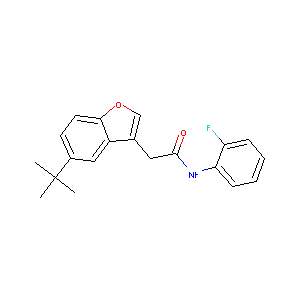

In [80]:
FGs = ["CC(C)(C)c1ccc2occ(CC(=O)Nc3ccccc3F)c2c1"]
molecules = []
for FG in FGs:
    molecules.append(Chem.MolFromSmiles(FG))
display_images(mols_to_pngs(molecules))